In [0]:
#@title Install Dependencies
!pip install tensorflow
!pip install tf-agents

     |████████████████████████████████| 911kB 2.8MB/s 
     |████████████████████████████████| 51kB 4.2MB/s 
  Found existing installation: gin-config 0.3.0
    Uninstalling gin-config-0.3.0:
      Successfully uninstalled gin-config-0.3.0


In [0]:
#@title Import dependencies.
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import collections
import random
import time
import tqdm

import gym
import gym.spaces
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import scipy.sparse.csgraph
import tensorflow as tf

from tf_agents.agents import tf_agent
from tf_agents.agents.ddpg import actor_network
from tf_agents.agents.ddpg import critic_network
from tf_agents.drivers import dynamic_step_driver
from tf_agents.environments import gym_wrapper
from tf_agents.environments import tf_py_environment
from tf_agents.environments import wrappers
from tf_agents.eval import metric_utils
from tf_agents.metrics import tf_metrics
from tf_agents.networks import utils
from tf_agents.policies import actor_policy
from tf_agents.policies import ou_noise_policy
from tf_agents.policies import tf_policy
from tf_agents.replay_buffers import tf_uniform_replay_buffer
from tf_agents.trajectories import time_step
from tf_agents.trajectories import trajectory
from tf_agents.utils import common

tf.compat.v1.enable_v2_behavior()
# tf.enable_eager_execution()
# tf.logging.set_verbosity(tf.logging.INFO)

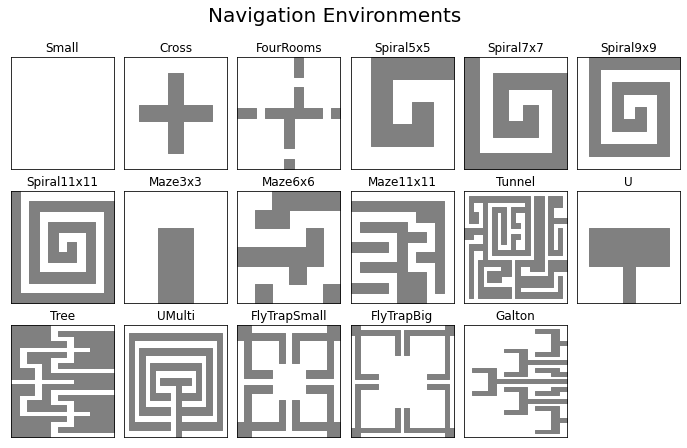

In [0]:
#@title Implement the 2D navigation environment and helper functions.
WALLS = {
    'Small':
        np.array([[0, 0, 0, 0],
                  [0, 0, 0, 0],
                  [0, 0, 0, 0],
                  [0, 0, 0, 0]]),
    'Cross':
        np.array([[0, 0, 0, 0, 0, 0, 0],
                  [0, 0, 0, 1, 0, 0, 0],
                  [0, 0, 0, 1, 0, 0, 0],
                  [0, 1, 1, 1, 1, 1, 0],
                  [0, 0, 0, 1, 0, 0, 0],
                  [0, 0, 0, 1, 0, 0, 0],
                  [0, 0, 0, 0, 0, 0, 0]]),
    'FourRooms':
        np.array([[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0],
                  [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0],
                  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                  [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0],
                  [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0],
                  [1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0],
                  [0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1],
                  [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0],
                  [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0],
                  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                  [0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]]),
    'Spiral5x5':
        np.array([[0, 0, 0, 0, 0],
                  [0, 1, 1, 1, 1],
                  [0, 1, 0, 0, 1],
                  [0, 1, 1, 0, 1],
                  [0, 0, 0, 0, 1]]),
    'Spiral7x7':
        np.array([[1, 1, 1, 1, 1, 1, 1],
                  [1, 0, 0, 0, 0, 0, 0],
                  [1, 0, 1, 1, 1, 1, 0],
                  [1, 0, 1, 0, 0, 1, 0],
                  [1, 0, 1, 1, 0, 1, 0],
                  [1, 0, 0, 0, 0, 1, 0],
                  [1, 1, 1, 1, 1, 1, 0]]),
    'Spiral9x9':
        np.array([[0, 0, 0, 0, 0, 0, 0, 0, 0],
                  [0, 1, 1, 1, 1, 1, 1, 1, 1],
                  [0, 1, 0, 0, 0, 0, 0, 0, 1],
                  [0, 1, 0, 1, 1, 1, 1, 0, 1],
                  [0, 1, 0, 1, 0, 0, 1, 0, 1],
                  [0, 1, 0, 1, 1, 0, 1, 0, 1],
                  [0, 1, 0, 0, 0, 0, 1, 0, 1],
                  [0, 1, 1, 1, 1, 1, 1, 0, 1],
                  [0, 0, 0, 0, 0, 0, 0, 0, 1]]),
    'Spiral11x11':
        np.array([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
                  [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                  [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                  [1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0],
                  [1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0],
                  [1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0],
                  [1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0],
                  [1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0],
                  [1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0],
                  [1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
                  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0]]),
    'Maze3x3':
        np.array([[0, 0, 0],
                  [1, 1, 0],
                  [0, 0, 0]]),
    'Maze6x6':
        np.array([[0, 0, 1, 0, 0, 0],
                  [1, 0, 1, 0, 1, 0],
                  [0, 0, 1, 0, 1, 1],
                  [0, 1, 1, 0, 0, 1],
                  [0, 0, 1, 1, 0, 1],
                  [1, 0, 0, 0, 0, 1]]),
    'Maze11x11':
        np.array([[0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0],
                  [0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0],
                  [0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0],
                  [0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0],
                  [0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0],
                  [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0],
                  [1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0],
                  [1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0],
                  [0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0],
                  [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]),
    'Tunnel':
        np.array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0],
                  [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0],
                  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0],
                  [0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0],
                  [0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                  [0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
                  [0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0],
                  [0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0],
                  [0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0],
                  [0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
                  [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0],
                  [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0],
                  [0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0],
                  [0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                  [0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                  [0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                  [0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                  [0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                  [0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                  [0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0],
                  [0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0],
                  [0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0]]),
    'U':
        np.array([[0, 0, 0],
                  [0, 1, 0],
                  [0, 1, 0],
                  [0, 1, 0],
                  [1, 1, 0],
                  [0, 1, 0],
                  [0, 1, 0],
                  [0, 1, 0],
                  [0, 0, 0]]),
    'Tree':
        np.array([
            [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
            [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1],
            [1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1],
            [1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1],
            [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1],
            [0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0],
            [0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0],
            [0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0],
            [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0],
            [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0],
            [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0],
        ]),
    'UMulti':
        np.array([
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
            [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0],
            [0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0],
            [1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0],
            [0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
         ]),
    'FlyTrapSmall':
        np.array([
            [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1],
            [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1],
            [0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0],
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
            [0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0],
            [1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1],
            [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1],
         ]),
    'FlyTrapBig':
        np.array([
            [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1],
            [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0],
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
            [0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
            [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
            [1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1],
         ]),
    'Galton':
        np.array([
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
            [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0],
            [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0],
            [0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0],
            [0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0],
            [0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0],
            [0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0],
            [0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0],
        ]),
}

def resize_walls(walls, factor):
  """Increase the environment by rescaling.

  Args:
    walls: 0/1 array indicating obstacle locations.
    factor: (int) factor by which to rescale the environment."""
  (height, width) = walls.shape
  row_indices = np.array([i for i in range(height) for _ in range(factor)])
  col_indices = np.array([i for i in range(width) for _ in range(factor)])
  walls = walls[row_indices]
  walls = walls[:, col_indices]
  assert walls.shape == (factor * height, factor * width)
  return walls



class PointEnv(gym.Env):
  """Abstract class for 2D navigation environments."""

  def __init__(self, walls=None, resize_factor=1,
               action_noise=1.0):
    """Initialize the point environment.

    Args:
      walls: (str) name of one of the maps defined above.
      resize_factor: (int) Scale the map by this factor.
      action_noise: (float) Standard deviation of noise to add to actions. Use 0
        to add no noise.
    """
    if resize_factor > 1:
      self._walls = resize_walls(WALLS[walls], resize_factor)
    else:
      self._walls = WALLS[walls]
    self._apsp = self._compute_apsp(self._walls)
    (height, width) = self._walls.shape
    self._height = height
    self._width = width
    self._action_noise = action_noise
    self.action_space = gym.spaces.Box(
        low=np.array([-1.0, -1.0]),
        high=np.array([1.0, 1.0]),
        dtype=np.float32)
    self.observation_space = gym.spaces.Box(
        low=np.array([0.0, 0.0]),
        high=np.array([self._height, self._width]),
        dtype=np.float32)
    self.reset()

  def _sample_empty_state(self):
    candidate_states = np.where(self._walls == 0)
    num_candidate_states = len(candidate_states[0])
    state_index = np.random.choice(num_candidate_states)
    state = np.array([candidate_states[0][state_index],
                      candidate_states[1][state_index]],
                     dtype=np.float)
    state += np.random.uniform(size=2)
    assert not self._is_blocked(state)
    return state

  def reset(self):
    self.state = self._sample_empty_state()
    return self.state.copy()

  def _get_distance(self, obs, goal):
    """Compute the shortest path distance.

    Note: This distance is *not* used for training."""
    (i1, j1) = self._discretize_state(obs)
    (i2, j2) = self._discretize_state(goal)
    return self._apsp[i1, j1, i2, j2]

  def _discretize_state(self, state, resolution=1.0):
    (i, j) = np.floor(resolution * state).astype(np.int)
    # Round down to the nearest cell if at the boundary.
    if i == self._height:
      i -= 1
    if j == self._width:
      j -= 1
    return (i, j)

  def _is_blocked(self, state):
    if not self.observation_space.contains(state):
      return True
    (i, j) = self._discretize_state(state)
    return (self._walls[i, j] == 1)

  def step(self, action):
    if self._action_noise > 0:
      action += np.random.normal(0, self._action_noise)
    action = np.clip(action, self.action_space.low, self.action_space.high)
    assert self.action_space.contains(action)
    num_substeps = 10
    dt = 1.0 / num_substeps
    num_axis = len(action)
    for _ in np.linspace(0, 1, num_substeps):
      for axis in range(num_axis):
        new_state = self.state.copy()
        new_state[axis] += dt * action[axis]
        if not self._is_blocked(new_state):
          self.state = new_state

    done = False
    rew = -1.0 * np.linalg.norm(self.state)
    return self.state.copy(), rew, done, {}

  @property
  def walls(self):
    return self._walls

  def _compute_apsp(self, walls):
    (height, width) = walls.shape
    g = nx.Graph()
    # Add all the nodes
    for i in range(height):
      for j in range(width):
        if walls[i, j] == 0:
          g.add_node((i, j))

    # Add all the edges
    for i in range(height):
      for j in range(width):
        for di in [-1, 0, 1]:
          for dj in [-1, 0, 1]:
            if di == dj == 0: continue  # Don't add self loops
            if i + di < 0 or i + di > height - 1: continue  # No cell here
            if j + dj < 0 or j + dj > width - 1: continue  # No cell here
            if walls[i, j] == 1: continue  # Don't add edges to walls
            if walls[i + di, j + dj] == 1: continue  # Don't add edges to walls
            g.add_edge((i, j), (i + di, j + dj))

    # dist[i, j, k, l] is path from (i, j) -> (k, l)
    dist = np.full((height, width, height, width), np.float('inf'))
    for ((i1, j1), dist_dict) in nx.shortest_path_length(g):
      for ((i2, j2), d) in dist_dict.items():
        dist[i1, j1, i2, j2] = d
    return dist

class GoalConditionedPointWrapper(gym.Wrapper):
  """Wrapper that appends goal to state produced by environment."""


  def __init__(self, env, prob_constraint=0.8, min_dist=0, max_dist=4,
               threshold_distance=1.0):
    """Initialize the environment.

    Args:
      env: an environment.
      prob_constraint: (float) Probability that the distance constraint is
        followed after resetting.
      min_dist: (float) When the constraint is enforced, ensure the goal is at
        least this far from the initial state.
      max_dist: (float) When the constraint is enforced, ensure the goal is at
        most this far from the initial state.
      threshold_distance: (float) States are considered equivalent if they are
        at most this far away from one another.
    """
    self._threshold_distance = threshold_distance
    self._prob_constraint = prob_constraint
    self._min_dist = min_dist
    self._max_dist = max_dist
    super(GoalConditionedPointWrapper, self).__init__(env)
    self.observation_space = gym.spaces.Dict({
        'observation': env.observation_space,
        'goal': env.observation_space,
    })

  def _normalize_obs(self, obs):
    return np.array([
        obs[0] / float(self.env._height),
        obs[1] / float(self.env._width)
    ])

  def reset(self):
    goal = None
    count = 0
    while goal is None:
      obs = self.env.reset()
      (obs, goal) = self._sample_goal(obs)
      count += 1
      if count > 1000:
        print('WARNING: Unable to find goal within constraints.')
    self._goal = goal
    return {'observation': self._normalize_obs(obs),
            'goal': self._normalize_obs(self._goal)}

  def step(self, action):
    obs, _, _, _ = self.env.step(action)
    rew = -1.0
    done = self._is_done(obs, self._goal)
    return {'observation': self._normalize_obs(obs),
            'goal': self._normalize_obs(self._goal)}, rew, done, {}

  def set_sample_goal_args(self, prob_constraint=None,
                           min_dist=None, max_dist=None):
    assert prob_constraint is not None
    assert min_dist is not None
    assert max_dist is not None
    assert min_dist >= 0
    assert max_dist >= min_dist
    self._prob_constraint = prob_constraint
    self._min_dist = min_dist
    self._max_dist = max_dist

  def _is_done(self, obs, goal):
    """Determines whether observation equals goal."""
    return np.linalg.norm(obs - goal) < self._threshold_distance

  def _sample_goal(self, obs):
    """Sampled a goal state."""
    if np.random.random() < self._prob_constraint:
      return self._sample_goal_constrained(obs, self._min_dist, self._max_dist)
    else:
      return self._sample_goal_unconstrained(obs)

  def _sample_goal_constrained(self, obs, min_dist, max_dist):
    """Samples a goal with dist min_dist <= d(obs, goal) <= max_dist.

    Args:
      obs: observation (without goal).
      min_dist: (int) minimum distance to goal.
      max_dist: (int) maximum distance to goal.
    Returns:
      obs: observation (without goal).
      goal: a goal state.
    """
    (i, j) = self.env._discretize_state(obs)
    mask = np.logical_and(self.env._apsp[i, j] >= min_dist,
                          self.env._apsp[i, j] <= max_dist)
    mask = np.logical_and(mask, self.env._walls == 0)
    candidate_states = np.where(mask)
    num_candidate_states = len(candidate_states[0])
    if num_candidate_states == 0:
      return (obs, None)
    goal_index = np.random.choice(num_candidate_states)
    goal = np.array([candidate_states[0][goal_index],
                     candidate_states[1][goal_index]],
                    dtype=np.float)
    goal += np.random.uniform(size=2)
    dist_to_goal = self.env._get_distance(obs, goal)
    assert min_dist <= dist_to_goal <= max_dist
    assert not self.env._is_blocked(goal)
    return (obs, goal)

  def _sample_goal_unconstrained(self, obs):
    """Samples a goal without any constraints.

    Args:
      obs: observation (without goal).
    Returns:
      obs: observation (without goal).
      goal: a goal state.
    """
    return (obs, self.env._sample_empty_state())

  @property
  def max_goal_dist(self):
    apsp = self.env._apsp
    return np.max(apsp[np.isfinite(apsp)])


class NonTerminatingTimeLimit(wrappers.PyEnvironmentBaseWrapper):
  """Resets the environment without setting done = True.

  Resets the environment if either these conditions holds:
    1. The base environment returns done = True
    2. The time limit is exceeded.
  """

  def __init__(self, env, duration):
    super(NonTerminatingTimeLimit, self).__init__(env)
    self._duration = duration
    self._step_count = None

  def _reset(self):
    self._step_count = 0
    return self._env.reset()

  @property
  def duration(self):
    return self._duration

  def _step(self, action):
    if self._step_count is None:
      return self.reset()

    ts = self._env.step(action)

    self._step_count += 1
    if self._step_count >= self._duration or ts.is_last():
      self._step_count = None

    return ts

def env_load_fn(environment_name,
         max_episode_steps=None,
         resize_factor=1,
         gym_env_wrappers=(GoalConditionedPointWrapper,),
         terminate_on_timeout=False):
  """Loads the selected environment and wraps it with the specified wrappers.

  Args:
    environment_name: Name for the environment to load.
    max_episode_steps: If None the max_episode_steps will be set to the default
      step limit defined in the environment's spec. No limit is applied if set
      to 0 or if there is no timestep_limit set in the environment's spec.
    gym_env_wrappers: Iterable with references to wrapper classes to use
      directly on the gym environment.
    terminate_on_timeout: Whether to set done = True when the max episode
      steps is reached.

  Returns:
    A PyEnvironmentBase instance.
  """
  gym_env = PointEnv(walls=environment_name,
                     resize_factor=resize_factor)

  for wrapper in gym_env_wrappers:
    gym_env = wrapper(gym_env)
  env = gym_wrapper.GymWrapper(
      gym_env,
      discount=1.0,
      auto_reset=True,
  )

  if max_episode_steps > 0:
    if terminate_on_timeout:
      env = wrappers.TimeLimit(env, max_episode_steps)
    else:
      env = NonTerminatingTimeLimit(env, max_episode_steps)

  return tf_py_environment.TFPyEnvironment(env)

def plot_walls(walls):
  walls = walls.T
  (height, width) = walls.shape
  for (i, j) in zip(*np.where(walls)):
    x = np.array([j, j+1]) / float(width)
    y0 = np.array([i, i]) / float(height)
    y1 = np.array([i+1, i+1]) / float(height)
    plt.fill_between(x, y0, y1, color='grey')
  plt.xlim([0, 1])
  plt.ylim([0, 1])
  plt.xticks([])
  plt.yticks([])

plt.figure(figsize=(12, 7))
for index, (name, walls) in enumerate(WALLS.items()):
  plt.subplot(3, 6, index + 1)
  plt.title(name)
  plot_walls(walls)
plt.subplots_adjust(wspace=0.1, hspace=0.2)
plt.suptitle('Navigation Environments', fontsize=20)
plt.show()

In [0]:
#@title Implement the goal-conditioned actor and critic.
def disable_training_actor(actor):
  for layer in list(actor._mlp_layers)[1:-1]:
      layer.trainable = False

def disable_training_critic(critic):
  for layer in list(critic._joint_layers)[1:-1]:
      layer.trainable = False

def set_goal(traj, goal):
  """Sets the goal of a Trajectory or TimeStep."""
  for obs_field in ['observation', 'goal']:
    assert obs_field in traj.observation.keys()
  obs = traj.observation['observation']
  tf.nest.assert_same_structure(obs, goal)
  modified_traj = traj._replace(
      observation={'observation': obs, 'goal': goal})
  return modified_traj

def merge_obs_goal(observations):
  """Merge the observation and goal fields into a single tensor.

  If both are 1D, we concatenate the observation and goal together. If both are
  3D, we stack along the third axis, so the resulting tensor has
  shape (H x W x 2 * D).

  Args:
    observations: Dictionary-type observations.
  Returns:
    a merged observation
  """
  obs = observations['observation']
  goal = observations['goal']

  assert obs.shape == goal.shape
  # For 1D observations, simply concatenate them together.
  assert len(obs.shape) == 2
  modified_observations = tf.concat([obs, goal], axis=-1)
  assert obs.shape[0] == modified_observations.shape[0]
  assert modified_observations.shape[1] == obs.shape[1] + goal.shape[1]
  return modified_observations


class GoalConditionedActorNetwork(actor_network.ActorNetwork):
  """Actor network that takes observations and goals as inputs."""

  def __init__(self,
               input_tensor_spec,
               output_tensor_spec,
               **kwargs):
    modified_tensor_spec = None
    super(GoalConditionedActorNetwork, self).__init__(
        modified_tensor_spec, output_tensor_spec,
        fc_layer_params=(256, 256),
        **kwargs)
    self._input_tensor_spec = input_tensor_spec
    self.create_variables()

  def call(self, observations, step_type=(), network_state=()):
    modified_observations = merge_obs_goal(observations)
    return_vals = super(GoalConditionedActorNetwork, self).call(
        modified_observations, step_type=step_type, network_state=network_state)
    return return_vals


class GoalConditionedCriticNetwork(critic_network.CriticNetwork):
  """Actor network that takes observations and goals as inputs.

  Further modified so it can make multiple predictions.
  """

  def __init__(self,
               input_tensor_spec,
               observation_conv_layer_params=None,
               observation_fc_layer_params=(256,),
               action_fc_layer_params=None,
               joint_fc_layer_params=(256,),
               activation_fn=tf.nn.relu,
               name='CriticNetwork',
               output_dim=None):
    """Creates an instance of `CriticNetwork`.

    Args:
      input_tensor_spec: A tuple of (observation, action) each a nest of
        `tensor_spec.TensorSpec` representing the inputs.
      observation_conv_layer_params: Optional list of convolution layer
        parameters for observations, where each item is a length-three tuple
        indicating (num_units, kernel_size, stride).
      observation_fc_layer_params: Optional list of fully connected parameters
        for observations, where each item is the number of units in the layer.
      action_fc_layer_params: Optional list of fully connected parameters for
        actions, where each item is the number of units in the layer.
      joint_fc_layer_params: Optional list of fully connected parameters after
        merging observations and actions, where each item is the number of units
        in the layer.
      activation_fn: Activation function, e.g. tf.nn.relu, slim.leaky_relu, ...
      name: A string representing name of the network.
      output_dim: An integer specifying the number of outputs. If None, output
        will be flattened.

    """
    self._output_dim = output_dim
    (_, action_spec) = input_tensor_spec
    modified_obs_spec = None
    modified_tensor_spec = (modified_obs_spec, action_spec)

    super(critic_network.CriticNetwork, self).__init__(
        input_tensor_spec=modified_tensor_spec,
        state_spec=(),
        name=name)
    self._input_tensor_spec = input_tensor_spec

    flat_action_spec = tf.nest.flatten(action_spec)
    if len(flat_action_spec) > 1:
      raise ValueError('Only a single action is supported by this network')
    self._single_action_spec = flat_action_spec[0]

    self._observation_layers = utils.mlp_layers(
        observation_conv_layer_params,
        observation_fc_layer_params,
        activation_fn=activation_fn,
        kernel_initializer=tf.compat.v1.keras.initializers.VarianceScaling(
            scale=1. / 3., mode='fan_in', distribution='uniform'),
        name='observation_encoding')

    self._action_layers = utils.mlp_layers(
        None,
        action_fc_layer_params,
        activation_fn=activation_fn,
        kernel_initializer=tf.compat.v1.keras.initializers.VarianceScaling(
            scale=1. / 3., mode='fan_in', distribution='uniform'),
        name='action_encoding')

    self._joint_layers = utils.mlp_layers(
        None,
        joint_fc_layer_params,
        activation_fn=activation_fn,
        kernel_initializer=tf.compat.v1.keras.initializers.VarianceScaling(
            scale=1. / 3., mode='fan_in', distribution='uniform'),
        name='joint_mlp')

    self._joint_layers.append(
        tf.keras.layers.Dense(
            self._output_dim if self._output_dim is not None else 1,
            activation=None,
            kernel_initializer=tf.compat.v1.keras.initializers.RandomUniform(
                minval=-0.003, maxval=0.003),
            name='value'))
    self.create_variables()


  def call(self, inputs, step_type=(), network_state=()):
    observations, actions = inputs
    modified_observations = merge_obs_goal(observations)
    modified_inputs = (modified_observations, actions)
    output = super(GoalConditionedCriticNetwork, self).call(
        modified_inputs, step_type=step_type, network_state=network_state)
    (predictions, network_state) = output

    # We have to reshape the output, which is flattened by default
    if self._output_dim is not None:
      predictions = tf.reshape(predictions, [-1, self._output_dim])

    return predictions, network_state

In [0]:
#@title Implement the goal-conditioned agent.

class UvfAgent(tf_agent.TFAgent):
  """A UVF Agent."""

  def __init__(
      self,
      time_step_spec,
      action_spec,
      ou_stddev=1.0,
      ou_damping=1.0,
      target_update_tau=0.05,
      target_update_period=5,
      max_episode_steps=None,
      ensemble_size=3,
      combine_ensemble_method='min',
      use_distributional_rl=True):
    """Creates a Uvf Agent.

    Args:
      time_step_spec: A `TimeStep` spec of the expected time_steps.
      action_spec: A nest of BoundedTensorSpec representing the actions.
      ou_stddev: Standard deviation for the Ornstein-Uhlenbeck (OU) noise added
        in the default collect policy.
      ou_damping: Damping factor for the OU noise added in the default collect
        policy.
      target_update_tau: Factor for soft update of the target networks.
      target_update_period: Period for soft update of the target networks.
      max_episode_steps: Int indicating number of steps in an episode. Used for
        determining the number of bins for distributional RL.
      ensemble_size: (int) Number of models in ensemble of critics.
      combine_ensemble_method: (str) At test time, how to combine the distances
        predicted by each member of the ensemble. Options are 'mean', 'min',
        and 'td3'. The 'td3' option is pessimistic w.r.t. the pdf, and then
        takes computes the corresponding distance. The 'min' option takes the
        minimum q values, corresponding to taking the maximum predicted
        distance. Note that we never aggregate predictions during training.
      use_distributional_rl: (bool) Whether to use distributional RL.
    """
    tf.Module.__init__(self, name='UvfAgent')

    assert max_episode_steps is not None
    self._max_episode_steps = max_episode_steps
    self._ensemble_size = ensemble_size
    self._use_distributional_rl = use_distributional_rl

    # Create the actor
    self._actor_network = GoalConditionedActorNetwork(
        time_step_spec.observation, action_spec)
    self._target_actor_network = self._actor_network.copy(
        name='TargetActorNetwork')
    

    # Create a prototypical critic, which we will copy to create the ensemble.
    critic_net_input_specs = (time_step_spec.observation, action_spec)
    critic_network = GoalConditionedCriticNetwork(
        critic_net_input_specs,
        output_dim=max_episode_steps if use_distributional_rl else None,
    )
    self._critic_network_list = []
    self._target_critic_network_list = []
    for ensemble_index in range(self._ensemble_size):
      self._critic_network_list.append(
          critic_network.copy(name='CriticNetwork%d' % ensemble_index))
      self._target_critic_network_list.append(
          critic_network.copy(name='TargetCriticNetwork%d' % ensemble_index))

    self._actor_optimizer = tf.optimizers.Adam(learning_rate=3e-4)
    self._critic_optimizer = tf.optimizers.Adam(learning_rate=3e-4)

    self._ou_stddev = ou_stddev
    self._ou_damping = ou_damping
    self._target_update_tau = target_update_tau
    self._target_update_period = target_update_period

    self._update_target = self._get_target_updater(
        target_update_tau, target_update_period)

    policy = actor_policy.ActorPolicy(
        time_step_spec=time_step_spec, action_spec=action_spec,
        actor_network=self._actor_network, clip=True)
    collect_policy = actor_policy.ActorPolicy(
        time_step_spec=time_step_spec, action_spec=action_spec,
        actor_network=self._actor_network, clip=False)
    collect_policy = ou_noise_policy.OUNoisePolicy(
        collect_policy,
        ou_stddev=self._ou_stddev,
        ou_damping=self._ou_damping,
        clip=True)

    super(UvfAgent, self).__init__(
        time_step_spec,
        action_spec,
        policy,
        collect_policy,
        train_sequence_length=2)

  def initialize_search(self, active_set, max_search_steps=3,
                        combine_ensemble_method='min'):
    self._combine_ensemble_method = combine_ensemble_method
    self._max_search_steps = max_search_steps
    self._active_set_tensor = tf.convert_to_tensor(value=active_set)
    pdist = self._get_pairwise_dist(self._active_set_tensor, masked=True,
                                    aggregate=combine_ensemble_method)
    distances = scipy.sparse.csgraph.floyd_warshall(pdist, directed=True)
    self._distances_tensor = tf.convert_to_tensor(value=distances, dtype=tf.float32)

  def _get_pairwise_dist(self, obs_tensor, goal_tensor=None, masked=False,
                         aggregate='mean'):
    """Estimates the pairwise distances.

    Args:
      obs_tensor: Tensor containing observations
      goal_tensor: (optional) Tensor containing a second set of observations. If
        not specified, computes the pairwise distances between obs_tensor and
        itself.
      masked: (bool) Whether to ignore edges that are too long, as defined by
        max_search_steps.
      aggregate: (str) How to combine the predictions from the ensemble. Options
        are to take the minimum predicted q value (i.e., the maximum distance),
        the mean, or to simply return all the predictions.
    """
    if goal_tensor is None:
      goal_tensor = obs_tensor
    dist_matrix = []
    for obs_index in range(obs_tensor.shape[0]):
      obs = obs_tensor[obs_index]
      obs_repeat_tensor = tf.ones_like(goal_tensor) * tf.expand_dims(obs, 0)
      obs_goal_tensor = {'observation': obs_repeat_tensor,
                         'goal': goal_tensor}
      pseudo_next_time_steps = time_step.transition(obs_goal_tensor,
                                                    reward=0.0,  # Ignored
                                                    discount=1.0)
      dist = self._get_dist_to_goal(pseudo_next_time_steps, aggregate=aggregate)
      dist_matrix.append(dist)

    pairwise_dist = tf.stack(dist_matrix)
    if aggregate is None:
      pairwise_dist = tf.transpose(a=pairwise_dist, perm=[1, 0, 2])

    if masked:
      mask = (pairwise_dist > self._max_search_steps)
      return tf.compat.v1.where(mask, tf.fill(pairwise_dist.shape, np.inf),
                        pairwise_dist)
    else:
      return pairwise_dist

  def _get_critic_output(self, critic_net_list, next_time_steps,
                         actions=None):
    """Calls the critic net.

    Args:
      critic_net_list: (list) List of critic networks.
      next_time_steps: time_steps holding the observations and step types
      actions: (optional) actions to compute the Q values for. If None, returns
      the Q values for the best action.
    Returns:
      q_values_list: (list) List containing a tensor of q values for each member
      of the ensemble. For distributional RL, computes the expectation over the
      distribution.
    """
    q_values_list = []
    critic_net_input = (next_time_steps.observation, actions)
    for critic_index in range(self._ensemble_size):
      critic_net = critic_net_list[critic_index]
      q_values, _ = critic_net(critic_net_input, next_time_steps.step_type)
      q_values_list.append(q_values)
    return q_values_list

  def _get_expected_q_values(self, next_time_steps, actions=None):
    if actions is None:
      actions, _ = self._actor_network(next_time_steps.observation,
                                        next_time_steps.step_type)

    q_values_list = self._get_critic_output(self._critic_network_list,
                                            next_time_steps, actions)

    expected_q_values_list = []
    for q_values in q_values_list:
      if self._use_distributional_rl:
        q_probs = tf.nn.softmax(q_values, axis=1)
        batch_size = q_probs.shape[0]
        bin_range = tf.range(1, self._max_episode_steps + 1, dtype=tf.float32)
        ### NOTE: We want to compute the value of each bin, which is the
        # negative distance. Without properly negating this, the actor is
        # optimized to take the *worst* actions.
        neg_bin_range = -1.0 * bin_range
        tiled_bin_range = tf.tile(tf.expand_dims(neg_bin_range, 0),
                                  [batch_size, 1])
        assert q_probs.shape == tiled_bin_range.shape

        ### Take the inner produce between these two tensors
        expected_q_values = tf.reduce_sum(input_tensor=q_probs * tiled_bin_range, axis=1)
        expected_q_values_list.append(expected_q_values)
      else:
        expected_q_values_list.append(q_values)
    return tf.stack(expected_q_values_list)

  def _get_state_values(self, next_time_steps, actions=None, aggregate='mean'):
    """Computes the value function, averaging across bins (for distributional RL)
    and the ensemble (for bootstrap RL).

    Args:
      next_time_steps: time_steps holding the observations and step types
      actions: actions for which to compute the Q values. If None, uses the
      best actions (i.e., returns the value function).
    Returns:
      state_values: Tensor storing the state values for each sample in the
      batch. These values should all be negative.
    """
    with tf.compat.v1.name_scope('state_values'):
      expected_q_values = self._get_expected_q_values(next_time_steps, actions)
      if aggregate is not None:
        if aggregate == 'mean':
          expected_q_values = tf.reduce_mean(input_tensor=expected_q_values, axis=0)
        elif aggregate == 'min':
          expected_q_values = tf.reduce_min(input_tensor=expected_q_values, axis=0)
        else:
          raise ValueError('Unknown method for combining ensemble: %s' %
                           aggregate)

      # Clip the q values if not using distributional RL. If using
      # distributional RL, the q values are implicitly clipped.
      if not self._use_distributional_rl:
        min_q_val = -1.0 * self._max_episode_steps
        max_q_val = 0.0
        expected_q_values = tf.maximum(expected_q_values, min_q_val)
        expected_q_values = tf.minimum(expected_q_values, max_q_val)
      return expected_q_values

  def _get_dist_to_goal(self, next_time_step, aggregate='mean'):
    q_values = self._get_state_values(next_time_step, aggregate=aggregate)
    return -1.0 * q_values

  def _get_waypoint(self, next_time_steps):
    obs_tensor = next_time_steps.observation['observation']
    goal_tensor = next_time_steps.observation['goal']
    obs_to_active_set_dist = self._get_pairwise_dist(
        obs_tensor, self._active_set_tensor, masked=True,
        aggregate=self._combine_ensemble_method)  # B x A
    active_set_to_goal_dist = self._get_pairwise_dist(
        self._active_set_tensor, goal_tensor, masked=True,
        aggregate=self._combine_ensemble_method)  # A x B

    # The search_dist tensor should be (B x A x A)
    search_dist = sum([
        tf.expand_dims(obs_to_active_set_dist, 2),
        tf.expand_dims(self._distances_tensor, 0),
        tf.expand_dims(tf.transpose(a=active_set_to_goal_dist), axis=1)
    ])

    # We assume a batch size of 1.
    assert obs_tensor.shape[0] == 1
    min_search_dist = tf.reduce_min(input_tensor=search_dist, axis=[1, 2])[0]
    waypoint_index = tf.argmin(input=tf.reduce_min(input_tensor=search_dist, axis=[2]), axis=1)[0]
    waypoint = self._active_set_tensor[waypoint_index]

    return waypoint, min_search_dist

  def _initialize(self):
    for ensemble_index in range(self._ensemble_size):
      common.soft_variables_update(
          self._critic_network_list[ensemble_index].variables,
          self._target_critic_network_list[ensemble_index].variables,
          tau=1.0)
    # Caution: actor should only be updated once.
    common.soft_variables_update(
        self._actor_network.variables,
        self._target_actor_network.variables,
        tau=1.0)

  def _get_target_updater(self, tau=1.0, period=1):
    """Performs a soft update of the target network parameters.

    For each weight w_s in the original network, and its corresponding
    weight w_t in the target network, a soft update is:
    w_t = (1- tau) x w_t + tau x ws

    Args:
      tau: A float scalar in [0, 1]. Default `tau=1.0` means hard update.
      period: Step interval at which the target networks are updated.
    Returns:
      An operation that performs a soft update of the target network parameters.
    """
    with tf.compat.v1.name_scope('get_target_updater'):
      def update():  # pylint: disable=missing-docstring
        critic_update_list = []
        for ensemble_index in range(self._ensemble_size):
          critic_update = common.soft_variables_update(
              self._critic_network_list[ensemble_index].variables,
              self._target_critic_network_list[ensemble_index].variables, tau)
          critic_update_list.append(critic_update)
        actor_update = common.soft_variables_update(
            self._actor_network.variables,
            self._target_actor_network.variables, tau)
        return tf.group(critic_update_list + [actor_update])

      return common.Periodically(update, period, 'periodic_update_targets')

  def _experience_to_transitions(self, experience):
    transitions = trajectory.to_transition(experience)
    transitions = tf.nest.map_structure(lambda x: tf.squeeze(x, [1]),
                                        transitions)

    time_steps, policy_steps, next_time_steps = transitions
    actions = policy_steps.action
    return time_steps, actions, next_time_steps

  def _train(self, experience, weights=None):
    del weights
    time_steps, actions, next_time_steps = self._experience_to_transitions(
        experience)

    # Update the critic
    critic_vars = []
    for ensemble_index in range(self._ensemble_size):
      critic_net = self._critic_network_list[ensemble_index]
      critic_vars.extend(critic_net.variables)

    with tf.GradientTape(watch_accessed_variables=False) as tape:
      assert critic_vars
      tape.watch(critic_vars)
      critic_loss = self.critic_loss(time_steps, actions, next_time_steps)
    tf.debugging.check_numerics(critic_loss, 'Critic loss is inf or nan.')
    critic_grads = tape.gradient(critic_loss, critic_vars)
    self._apply_gradients(critic_grads, critic_vars,
                          self._critic_optimizer)

    # Update the actor
    actor_vars = self._actor_network.variables
    with tf.GradientTape(watch_accessed_variables=False) as tape:
      assert actor_vars, 'No actor variables to optimize.'
      tape.watch(actor_vars)
      actor_loss = self.actor_loss(time_steps)
    tf.debugging.check_numerics(actor_loss, 'Actor loss is inf or nan.')
    actor_grads = tape.gradient(actor_loss, actor_vars)
    self._apply_gradients(actor_grads, actor_vars, self._actor_optimizer)

    self.train_step_counter.assign_add(1)
    self._update_target()
    total_loss = actor_loss + critic_loss
    return tf_agent.LossInfo(total_loss, (actor_loss, critic_loss))

  def _apply_gradients(self, gradients, variables, optimizer):
    # Tuple is used for py3, where zip is a generator producing values once.
    grads_and_vars = tuple(zip(gradients, variables))
    optimizer.apply_gradients(grads_and_vars)

  def critic_loss(self,
                  time_steps,
                  actions,
                  next_time_steps):
    """Computes the critic loss for UvfAgent training.

    Args:
      time_steps: A batch of timesteps.
      actions: A batch of actions.
      next_time_steps: A batch of next timesteps.
    Returns:
      critic_loss: A scalar critic loss.
    """
    with tf.compat.v1.name_scope('critic_loss'):
      # We compute the target actions once for all critics.
      target_actions, _ = self._target_actor_network(
          next_time_steps.observation, next_time_steps.step_type)

      critic_loss_list = []
      q_values_list = self._get_critic_output(self._critic_network_list,
                                              time_steps, actions)
      target_q_values_list = self._get_critic_output(
          self._target_critic_network_list, next_time_steps, target_actions)
      assert len(target_q_values_list) == self._ensemble_size
      for ensemble_index in range(self._ensemble_size):
        # The target_q_values should be a Batch x ensemble_size tensor.
        target_q_values = target_q_values_list[ensemble_index]

        if self._use_distributional_rl:
          target_q_probs = tf.nn.softmax(target_q_values, axis=1)
          batch_size = target_q_probs.shape[0]
          one_hot = tf.one_hot(tf.zeros(batch_size, dtype=tf.int32),
                               self._max_episode_steps)
          ### Calculate the shifted probabilities
          # Fist column: Since episode didn't terminate, probability that the
          # distance is 1 equals 0.
          col_1 = tf.zeros((batch_size, 1))
          # Middle columns: Simply the shifted probabilities.
          col_middle = target_q_probs[:, :-2]
          # Last column: Probability of taking at least n steps is sum of
          # last two columns in unshifted predictions:
          col_last = tf.reduce_sum(input_tensor=target_q_probs[:, -2:], axis=1,
                                   keepdims=True)

          shifted_target_q_probs = tf.concat([col_1, col_middle, col_last],
                                             axis=1)
          assert one_hot.shape == shifted_target_q_probs.shape
          td_targets = tf.compat.v1.where(next_time_steps.is_last(),
                                one_hot,
                                shifted_target_q_probs)
          td_targets = tf.stop_gradient(td_targets)
        else:
          td_targets = tf.stop_gradient(
              next_time_steps.reward +
              next_time_steps.discount * target_q_values)

        q_values = q_values_list[ensemble_index]
        if self._use_distributional_rl:
          critic_loss = tf.nn.softmax_cross_entropy_with_logits(
              labels=td_targets,
              logits=q_values
              )
        else:
          critic_loss = common.element_wise_huber_loss(td_targets, q_values)
        critic_loss = tf.reduce_mean(input_tensor=critic_loss)
        critic_loss_list.append(critic_loss)

      critic_loss = tf.reduce_mean(input_tensor=critic_loss_list)

      return critic_loss

  def actor_loss(self, time_steps):
    """Computes the actor_loss for UvfAgent training.

    Args:
      time_steps: A batch of timesteps.
    Returns:
      actor_loss: A scalar actor loss.
    """
    with tf.compat.v1.name_scope('actor_loss'):
      actions, _ = self._actor_network(time_steps.observation,
                                       time_steps.step_type)
      with tf.GradientTape(watch_accessed_variables=False) as tape:
        tape.watch(actions)
        avg_expected_q_values = self._get_state_values(time_steps, actions,
                                                       aggregate='mean')
        actions = tf.nest.flatten(actions)
      dqdas = tape.gradient([avg_expected_q_values], actions)

      actor_losses = []
      for dqda, action in zip(dqdas, actions):
        loss = common.element_wise_squared_loss(
            tf.stop_gradient(dqda + action), action)
        loss = tf.reduce_sum(input_tensor=loss, axis=1)
        loss = tf.reduce_mean(input_tensor=loss)
        actor_losses.append(loss)

      actor_loss = tf.add_n(actor_losses)

      with tf.compat.v1.name_scope('Losses/'):
        tf.compat.v2.summary.scalar(
            name='actor_loss', data=actor_loss, step=self.train_step_counter)

    return actor_loss

  # Sets the number of trainable layers in this UvfAgent
  def set_trainable_layers(self, n_layers, all_trainable=False):
    '''
    Args:
      n_layers = number of layers from top of each network that are trainable
      all_trainable = if true, allows full model to train 
    Ret:
      None
    Todo:
      Add an assert so n_layers not too large
      Diff number of trainable layers for each of actor and critic
    '''
    actors = [self._actor_network, self._target_actor_network]
    critics = self._critic_network_list
    critics.extend(self._target_critic_network_list)

    def set_layers(layers, n_layers):
      for layer in layers[:-n_layers]:
          layer.trainable = False
      for layer in layers[-n_layers:] + [layers[0]]:
          layer.trainable = True

    # todo use set_layers in first sec
    if(all_trainable):
      # set all layers to trainable.
      for layer in actor._mlp_layers:
          layer.trainable = True
      for critic in critics:
        for layer in critic._joint_layers:
          layer.trainable = True
    else:
      # set layers for actor
      for actor in actors:
        set_layers(actor._mlp_layers, n_layers)
      # set layers for critics
      for critic in critics:
        set_layers(critic._joint_layers, n_layers)

      

In [0]:
#@title Training script.
def train_eval(
    tf_agent,
    tf_env,
    eval_tf_env,
    num_iterations=2000000,
    # Params for collect
    initial_collect_steps=1000,
    batch_size=64,
    # Params for eval
    num_eval_episodes=100,
    eval_interval=10000,
    # Params for checkpoints, summaries, and logging
    log_interval=1000,
    random_seed=0):
  """A simple train and eval for UVF.  """
  print('random_seed = %d' % random_seed)
  np.random.seed(random_seed)
  random.seed(random_seed)
  tf.random.set_seed(random_seed)

  max_episode_steps = tf_env.pyenv.envs[0]._duration
  global_step = tf.compat.v1.train.get_or_create_global_step()
  replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer(
      tf_agent.collect_data_spec,
      batch_size=tf_env.batch_size)

  eval_metrics = [
    tf_metrics.AverageReturnMetric(buffer_size=num_eval_episodes),
  ]

  eval_policy = tf_agent.policy
  collect_policy = tf_agent.collect_policy
  initial_collect_driver = dynamic_step_driver.DynamicStepDriver(
      tf_env,
      collect_policy,
      observers=[replay_buffer.add_batch],
      num_steps=initial_collect_steps)

  collect_driver = dynamic_step_driver.DynamicStepDriver(
      tf_env,
      collect_policy,
      observers=[replay_buffer.add_batch],
      num_steps=1)

  initial_collect_driver.run = common.function(initial_collect_driver.run)
  collect_driver.run = common.function(collect_driver.run)
  tf_agent.train = common.function(tf_agent.train)

  initial_collect_driver.run()

  time_step = None
  policy_state = collect_policy.get_initial_state(tf_env.batch_size)

  timed_at_step = global_step.numpy()
  time_acc = 0

  # Dataset generates trajectories with shape [Bx2x...]
  dataset = replay_buffer.as_dataset(
      num_parallel_calls=3,
      sample_batch_size=batch_size,
      num_steps=2).prefetch(3)
  iterator = iter(dataset)

  distances = []
  times = []
  for _ in tqdm.tnrange(num_iterations):
    distance = []
    start_time = time.time()
    time_step, policy_state = collect_driver.run(
        time_step=time_step,
        policy_state=policy_state,
    )

    experience, _ = next(iterator)
    train_loss = tf_agent.train(experience)
    time_acc += time.time() - start_time

    if global_step.numpy() % log_interval == 0:
      tf.compat.v1.logging.info('step = %d, loss = %f', global_step.numpy(),
                    train_loss.loss)
      steps_per_sec = log_interval / time_acc
      tf.compat.v1.logging.info('%.3f steps/sec', steps_per_sec)
      times.append(time_acc)
      time_acc = 0

    if global_step.numpy() % eval_interval == 0:
      start = time.time()
      tf.compat.v1.logging.info('step = %d' % global_step.numpy())
      for dist in [2, 5, 10]:
        distance.append(dist)
        tf.compat.v1.logging.info('\t dist = %d' % dist)
        eval_tf_env.pyenv.envs[0].gym.set_sample_goal_args(
          prob_constraint=1.0, min_dist=dist-1, max_dist=dist+1)

        results = metric_utils.eager_compute(
            eval_metrics,
            eval_tf_env,
            eval_policy,
            num_episodes=num_eval_episodes,
            train_step=global_step,
            summary_prefix='Metrics',
        )
        for (key, value) in results.items():
          tf.compat.v1.logging.info('\t\t %s = %.2f', key, value.numpy())
        # For debugging, it's helpful to check the predicted distances for
        # goals of known distance.
        pred_dist = []
        for _ in range(num_eval_episodes):
          ts = eval_tf_env.reset()
          dist_to_goal = agent._get_dist_to_goal(ts)[0]
          pred_dist.append(dist_to_goal.numpy())
        distance.append(np.mean(pred_dist))
        tf.compat.v1.logging.info('\t\t predicted_dist = %.1f (%.1f)' %
                        (np.mean(pred_dist), np.std(pred_dist)))
      tf.compat.v1.logging.info('\t eval_time = %.2f' % (time.time() - start))
      error = [abs(distance[0] - distance[1]), abs(distance[2] - distance[3]), 
               abs(distance[4] - distance[5])]
      distances.append(error)

  return (train_loss, distances, times)

In [0]:
#@title Implement the search policy
class SearchPolicy(tf_policy.Base):

  def __init__(self, agent, open_loop=False):
    self._agent = agent
    self._open_loop = open_loop
    self._g = self._build_graph()
    super(SearchPolicy, self).__init__(agent.policy.time_step_spec,
                                       agent.policy.action_spec)

  def _build_graph(self):
    g = nx.DiGraph()
    pdist_combined = np.max(pdist, axis=0)
    for i, s_i in enumerate(rb_vec):
      for j, s_j in enumerate(rb_vec):
        length = pdist_combined[i, j]
        if length < self._agent._max_search_steps:
          g.add_edge(i, j, weight=length)
    return g

  def _get_path(self, time_step):
    start_to_rb = agent._get_pairwise_dist(ts.observation['observation'],
                                           rb_vec,
                                           aggregate='min',
                                           masked=True).numpy().flatten()
    rb_to_goal = agent._get_pairwise_dist(rb_vec,
                                          ts.observation['goal'],
                                          aggregate='min',
                                          masked=True).numpy().flatten()

    g2 = self._g.copy()
    for i, (dist_from_start, dist_to_goal) in enumerate(zip(start_to_rb, rb_to_goal)):
      if dist_from_start < self._agent._max_search_steps:
        g2.add_edge('start', i, weight=dist_from_start)
      if dist_to_goal < self._agent._max_search_steps:
        g2.add_edge(i, 'goal', weight=dist_to_goal)
    path = nx.shortest_path(g2, 'start', 'goal')
    edge_lengths = []
    for (i, j) in zip(path[:-1], path[1:]):
      edge_lengths.append(g2[i][j]['weight'])
    wypt_to_goal_dist = np.cumsum(edge_lengths[::-1])[::-1]  # Reverse CumSum
    waypoint_vec = list(path)[1:-1]
    return waypoint_vec, wypt_to_goal_dist[1:]

  def _action(self, time_step, policy_state=(), seed=None):
    goal = time_step.observation['goal']
    dist_to_goal = self._agent._get_dist_to_goal(time_step)[0].numpy()
    if self._open_loop:
      if time_step.is_first():
        self._waypoint_vec, self._wypt_to_goal_dist_vec = self._get_path(time_step)
        self._waypoint_counter = 0
      waypoint = rb_vec[self._waypoint_vec[self._waypoint_counter]]
      time_step.observation['goal'] = waypoint[None]
      dist_to_waypoint = self._agent._get_dist_to_goal(time_step)[0].numpy()
      if dist_to_waypoint < self._agent._max_search_steps:
        self._waypoint_counter = min(self._waypoint_counter + 1,
                                   len(self._waypoint_vec) - 1)
        waypoint = rb_vec[self._waypoint_vec[self._waypoint_counter]]
        time_step.observation['goal'] = waypoint[None]
        dist_to_waypoint = self._agent._get_dist_to_goal(time_step._replace())[0].numpy()
      dist_to_goal_via_wypt = dist_to_waypoint + self._wypt_to_goal_dist_vec[self._waypoint_counter]
    else:
      (waypoint, dist_to_goal_via_wypt) = self._agent._get_waypoint(time_step)
      dist_to_goal_via_wypt = dist_to_goal_via_wypt.numpy()

    if (dist_to_goal_via_wypt < dist_to_goal) or \
        (dist_to_goal > self._agent._max_search_steps):
      time_step.observation['goal'] = tf.convert_to_tensor(value=waypoint[None])
    else:
      time_step.observation['goal'] = goal
    return self._agent.policy.action(time_step, policy_state, seed)

----------------
## Train the Agent!
Now we're going to train the goal-conditioned RL agent. The first cell resets the weights, and the second cell does the actual training. If you want to continue training for longer, simply run the second cell again. Expect training to take about 10 minutes. For some of the complex environments, you may need to increase the `num_iterations` to 100,000.

Training the basic agents

Training for environment FourRooms


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


random_seed = 0
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.while_loop(c, b, vars, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.while_loop(c, b, vars))
Instructions for updating:
If using Keras pass *_constraint arguments to layers.


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:67: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


INFO:tensorflow:step = 1000, loss = 2.109267
INFO:tensorflow:59.149 steps/sec
INFO:tensorflow:step = 1000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.40
INFO:tensorflow:		 predicted_dist = 16.6 (0.4)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.5 (0.3)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -18.90
INFO:tensorflow:		 predicted_dist = 16.7 (0.2)
INFO:tensorflow:	 eval_time = 2.10
INFO:tensorflow:step = 2000, loss = 1.482309
INFO:tensorflow:68.931 steps/sec
INFO:tensorflow:step = 2000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.20
INFO:tensorflow:		 predicted_dist = 14.7 (2.4)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -14.90
INFO:tensorflow:		 predicted_dist = 16.5 (1.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.5 (1.4)
INFO:tensorflow:	 eval_time = 1.56
INFO:tensorflow:step

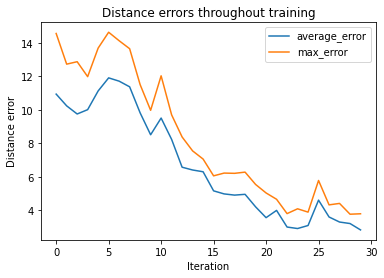

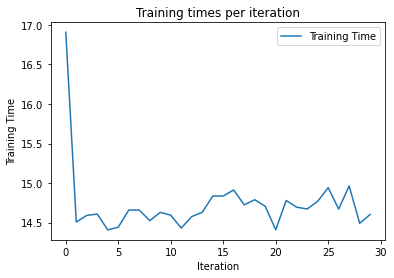

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:66: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


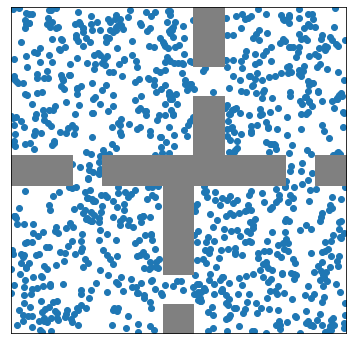

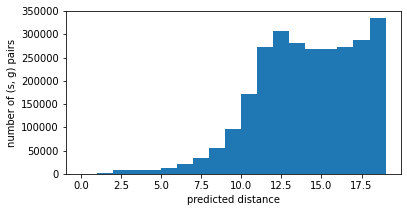

Searching with max steps of  7
Difficulty =  0.8


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


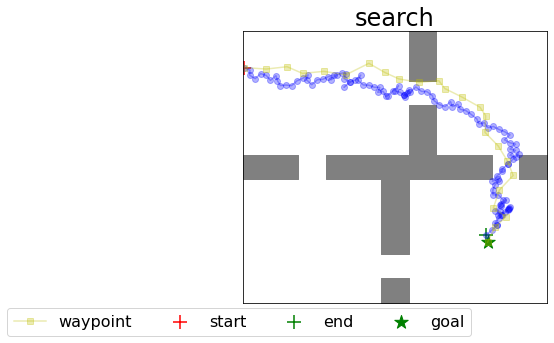

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


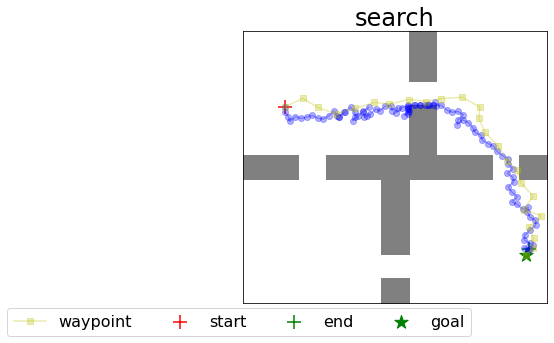

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


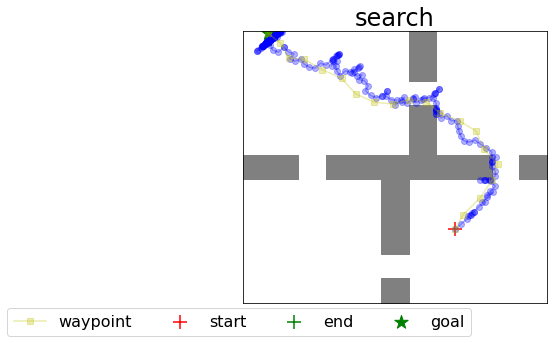

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


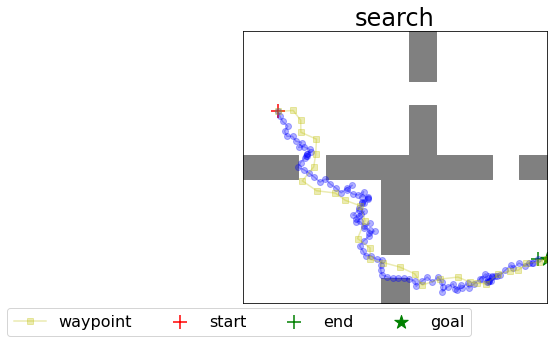

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


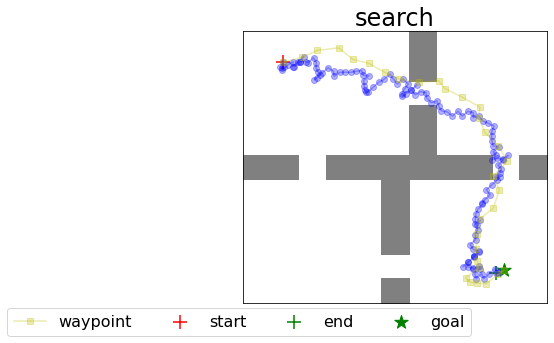

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


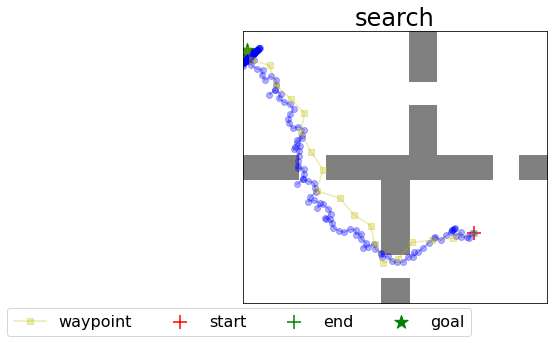

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


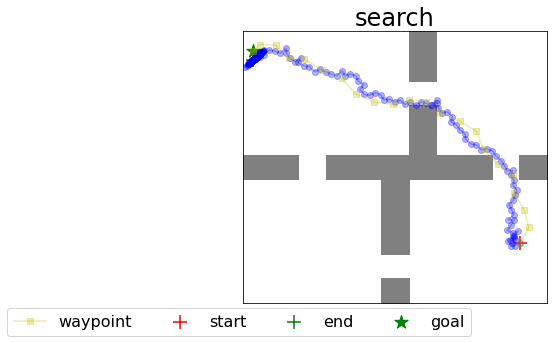

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


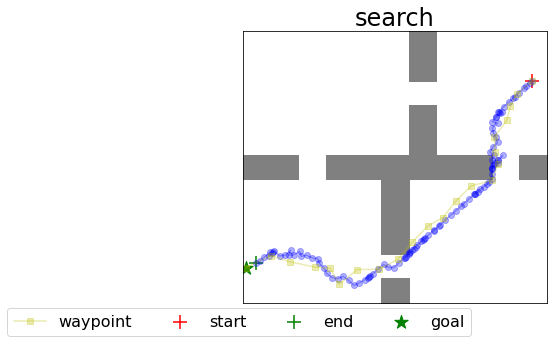

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


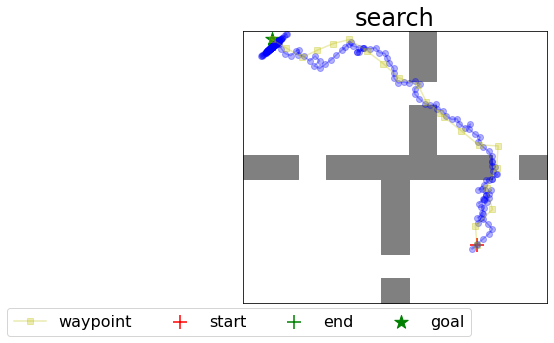

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


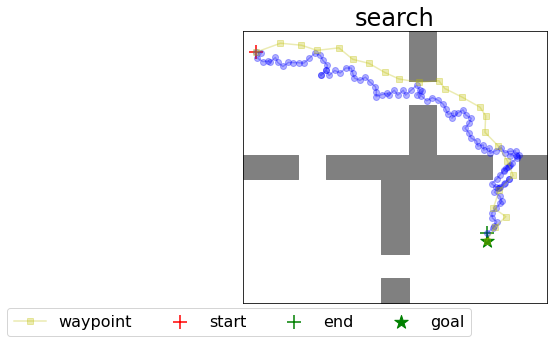

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


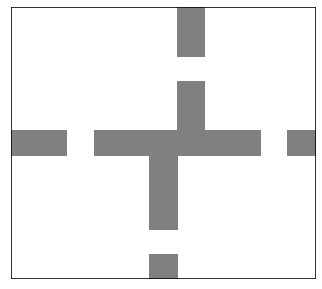

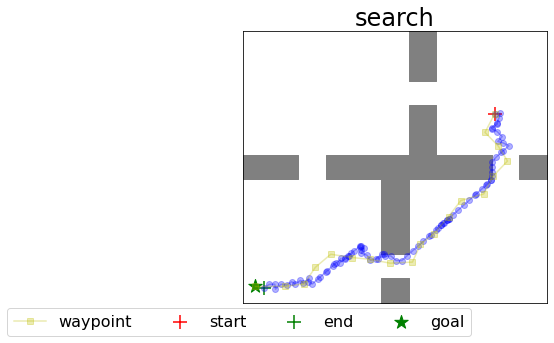

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


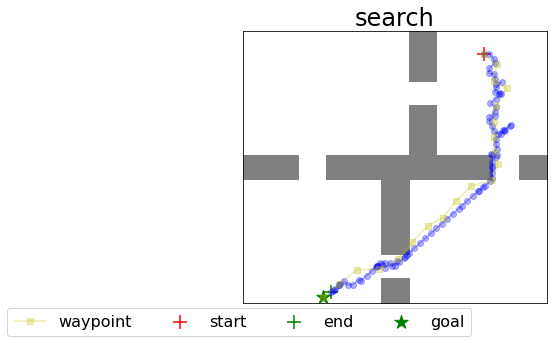

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


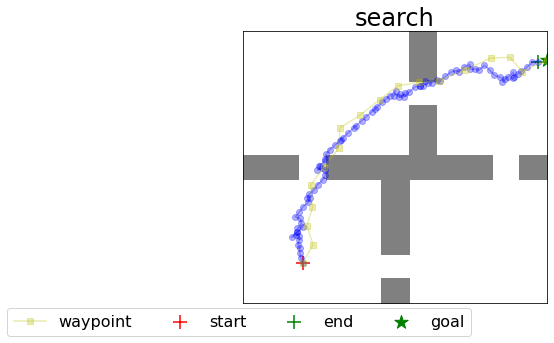

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


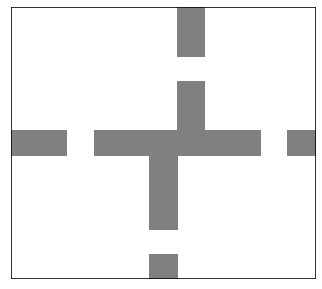

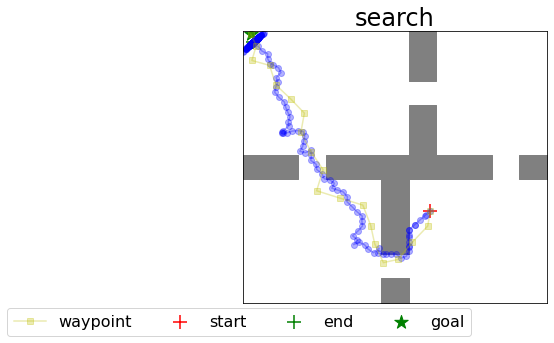

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


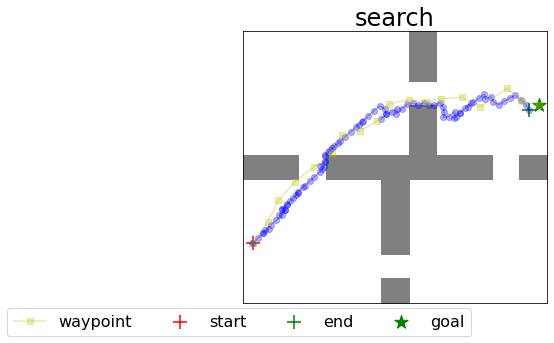

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


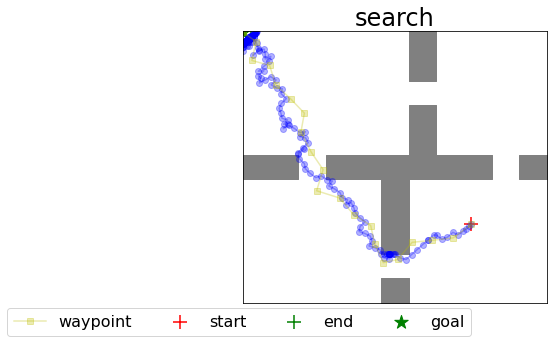

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


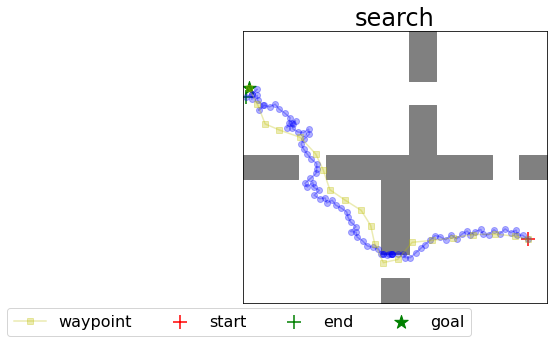

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


Path success rate is  0.85
Rollout success rate (given path) is  0.6470588235294118
Average search time (for success) is  16.001631750779993
Search iterations is  172.11764705882354
Training for environment Spiral11x11


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


random_seed = 0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:67: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


INFO:tensorflow:step = 1000, loss = 2.209862
INFO:tensorflow:58.506 steps/sec
INFO:tensorflow:step = 1000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.20
INFO:tensorflow:		 predicted_dist = 15.1 (0.9)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -15.30
INFO:tensorflow:		 predicted_dist = 15.1 (0.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.1 (0.8)
INFO:tensorflow:	 eval_time = 1.71
INFO:tensorflow:step = 2000, loss = 1.428992
INFO:tensorflow:69.750 steps/sec
INFO:tensorflow:step = 2000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.20
INFO:tensorflow:		 predicted_dist = 16.0 (0.6)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.70
INFO:tensorflow:		 predicted_dist = 16.3 (0.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -19.50
INFO:tensorflow:		 predicted_dist = 17.4 (0.4)
INFO:tensorflow:	 eval_time = 1.59
INFO:tensorflow:step

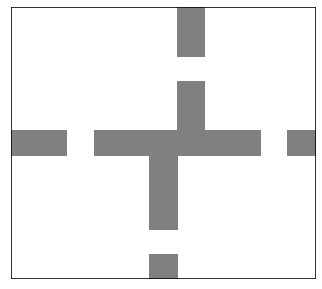

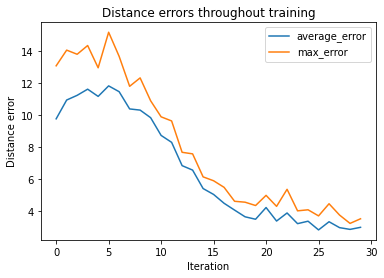

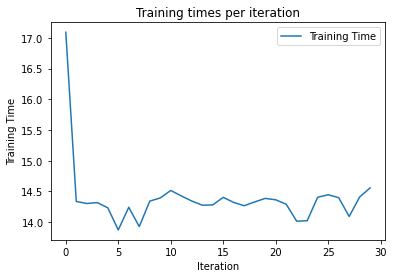

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:66: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


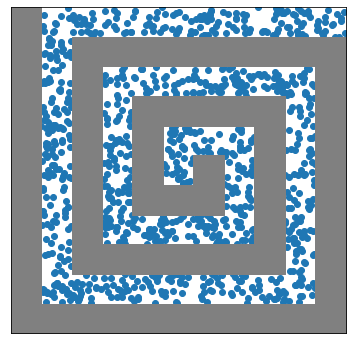

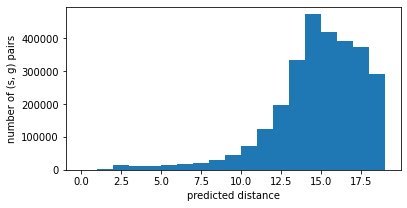

Searching with max steps of  7
Difficulty =  0.8


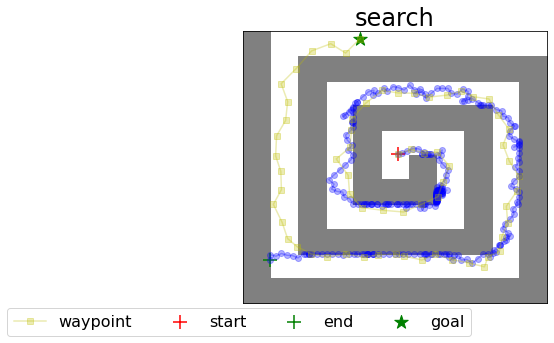

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


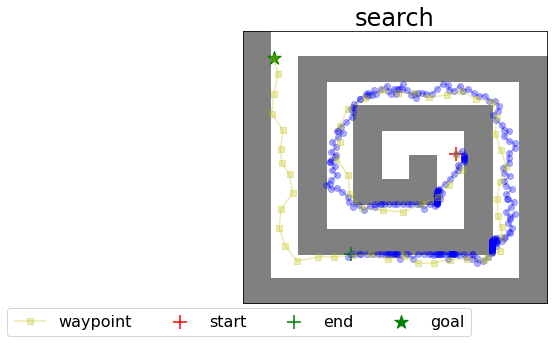

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


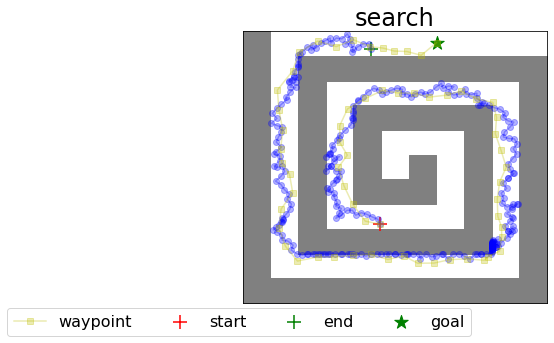

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


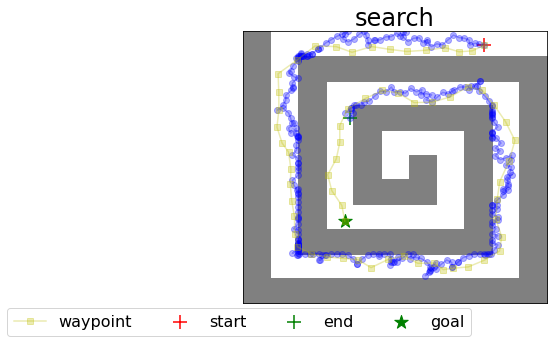

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


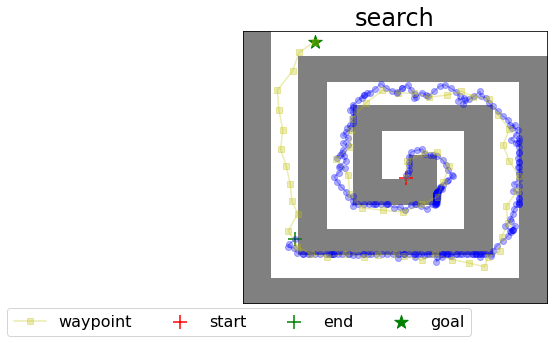

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


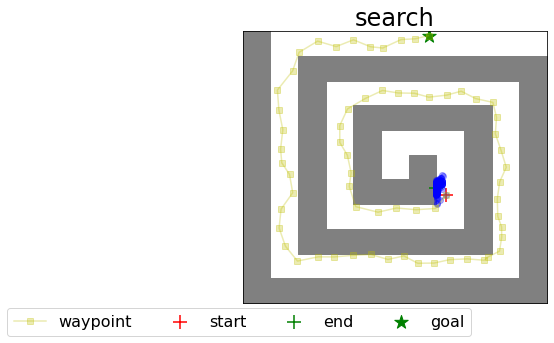

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


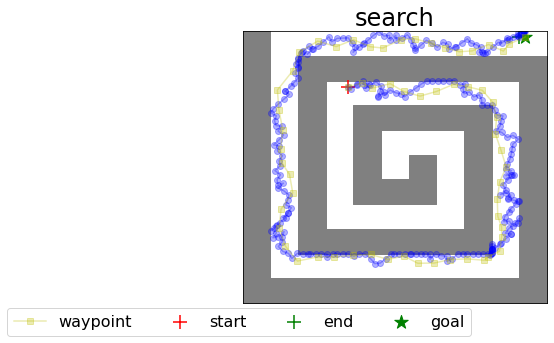

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


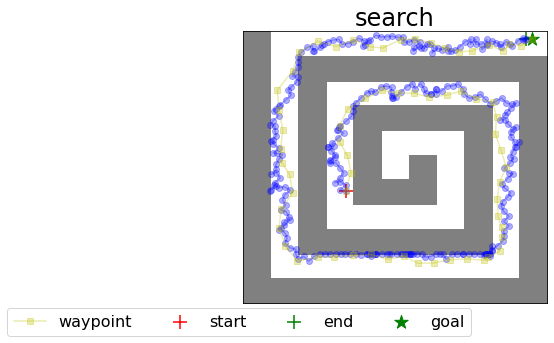

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


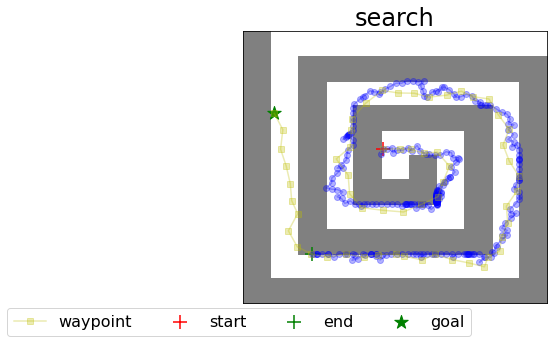

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


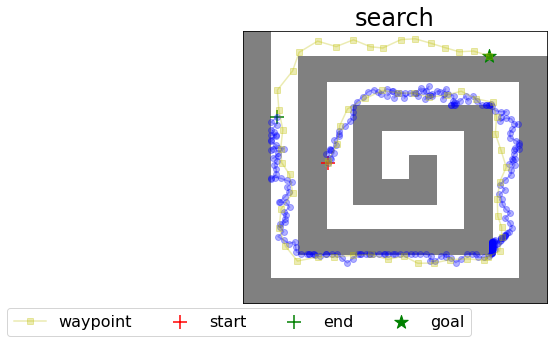

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


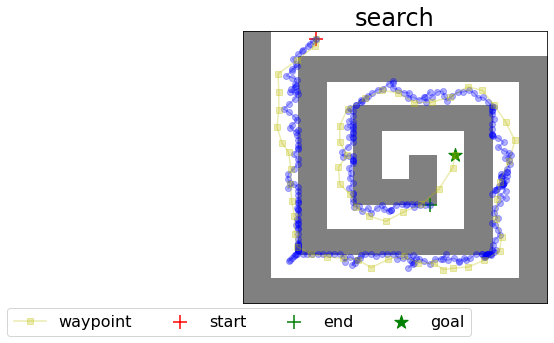

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


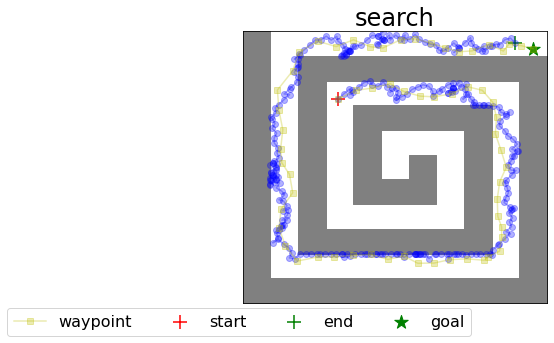

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


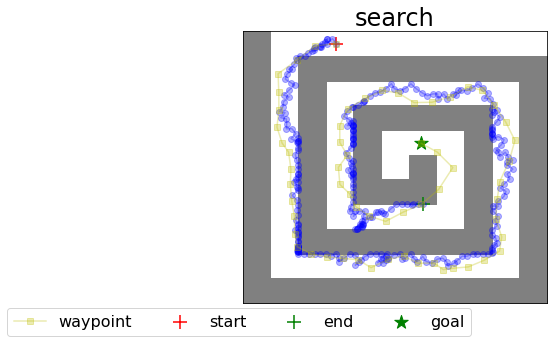

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


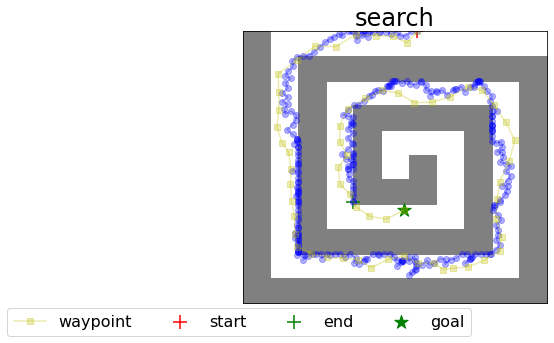

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


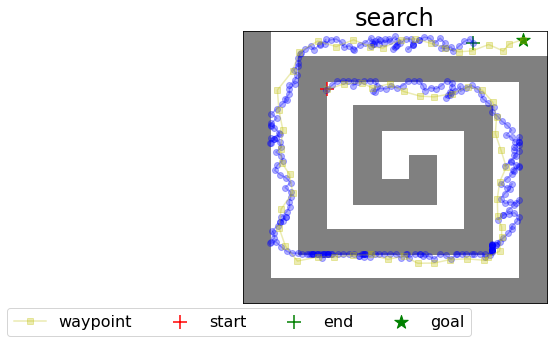

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


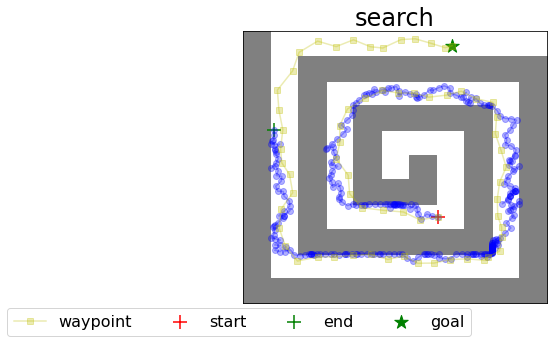

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


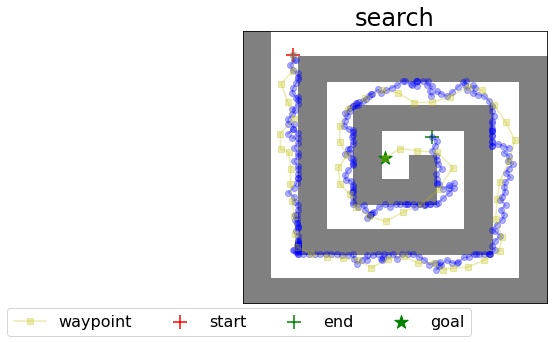

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


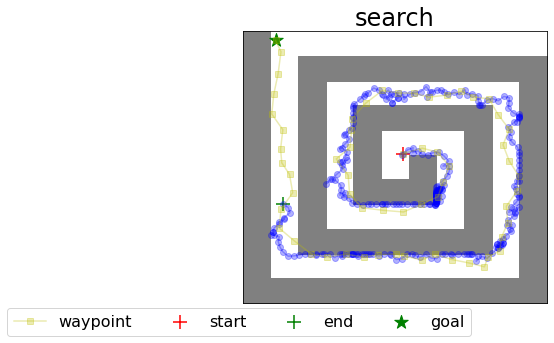

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


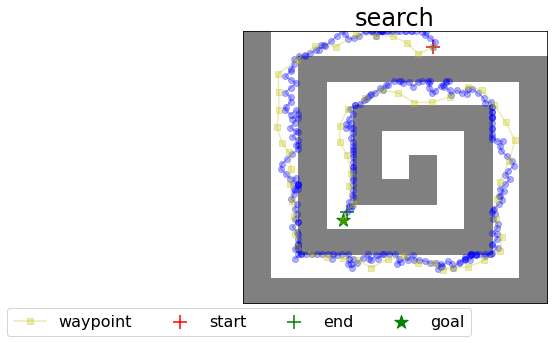

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


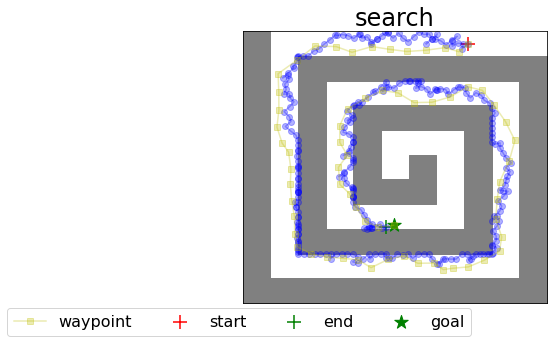

Path success rate is  1.0
Rollout success rate (given path) is  0.2
Average search time (for success) is  20.571544909477232
Search iterations is  297.6
Training for environment Maze11x11


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


random_seed = 0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:67: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


INFO:tensorflow:step = 1000, loss = 2.244333
INFO:tensorflow:60.680 steps/sec
INFO:tensorflow:step = 1000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -16.70
INFO:tensorflow:		 predicted_dist = 15.7 (0.6)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.80
INFO:tensorflow:		 predicted_dist = 15.3 (0.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.0 (0.8)
INFO:tensorflow:	 eval_time = 1.68
INFO:tensorflow:step = 2000, loss = 1.724567
INFO:tensorflow:69.708 steps/sec
INFO:tensorflow:step = 2000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -16.60
INFO:tensorflow:		 predicted_dist = 14.7 (1.3)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 15.3 (1.3)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -19.30
INFO:tensorflow:		 predicted_dist = 16.7 (1.0)
INFO:tensorflow:	 eval_time = 1.59
INFO:tensorflow:step

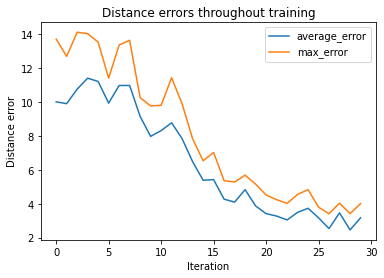

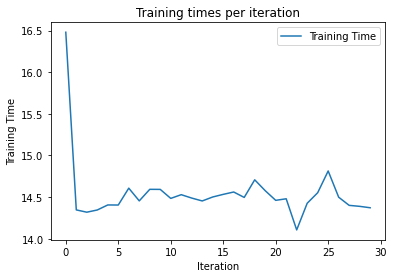

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:66: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


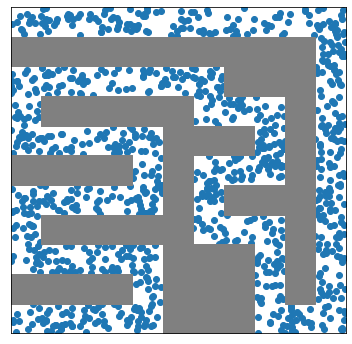

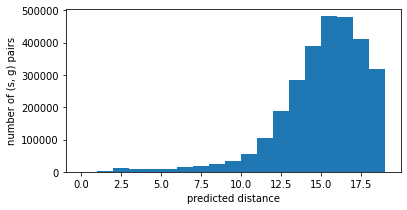

Searching with max steps of  7
Difficulty =  0.8


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


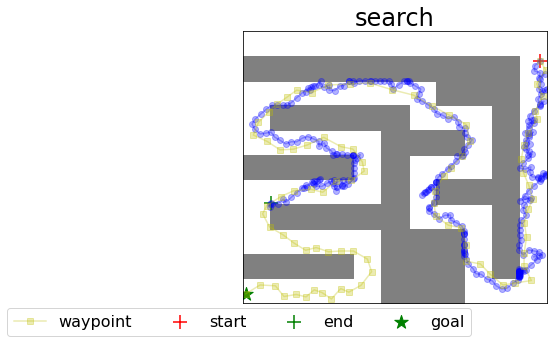

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


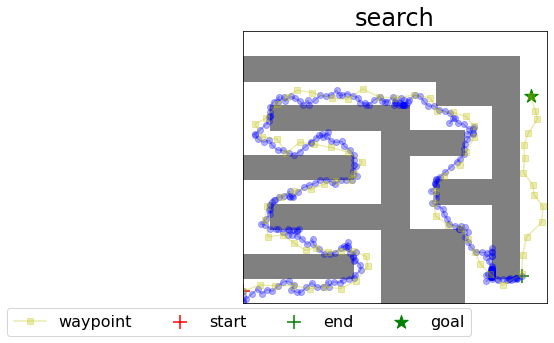

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


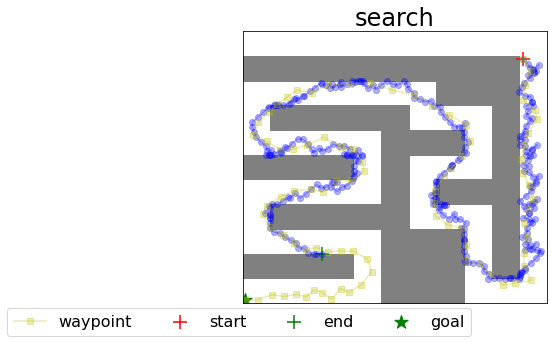

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


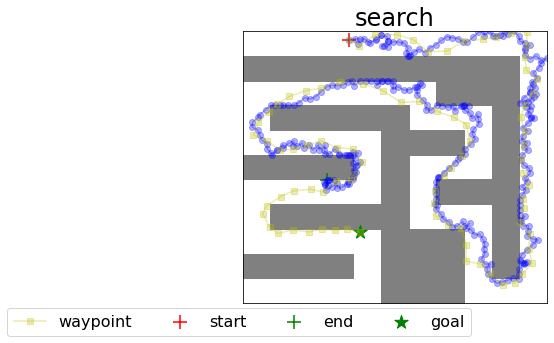

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


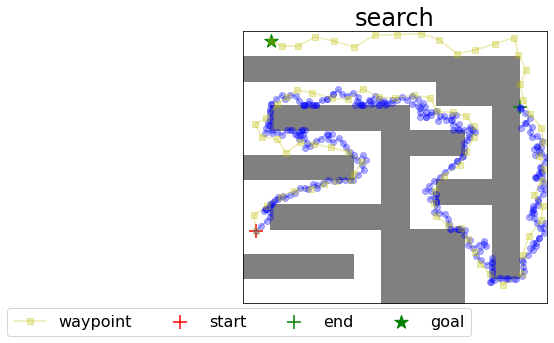

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


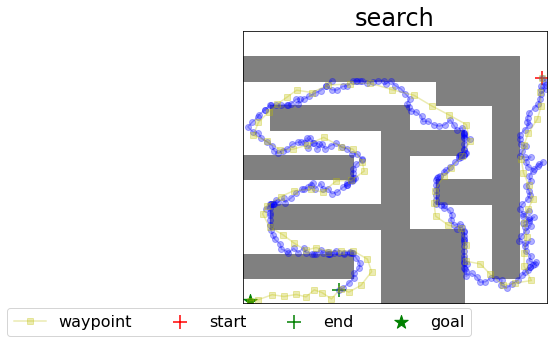

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


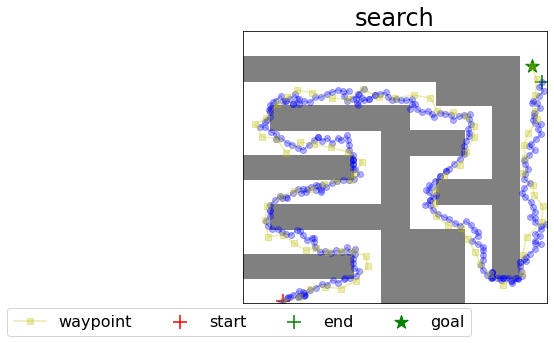

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


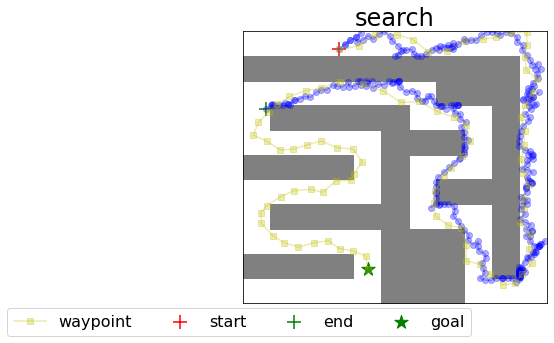

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


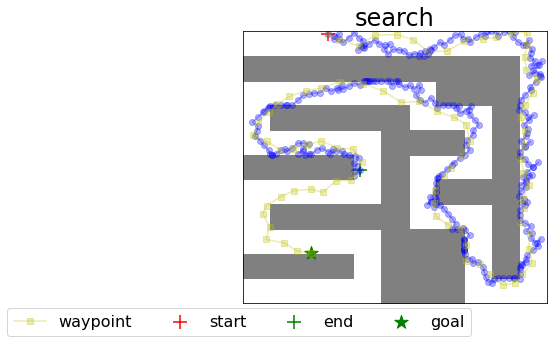

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


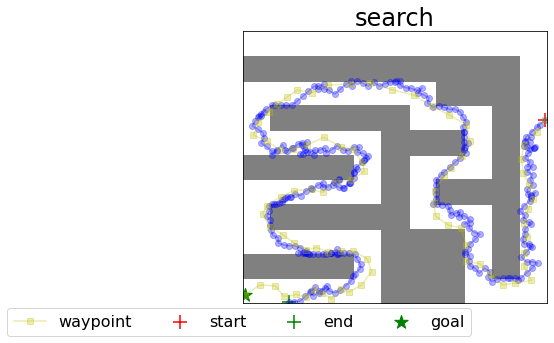

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


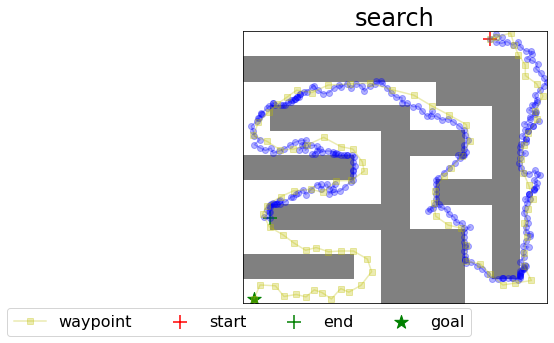

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


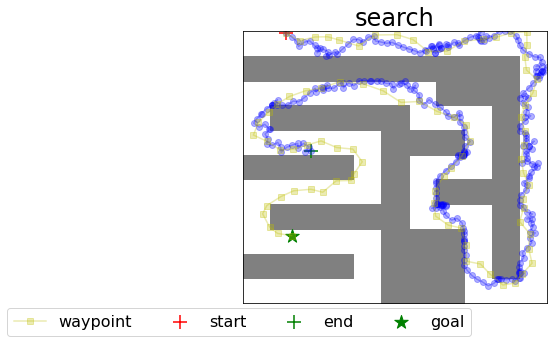

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


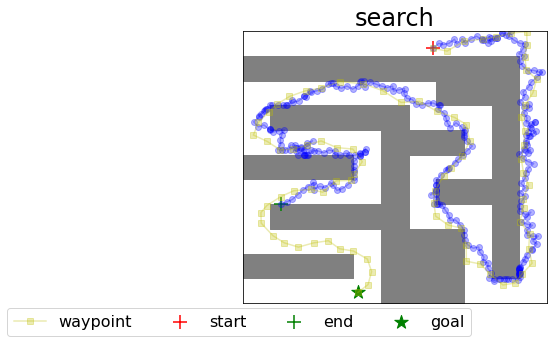

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


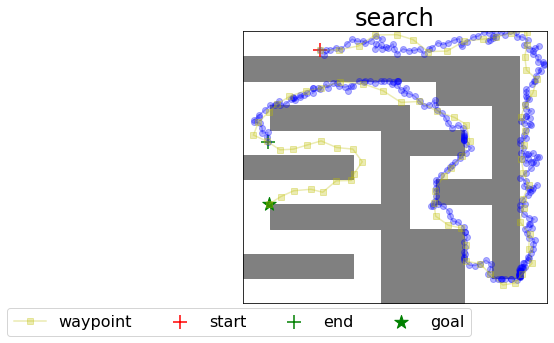

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


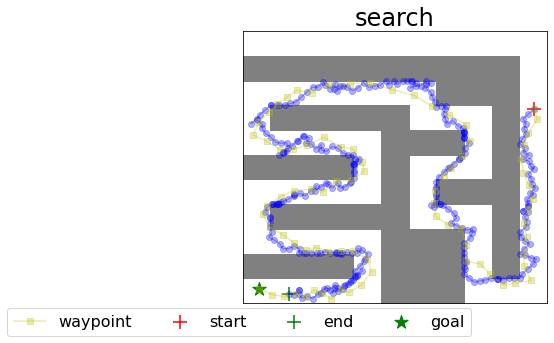

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


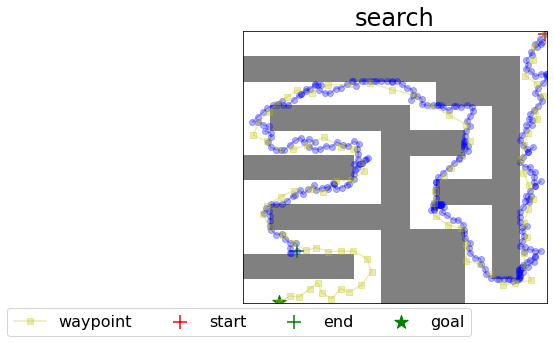

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


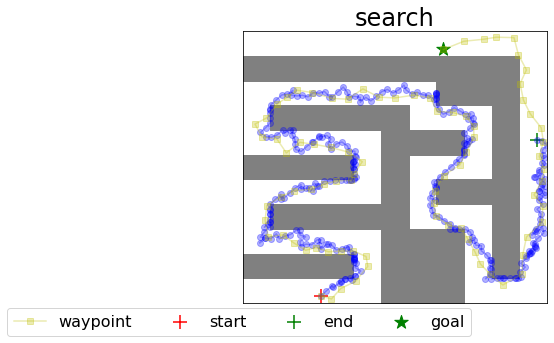

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


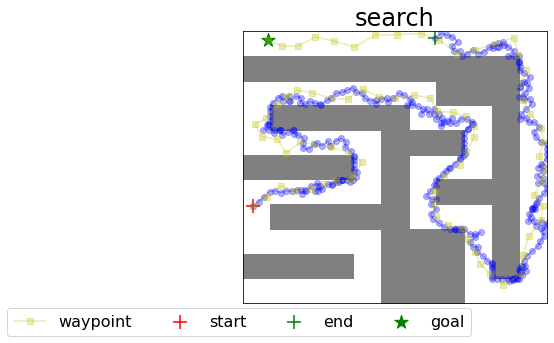

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


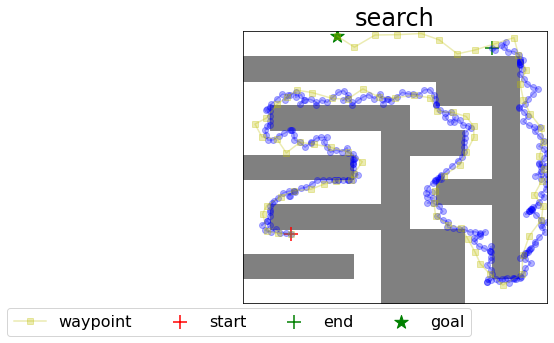

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


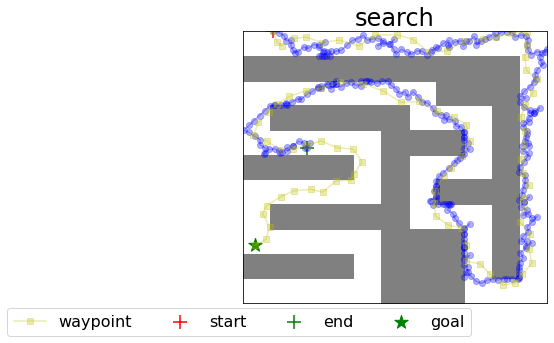

Path success rate is  1.0
Rollout success rate (given path) is  0.0
Average search time (for success) is  20.61147674322128
Search iterations is  300.0


In [0]:
#@title Training Loop for multiple environments
from tensorflow.python.framework import ops
env_names = ['Small', 'Tunnel', 'Tree']

for env_name in env_names:
  print("Training for environment", env_name)
  ops.reset_default_graph()

  max_episode_steps = 20
  resize_factor = 5
  tf_env = env_load_fn(env_name, max_episode_steps, 
                       resize_factor=resize_factor,
                       terminate_on_timeout=False)
  eval_tf_env = env_load_fn(env_name, max_episode_steps,
                          resize_factor=resize_factor,
                          terminate_on_timeout=True)
  agent = UvfAgent(
      tf_env.time_step_spec(),
      tf_env.action_spec(),
      max_episode_steps=max_episode_steps,
      use_distributional_rl=True,
      ensemble_size=3)

  _, distances, times = train_eval(
      agent,
      tf_env,
      eval_tf_env,
      initial_collect_steps=1000,
      eval_interval=1000,
      num_eval_episodes=10,
      num_iterations=30000,
  )

  print("Complete")

  average_error = []
  max_error = []
  for errors in distances:
    average_error.append(np.mean(errors))
    max_error.append(np.max(errors))

  plt.figure(159)
  plt.plot(average_error, label='average_error')
  plt.plot(max_error, label='max_error')
  plt.xlabel("Iteration")
  plt.ylabel("Distance error")
  plt.title("Distance errors throughout training")
  plt.legend()
  plt.show()

  plt.figure(1591)
  plt.plot(times, label='Training Time')
  plt.xlabel("Iteration")
  plt.ylabel("Training Time")
  plt.title("Training times per iteration")
  plt.legend()
  plt.show()

  replay_buffer_size = 1000

  eval_tf_env.pyenv.envs[0].gym.set_sample_goal_args(
      prob_constraint=0.0,
      min_dist=0,
      max_dist=np.inf)
  rb_vec = []
  for _ in tqdm.tnrange(replay_buffer_size):
    ts = eval_tf_env.reset()
    rb_vec.append(ts.observation['observation'].numpy()[0])
  rb_vec = np.array(rb_vec)

  plt.figure(figsize=(6, 6))
  plt.scatter(*rb_vec.T)
  plot_walls(eval_tf_env.pyenv.envs[0].env.walls)
  plt.show()

  pdist = agent._get_pairwise_dist(rb_vec, aggregate=None).numpy()
  plt.figure(figsize=(6, 3))
  plt.hist(pdist.flatten(), bins=range(20))
  plt.xlabel('predicted distance')
  plt.ylabel('number of (s, g) pairs')
  plt.show()

  max_steps = 7

  agent.initialize_search(rb_vec, max_search_steps=max_steps)
  search_policy = SearchPolicy(agent, open_loop=True)

  print("Searching with max steps of ", max_steps)
  print("==================================")
  difficulties = [0.8]

  for difficulty in difficulties:
    print("Difficulty = ", difficulty)
    N = 20
    success = 0
    rollout_succ = 0
    search_time_success = []
    search_iterations = []

    for i in range(N):
      start_time = time.time()
      try:
        dura = 300
        eval_tf_env.pyenv.envs[0]._duration = dura
        seed = np.random.randint(0, 1000000)

        max_goal_dist = eval_tf_env.pyenv.envs[0].gym.max_goal_dist
        eval_tf_env.pyenv.envs[0].gym.set_sample_goal_args(
            prob_constraint=1.0,
            min_dist=max(0, max_goal_dist * (difficulty - 0.05)),
            max_dist=max_goal_dist * (difficulty + 0.05))


        plt.figure(figsize=(12, 5))
        for col_index in range(2):
          if col_index == 0:
            continue
          title = 'no search' if col_index == 0 else 'search'
          plt.subplot(1, 2, col_index + 1)
          plot_walls(eval_tf_env.pyenv.envs[0].env.walls)
          use_search = (col_index == 1)
          np.random.seed(seed)
          ts = eval_tf_env.reset()
          goal = ts.observation['goal'].numpy()[0]
          start = ts.observation['observation'].numpy()[0]
          obs_vec = []
          for _ in tqdm.tnrange(eval_tf_env.pyenv.envs[0]._duration,
                                desc='rollout %d / 2' % (col_index + 1)):
            if ts.is_last():
              break
            obs_vec.append(ts.observation['observation'].numpy()[0])
            if use_search:
              action = search_policy.action(ts)
            else:
              action = agent.policy.action(ts)

            ts = eval_tf_env.step(action)

          obs_vec = np.array(obs_vec)

          plt.plot(obs_vec[:, 0], obs_vec[:, 1], 'b-o', alpha=0.3)
          plt.scatter([obs_vec[0, 0]], [obs_vec[0, 1]], marker='+',
                      color='red', s=200, label='start')
          plt.scatter([obs_vec[-1, 0]], [obs_vec[-1, 1]], marker='+',
                      color='green', s=200, label='end')
          plt.scatter([goal[0]], [goal[1]], marker='*',
                      color='green', s=200, label='goal')

          plt.title(title, fontsize=24)
          if use_search:
            waypoint_vec = [start]
            for waypoint_index in search_policy._waypoint_vec:
              waypoint_vec.append(rb_vec[waypoint_index])
            waypoint_vec.append(goal)
            waypoint_vec = np.array(waypoint_vec)

            plt.plot(waypoint_vec[:, 0], waypoint_vec[:, 1], 'y-s', alpha=0.3, label='waypoint')
            plt.legend(loc='lower left', bbox_to_anchor=(-0.8, -0.15), ncol=4, fontsize=16)
        plt.show()

      
        # search_policy.action(ts)
        roll_len = len(obs_vec)
        search_iterations.append(roll_len)
        search_time_success.append(time.time() - start_time)

        success += 1
        if roll_len < dura:
          rollout_succ += 1
      except:
        continue

    print("Path success rate is ", success / N)
    print("Rollout success rate (given path) is ", rollout_succ / success)
    print("Average search time (for success) is ", np.mean(search_time_success))
    print("Search iterations is ", np.mean(search_iterations))
    print("==================================")


Testing transfer learning

FourRooms
Maze11x11


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


random_seed = 0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:67: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


INFO:tensorflow:step = 1000, loss = 2.117450
INFO:tensorflow:59.302 steps/sec
INFO:tensorflow:step = 1000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.10
INFO:tensorflow:		 predicted_dist = 16.1 (0.4)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.70
INFO:tensorflow:		 predicted_dist = 16.1 (0.5)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.6 (0.5)
INFO:tensorflow:	 eval_time = 1.74
INFO:tensorflow:step = 2000, loss = 0.921457
INFO:tensorflow:69.743 steps/sec
INFO:tensorflow:step = 2000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -14.40
INFO:tensorflow:		 predicted_dist = 17.3 (1.1)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.80
INFO:tensorflow:		 predicted_dist = 18.1 (0.6)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 17.3 (1.1)
INFO:tensorflow:	 eval_time = 1.66
INFO:tensorflow:step

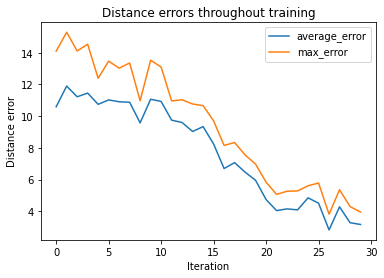

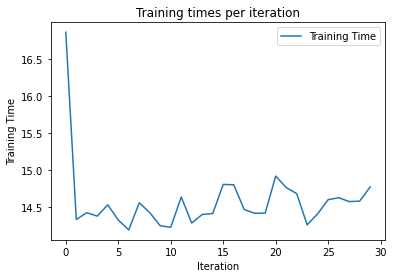

random_seed = 0


INFO:tensorflow:step = 31000, loss = 3.210000
INFO:tensorflow:61.012 steps/sec
INFO:tensorflow:step = 31000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -3.20
INFO:tensorflow:		 predicted_dist = 5.0 (2.0)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -8.00
INFO:tensorflow:		 predicted_dist = 8.3 (0.6)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -15.30
INFO:tensorflow:		 predicted_dist = 11.3 (1.0)
INFO:tensorflow:	 eval_time = 1.46
INFO:tensorflow:step = 32000, loss = 2.668599
INFO:tensorflow:67.566 steps/sec
INFO:tensorflow:step = 32000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -4.00
INFO:tensorflow:		 predicted_dist = 6.3 (1.7)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -8.40
INFO:tensorflow:		 predicted_dist = 8.8 (1.2)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -16.50
INFO:tensorflow:		 predicted_dist = 12.5 (1.0)
INFO:tensorflow:	 eval_time = 1.33
INFO:tensorflow:step = 3

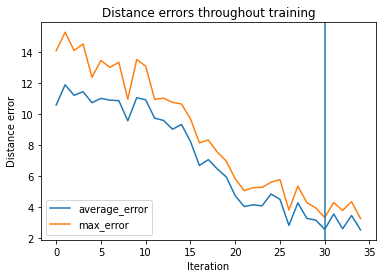

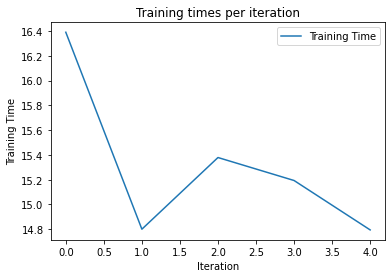

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:126: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


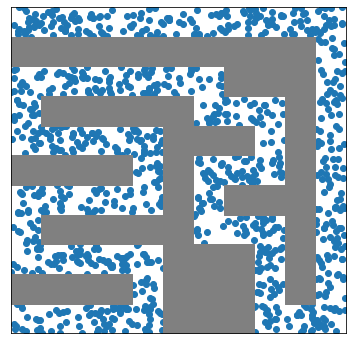

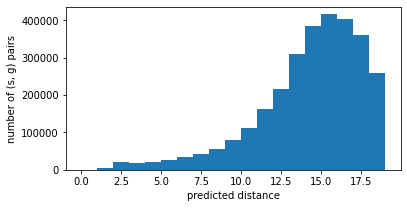

Searching with max steps of  7
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


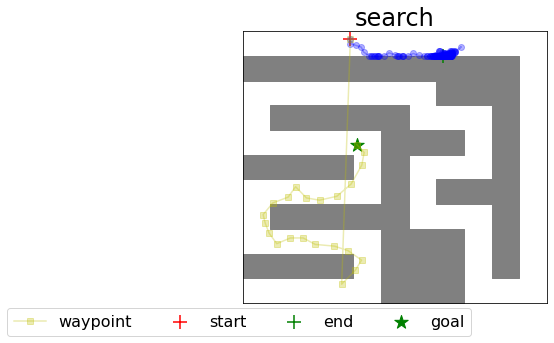

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


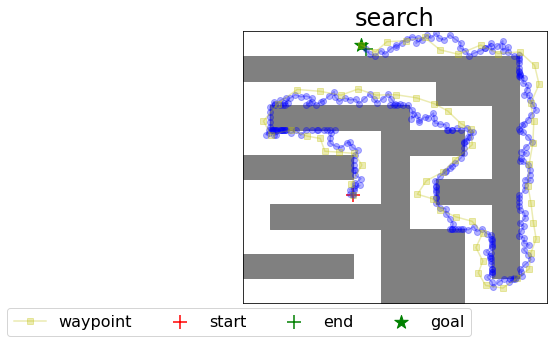

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


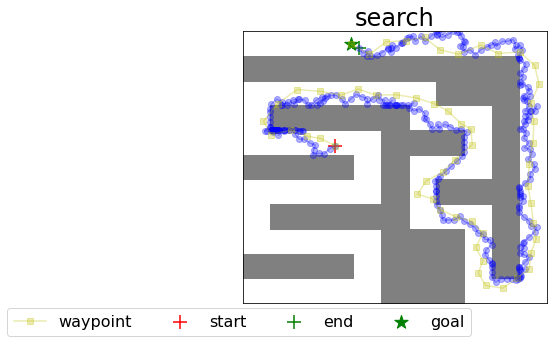

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


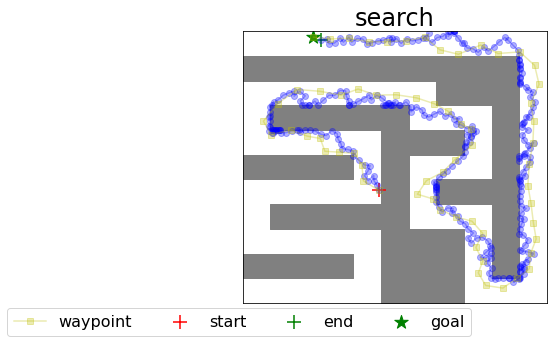

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


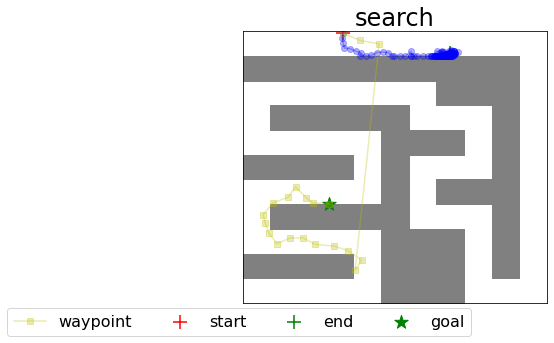

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


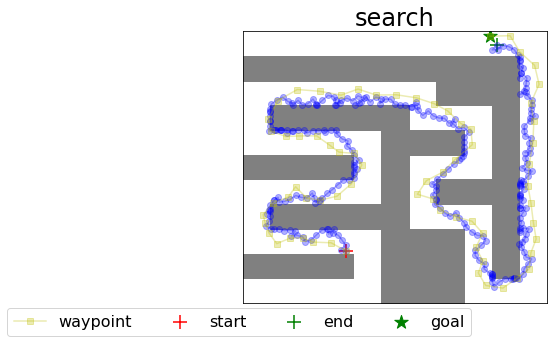

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


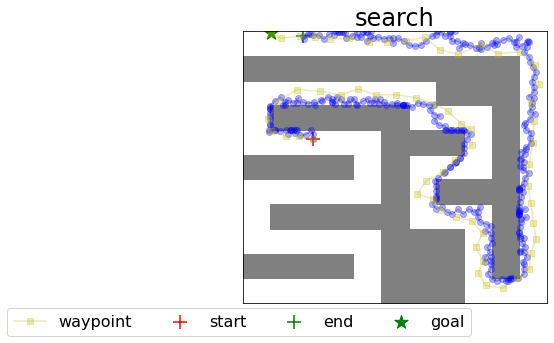

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


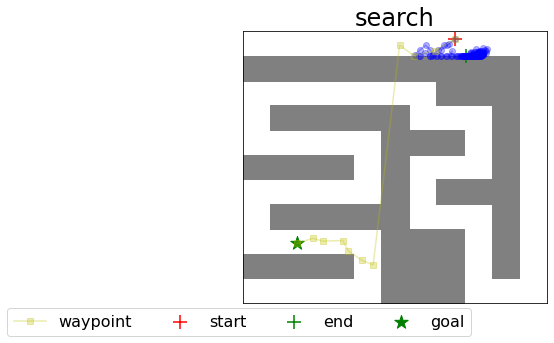

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


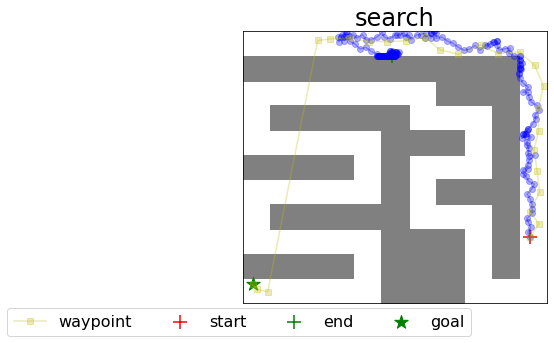

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


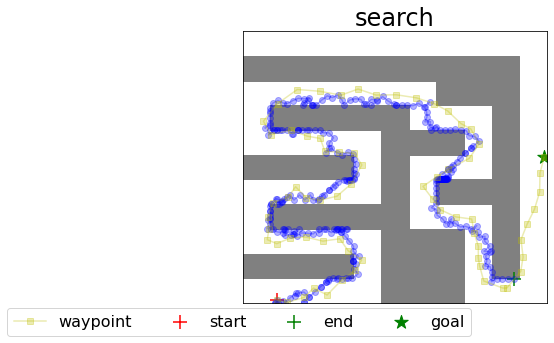

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


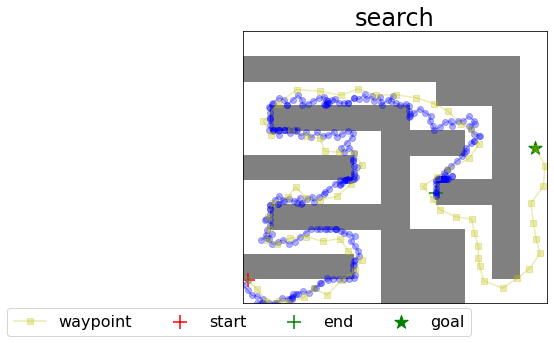

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


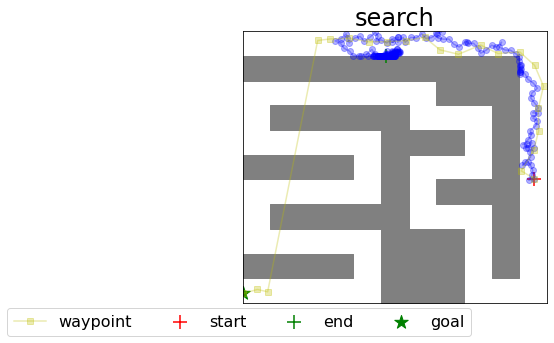

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


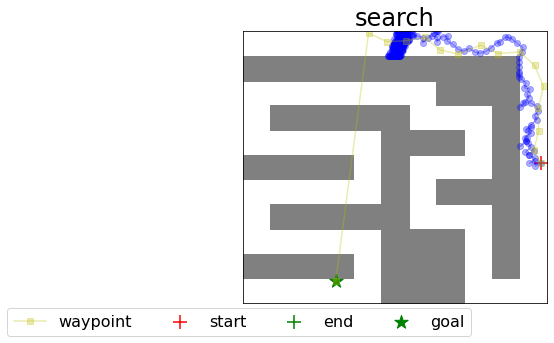

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


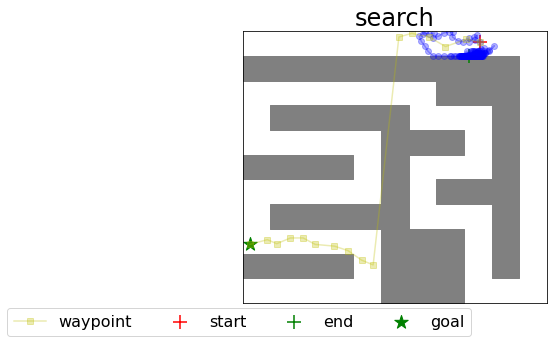

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


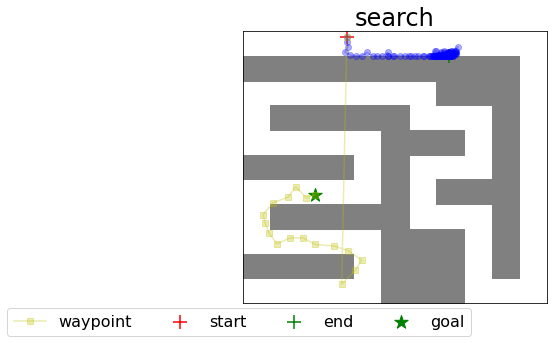

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


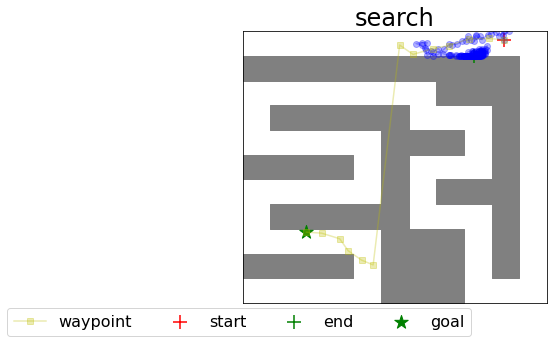

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


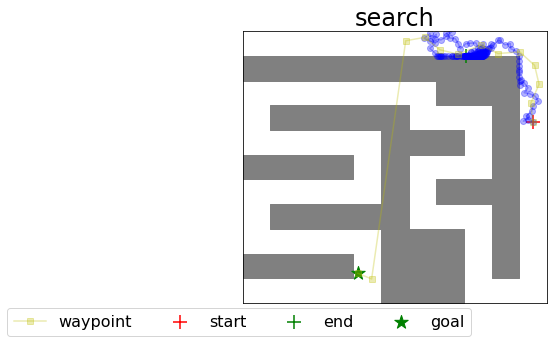

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


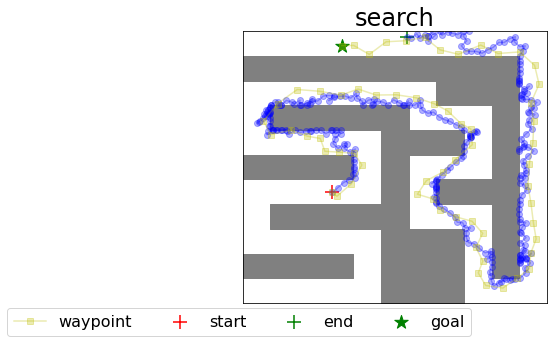

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


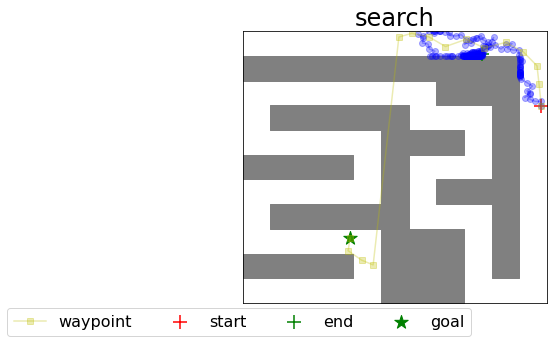

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


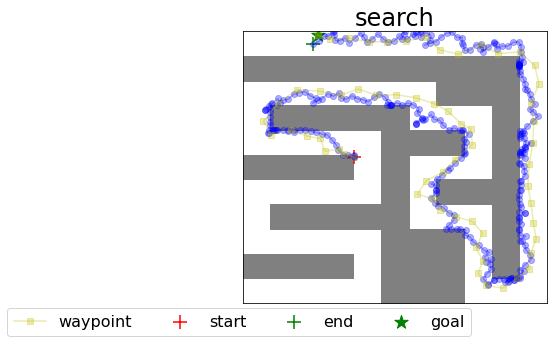

Path success rate is  1.0
Rollout success rate (given path) is  0.15
Average search time (for success) is  20.800702774524687
Search iterations is  298.5
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


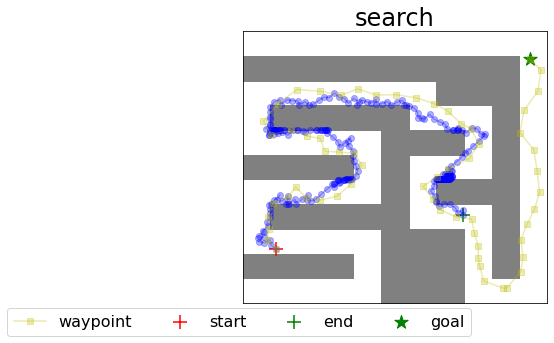

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


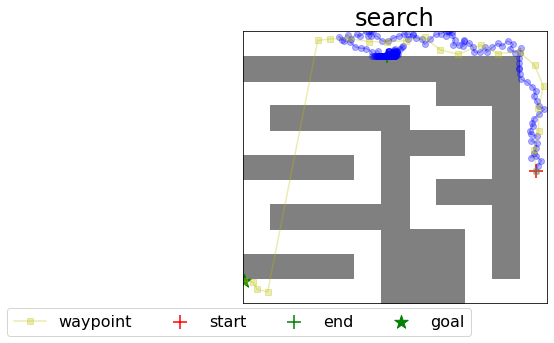

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


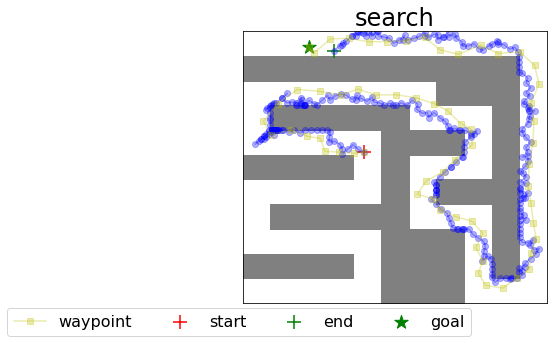

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


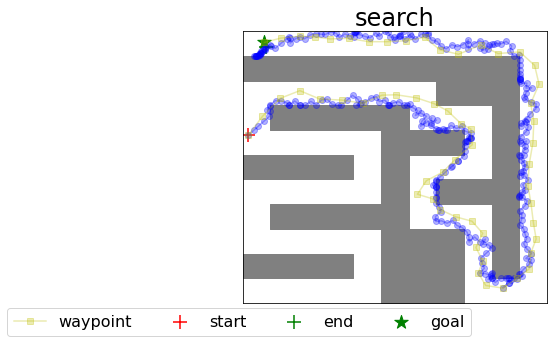

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


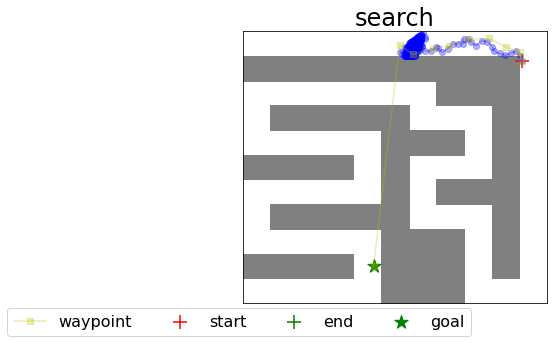

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


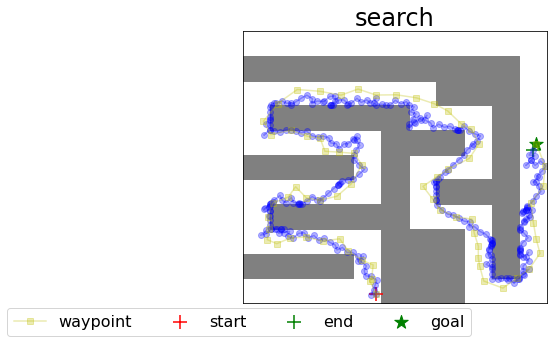

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


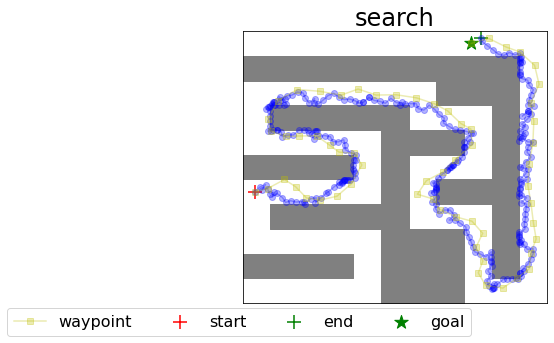

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


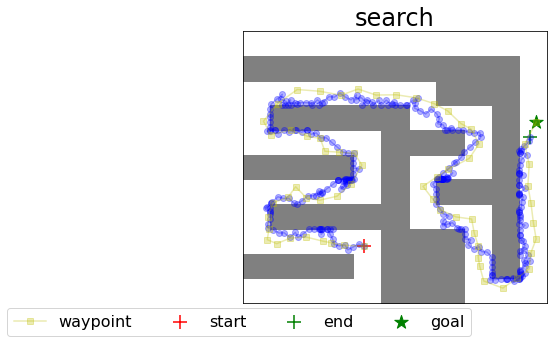

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


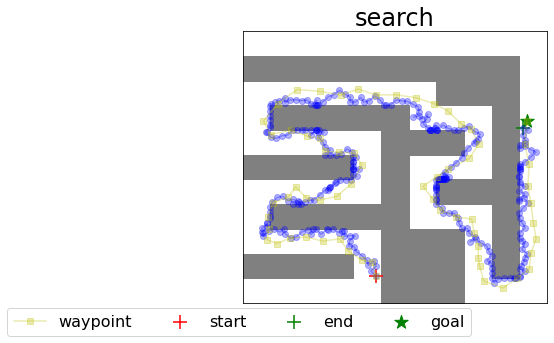

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


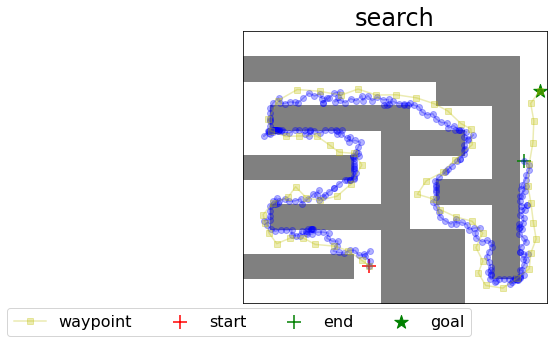

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


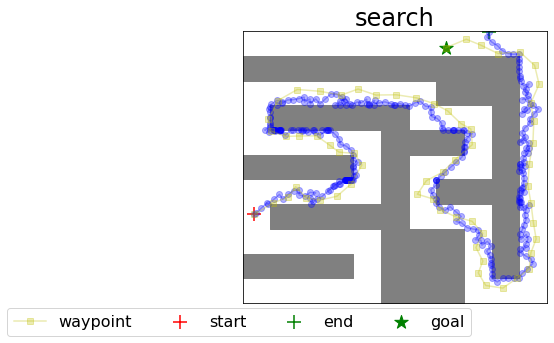

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


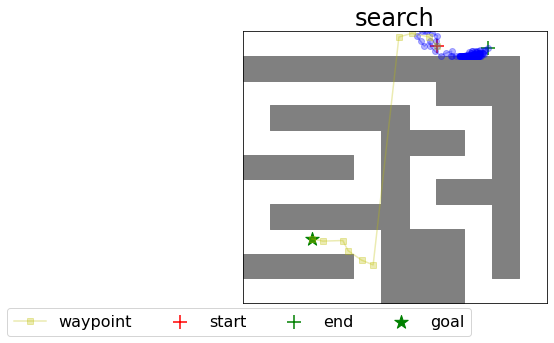

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


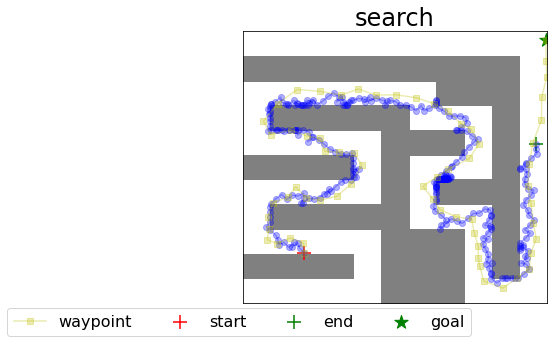

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


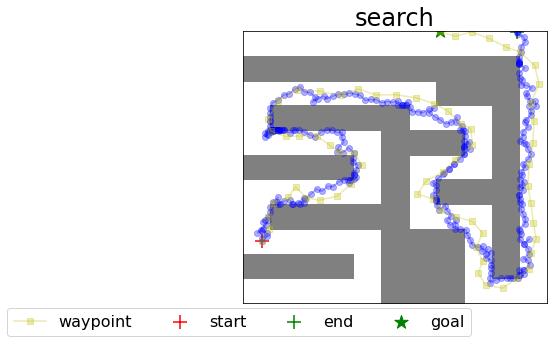

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


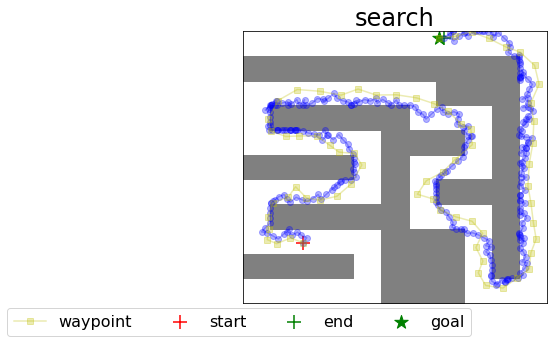

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


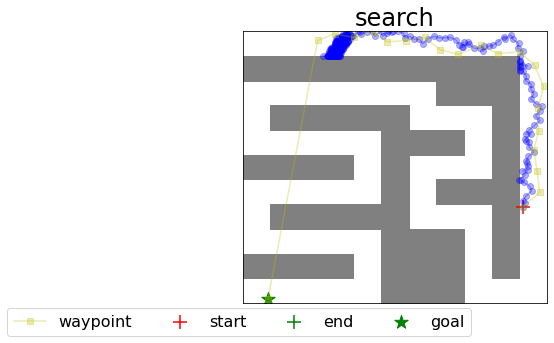

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


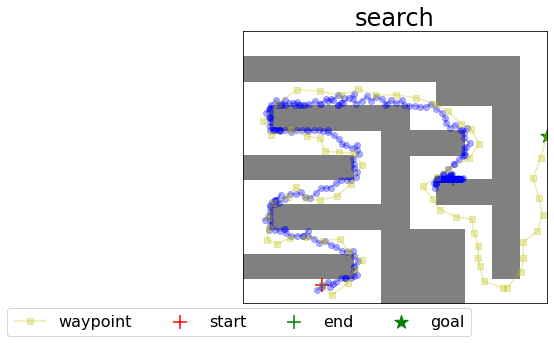

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


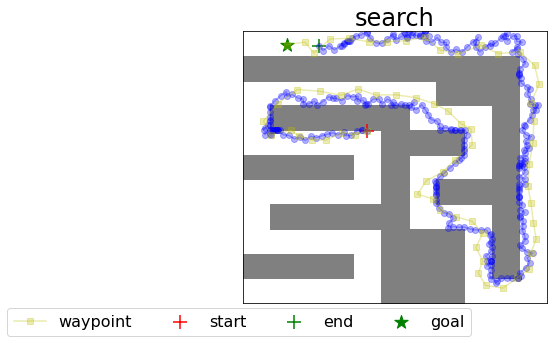

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


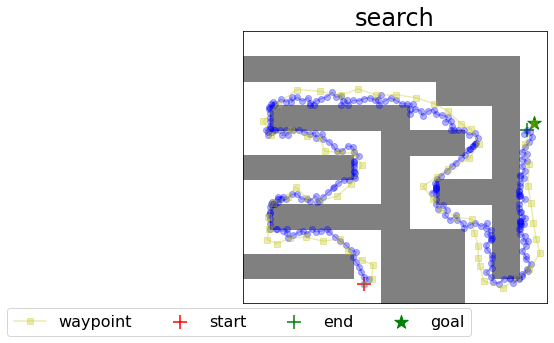

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


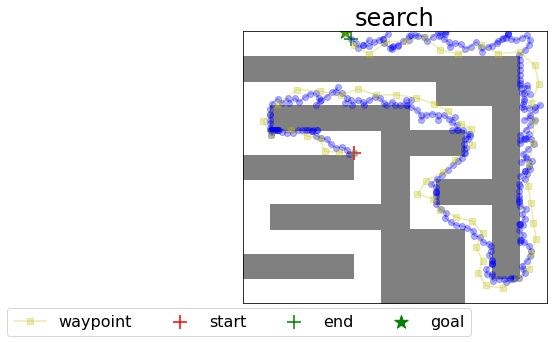

Path success rate is  1.0
Rollout success rate (given path) is  0.3
Average search time (for success) is  21.0480229139328
Search iterations is  297.25
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


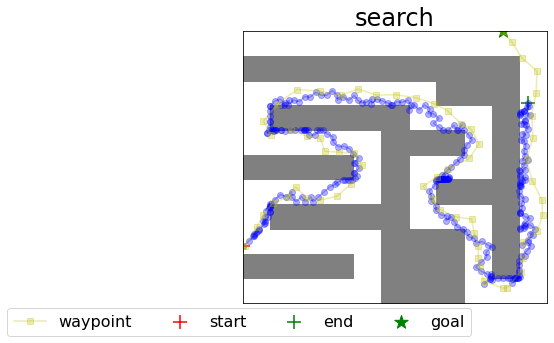

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


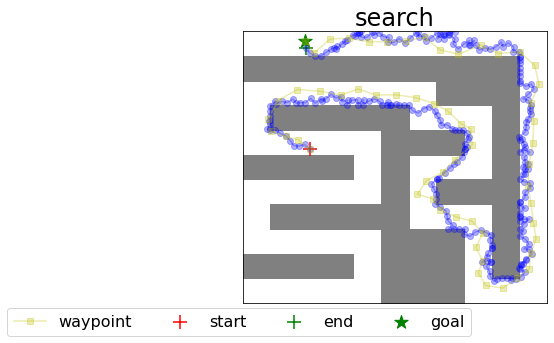

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


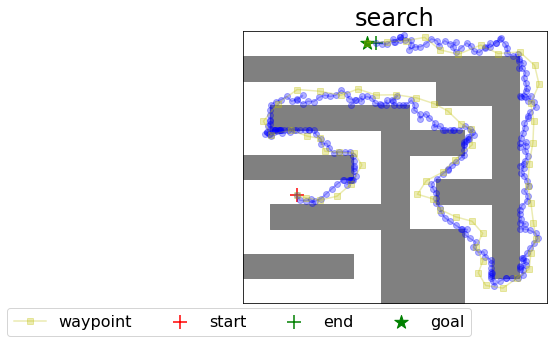

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


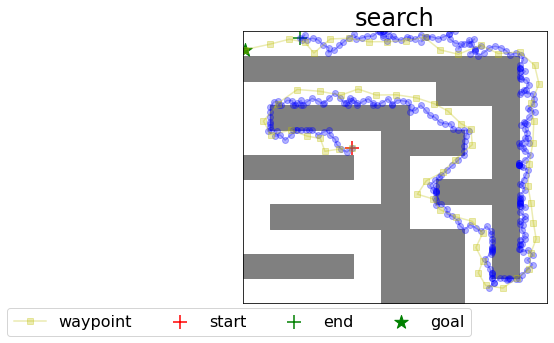

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


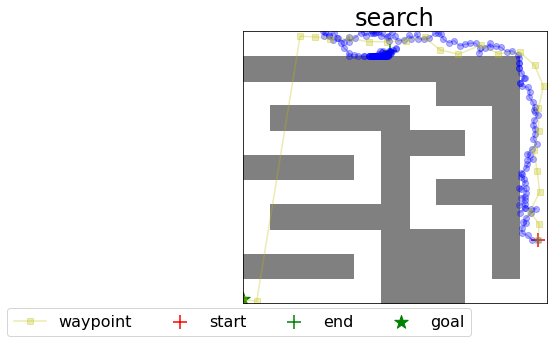

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


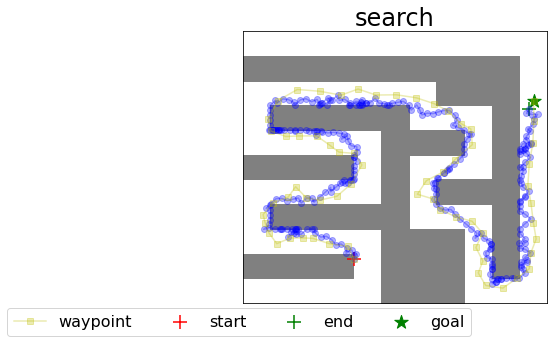

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


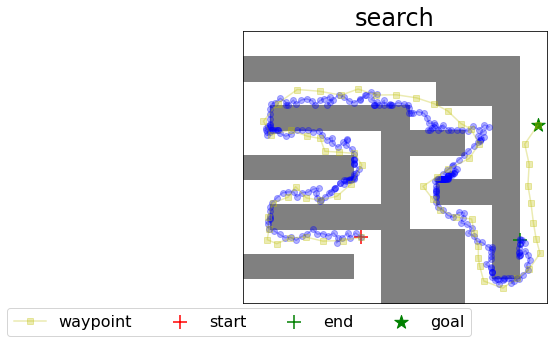

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


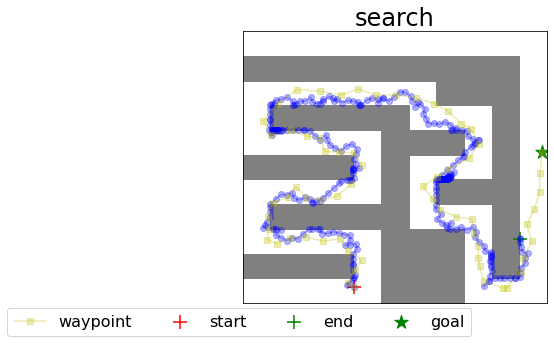

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


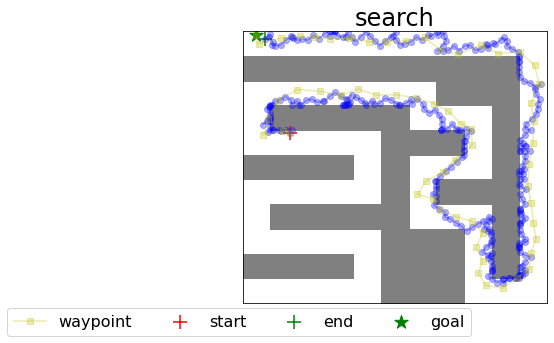

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


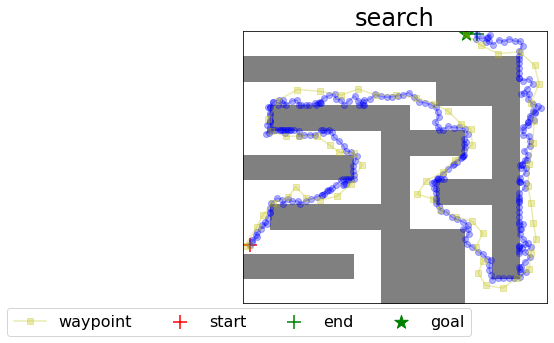

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


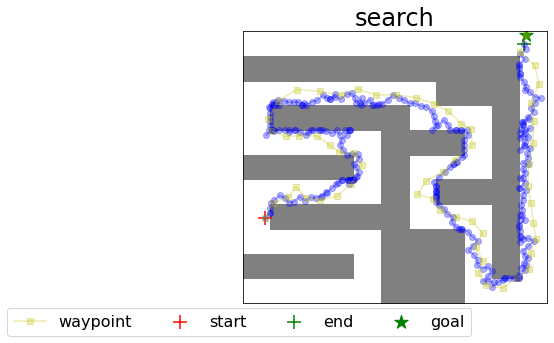

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


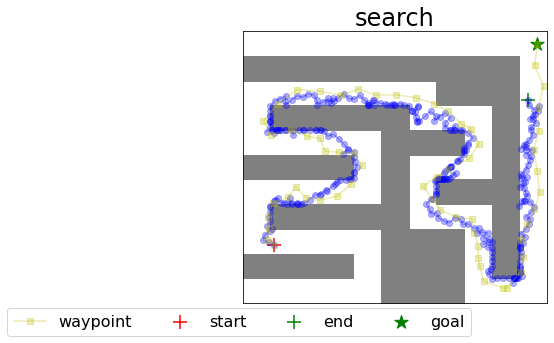

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


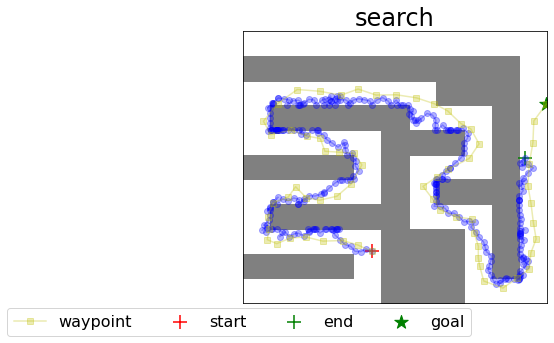

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


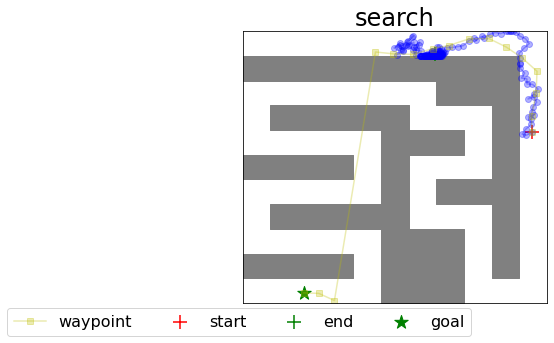

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


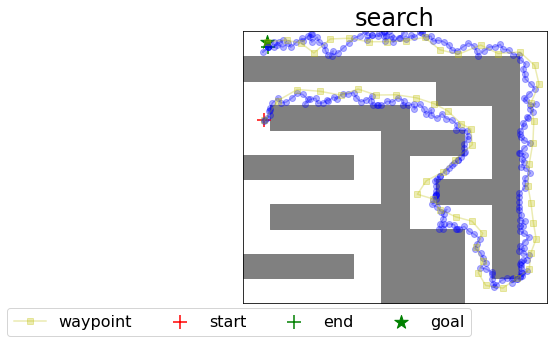

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


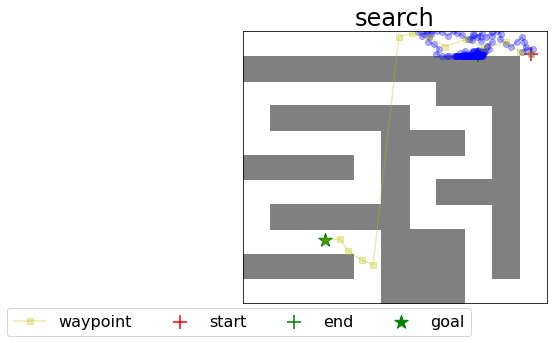

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


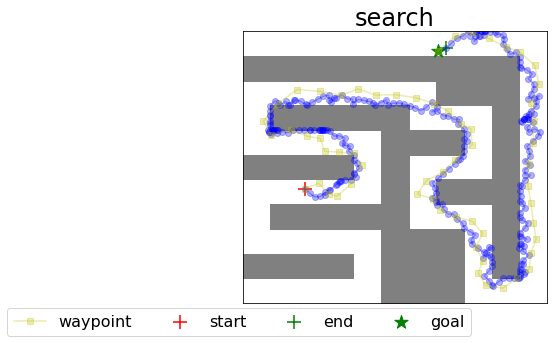

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


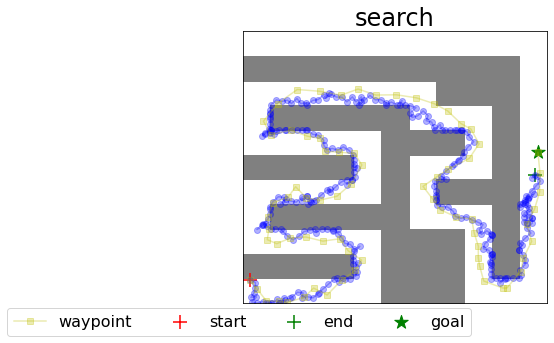

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


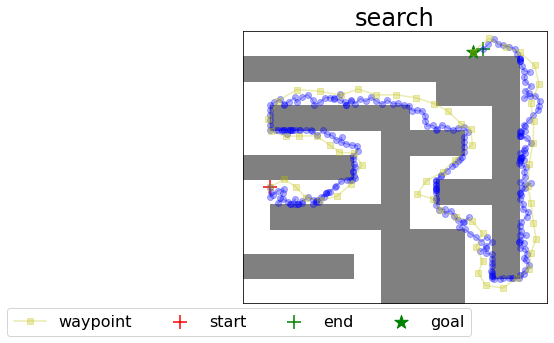

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


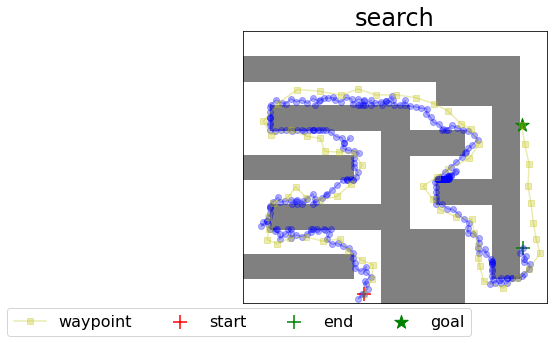

Path success rate is  1.0
Rollout success rate (given path) is  0.35
Average search time (for success) is  20.825522315502166
Search iterations is  291.15
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


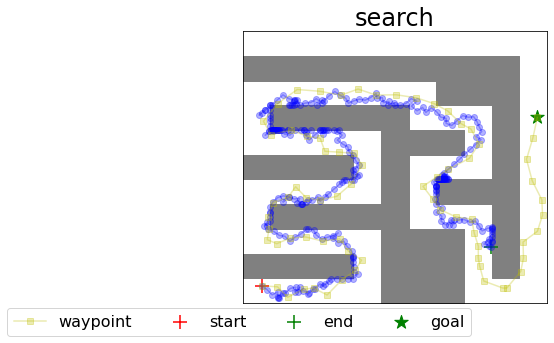

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


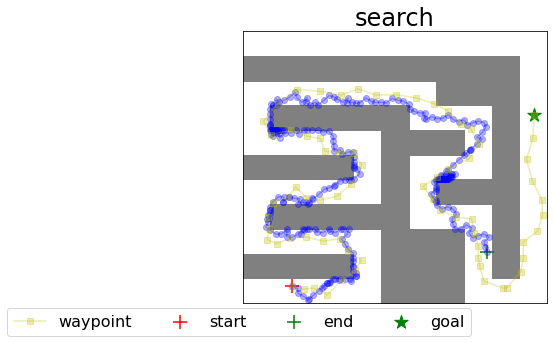

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


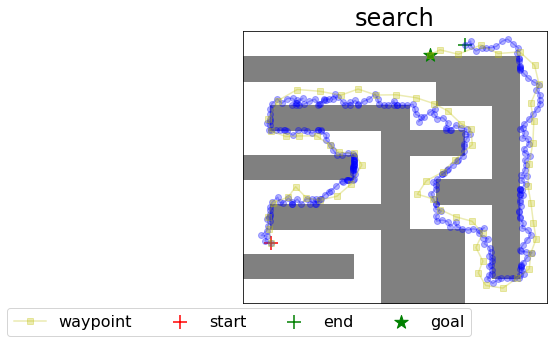

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


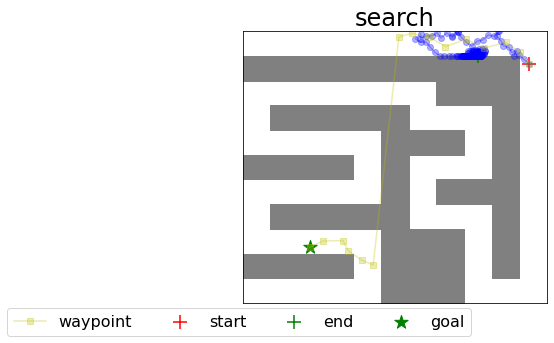

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


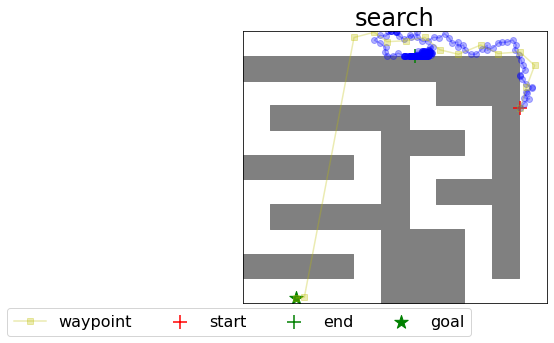

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


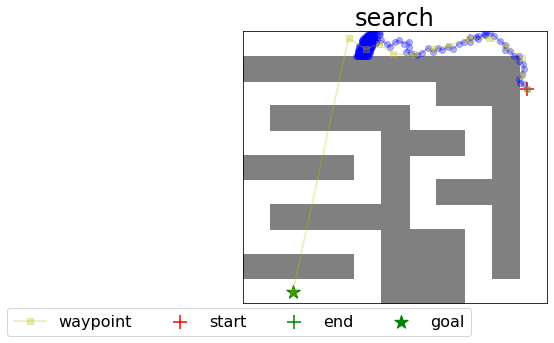

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


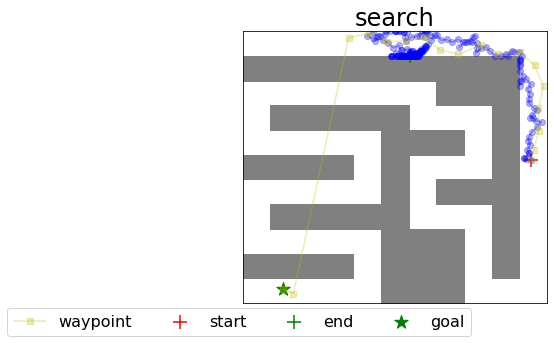

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


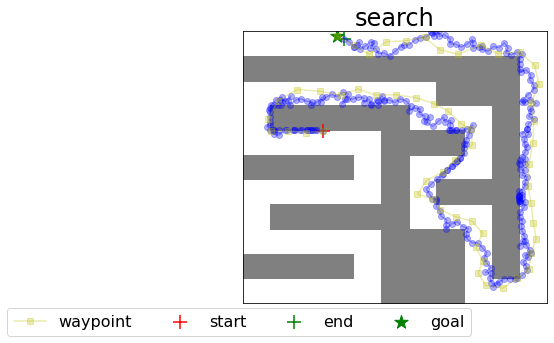

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


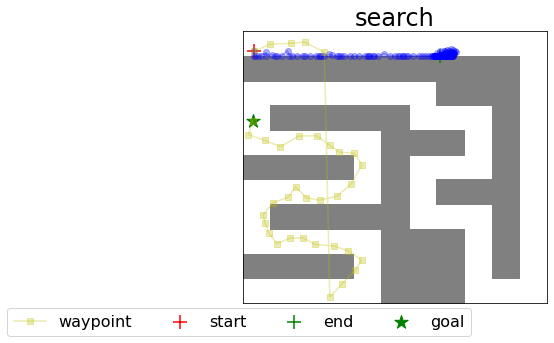

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


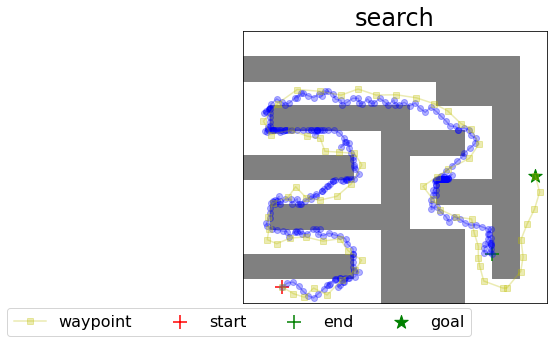

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


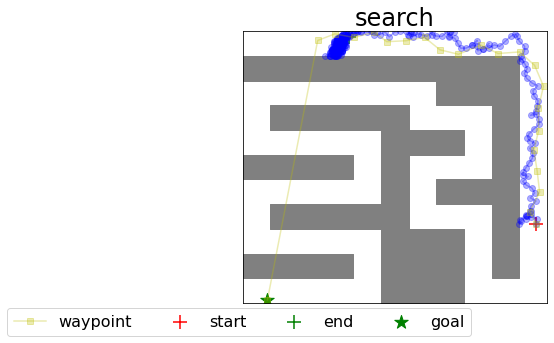

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


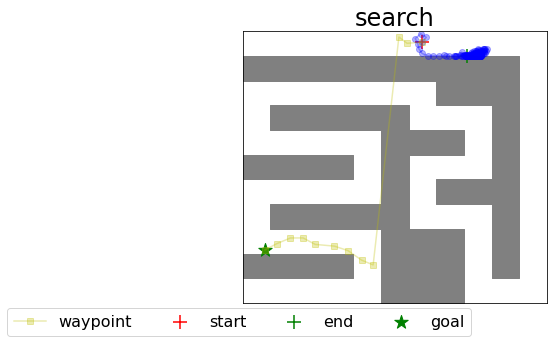

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


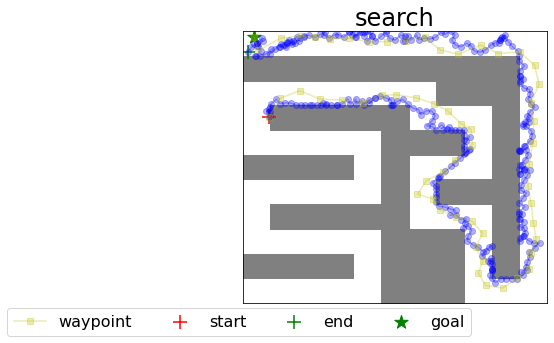

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


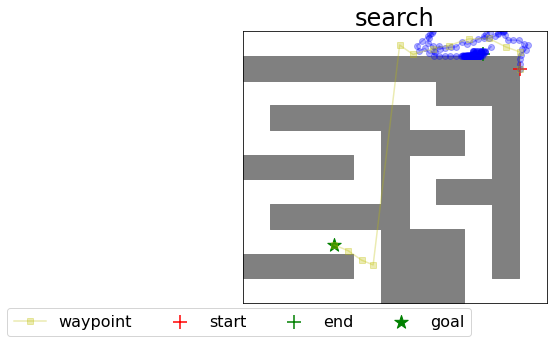

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


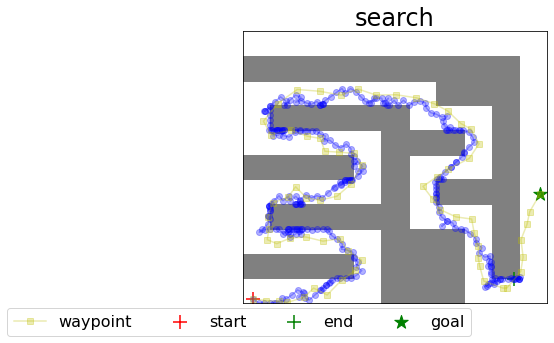

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


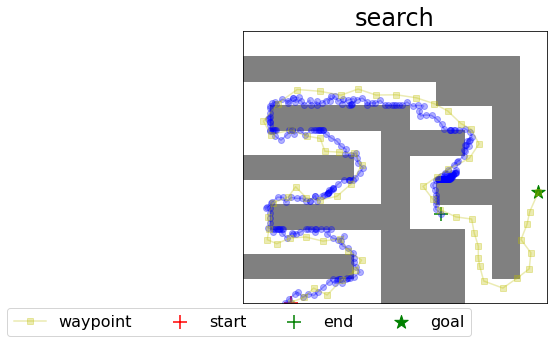

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


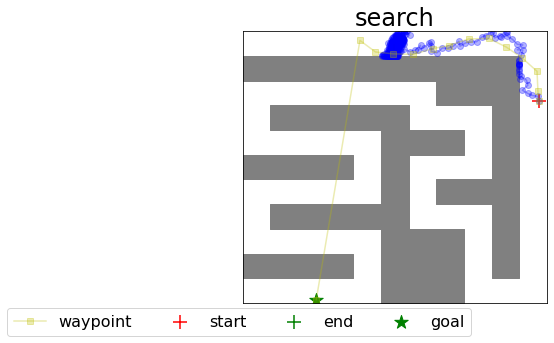

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


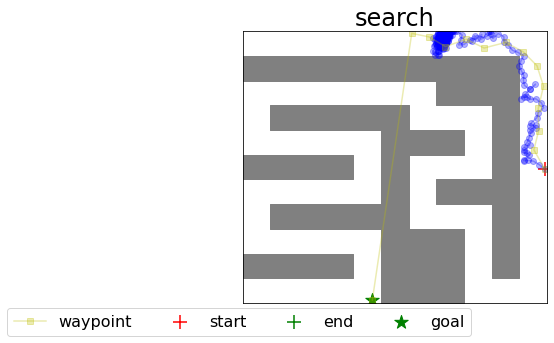

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


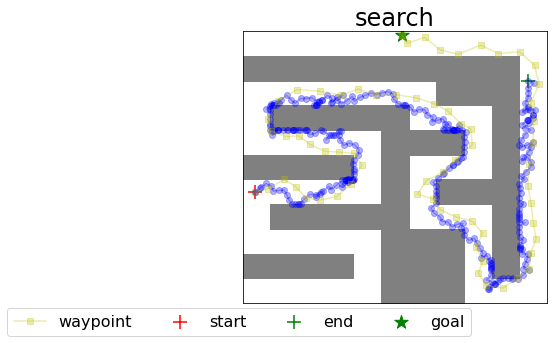

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


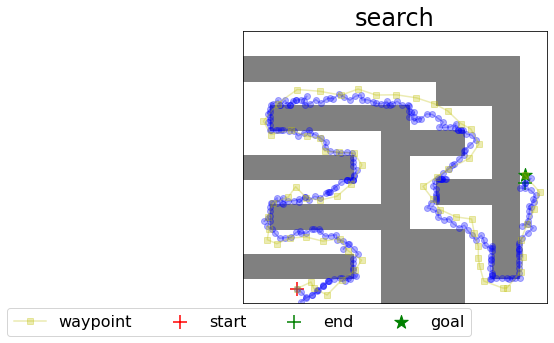

Path success rate is  1.0
Rollout success rate (given path) is  0.1
Average search time (for success) is  20.78464801311493
Search iterations is  297.7
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


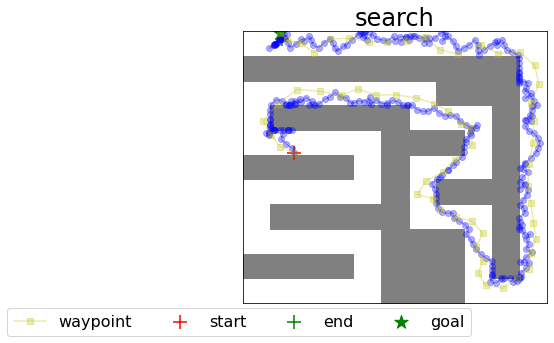

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


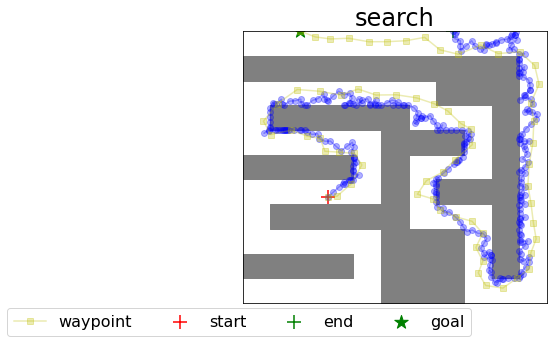

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


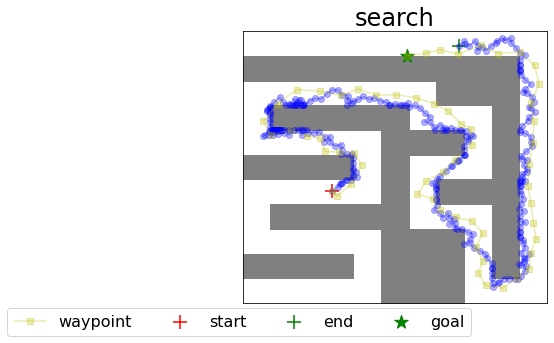

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


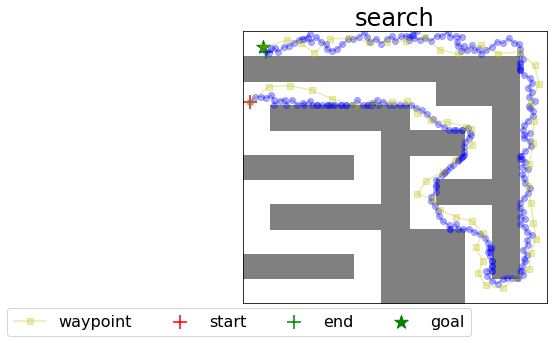

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


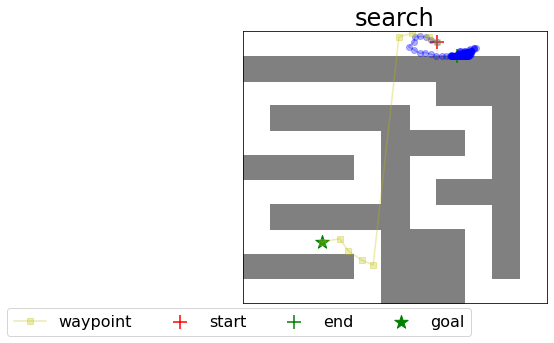

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


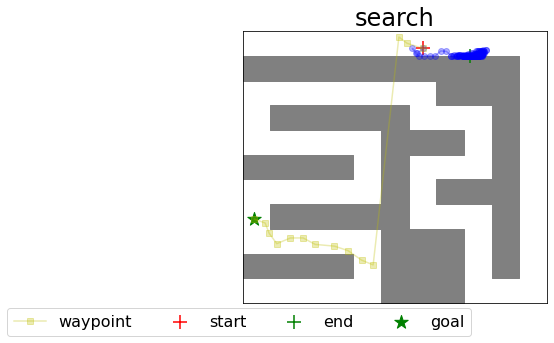

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


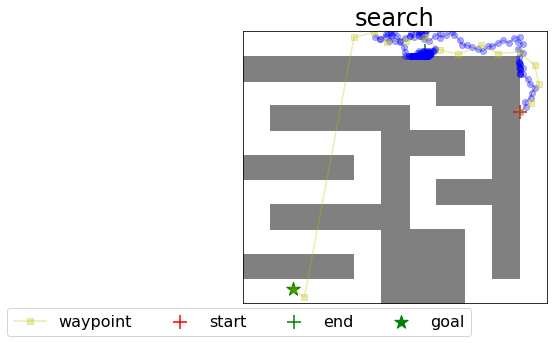

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


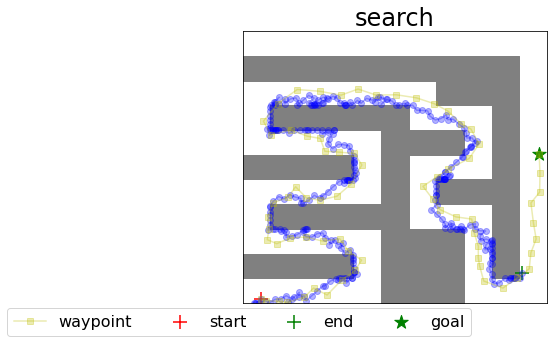

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


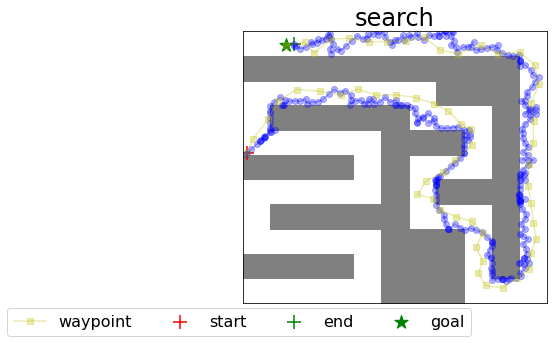

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


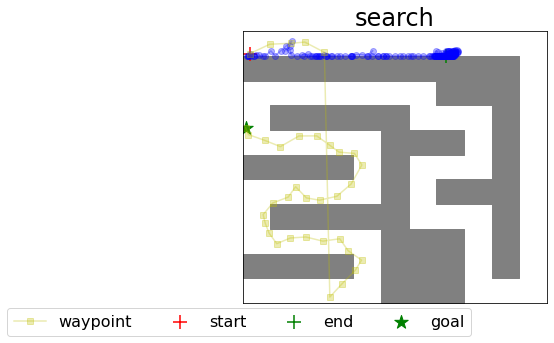

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


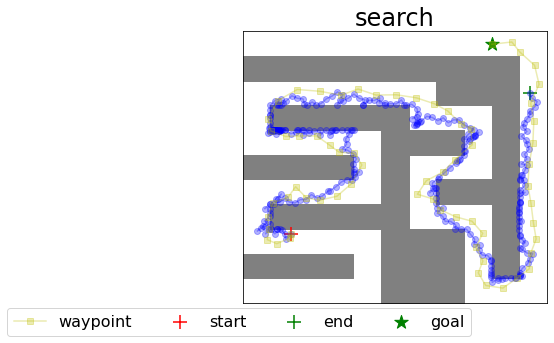

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


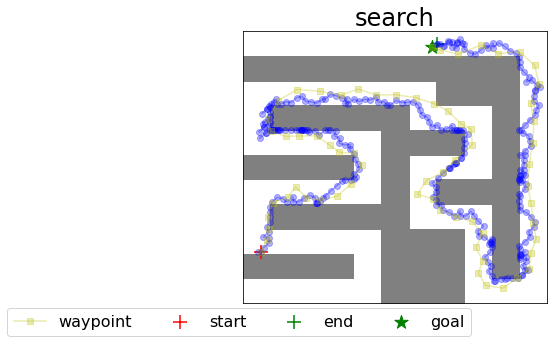

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


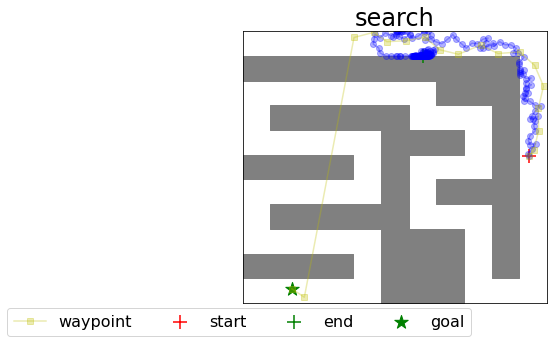

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


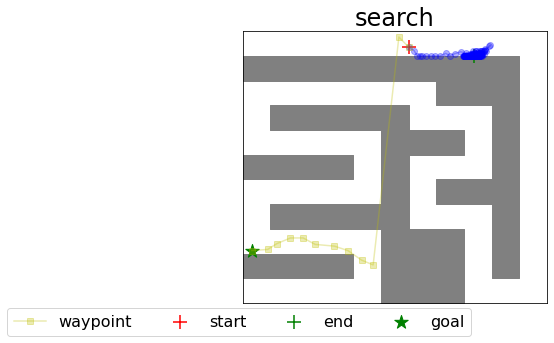

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


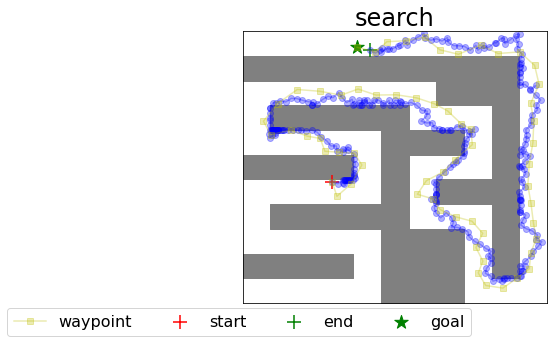

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


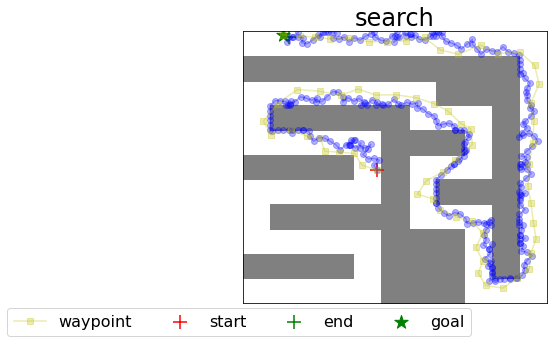

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


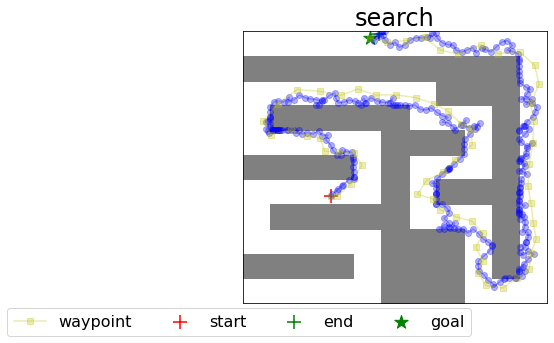

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


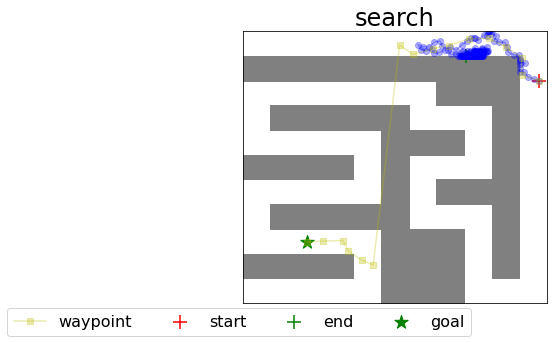

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


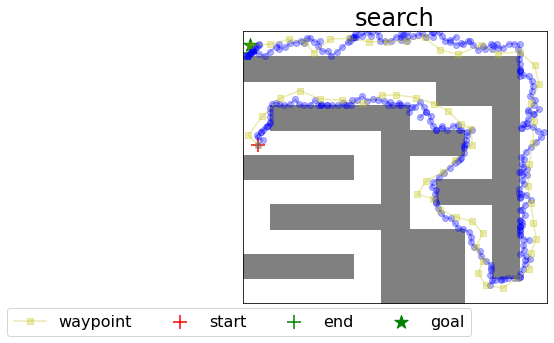

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


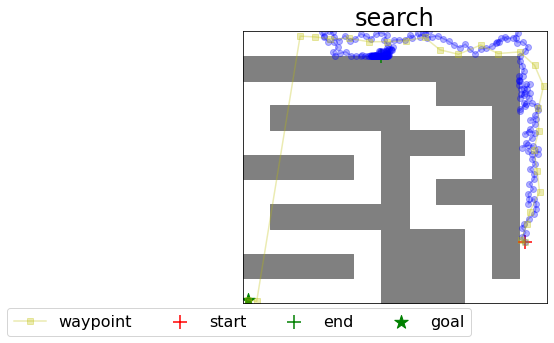

Path success rate is  1.0
Rollout success rate (given path) is  0.25
Average search time (for success) is  20.80011554956436
Search iterations is  295.7
FourRooms
Spiral11x11


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


random_seed = 0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:67: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


INFO:tensorflow:step = 1000, loss = 2.117450
INFO:tensorflow:58.869 steps/sec
INFO:tensorflow:step = 1000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.10
INFO:tensorflow:		 predicted_dist = 16.1 (0.4)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.70
INFO:tensorflow:		 predicted_dist = 16.1 (0.5)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.6 (0.5)
INFO:tensorflow:	 eval_time = 1.77
INFO:tensorflow:step = 2000, loss = 0.921457
INFO:tensorflow:70.139 steps/sec
INFO:tensorflow:step = 2000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -14.40
INFO:tensorflow:		 predicted_dist = 17.3 (1.1)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.80
INFO:tensorflow:		 predicted_dist = 18.1 (0.6)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 17.3 (1.1)
INFO:tensorflow:	 eval_time = 1.71
INFO:tensorflow:step

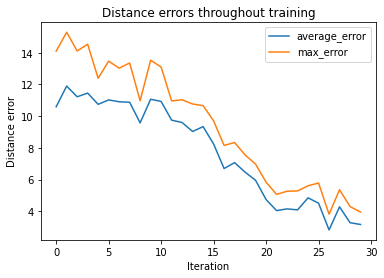

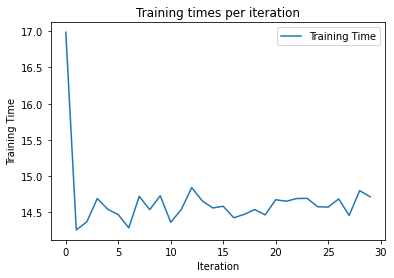

random_seed = 0


INFO:tensorflow:step = 31000, loss = 2.920805
INFO:tensorflow:60.768 steps/sec
INFO:tensorflow:step = 31000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -4.30
INFO:tensorflow:		 predicted_dist = 5.0 (1.9)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -6.70
INFO:tensorflow:		 predicted_dist = 9.1 (1.0)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -14.70
INFO:tensorflow:		 predicted_dist = 12.4 (0.9)
INFO:tensorflow:	 eval_time = 1.41
INFO:tensorflow:step = 32000, loss = 3.112553
INFO:tensorflow:67.369 steps/sec
INFO:tensorflow:step = 32000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -3.60
INFO:tensorflow:		 predicted_dist = 5.4 (1.8)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -8.90
INFO:tensorflow:		 predicted_dist = 9.0 (0.9)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -16.90
INFO:tensorflow:		 predicted_dist = 12.2 (0.8)
INFO:tensorflow:	 eval_time = 1.37
INFO:tensorflow:step = 3

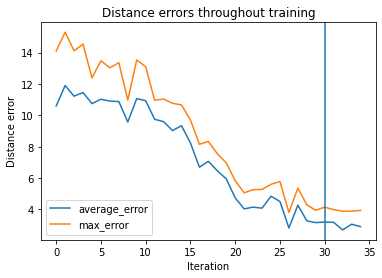

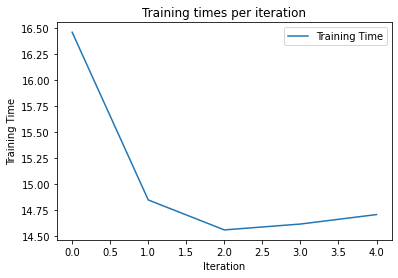

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:126: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


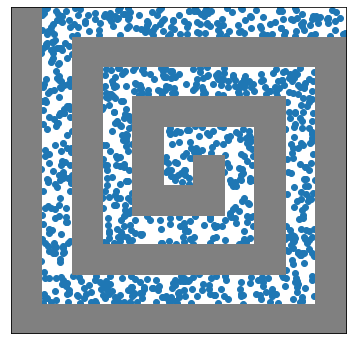

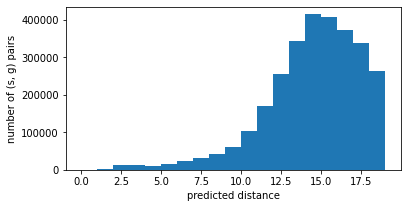

Searching with max steps of  7
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


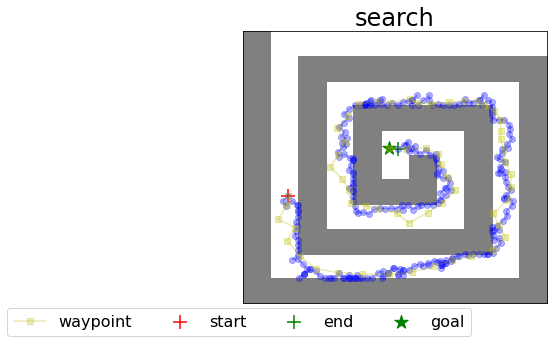

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


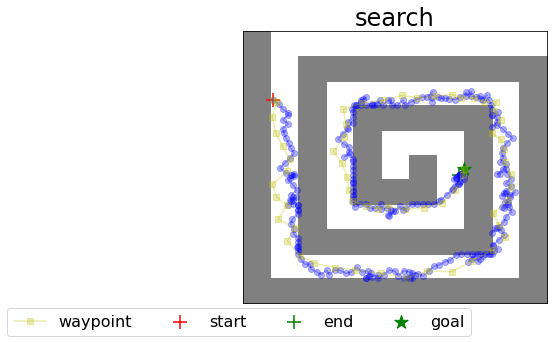

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


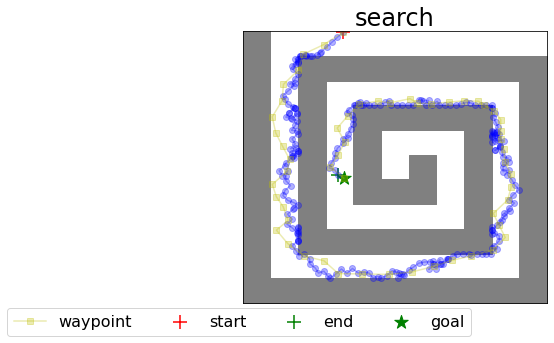

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


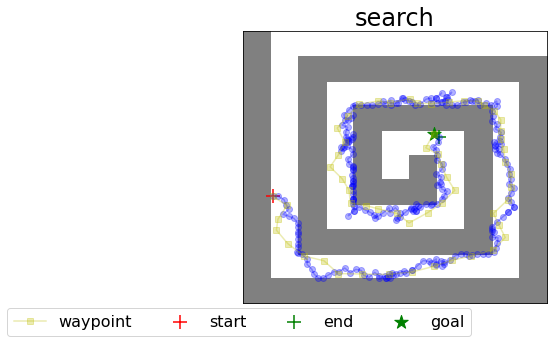

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


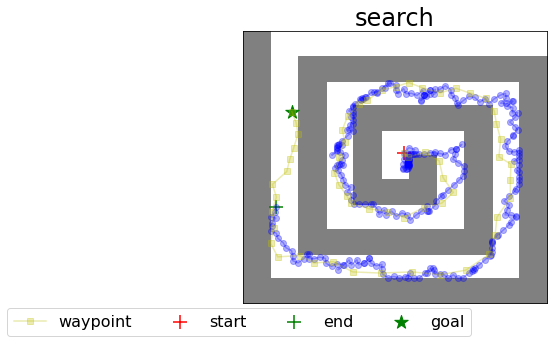

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


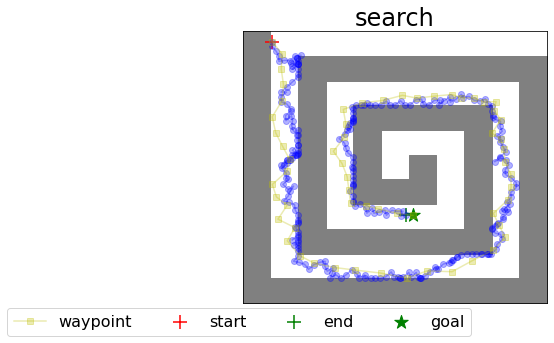

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


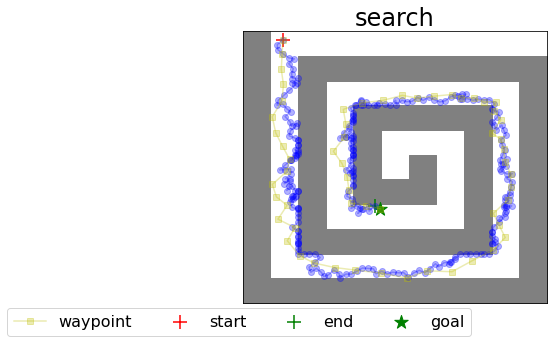

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


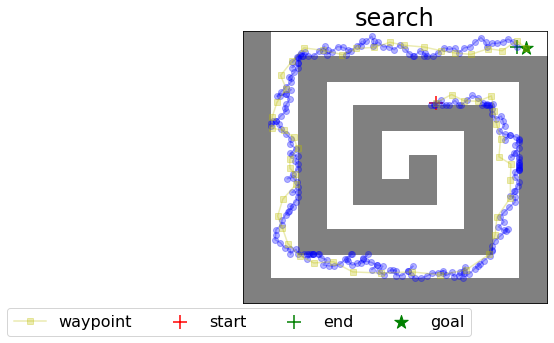

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


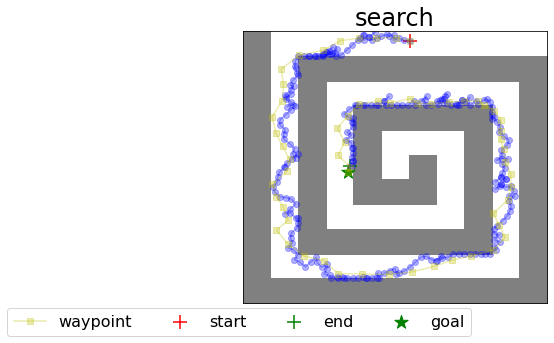

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


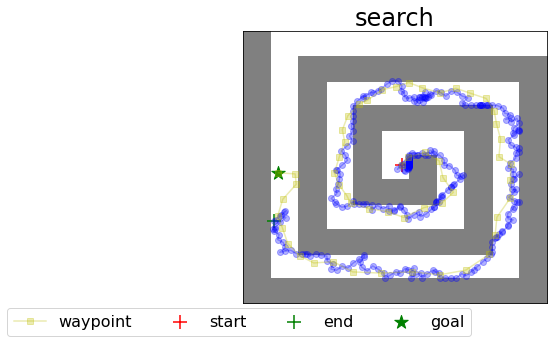

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


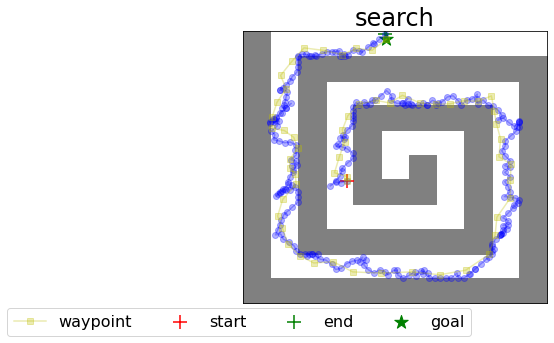

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


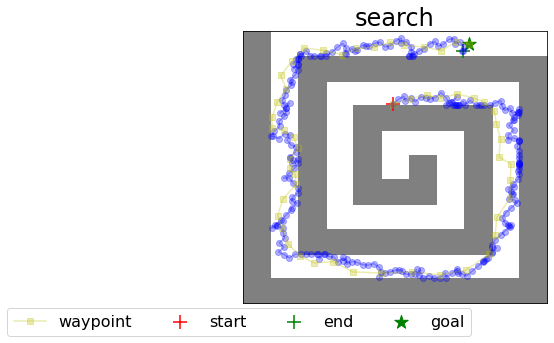

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


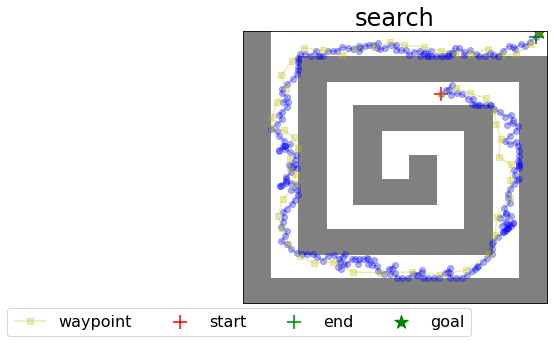

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


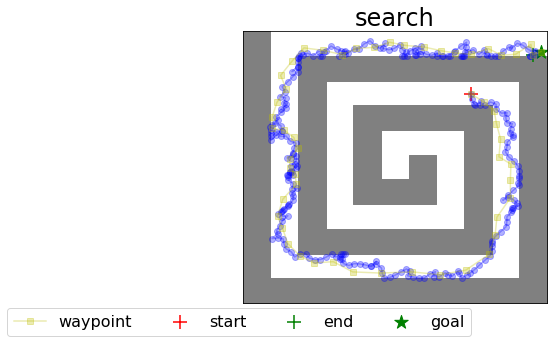

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


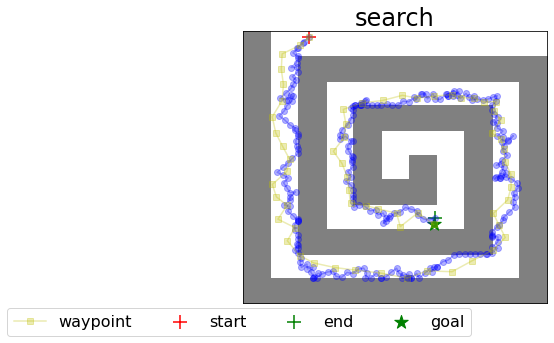

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


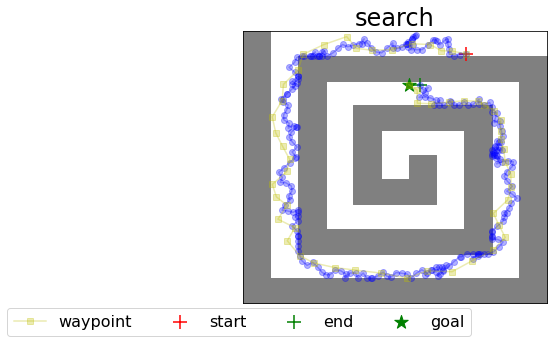

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


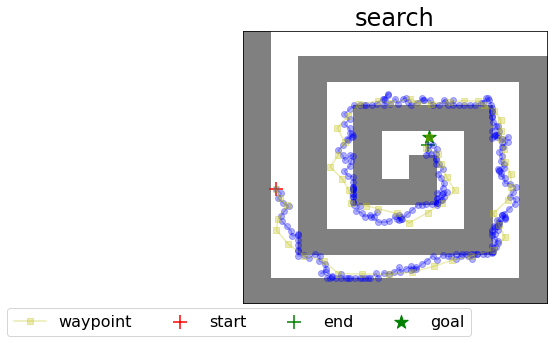

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


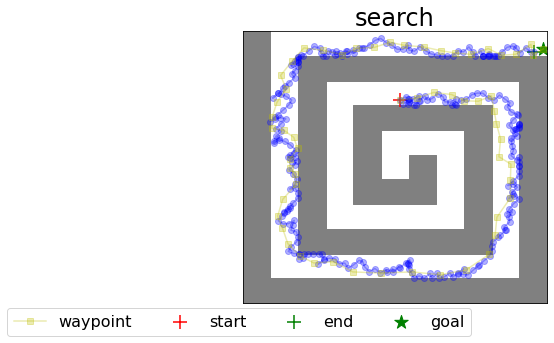

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


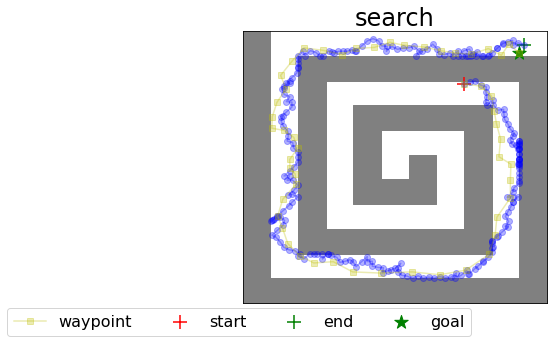

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


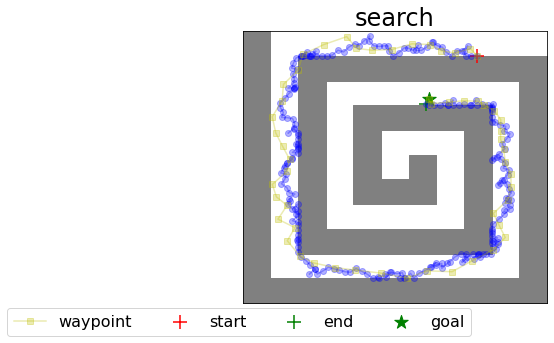

Path success rate is  1.0
Rollout success rate (given path) is  0.9
Average search time (for success) is  20.594727623462678
Search iterations is  266.15
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


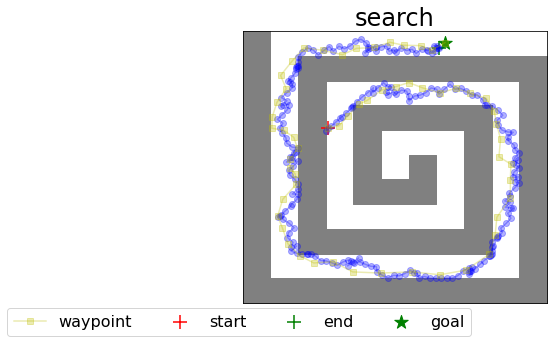

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


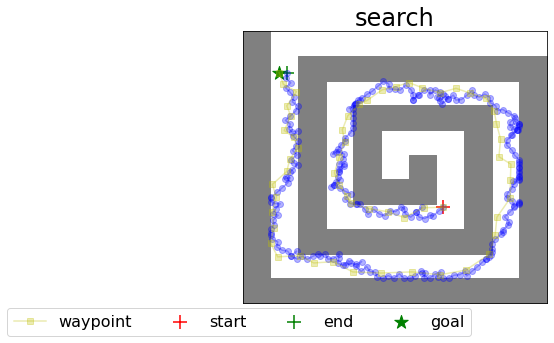

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


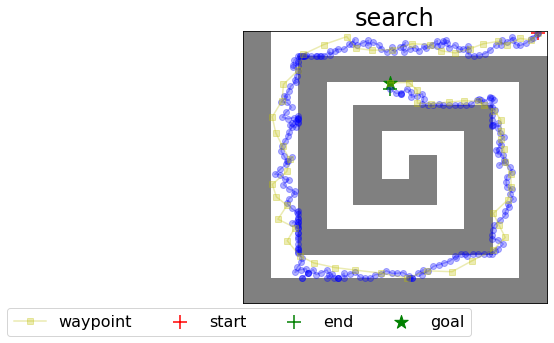

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


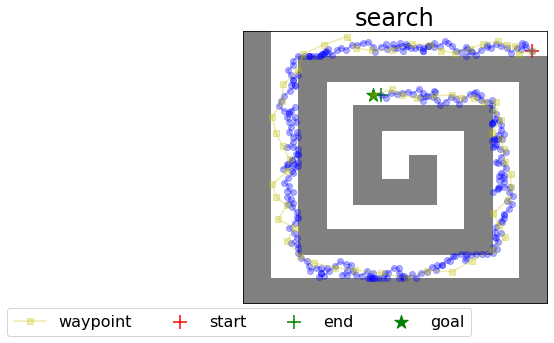

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


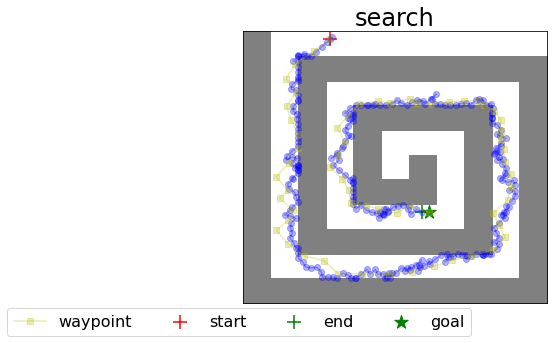

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


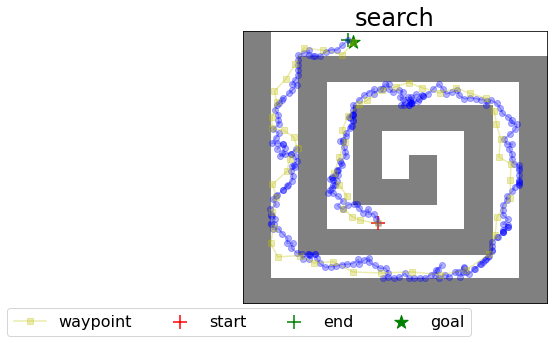

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


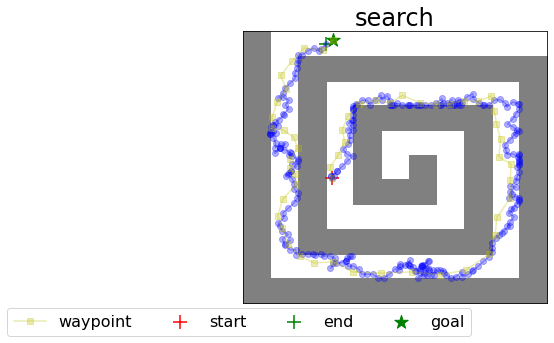

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


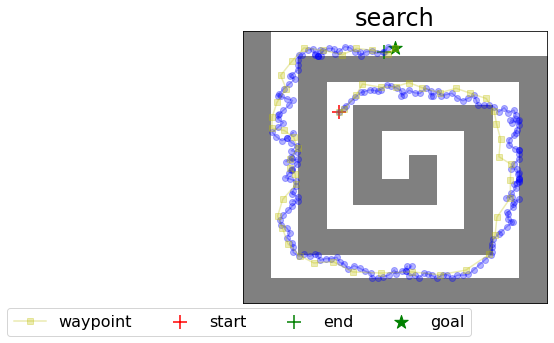

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


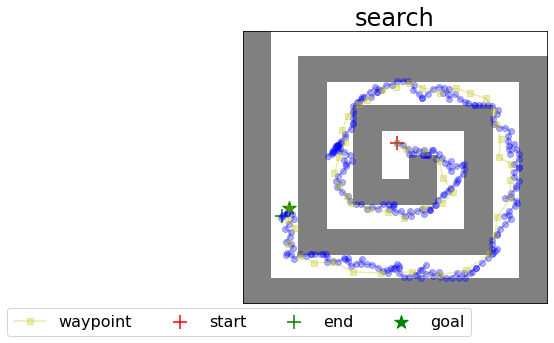

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


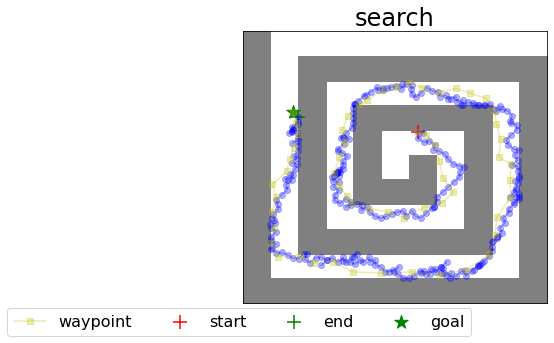

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


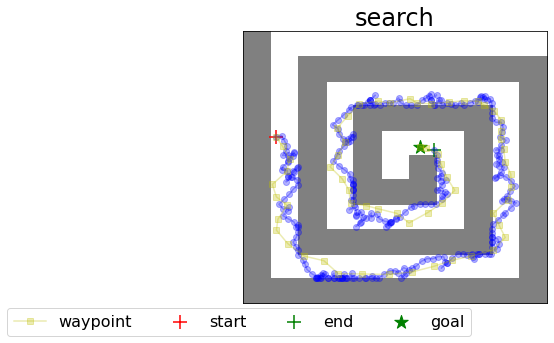

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


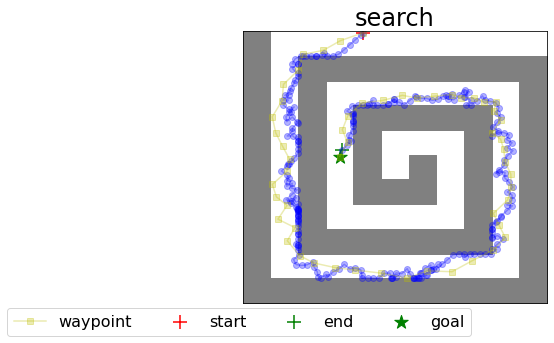

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


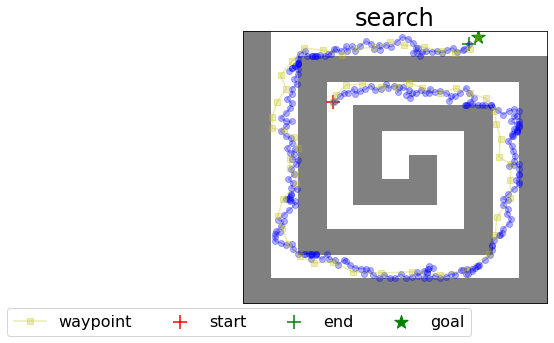

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


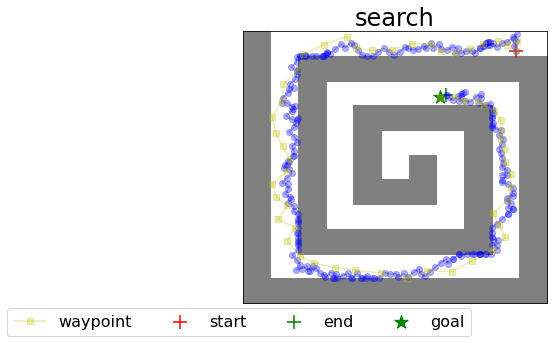

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


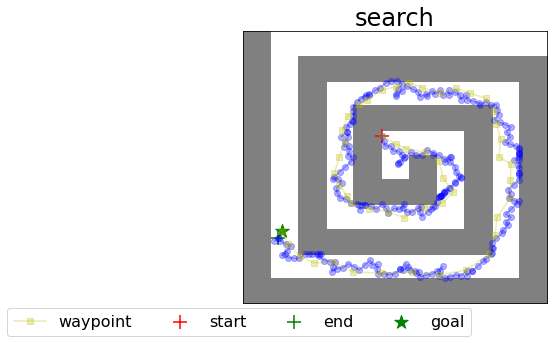

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


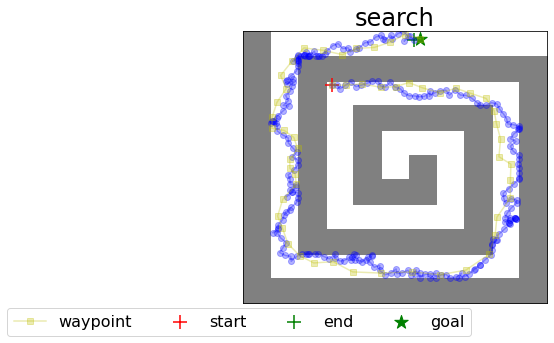

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


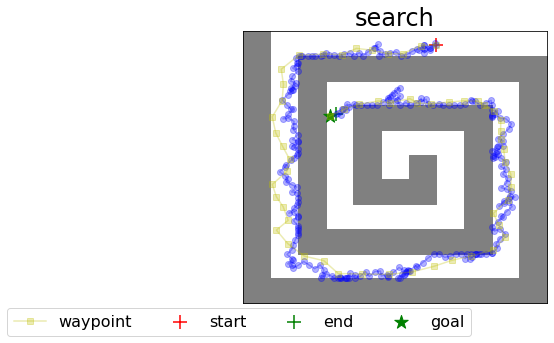

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


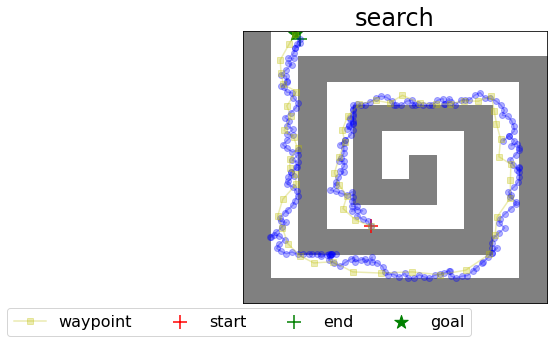

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


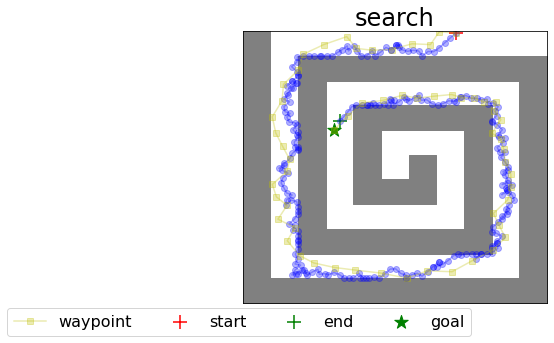

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


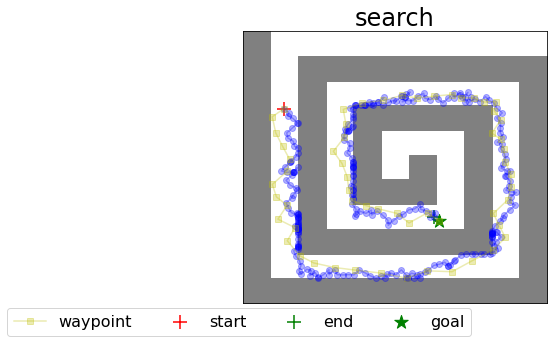

Path success rate is  1.0
Rollout success rate (given path) is  0.9
Average search time (for success) is  20.78524864912033
Search iterations is  265.25
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


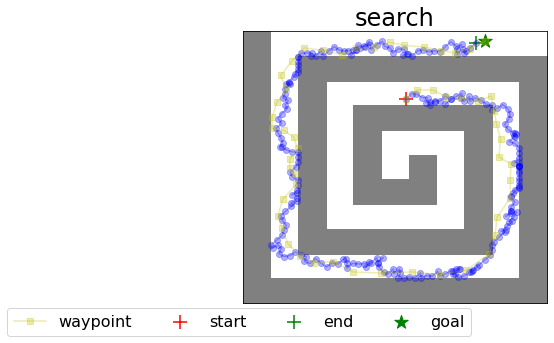

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


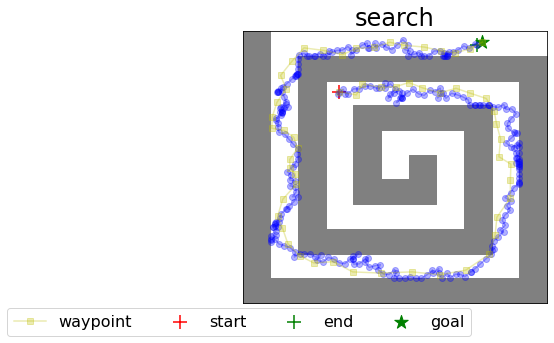

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


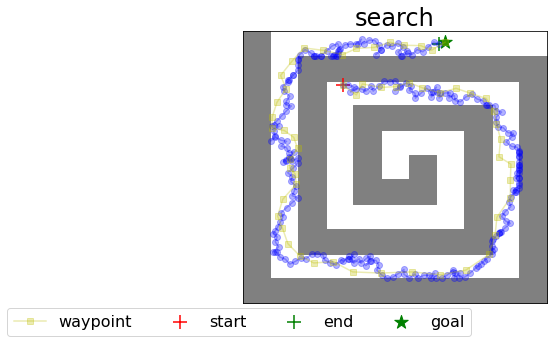

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


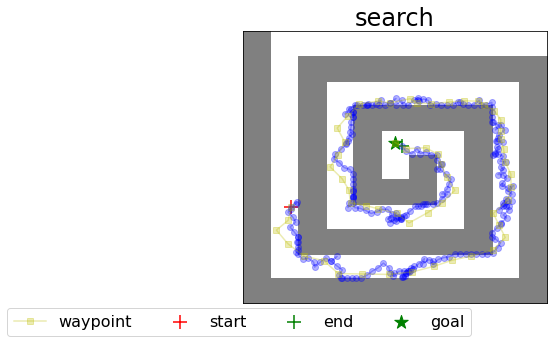

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


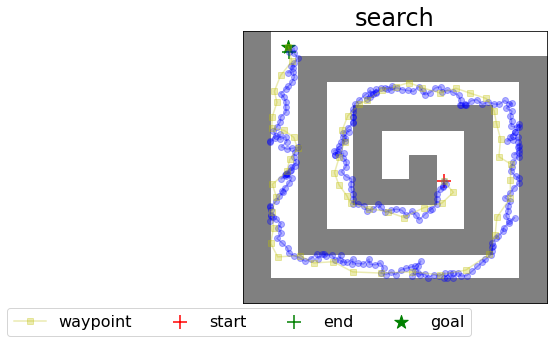

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


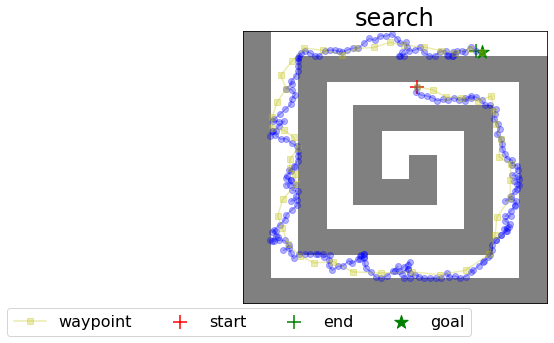

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


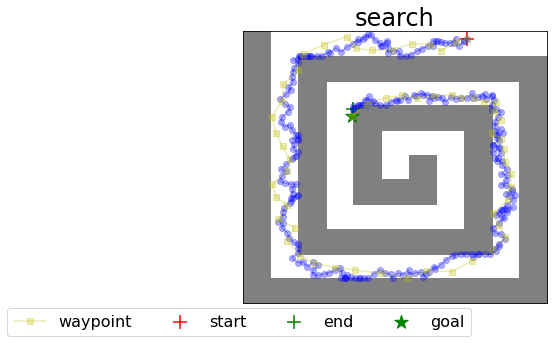

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


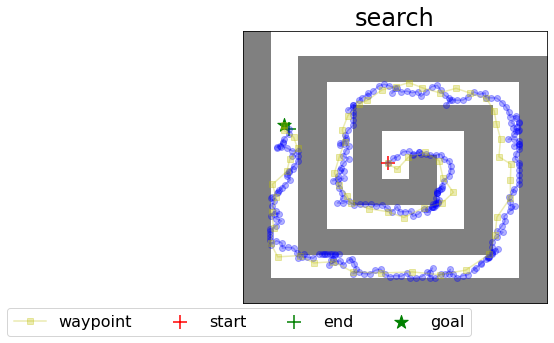

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


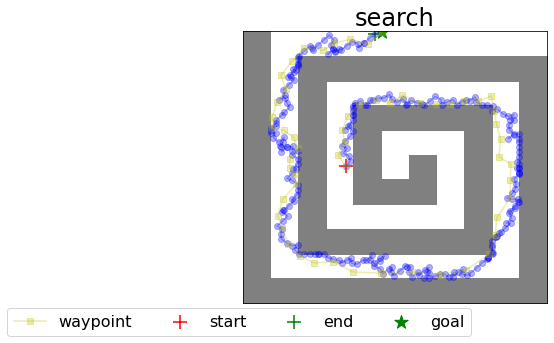

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


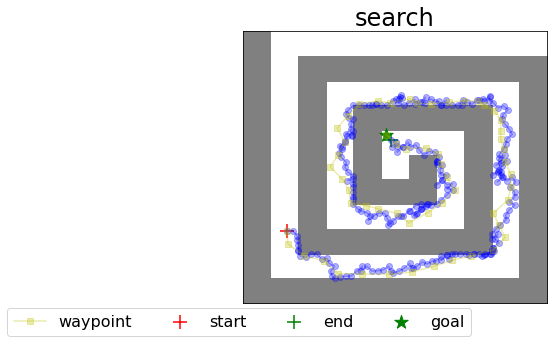

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


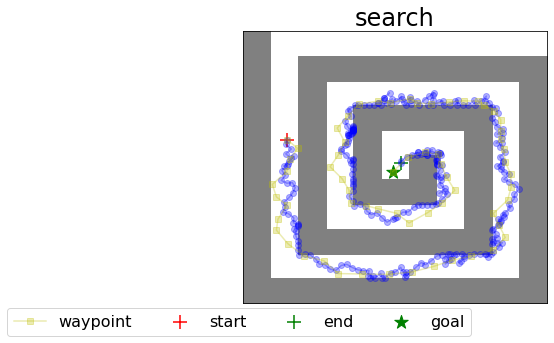

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


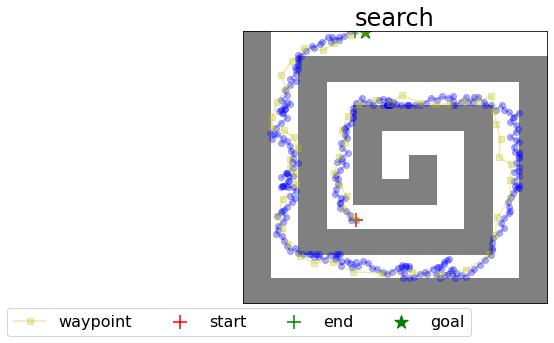

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


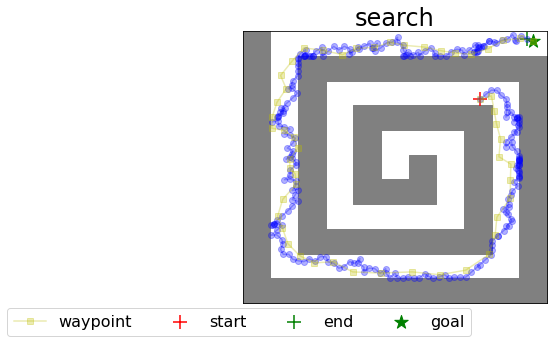

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


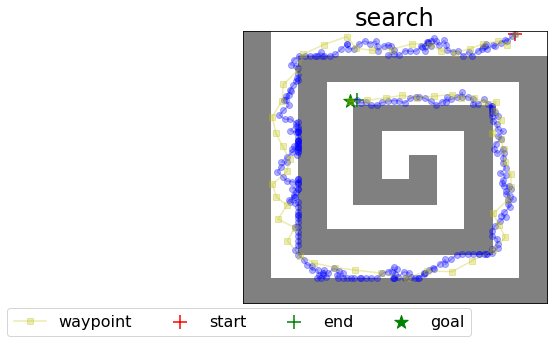

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


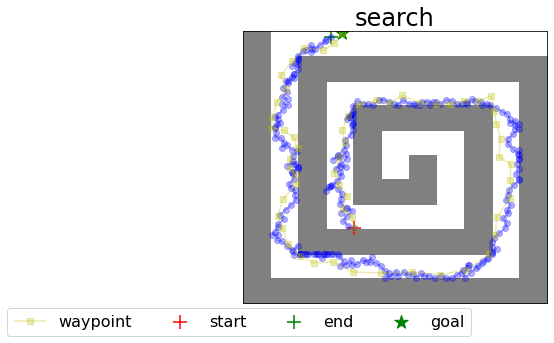

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


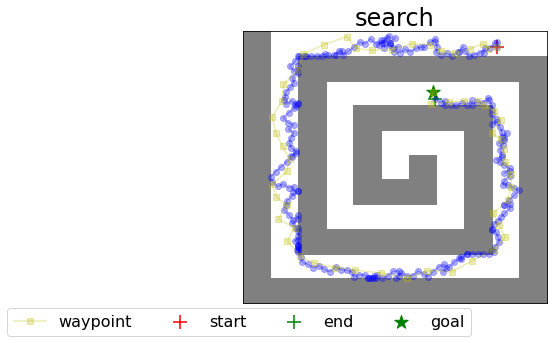

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


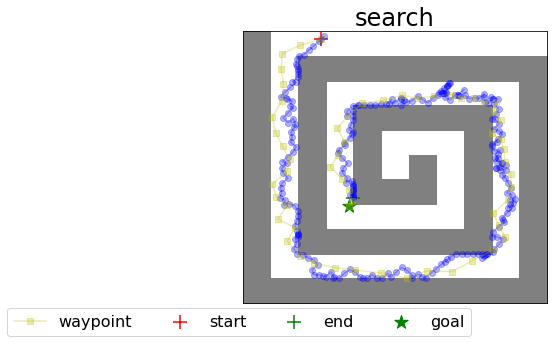

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


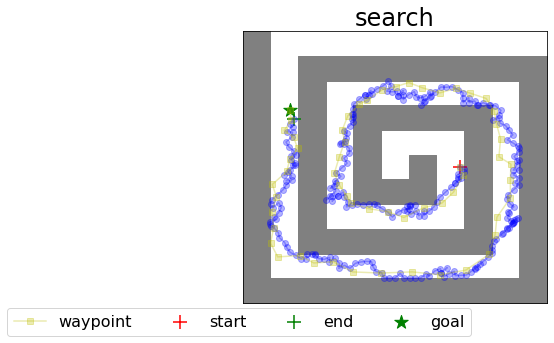

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


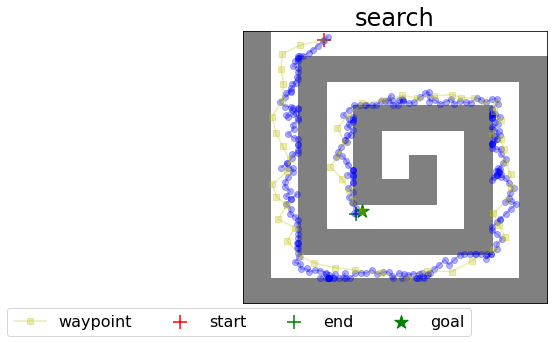

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


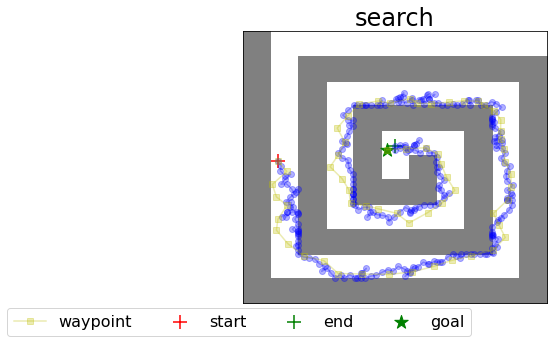

Path success rate is  1.0
Rollout success rate (given path) is  1.0
Average search time (for success) is  20.729740715026857
Search iterations is  266.1
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


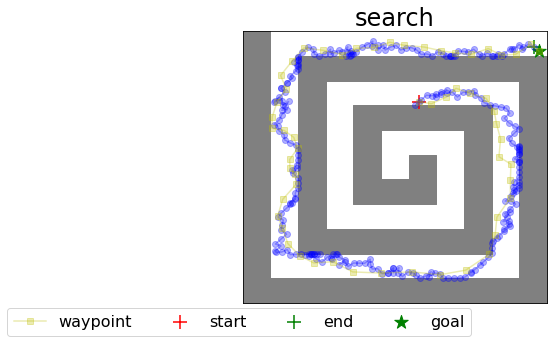

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


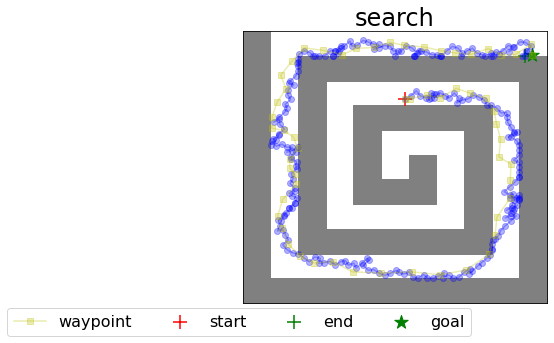

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


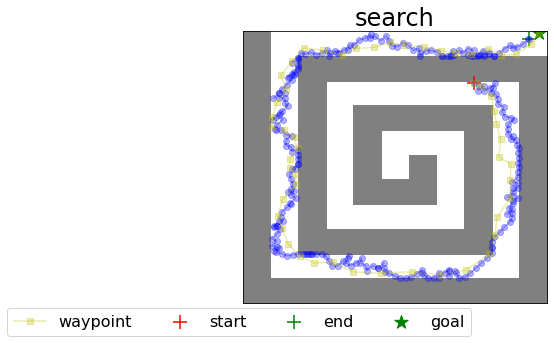

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


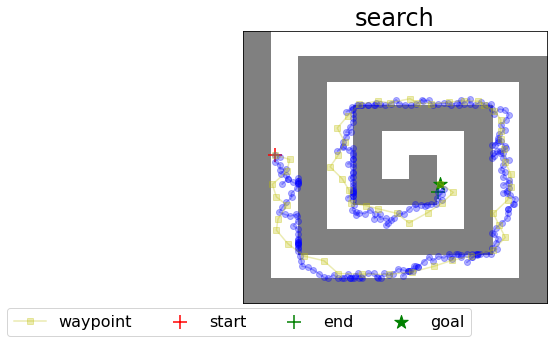

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


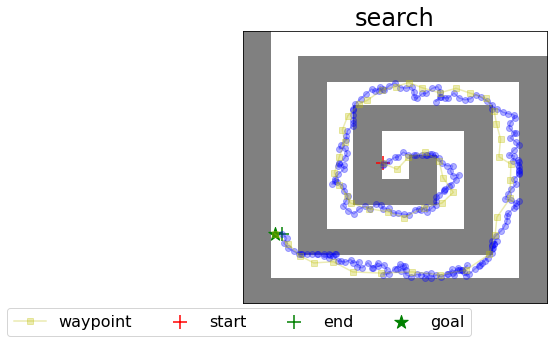

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


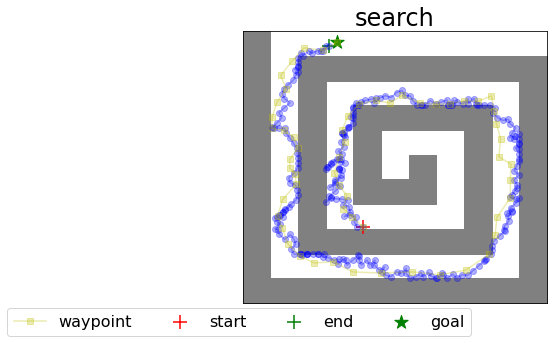

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


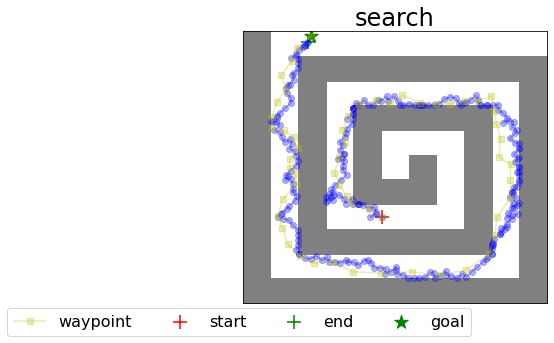

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


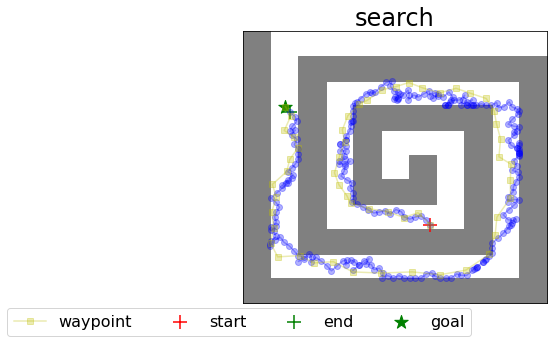

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


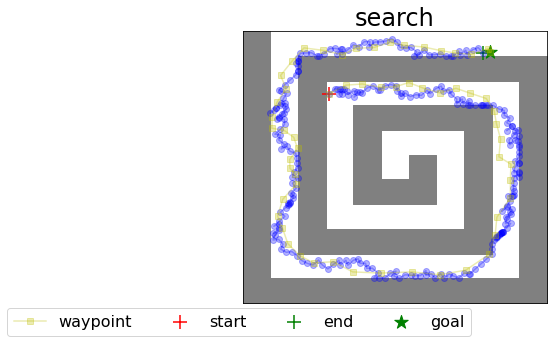

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


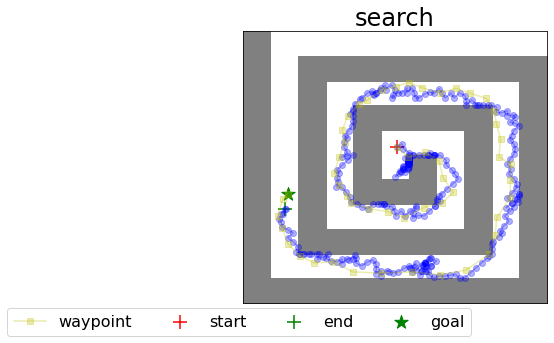

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


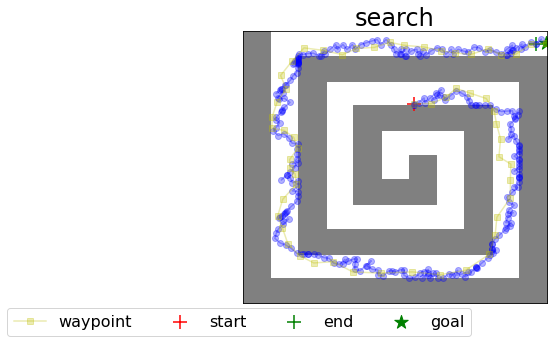

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


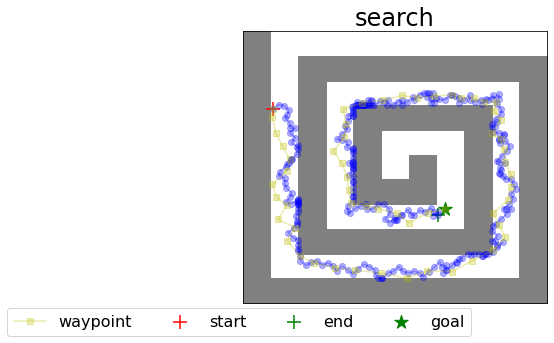

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


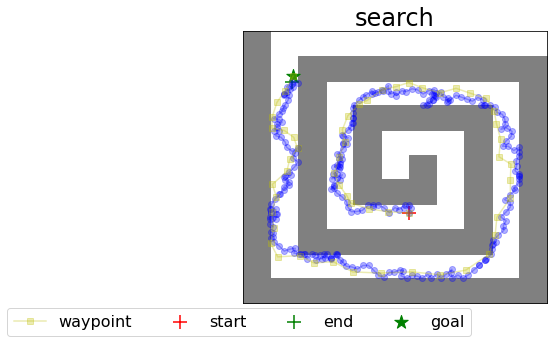

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


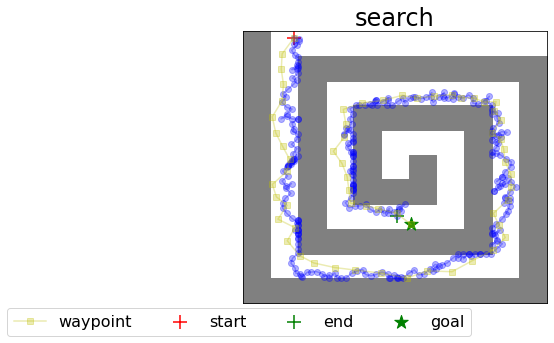

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


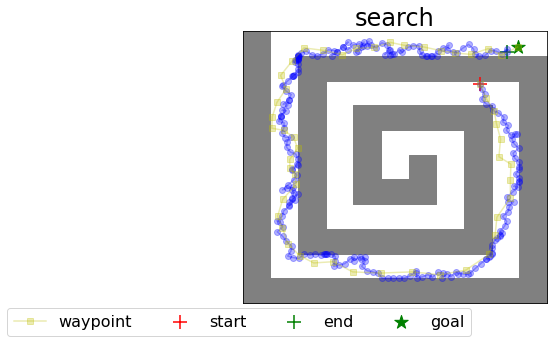

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


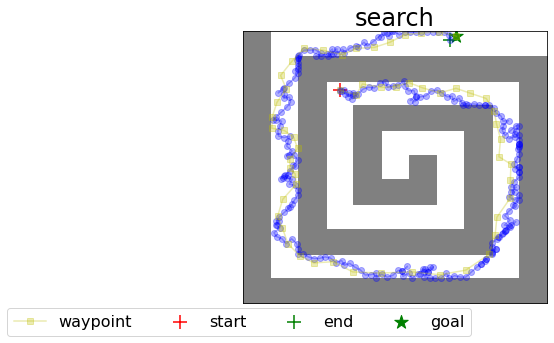

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


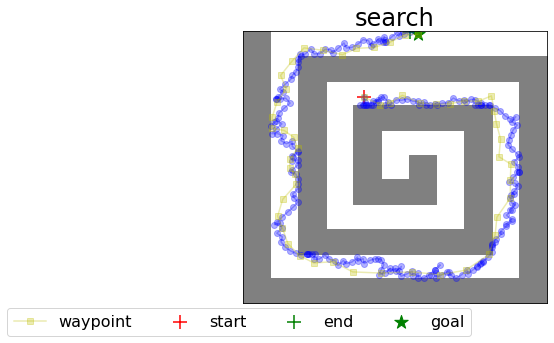

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


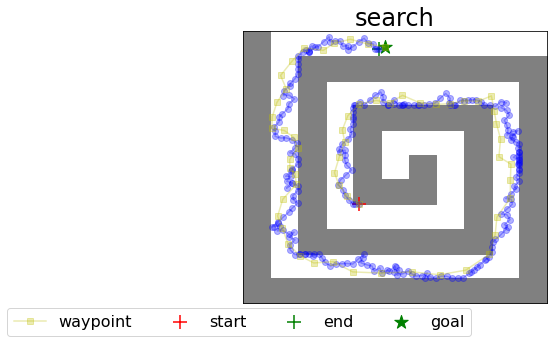

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


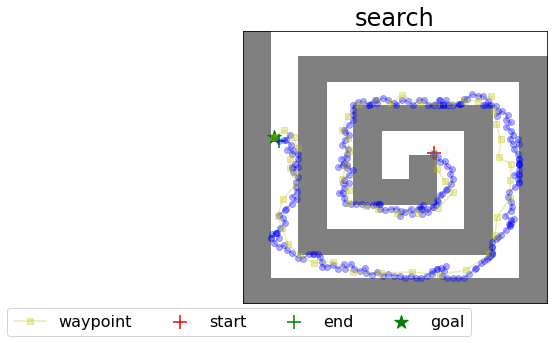

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


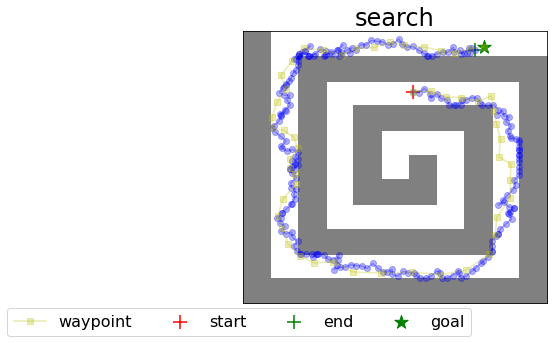

Path success rate is  1.0
Rollout success rate (given path) is  0.9
Average search time (for success) is  20.595084846019745
Search iterations is  264.6
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


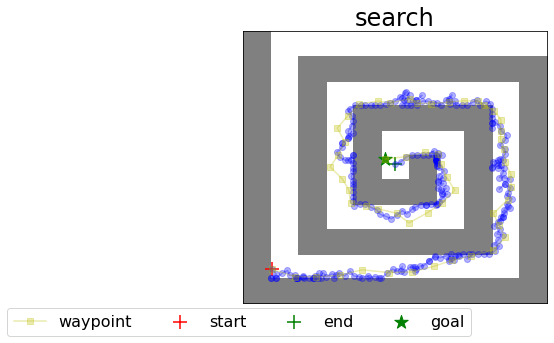

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


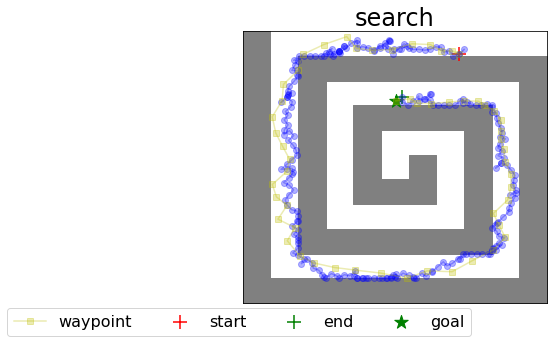

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


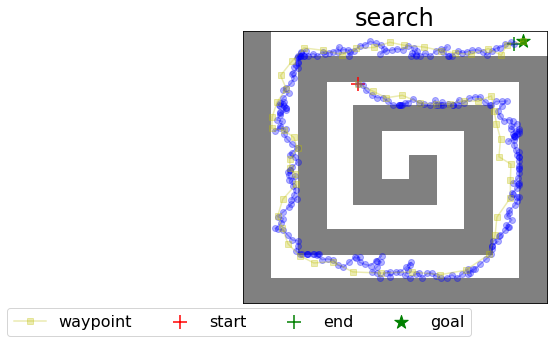

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


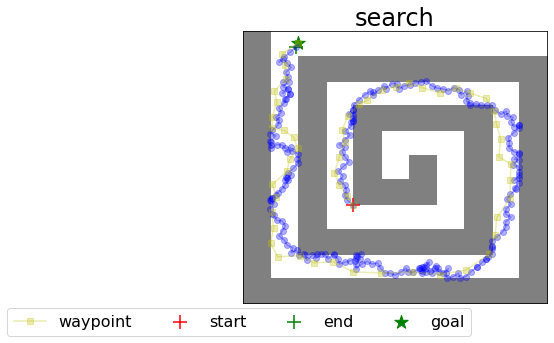

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


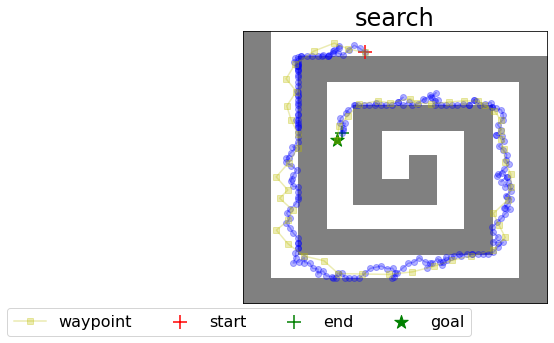

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


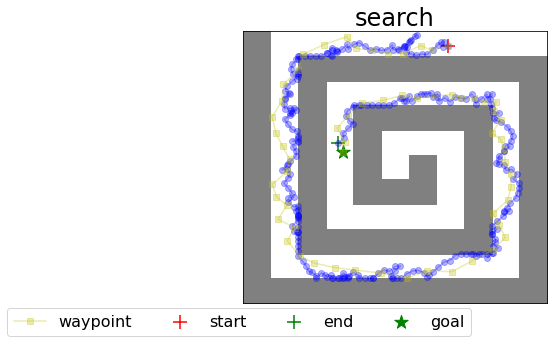

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


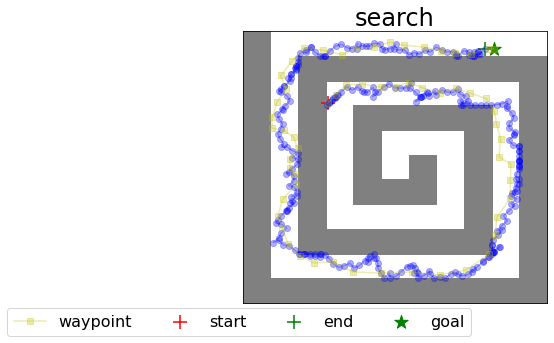

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


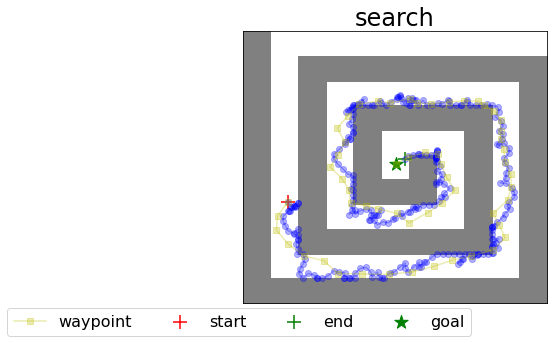

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


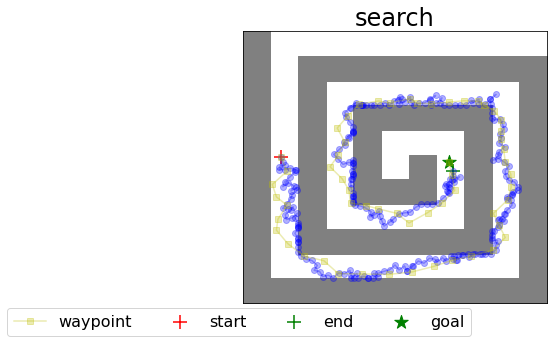

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


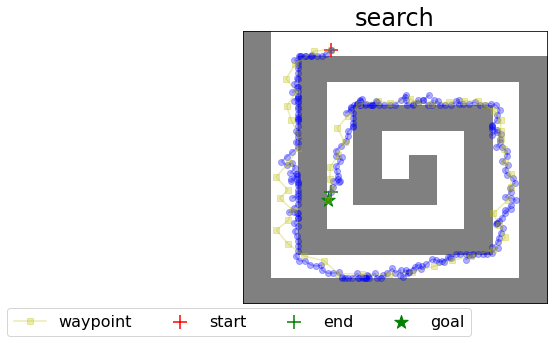

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


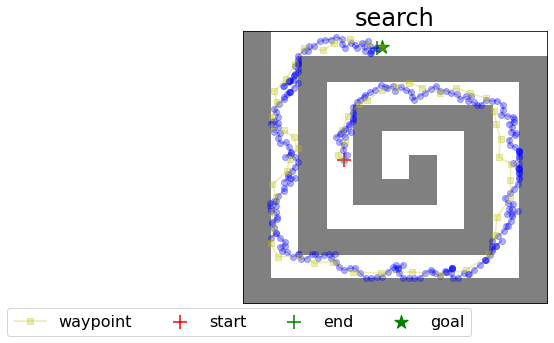

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


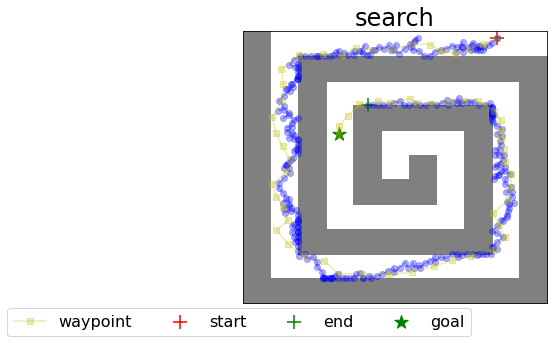

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


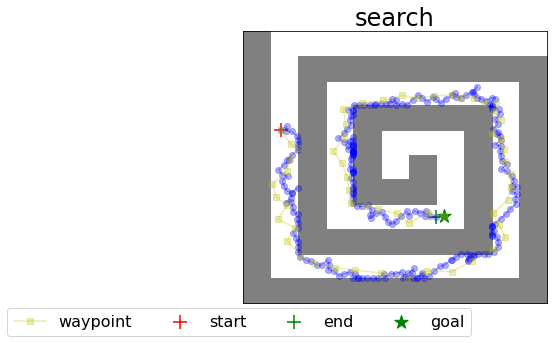

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


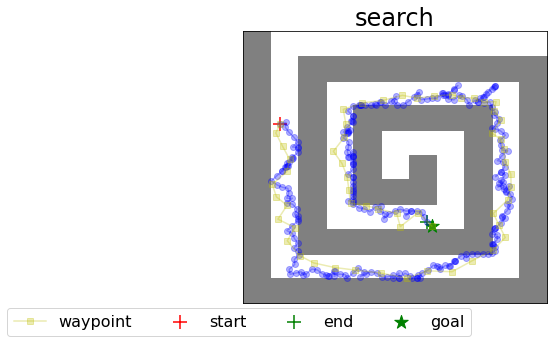

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


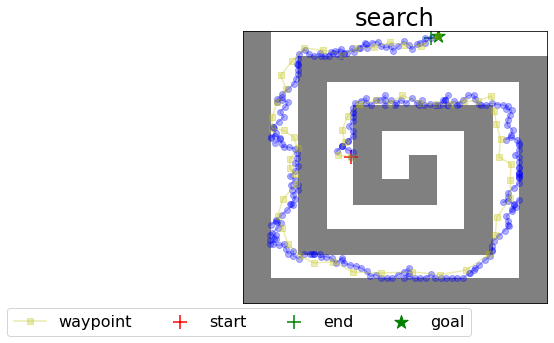

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


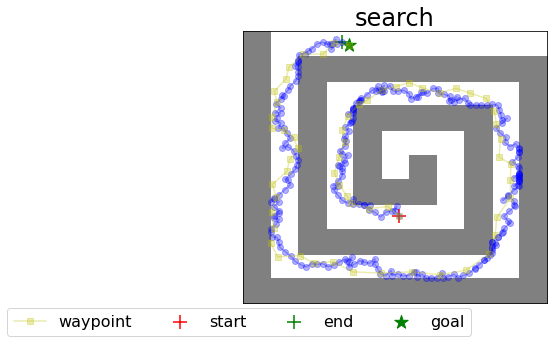

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


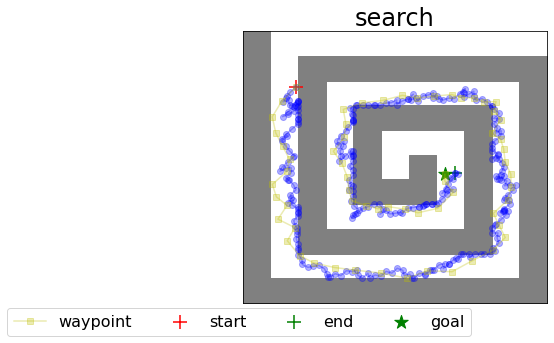

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


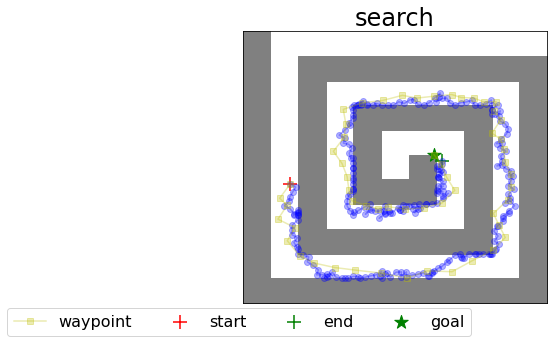

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


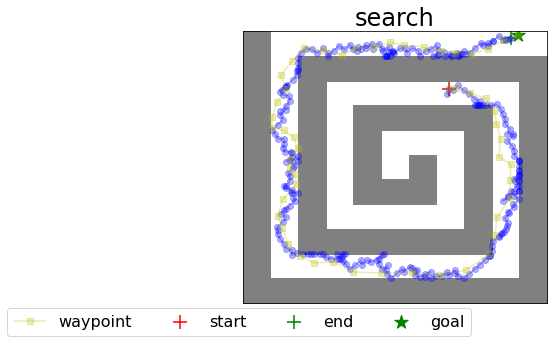

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


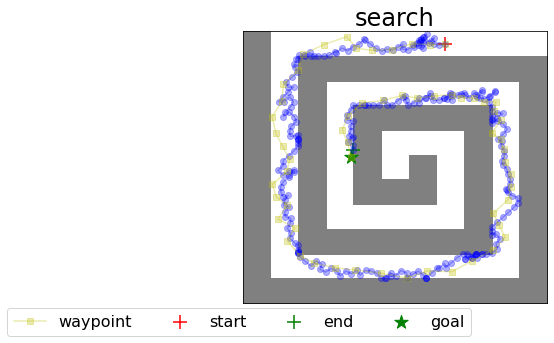

Path success rate is  1.0
Rollout success rate (given path) is  0.95
Average search time (for success) is  20.70396308898926
Search iterations is  266.6
Maze11x11
FourRooms


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


random_seed = 0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:67: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


INFO:tensorflow:step = 1000, loss = 2.244333
INFO:tensorflow:58.120 steps/sec
INFO:tensorflow:step = 1000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -16.70
INFO:tensorflow:		 predicted_dist = 15.7 (0.6)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.80
INFO:tensorflow:		 predicted_dist = 15.3 (0.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.0 (0.8)
INFO:tensorflow:	 eval_time = 1.77
INFO:tensorflow:step = 2000, loss = 1.724567
INFO:tensorflow:68.560 steps/sec
INFO:tensorflow:step = 2000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -16.60
INFO:tensorflow:		 predicted_dist = 14.7 (1.3)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 15.3 (1.3)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -19.30
INFO:tensorflow:		 predicted_dist = 16.7 (1.0)
INFO:tensorflow:	 eval_time = 1.75
INFO:tensorflow:step

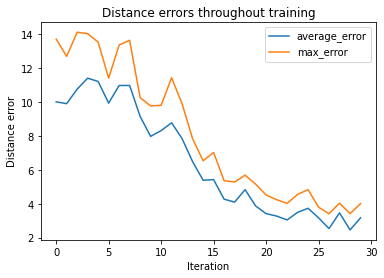

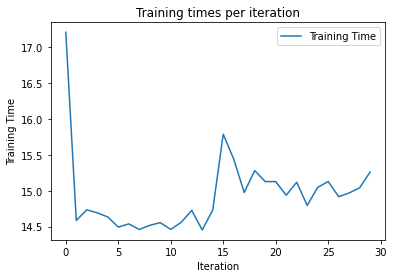

random_seed = 0


INFO:tensorflow:step = 31000, loss = 2.710038
INFO:tensorflow:58.846 steps/sec
INFO:tensorflow:step = 31000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -3.80
INFO:tensorflow:		 predicted_dist = 5.1 (1.6)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -8.70
INFO:tensorflow:		 predicted_dist = 9.2 (1.6)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -14.90
INFO:tensorflow:		 predicted_dist = 12.7 (1.1)
INFO:tensorflow:	 eval_time = 1.45
INFO:tensorflow:step = 32000, loss = 3.227237
INFO:tensorflow:65.512 steps/sec
INFO:tensorflow:step = 32000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -2.50
INFO:tensorflow:		 predicted_dist = 5.2 (1.6)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -8.60
INFO:tensorflow:		 predicted_dist = 8.8 (1.0)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -15.70
INFO:tensorflow:		 predicted_dist = 12.6 (1.5)
INFO:tensorflow:	 eval_time = 1.45
INFO:tensorflow:step = 3

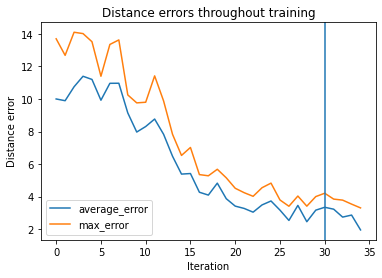

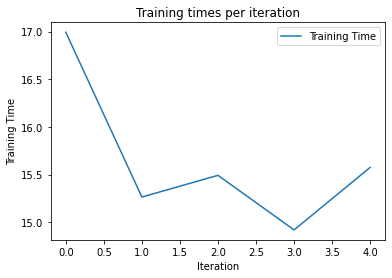

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:126: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


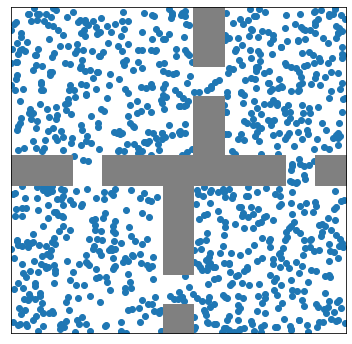

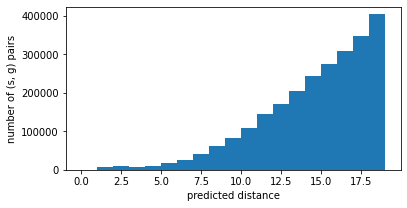

Searching with max steps of  7
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


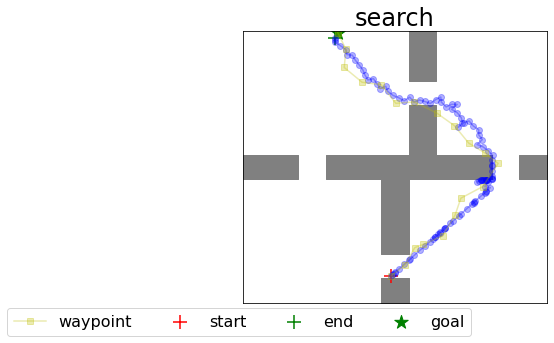

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


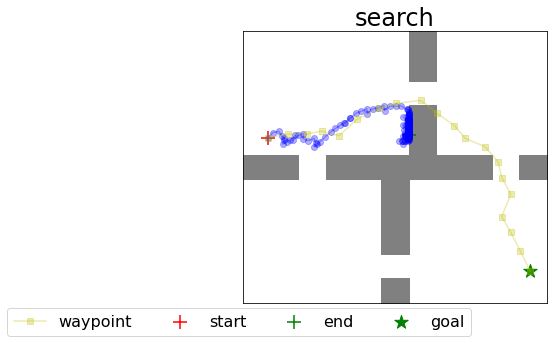

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


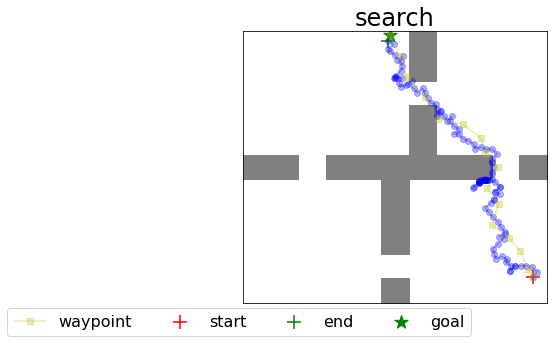

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


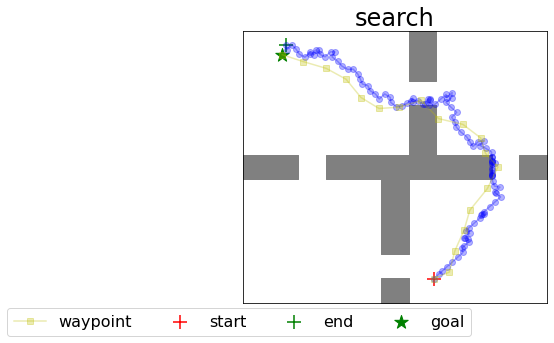

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


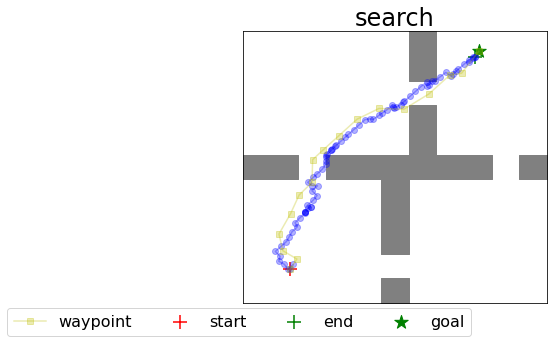

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


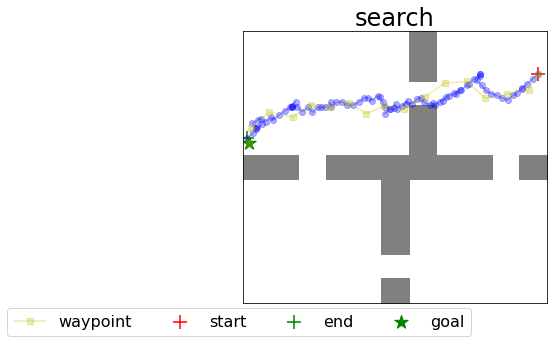

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


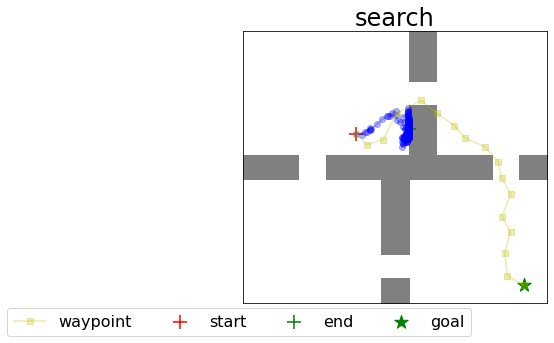

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


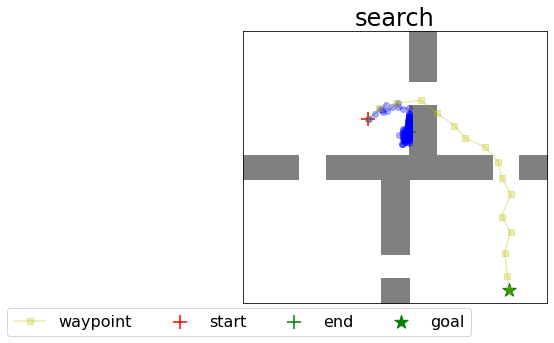

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


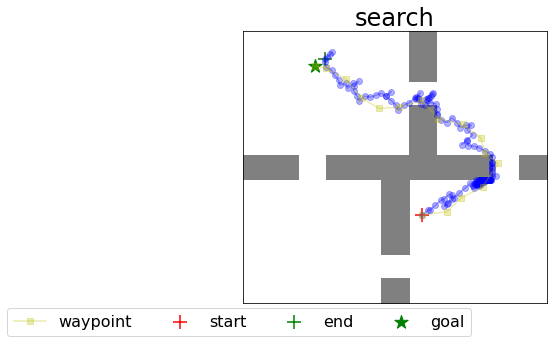

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


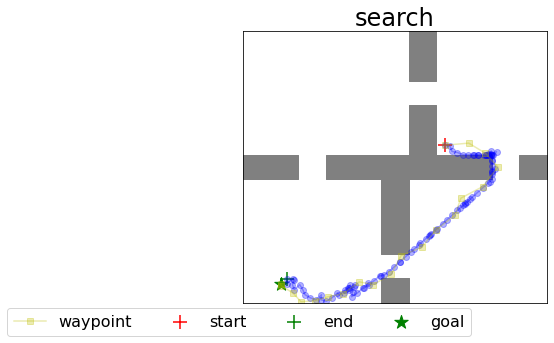

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


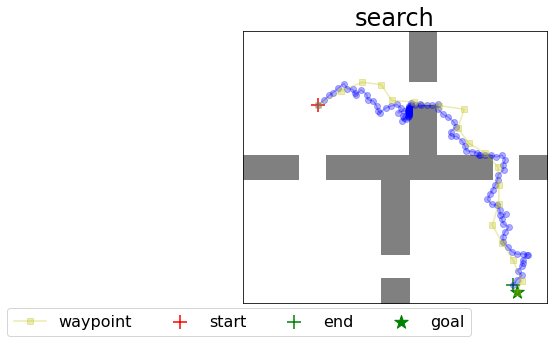

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


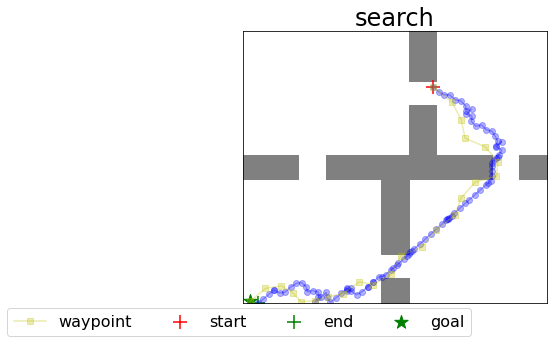

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


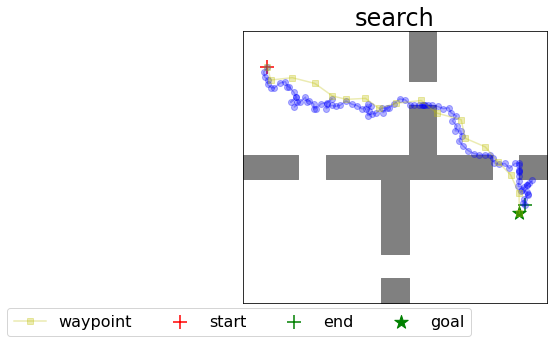

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


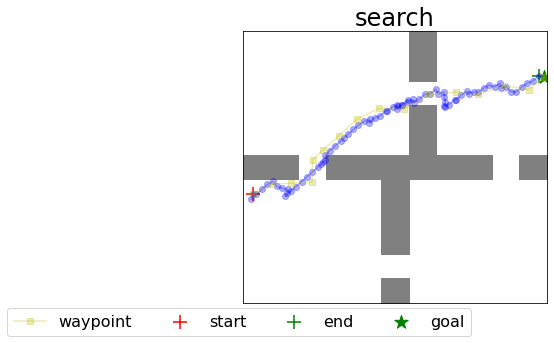

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


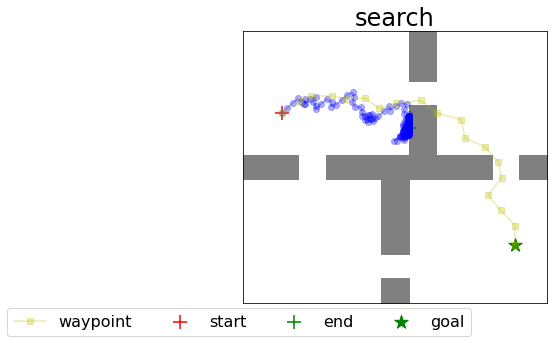

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


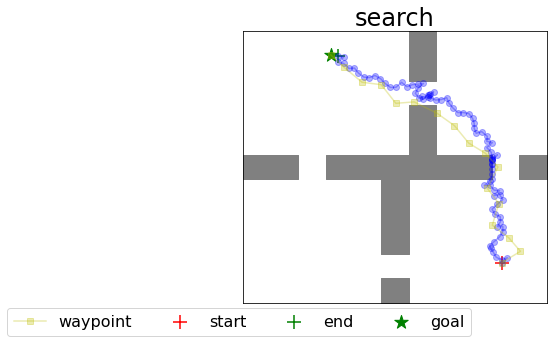

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


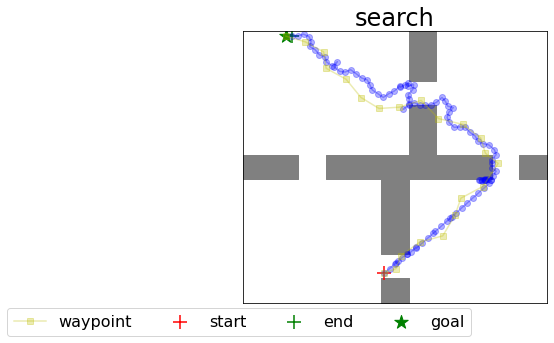

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


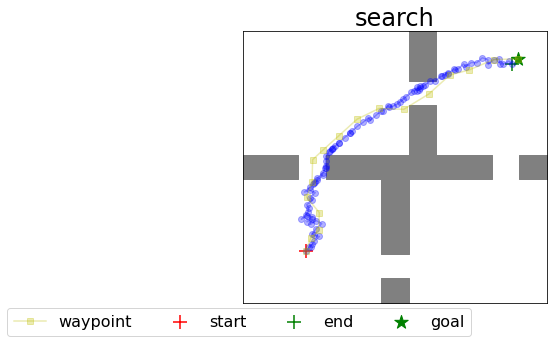

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


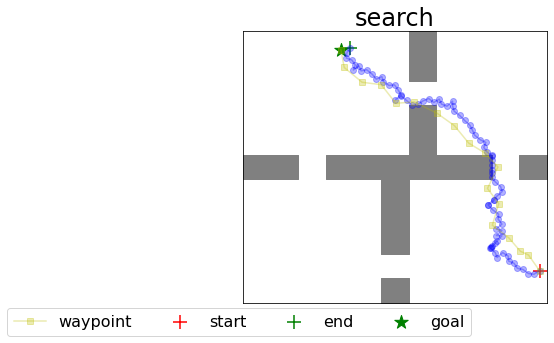

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


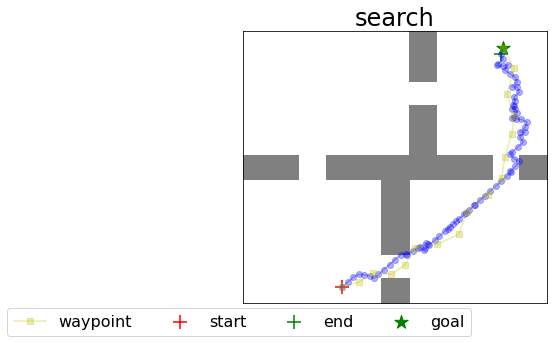

Path success rate is  1.0
Rollout success rate (given path) is  0.8
Average search time (for success) is  15.378958344459534
Search iterations is  140.45
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


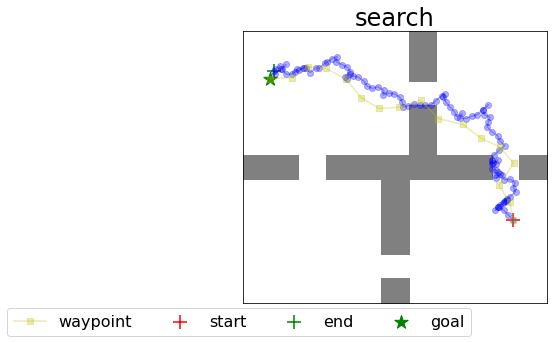

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


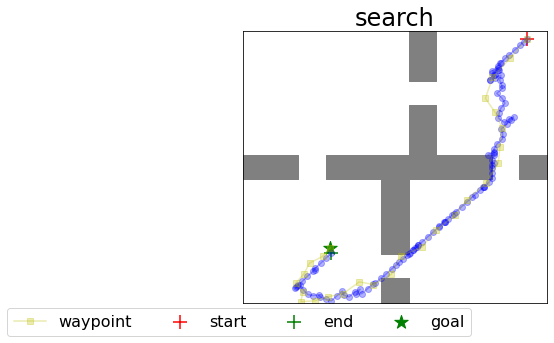

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


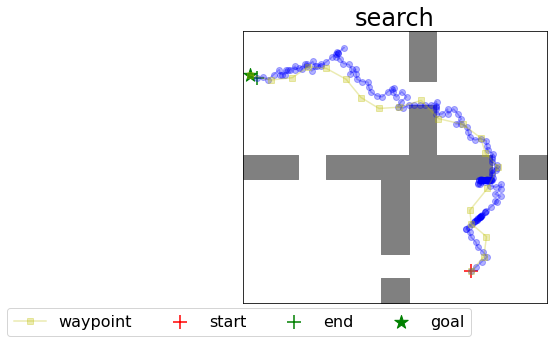

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


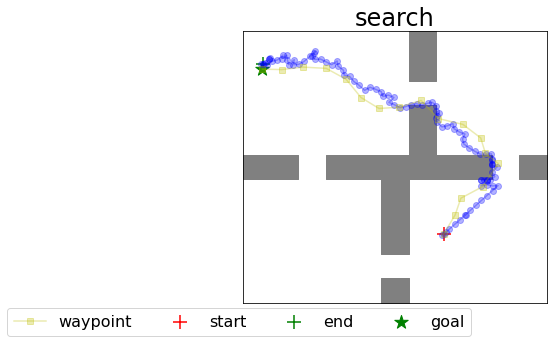

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


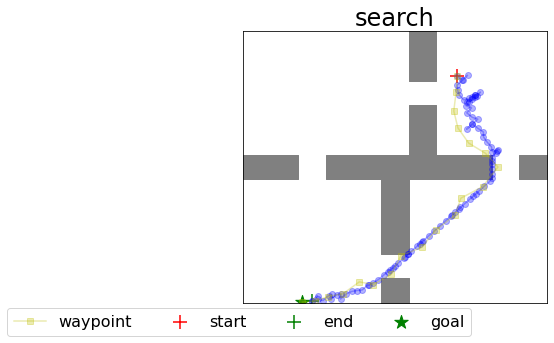

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


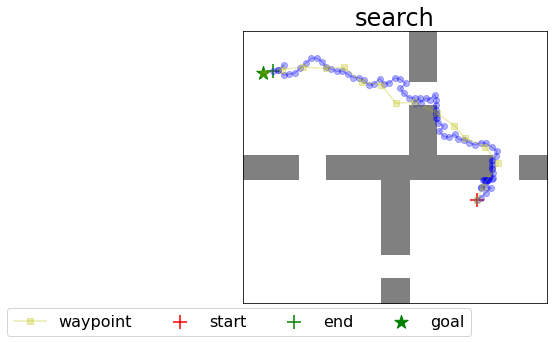

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


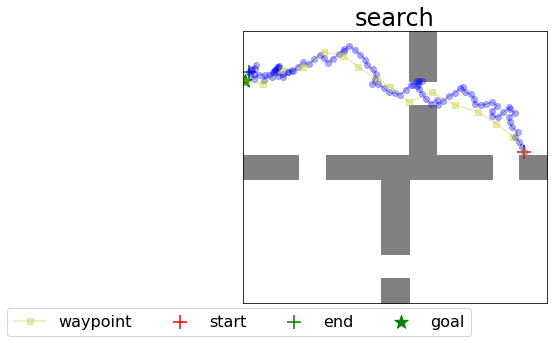

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


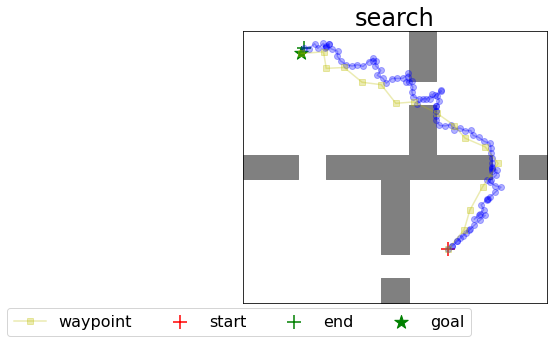

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


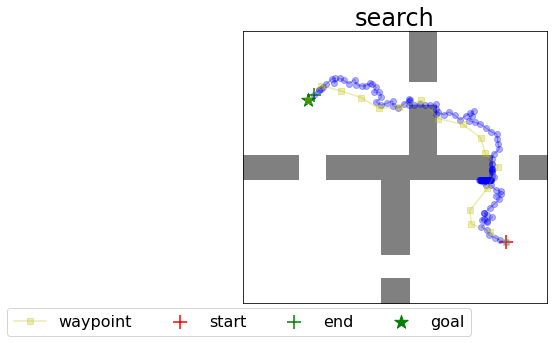

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


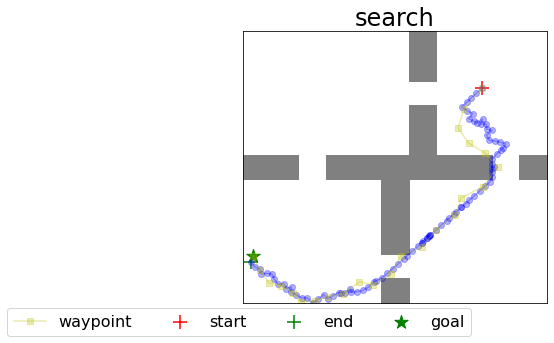

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


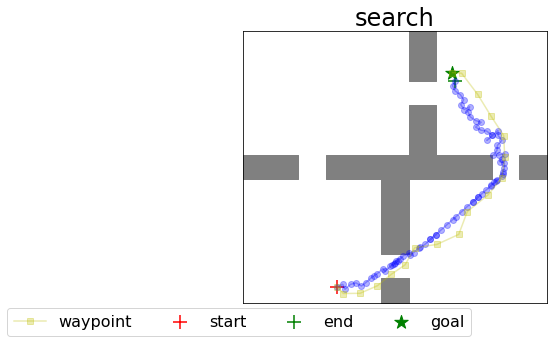

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


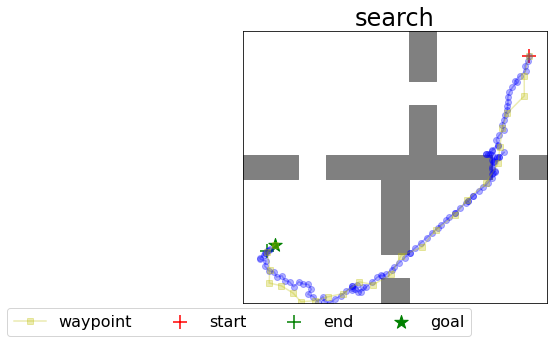

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


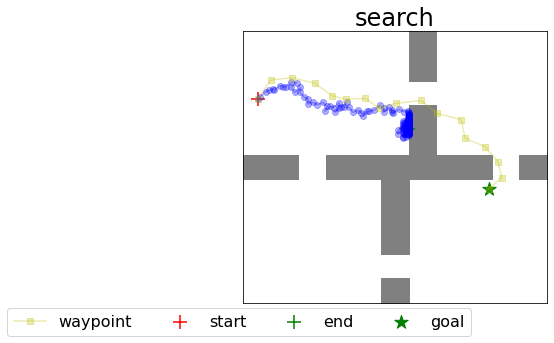

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


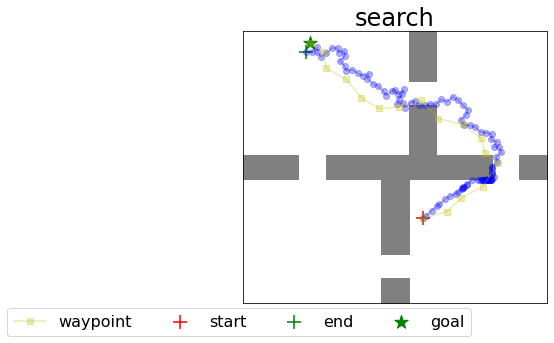

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


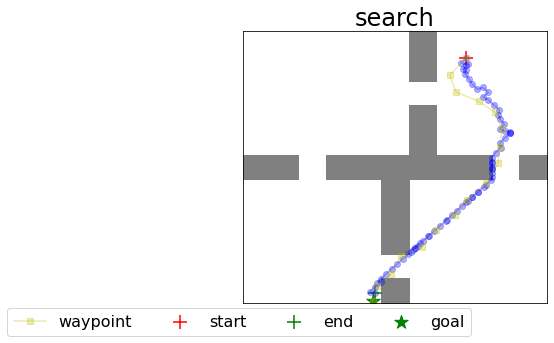

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


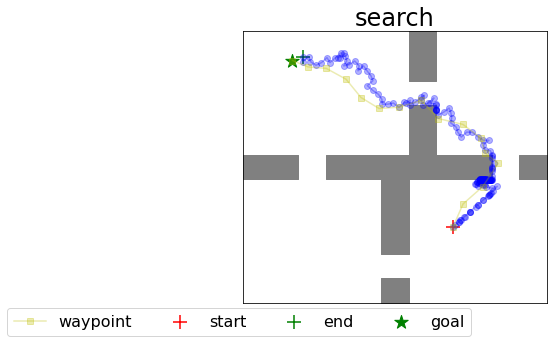

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


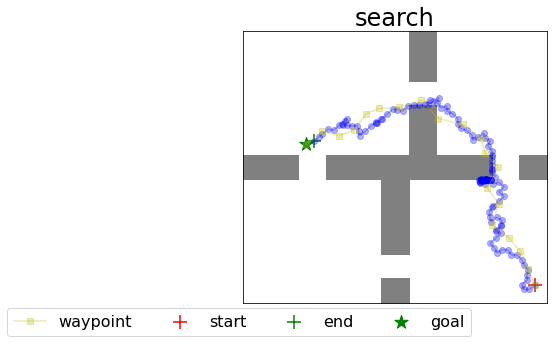

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


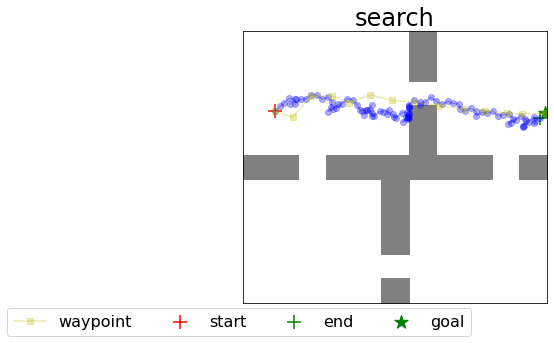

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


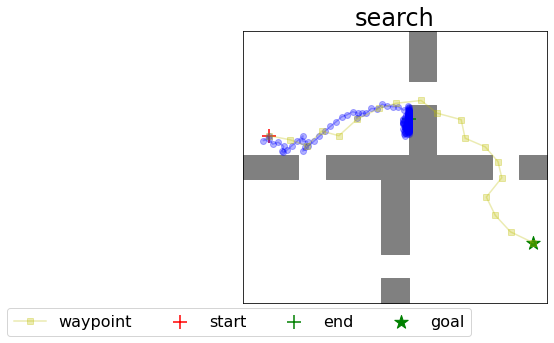

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


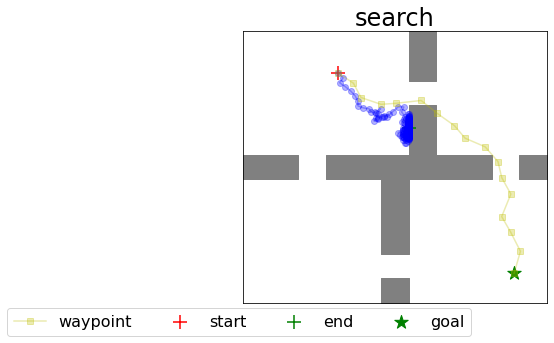

Path success rate is  1.0
Rollout success rate (given path) is  0.85
Average search time (for success) is  15.106186330318451
Search iterations is  142.95
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


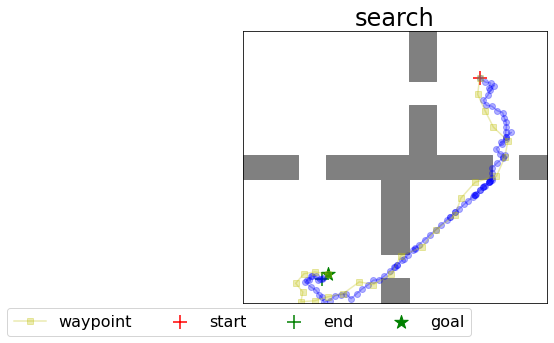

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


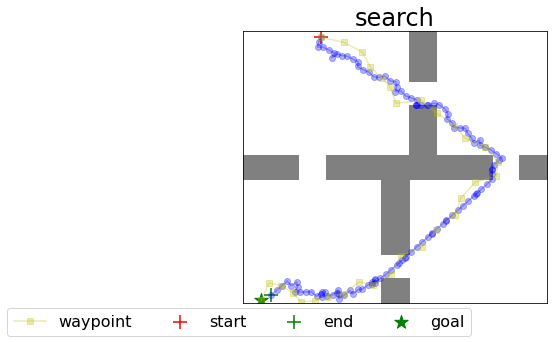

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


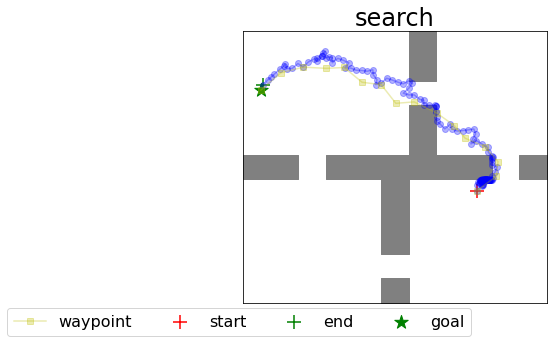

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


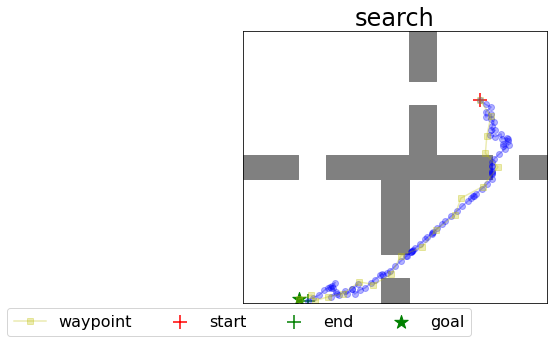

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


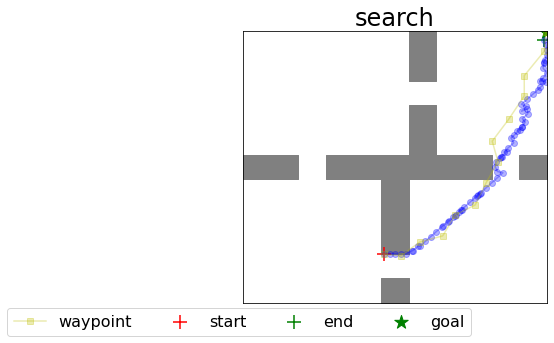

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


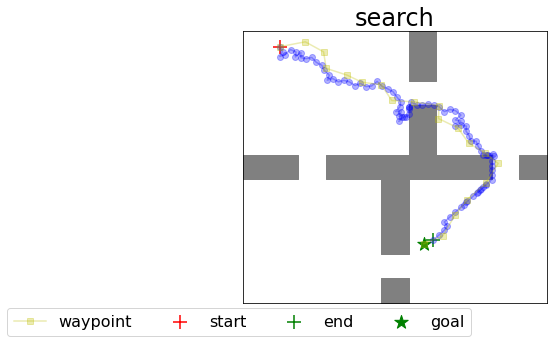

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


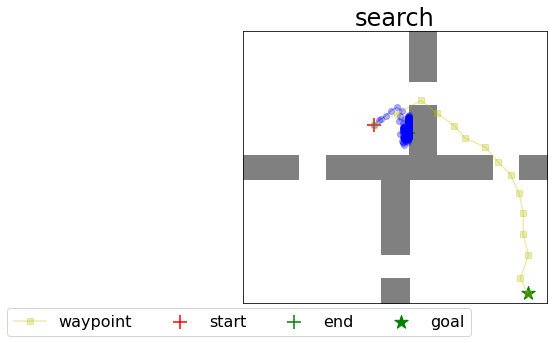

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


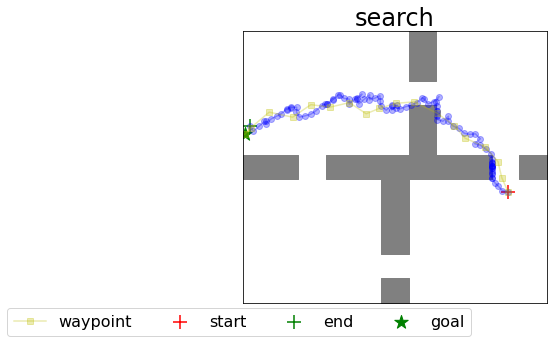

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


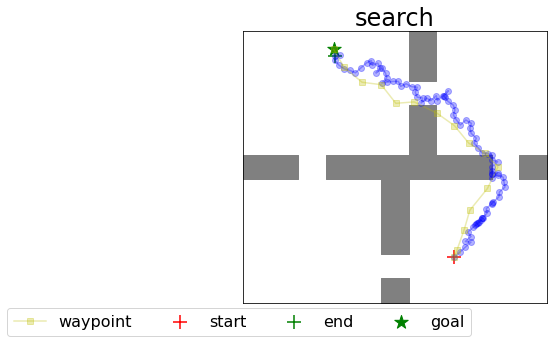

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


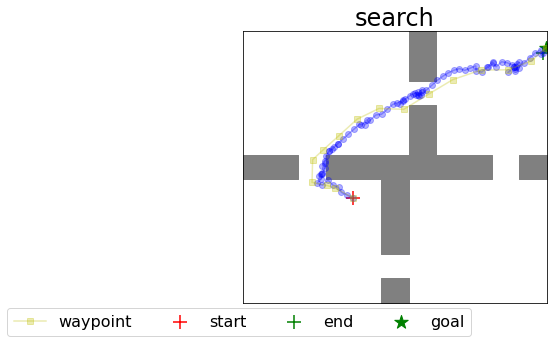

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


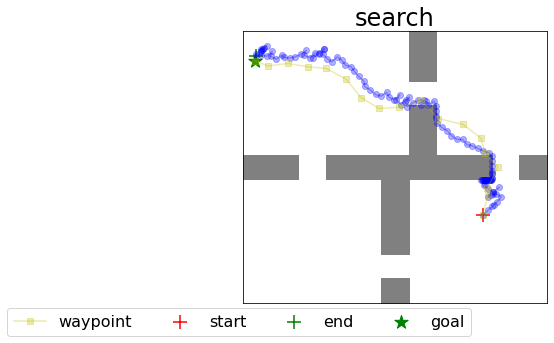

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


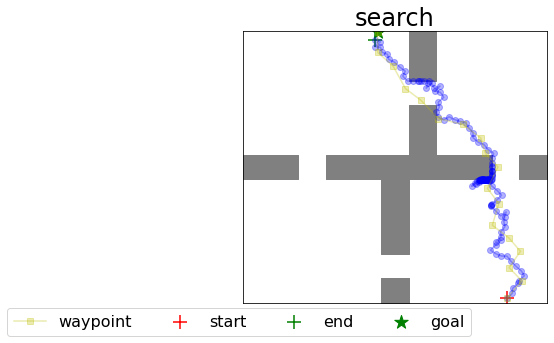

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


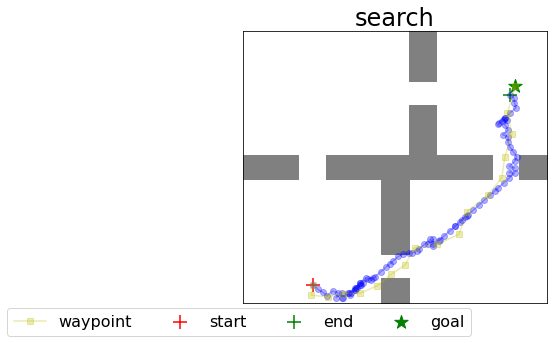

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


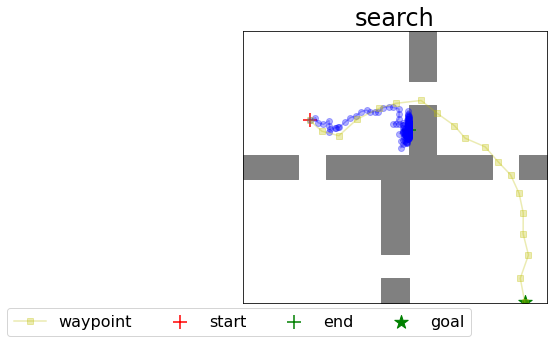

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


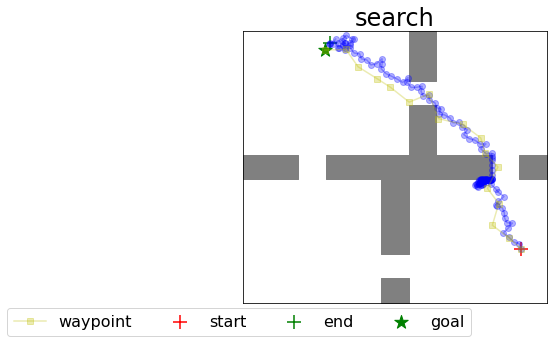

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


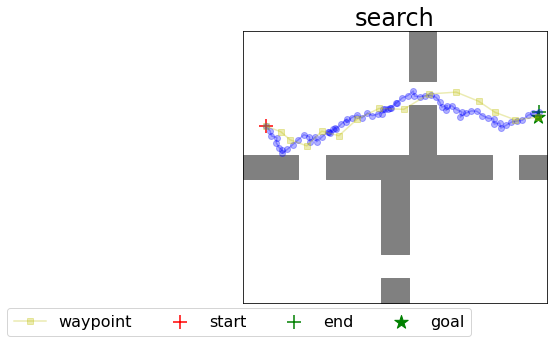

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


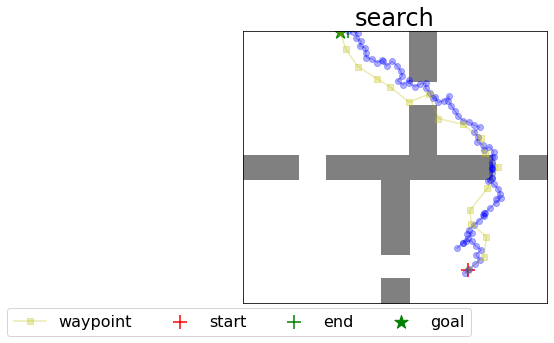

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


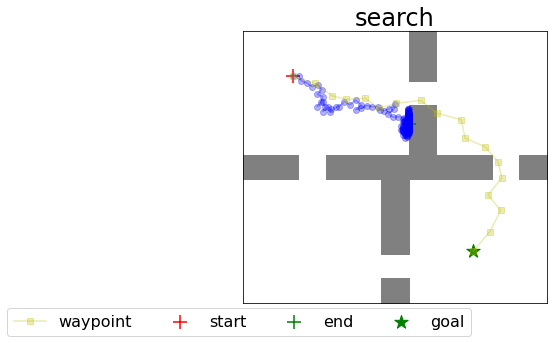

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


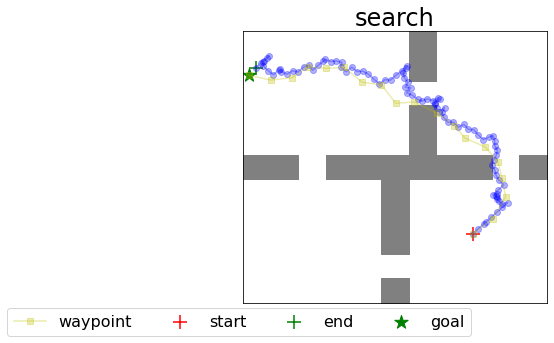

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


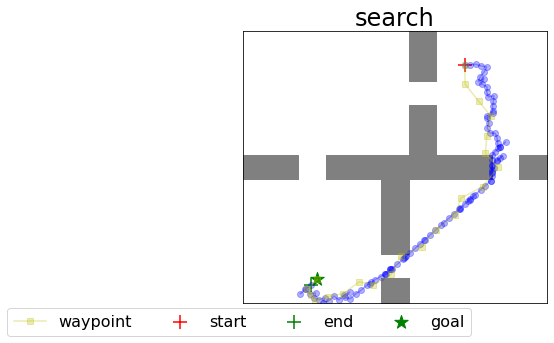

Path success rate is  1.0
Rollout success rate (given path) is  0.85
Average search time (for success) is  14.714922261238097
Search iterations is  133.7
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


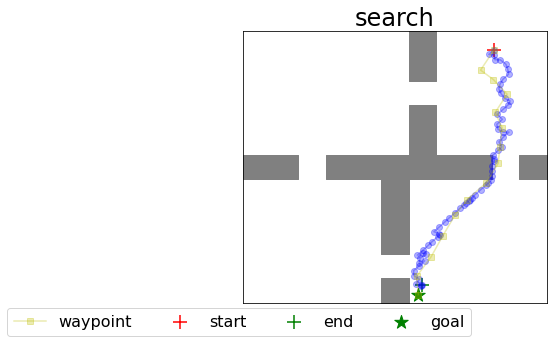

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


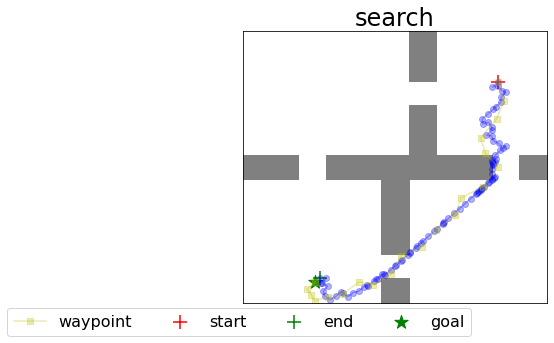

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


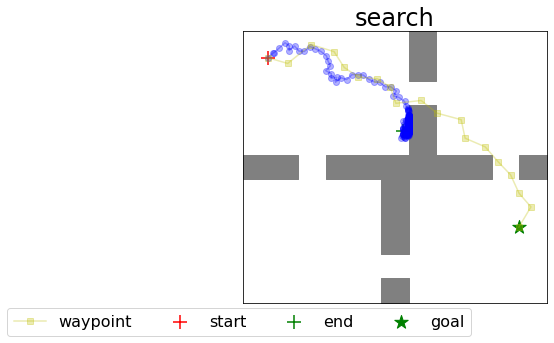

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


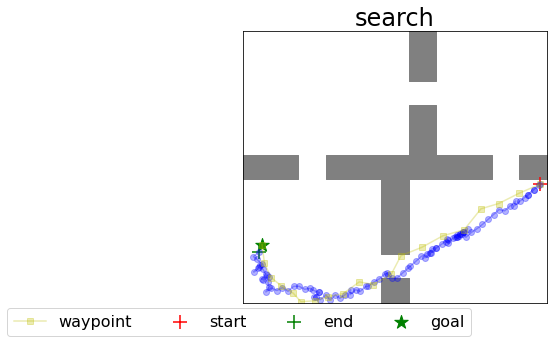

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


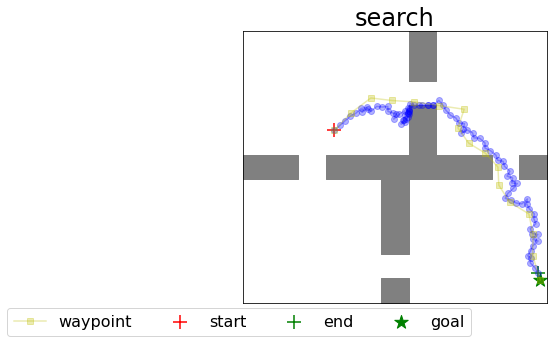

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


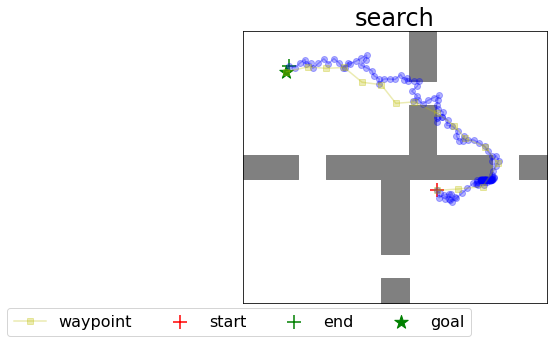

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


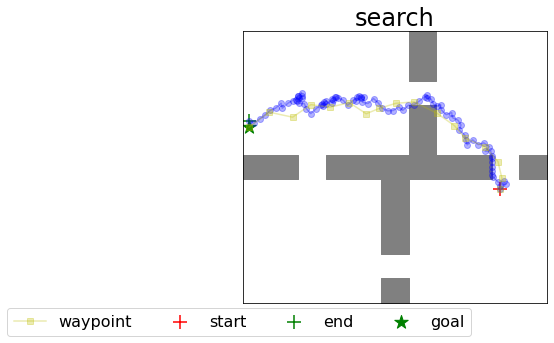

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


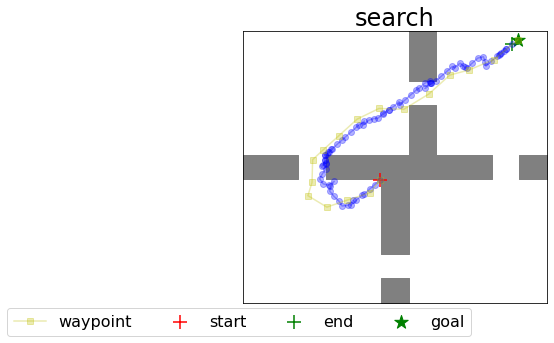

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


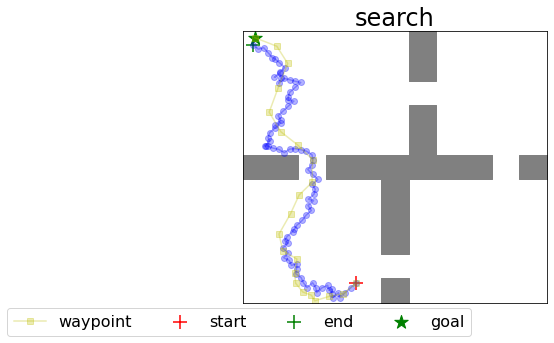

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


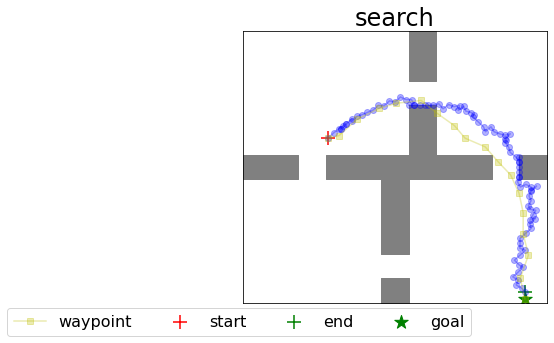

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


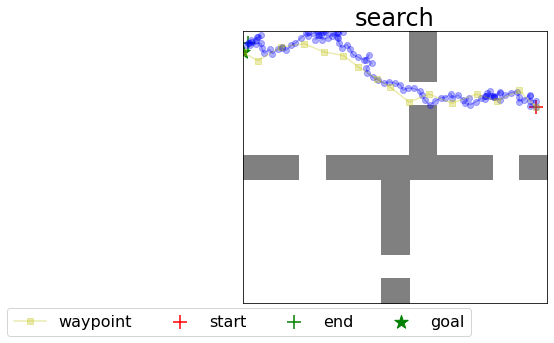

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


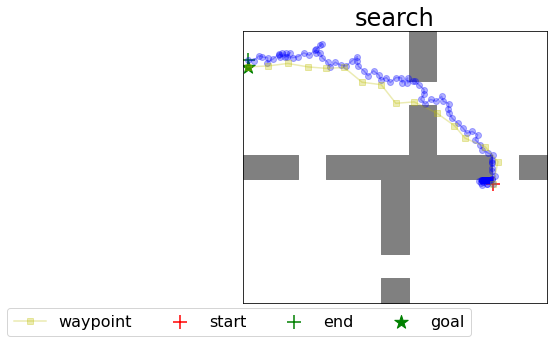

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


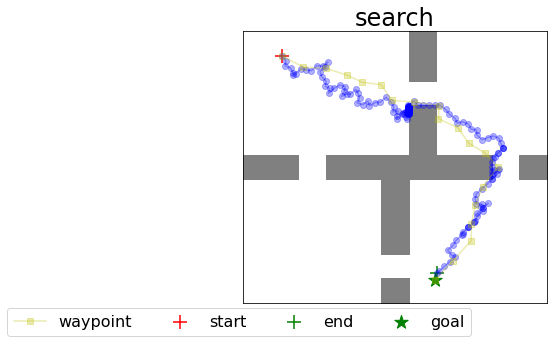

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


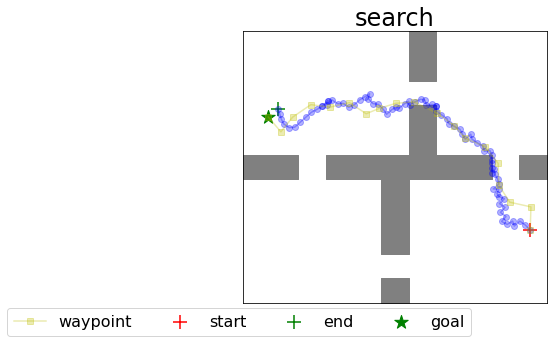

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


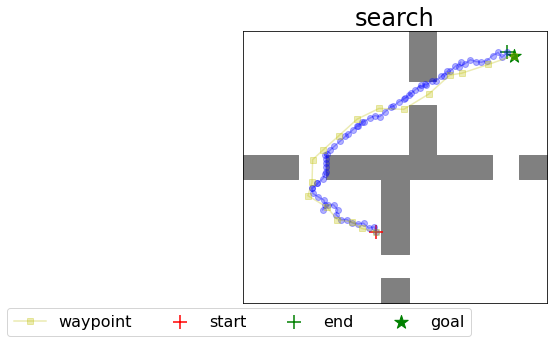

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


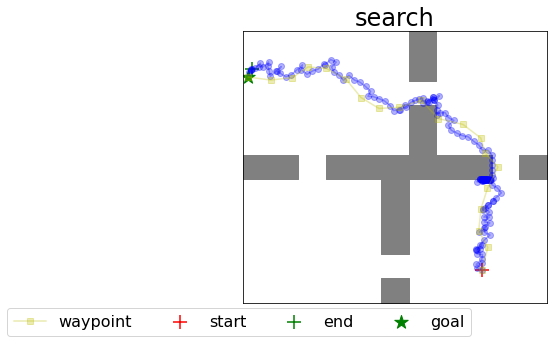

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


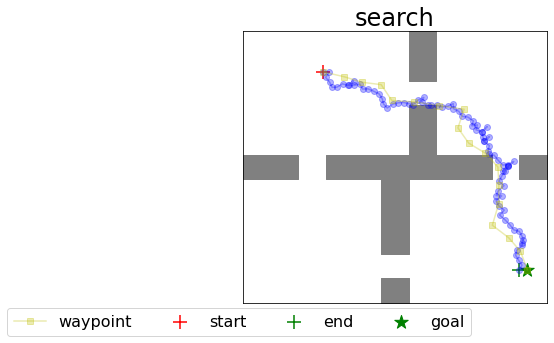

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


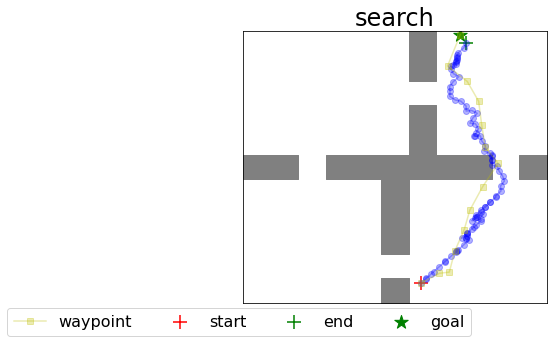

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


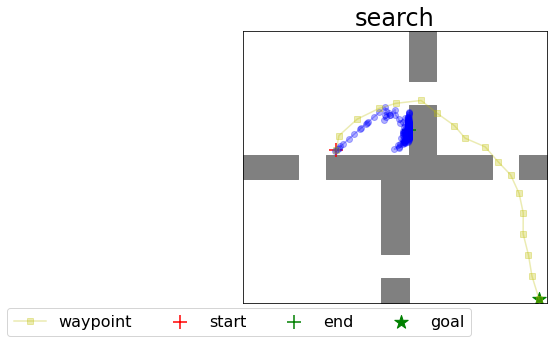

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


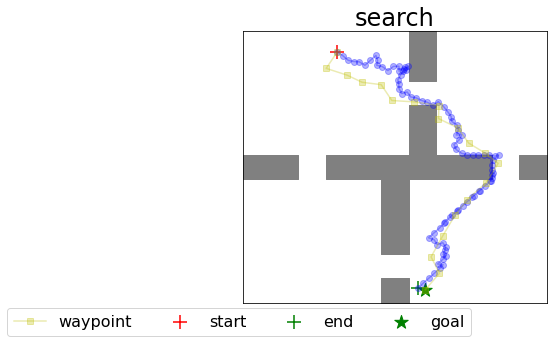

Path success rate is  1.0
Rollout success rate (given path) is  0.9
Average search time (for success) is  14.710895216464996
Search iterations is  121.25
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


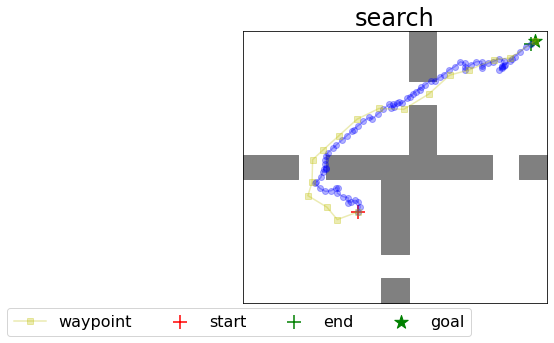

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


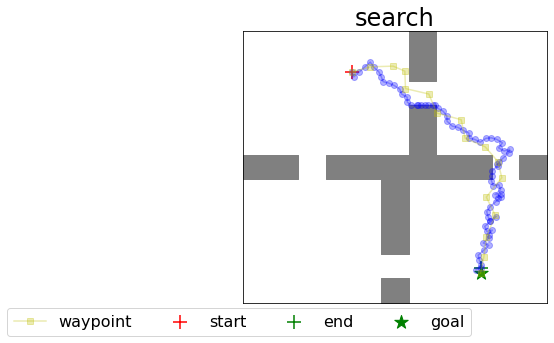

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


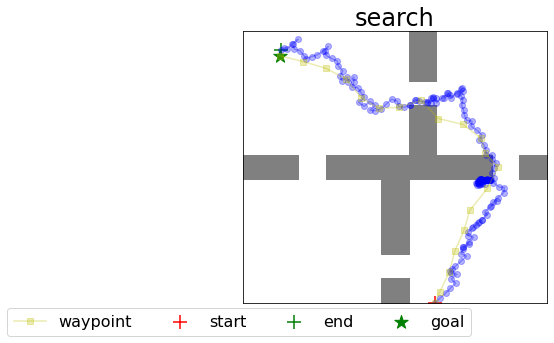

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


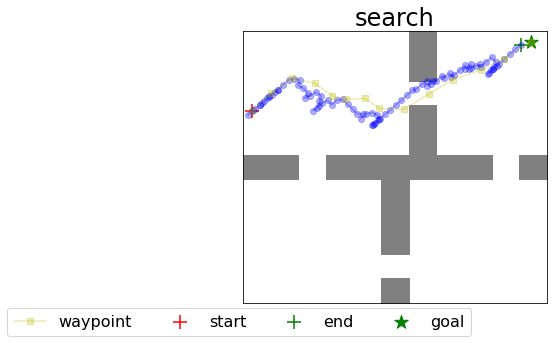

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


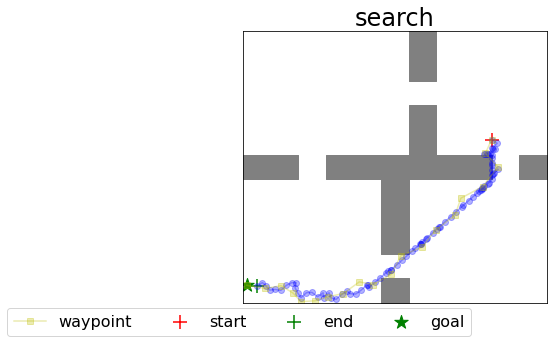

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


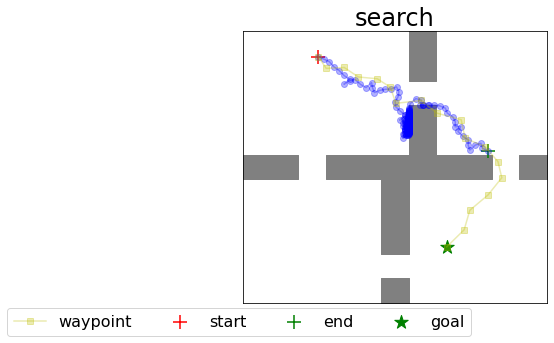

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


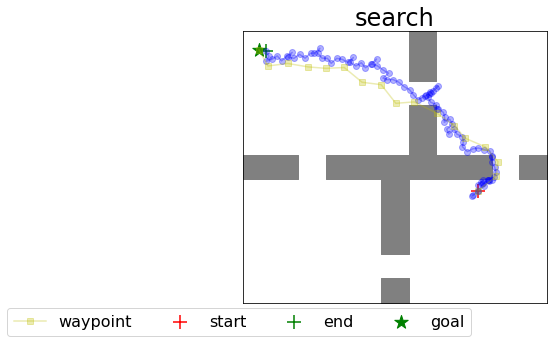

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


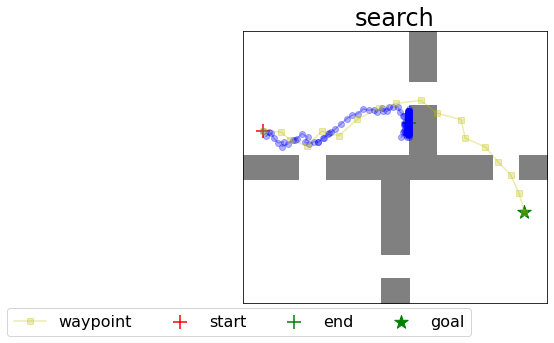

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


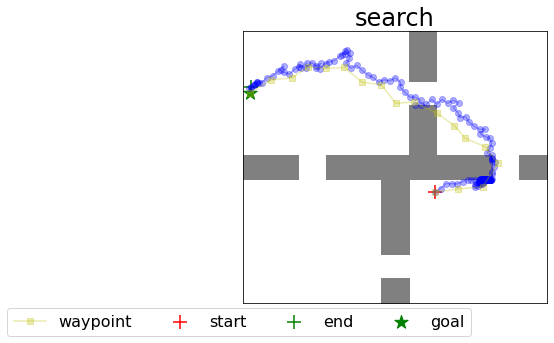

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


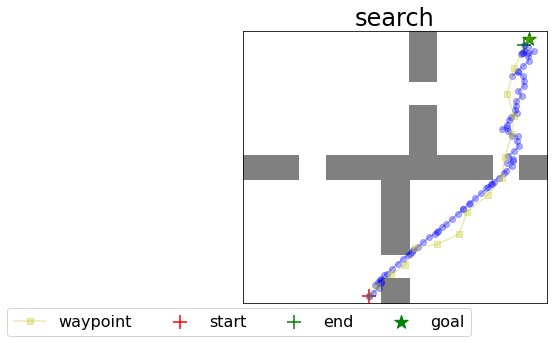

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


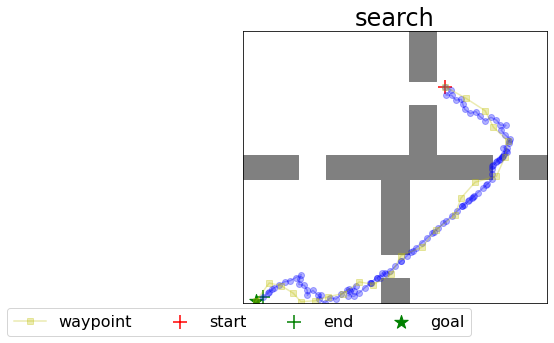

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


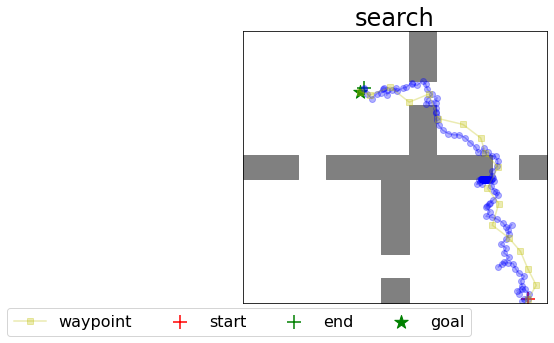

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


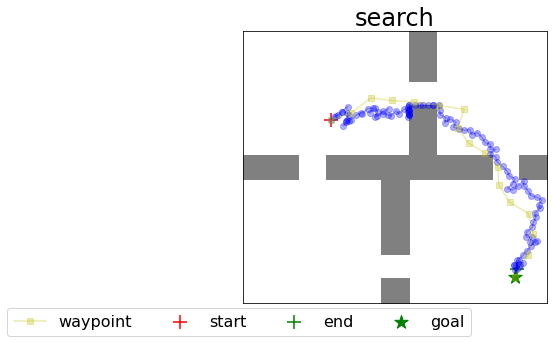

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


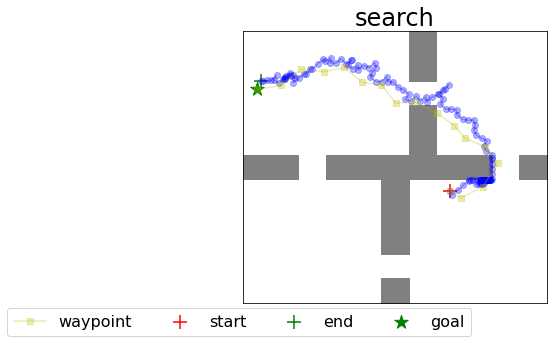

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


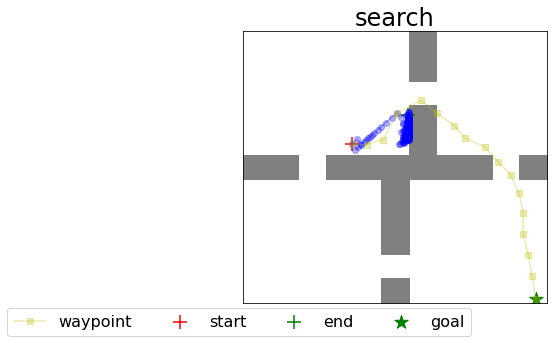

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


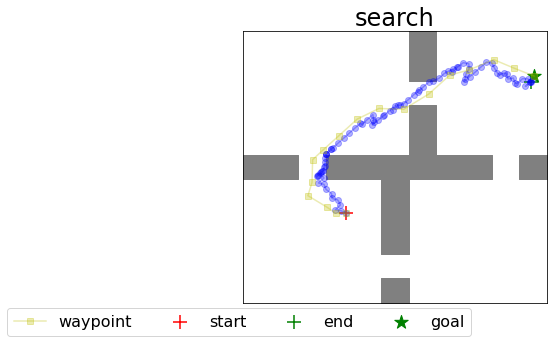

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


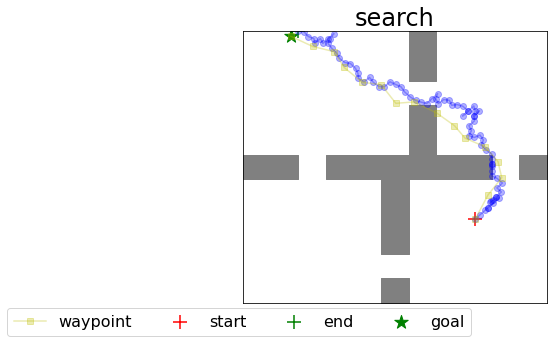

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


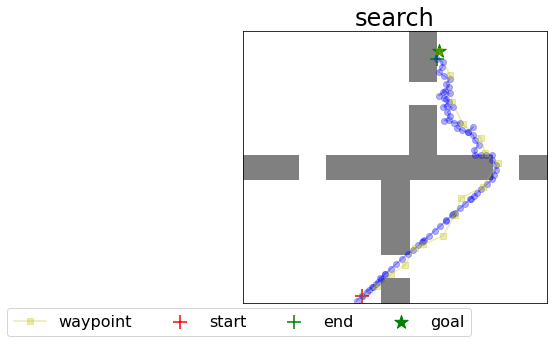

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


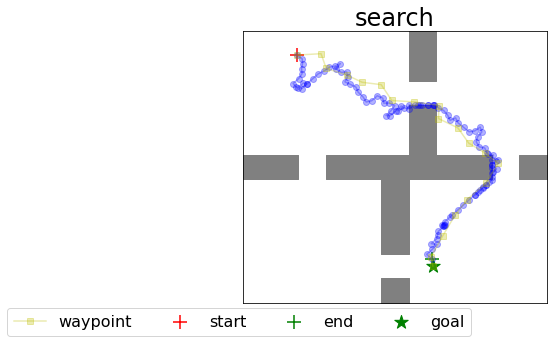

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


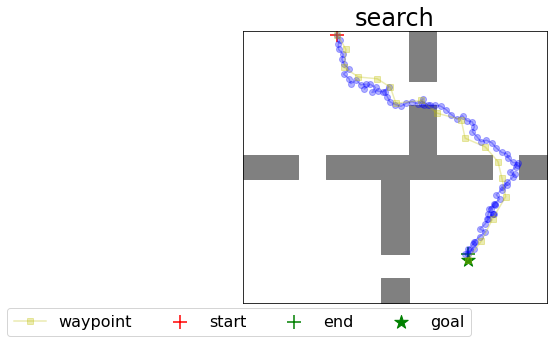

Path success rate is  1.0
Rollout success rate (given path) is  0.85
Average search time (for success) is  15.43118748664856
Search iterations is  142.2
Maze11x11
Spiral11x11


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


random_seed = 0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:67: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


INFO:tensorflow:step = 1000, loss = 2.244333
INFO:tensorflow:59.821 steps/sec
INFO:tensorflow:step = 1000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -16.70
INFO:tensorflow:		 predicted_dist = 15.7 (0.6)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.80
INFO:tensorflow:		 predicted_dist = 15.3 (0.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.0 (0.8)
INFO:tensorflow:	 eval_time = 1.82
INFO:tensorflow:step = 2000, loss = 1.724567
INFO:tensorflow:69.345 steps/sec
INFO:tensorflow:step = 2000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -16.60
INFO:tensorflow:		 predicted_dist = 14.7 (1.3)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 15.3 (1.3)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -19.30
INFO:tensorflow:		 predicted_dist = 16.7 (1.0)
INFO:tensorflow:	 eval_time = 1.69
INFO:tensorflow:step

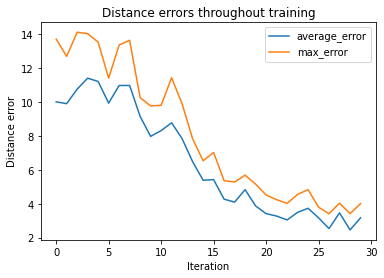

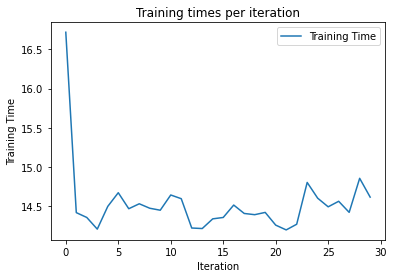

random_seed = 0


INFO:tensorflow:step = 31000, loss = 2.963366
INFO:tensorflow:61.512 steps/sec
INFO:tensorflow:step = 31000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -3.20
INFO:tensorflow:		 predicted_dist = 5.0 (1.5)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -9.00
INFO:tensorflow:		 predicted_dist = 8.1 (1.1)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -14.20
INFO:tensorflow:		 predicted_dist = 11.9 (0.5)
INFO:tensorflow:	 eval_time = 1.40
INFO:tensorflow:step = 32000, loss = 2.940629
INFO:tensorflow:68.439 steps/sec
INFO:tensorflow:step = 32000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -2.30
INFO:tensorflow:		 predicted_dist = 4.8 (1.2)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -8.10
INFO:tensorflow:		 predicted_dist = 8.2 (1.0)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -16.50
INFO:tensorflow:		 predicted_dist = 11.3 (0.8)
INFO:tensorflow:	 eval_time = 1.32
INFO:tensorflow:step = 3

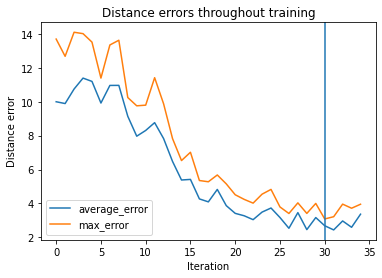

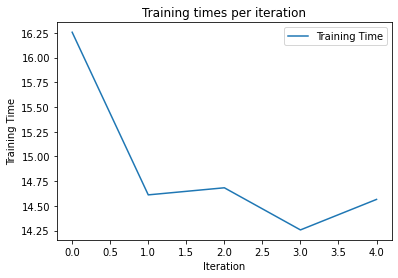

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:126: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


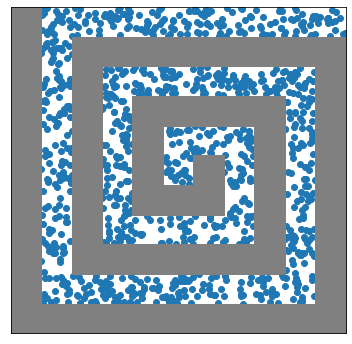

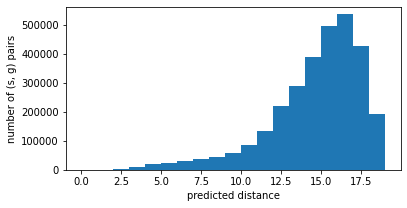

Searching with max steps of  7
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


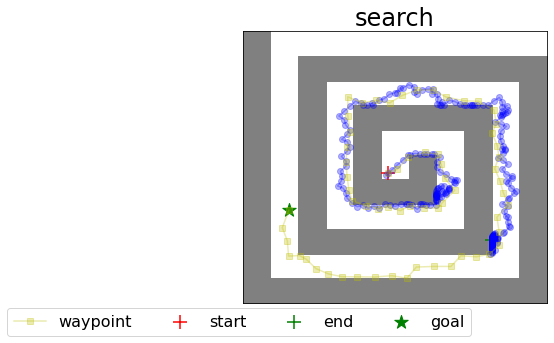

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


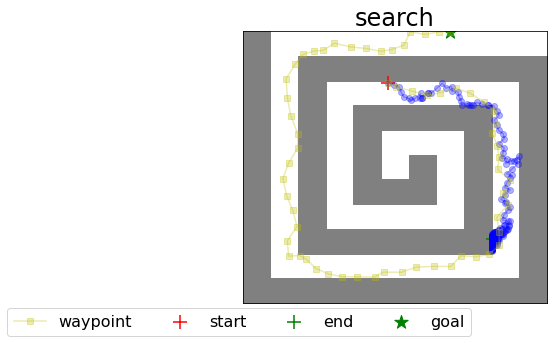

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


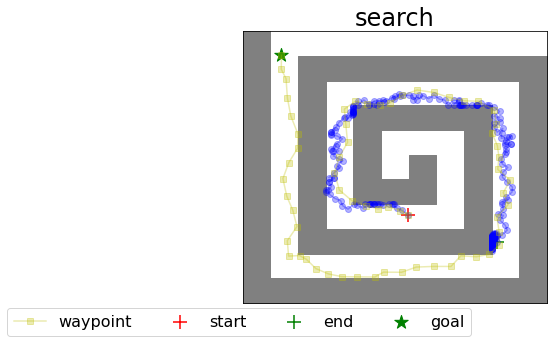

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


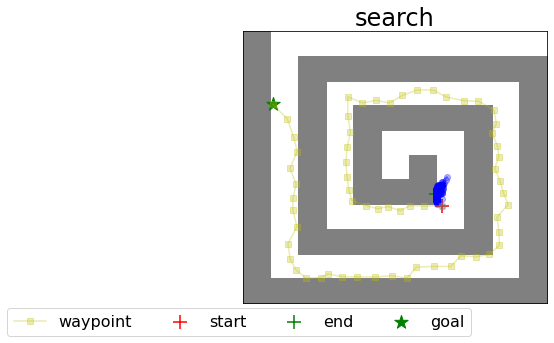

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


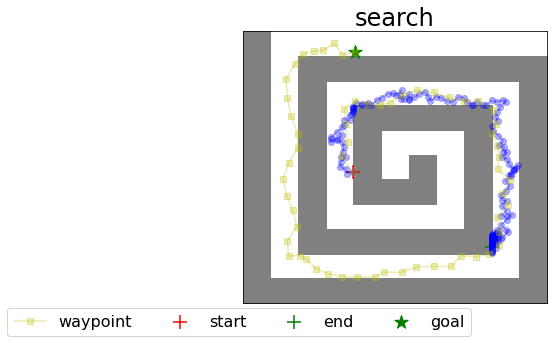

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


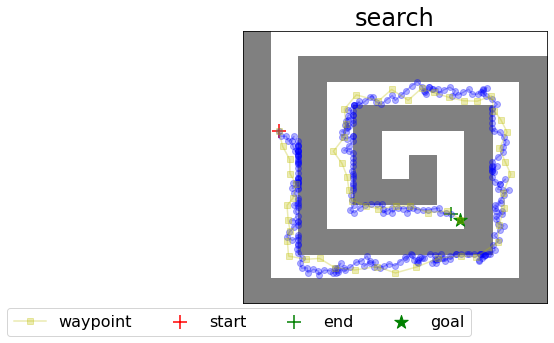

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


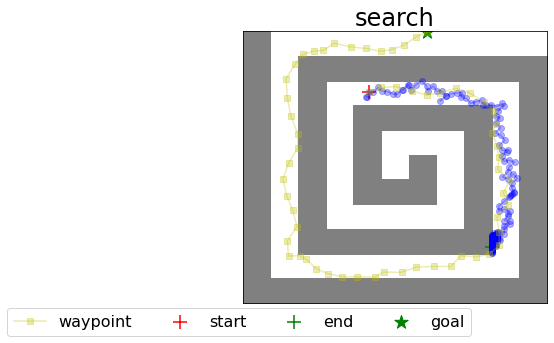

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


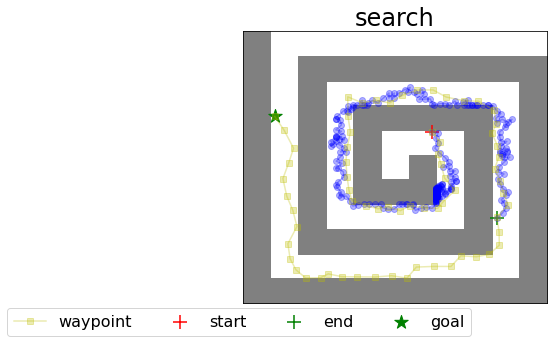

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


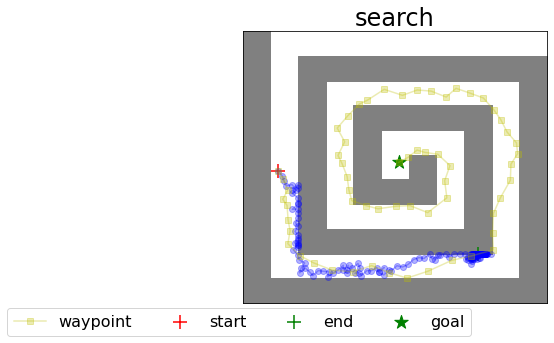

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


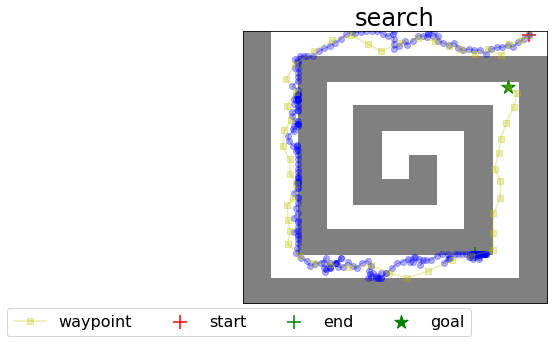

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


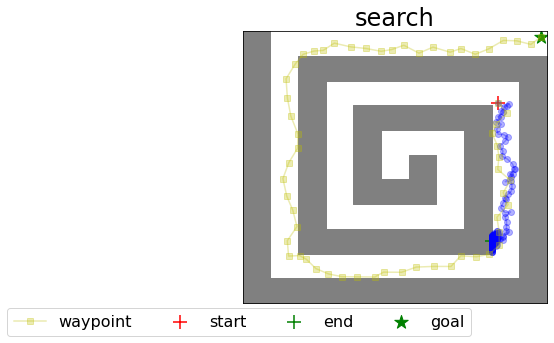

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


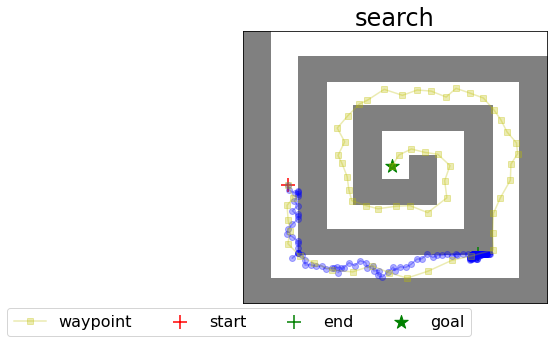

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


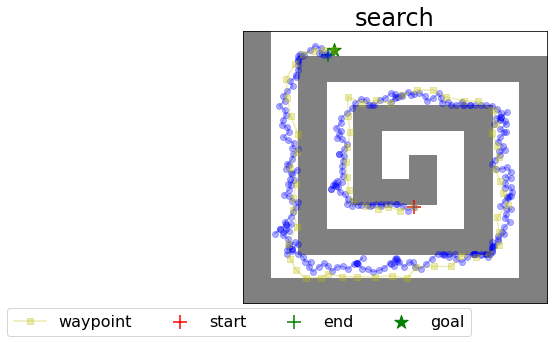

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


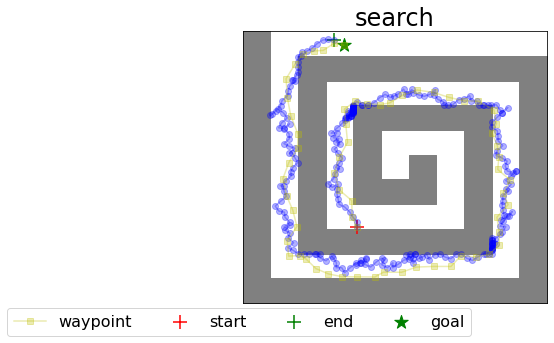

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


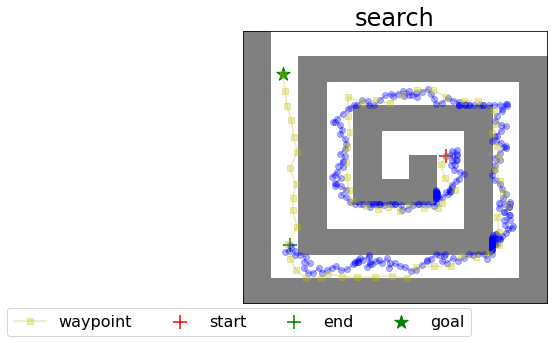

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


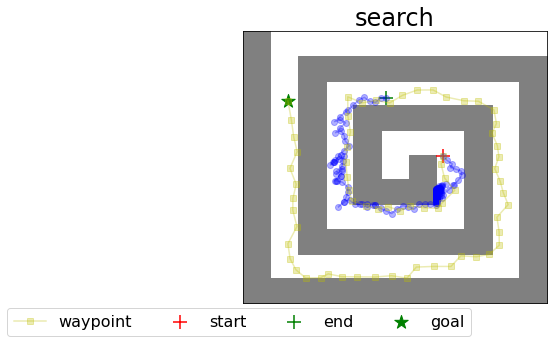

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


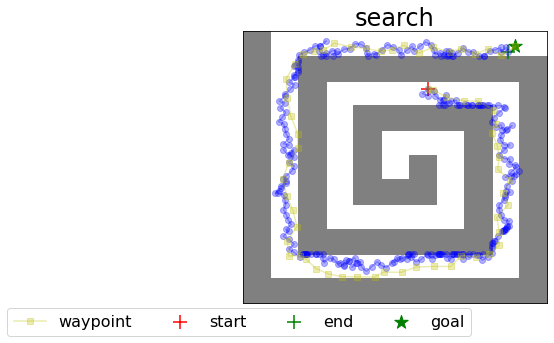

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


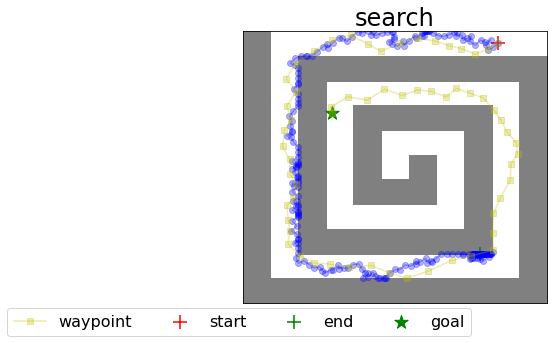

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


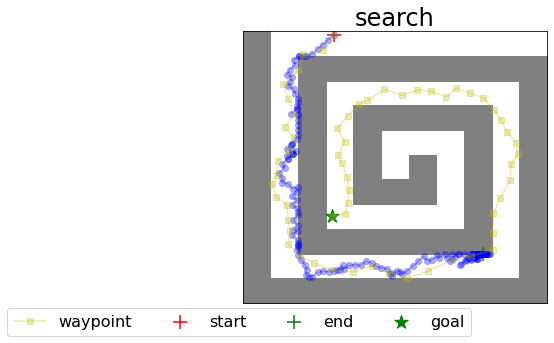

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


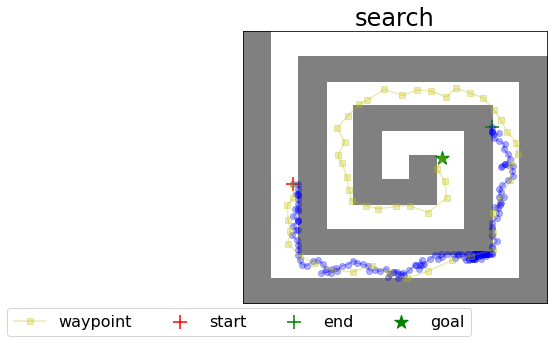

Path success rate is  1.0
Rollout success rate (given path) is  0.2
Average search time (for success) is  21.559625041484832
Search iterations is  297.25
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


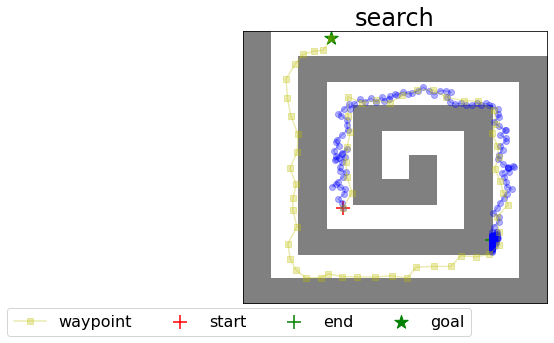

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


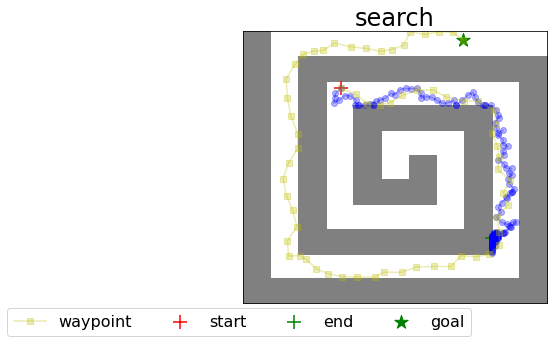

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


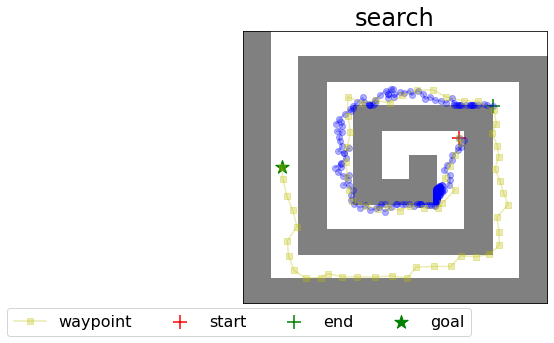

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


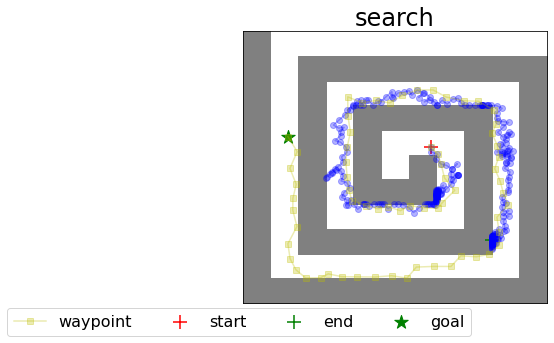

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


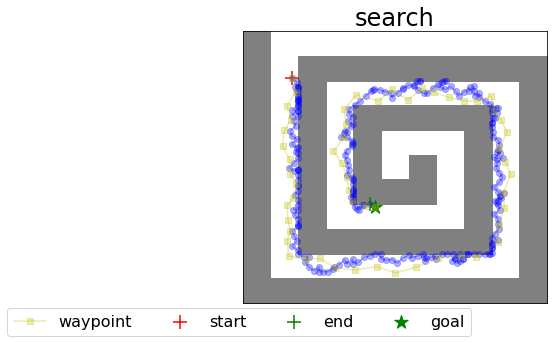

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


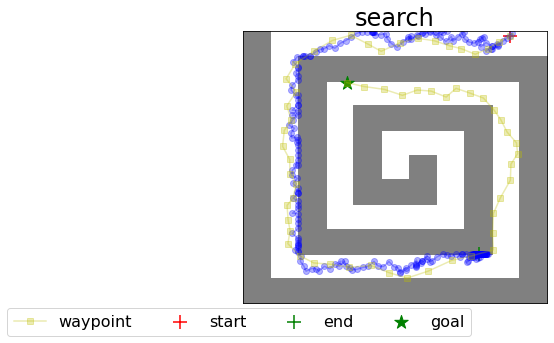

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


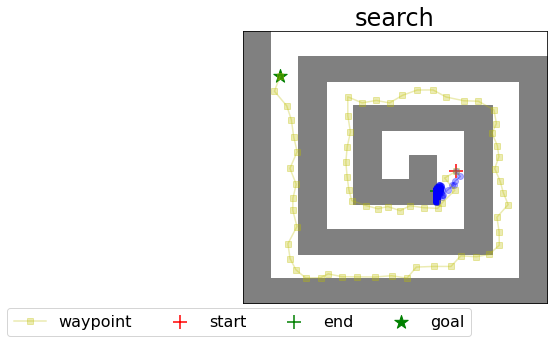

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


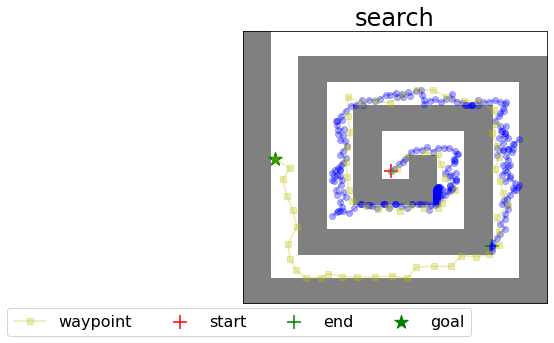

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


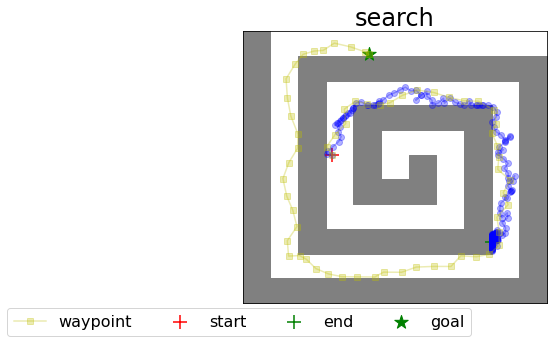

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


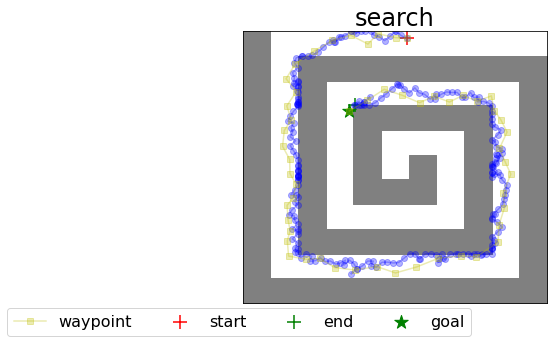

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


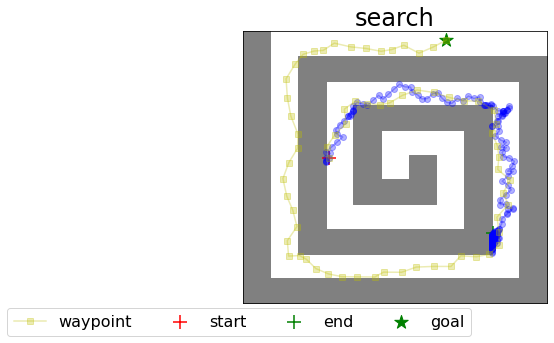

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


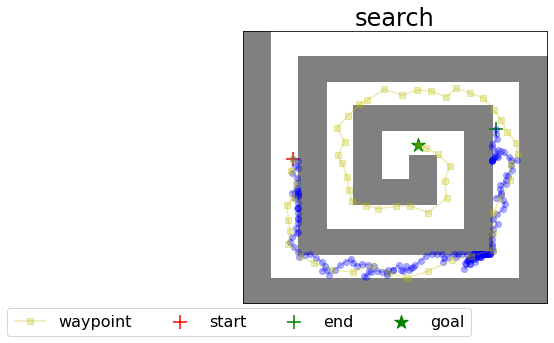

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


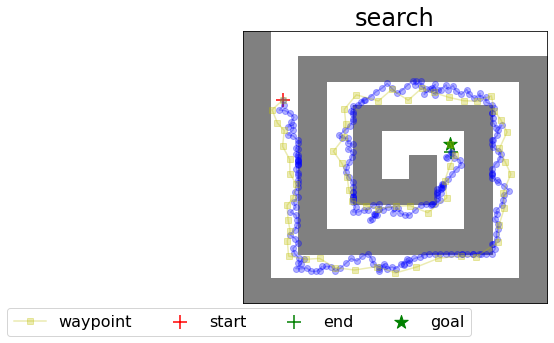

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


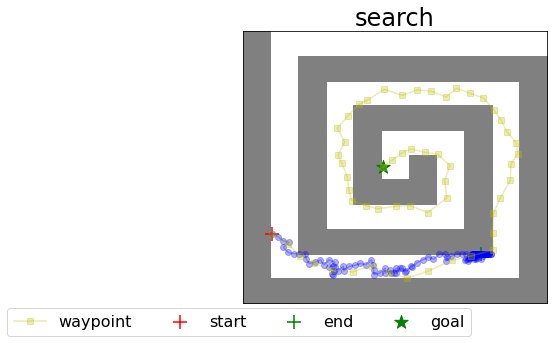

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


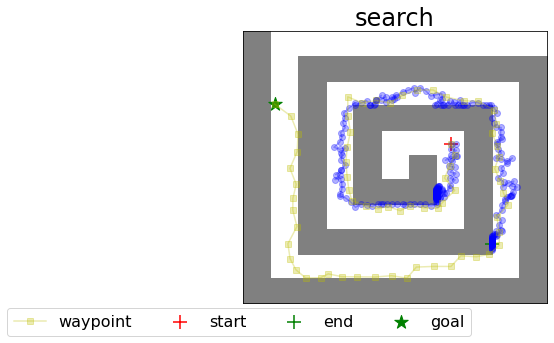

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


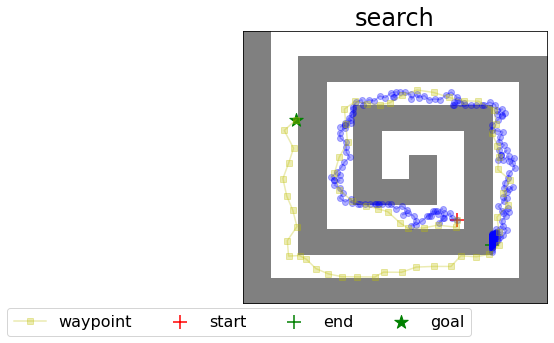

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


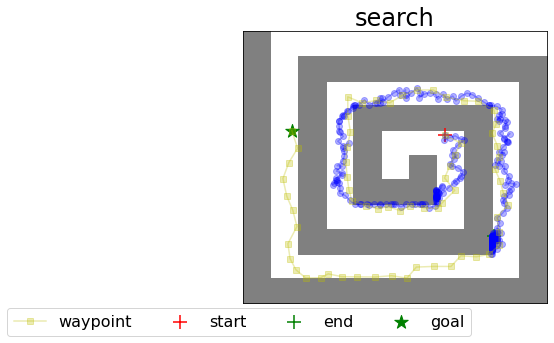

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


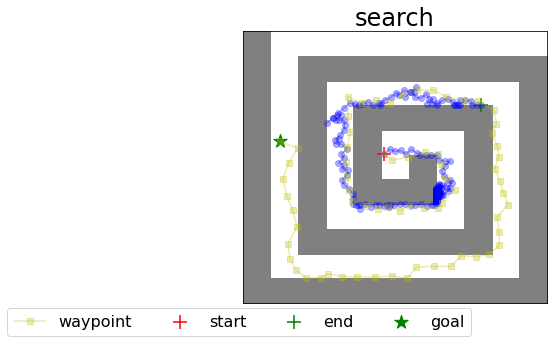

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


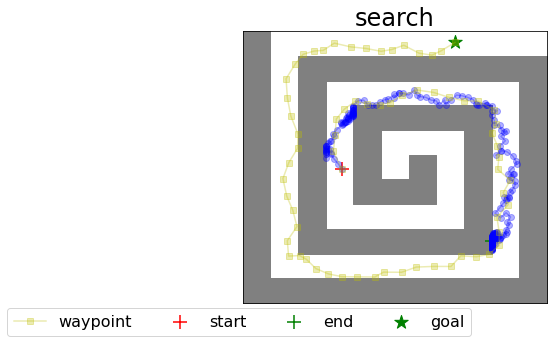

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


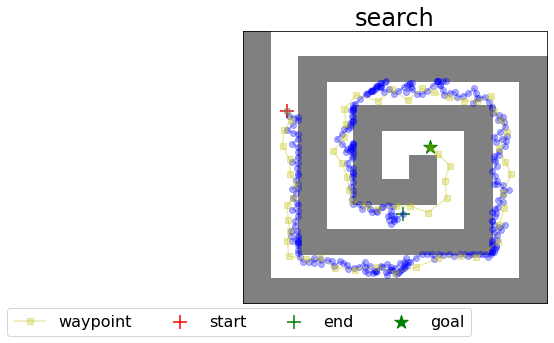

Path success rate is  1.0
Rollout success rate (given path) is  0.15
Average search time (for success) is  21.240512025356292
Search iterations is  292.25
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


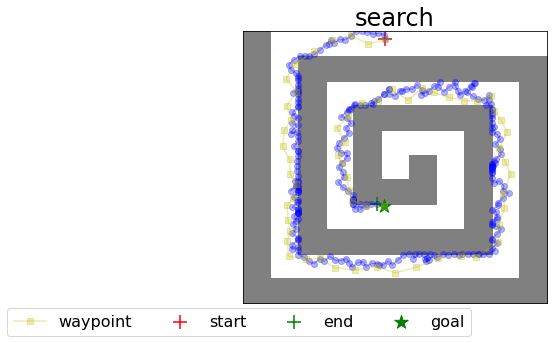

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


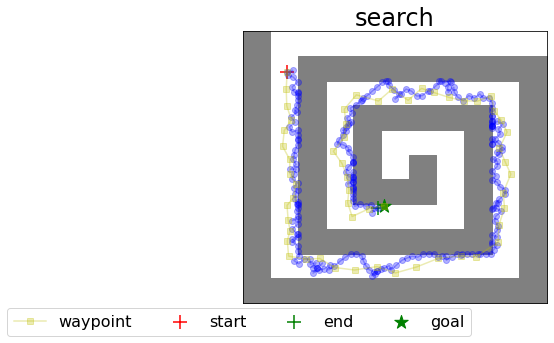

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


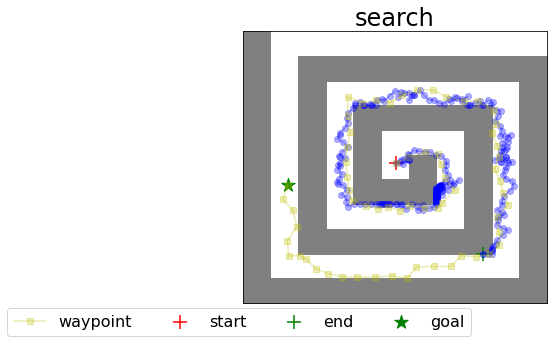

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


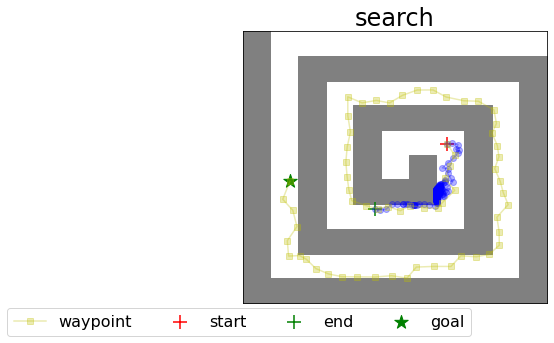

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


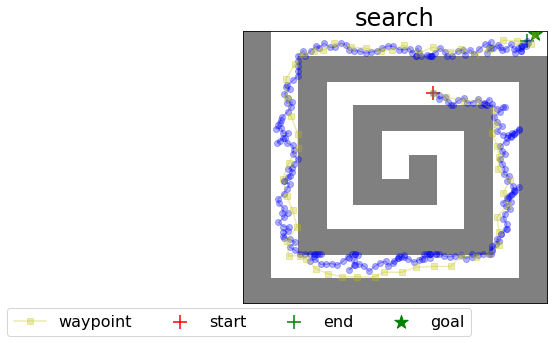

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


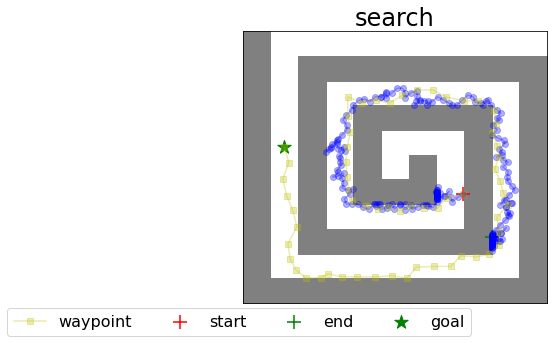

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


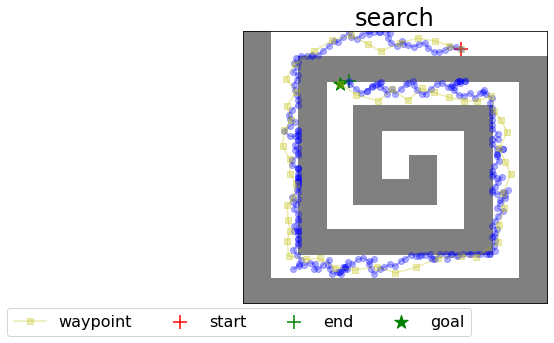

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


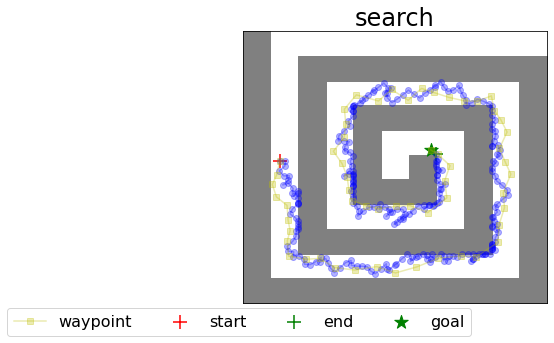

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


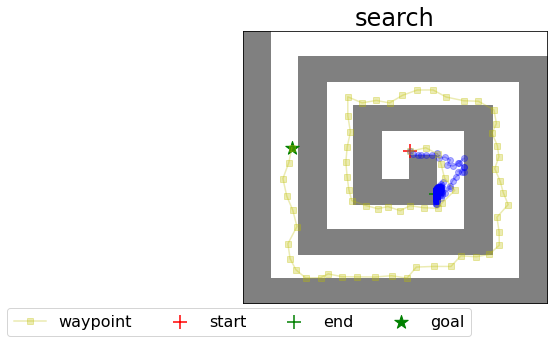

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


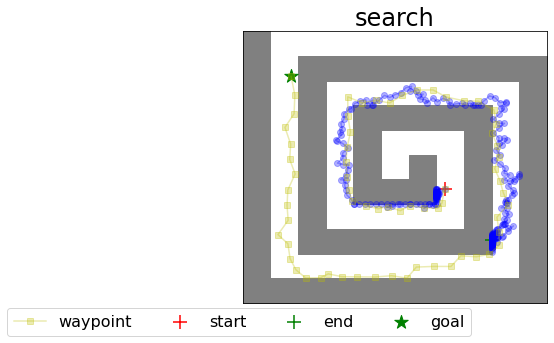

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


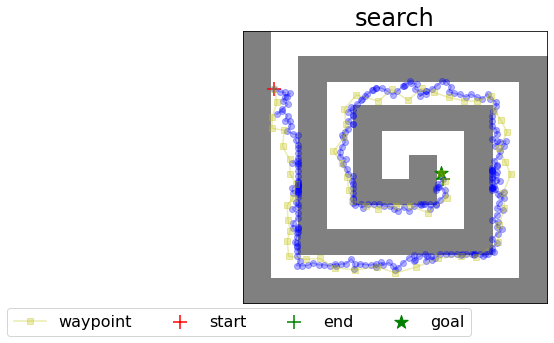

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


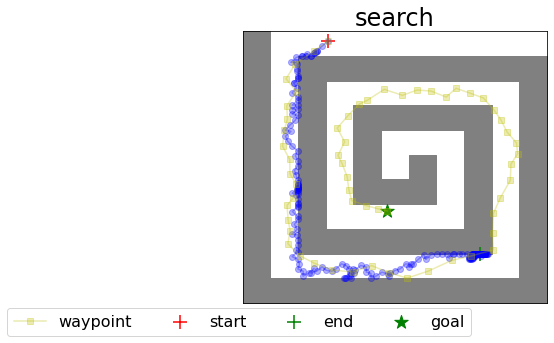

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


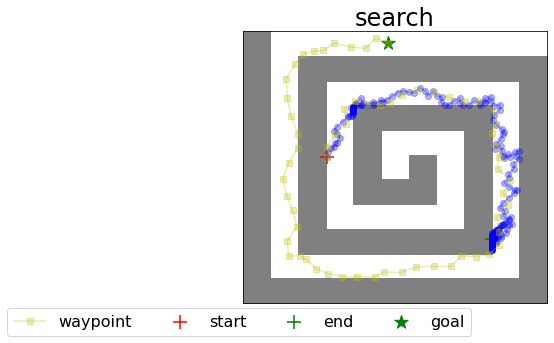

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


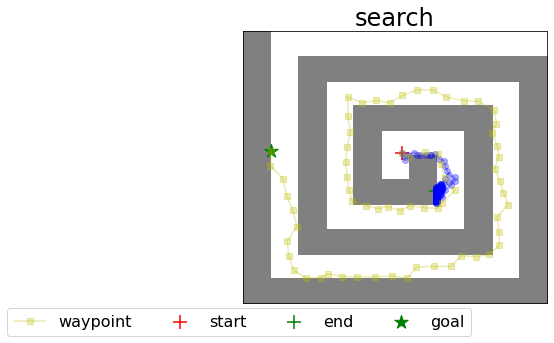

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


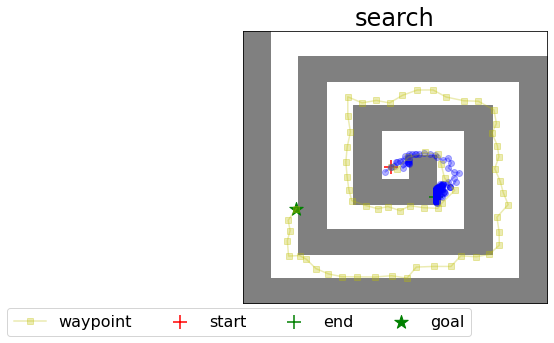

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


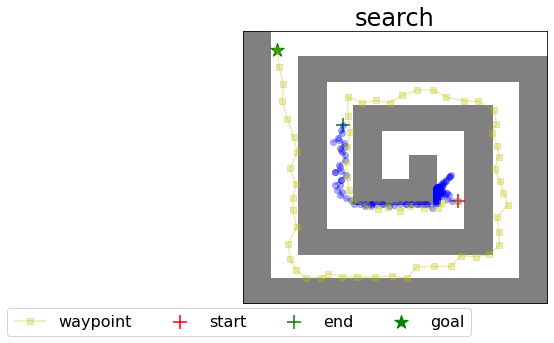

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


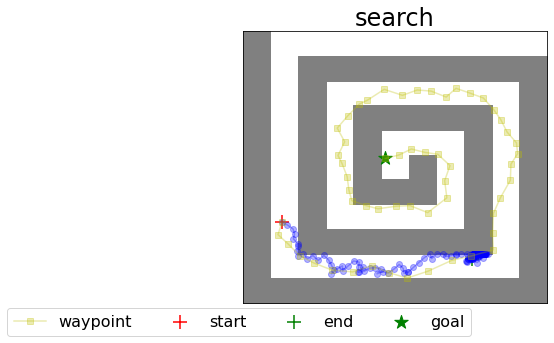

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


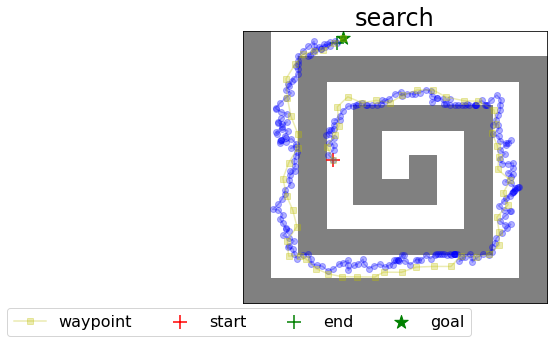

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


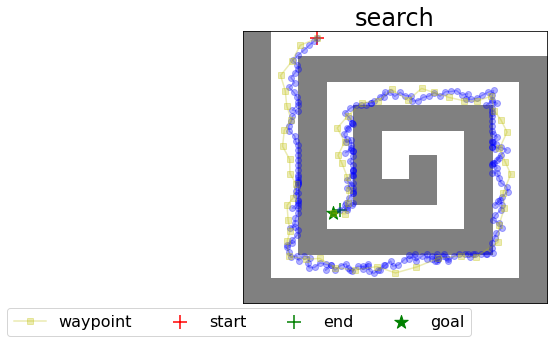

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


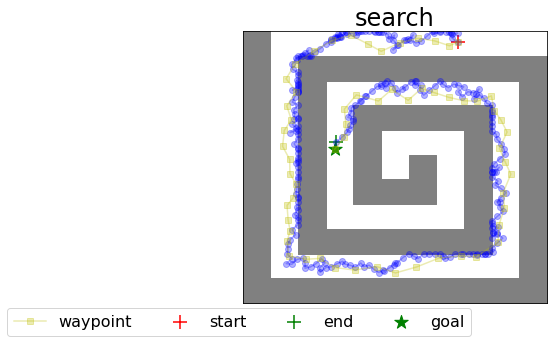

Path success rate is  1.0
Rollout success rate (given path) is  0.45
Average search time (for success) is  21.180640006065367
Search iterations is  283.85
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


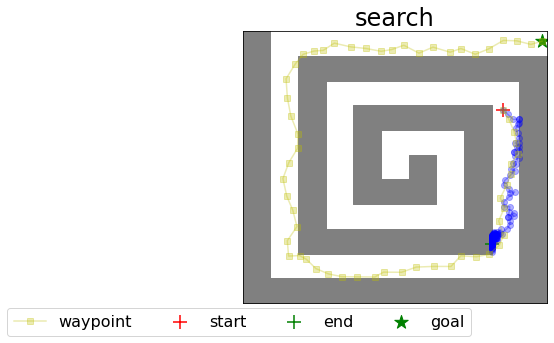

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


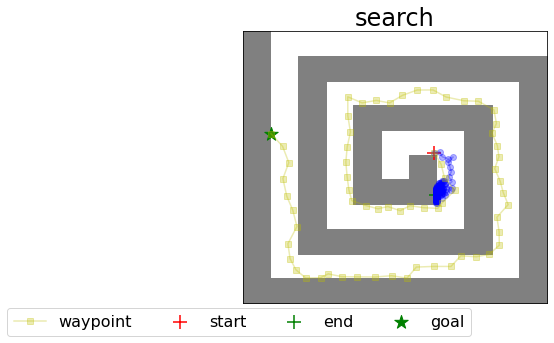

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


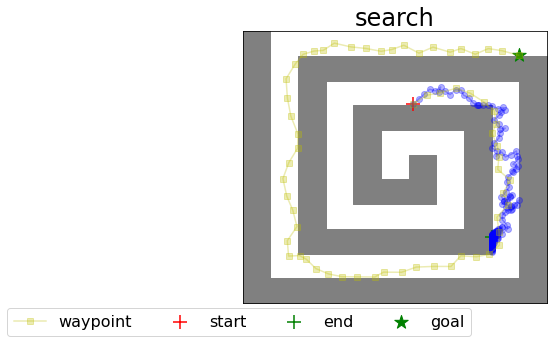

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


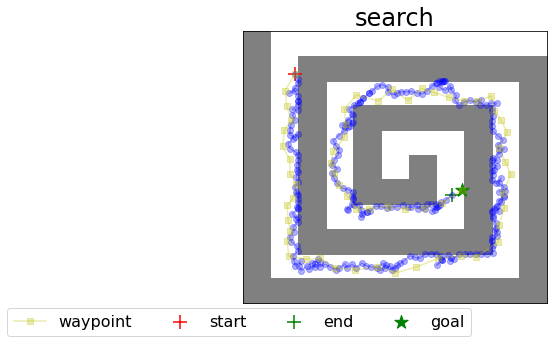

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


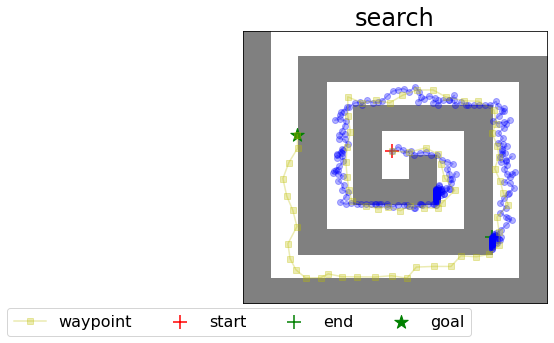

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


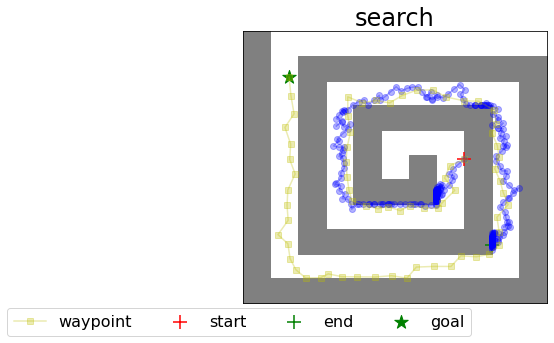

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


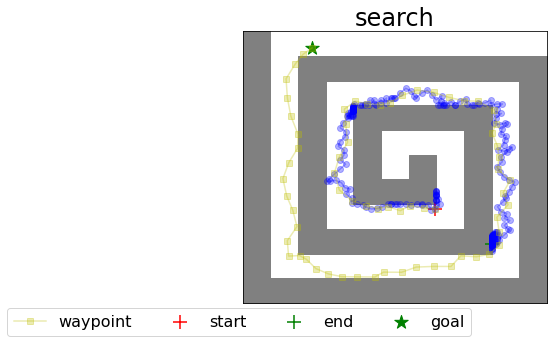

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


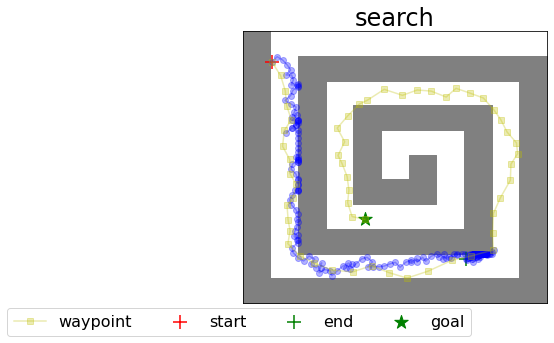

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


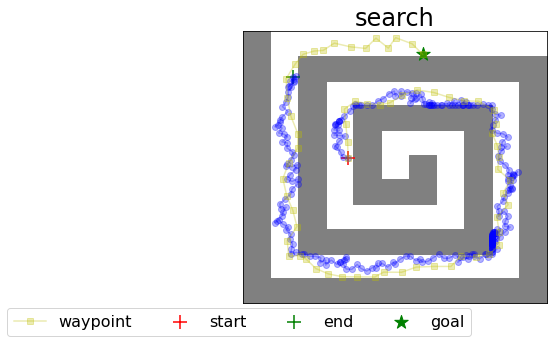

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


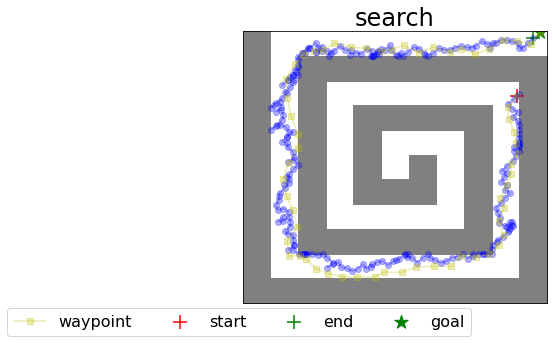

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


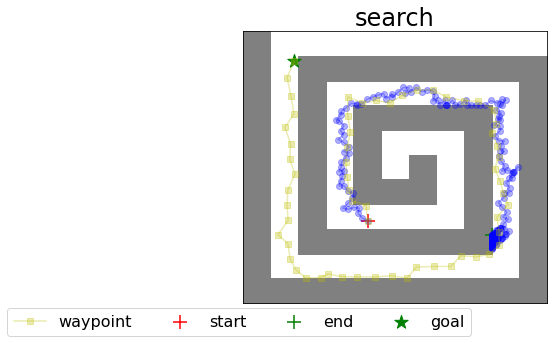

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


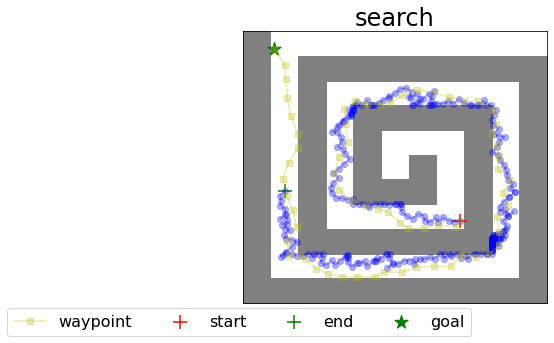

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


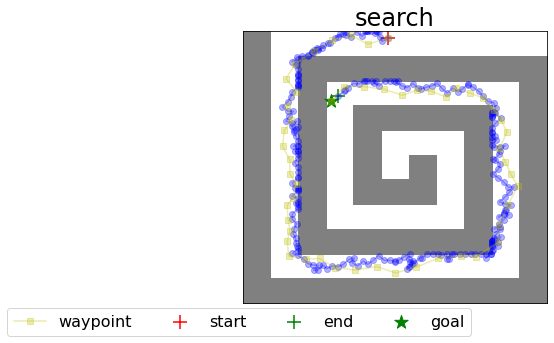

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


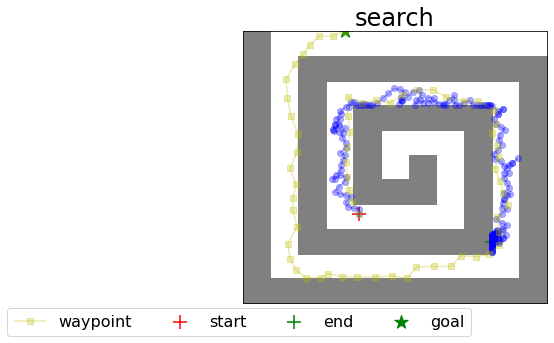

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


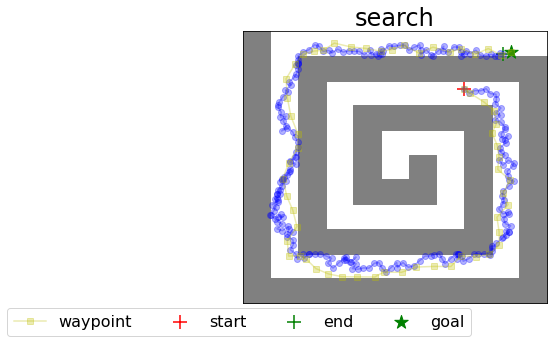

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


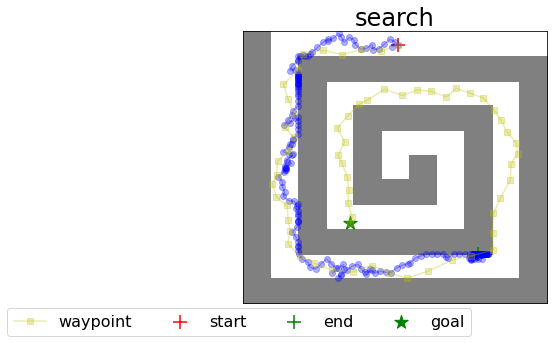

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


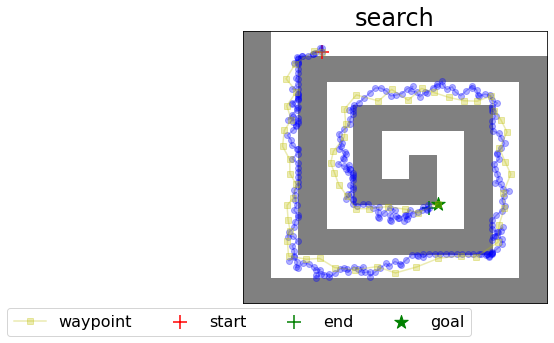

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


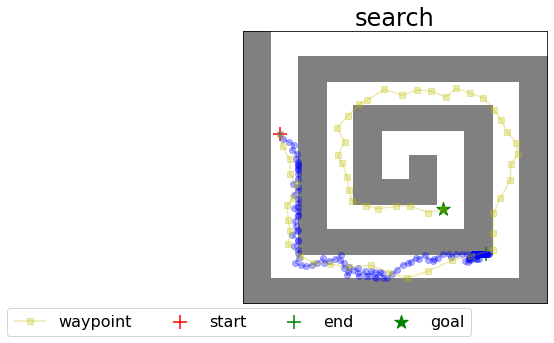

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


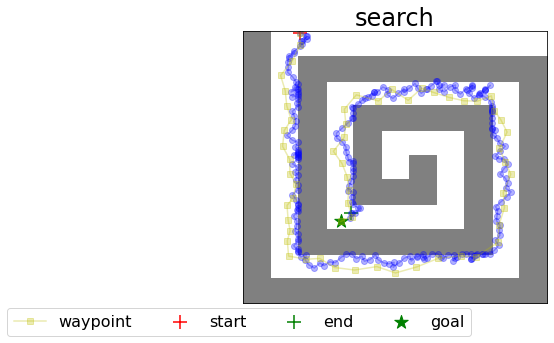

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


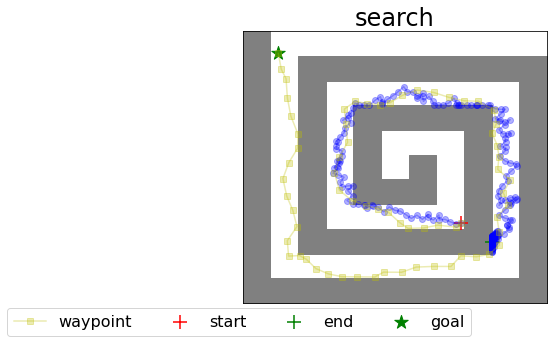

Path success rate is  1.0
Rollout success rate (given path) is  0.3
Average search time (for success) is  21.245314359664917
Search iterations is  286.6
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


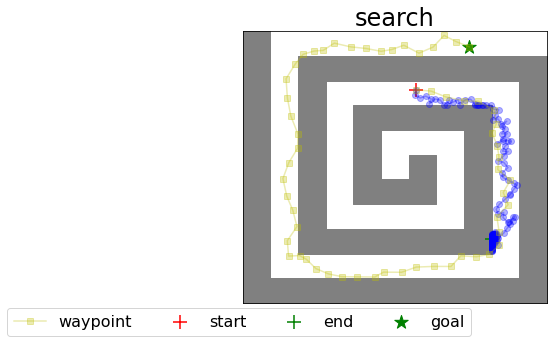

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


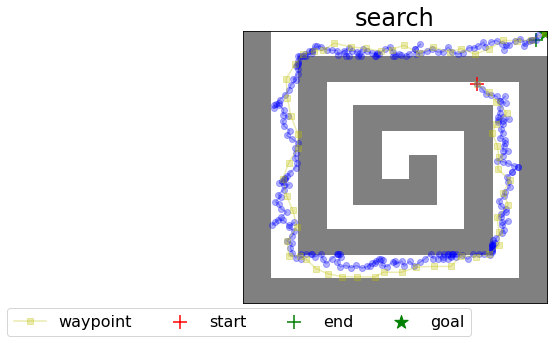

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


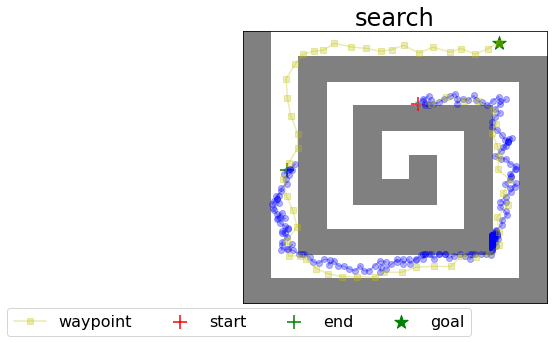

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


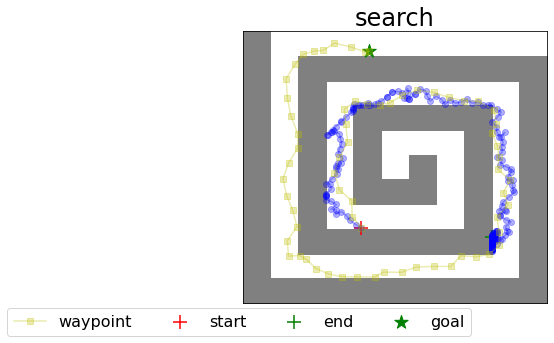

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


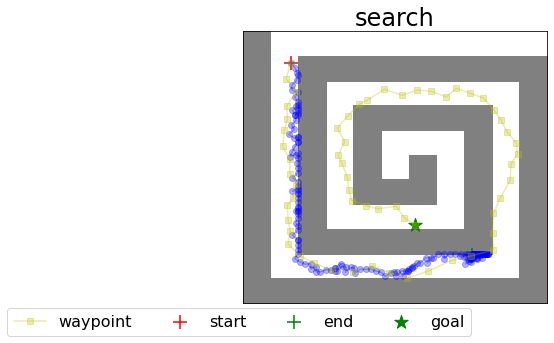

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


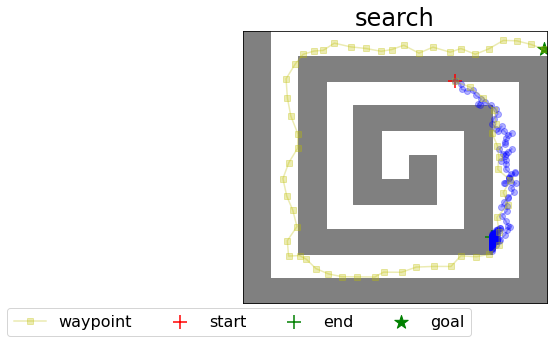

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


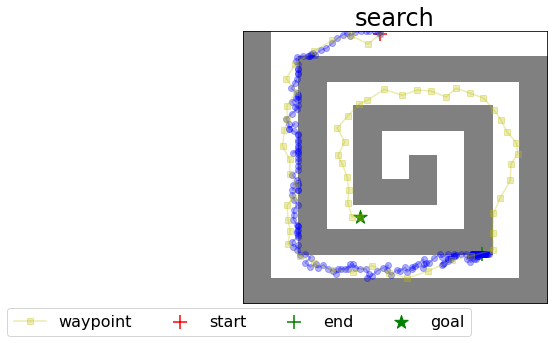

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


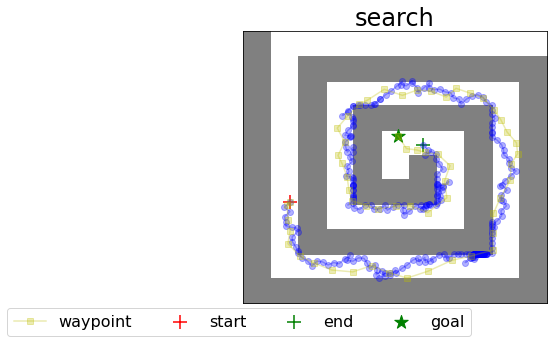

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


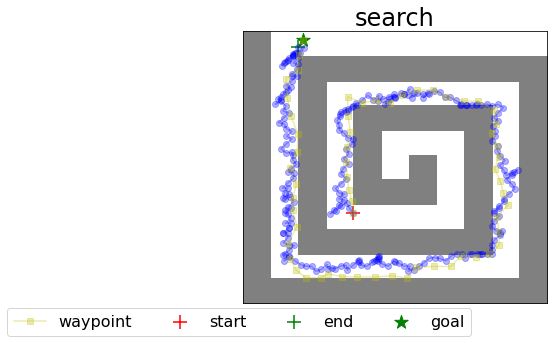

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


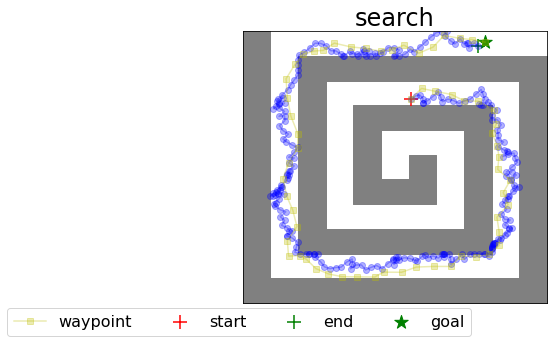

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


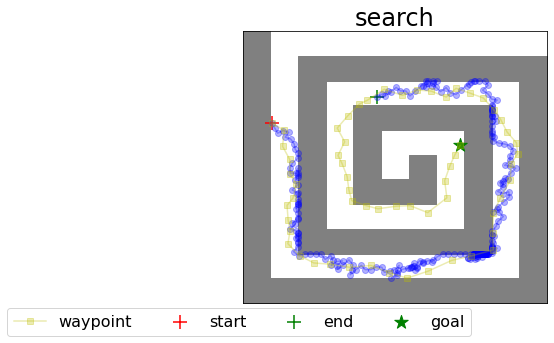

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


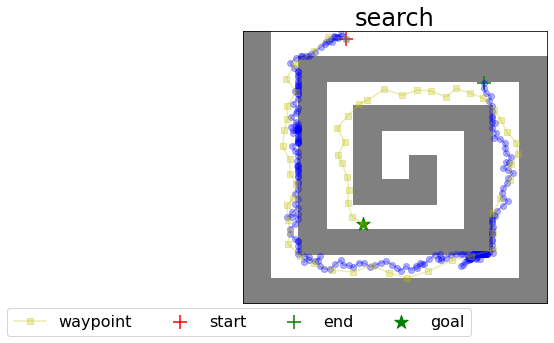

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


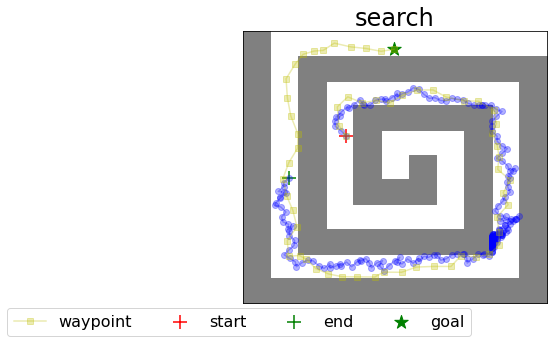

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


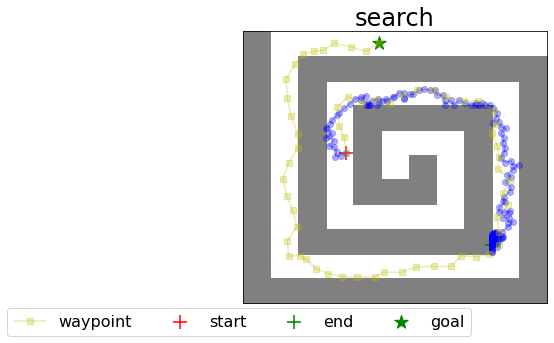

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


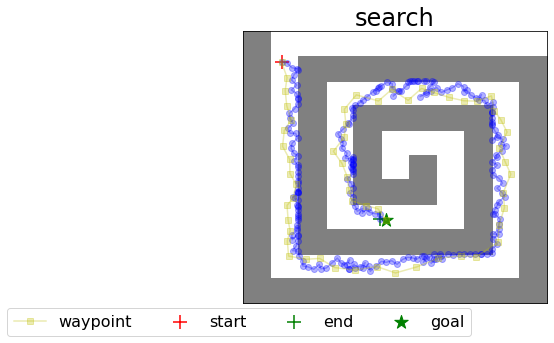

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


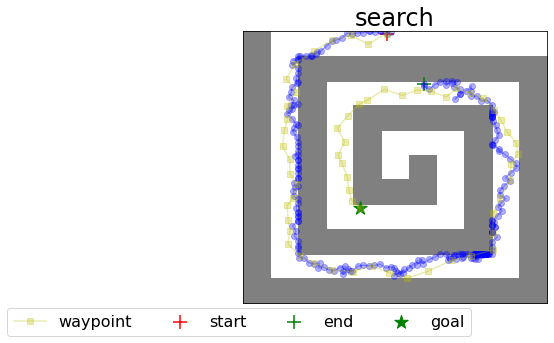

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


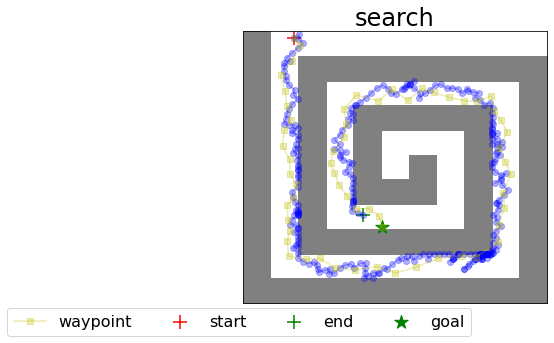

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


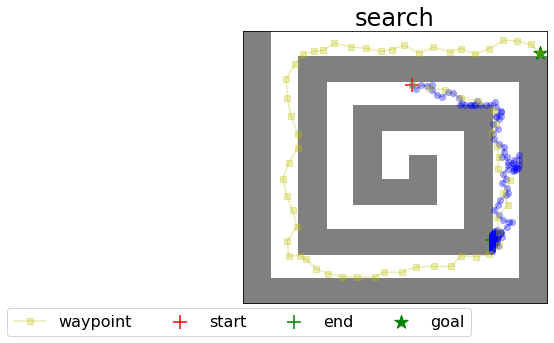

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


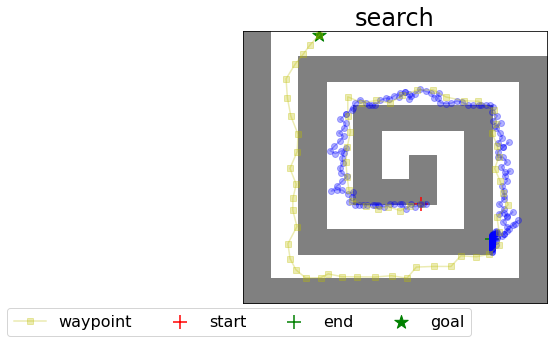

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


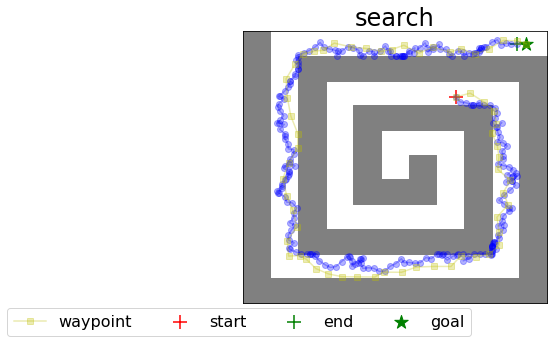

Path success rate is  1.0
Rollout success rate (given path) is  0.25
Average search time (for success) is  21.198005425930024
Search iterations is  289.35
Spiral11x11
FourRooms


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


random_seed = 0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:67: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


INFO:tensorflow:step = 1000, loss = 2.209862
INFO:tensorflow:59.307 steps/sec
INFO:tensorflow:step = 1000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.20
INFO:tensorflow:		 predicted_dist = 15.1 (0.9)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -15.30
INFO:tensorflow:		 predicted_dist = 15.1 (0.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.1 (0.8)
INFO:tensorflow:	 eval_time = 1.75
INFO:tensorflow:step = 2000, loss = 1.428992
INFO:tensorflow:69.297 steps/sec
INFO:tensorflow:step = 2000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.20
INFO:tensorflow:		 predicted_dist = 16.0 (0.6)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.70
INFO:tensorflow:		 predicted_dist = 16.3 (0.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -19.50
INFO:tensorflow:		 predicted_dist = 17.4 (0.4)
INFO:tensorflow:	 eval_time = 1.71
INFO:tensorflow:step

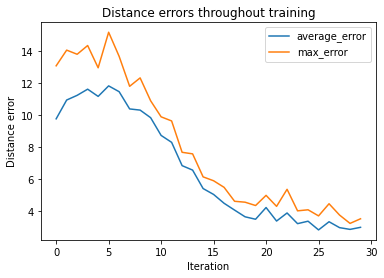

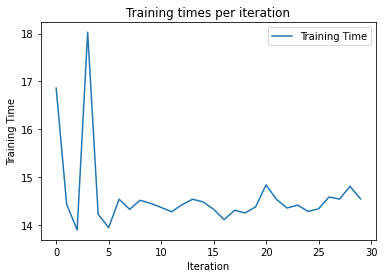

random_seed = 0


INFO:tensorflow:step = 31000, loss = 2.695847
INFO:tensorflow:61.642 steps/sec
INFO:tensorflow:step = 31000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -3.00
INFO:tensorflow:		 predicted_dist = 4.7 (1.8)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -9.90
INFO:tensorflow:		 predicted_dist = 9.1 (0.9)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -15.40
INFO:tensorflow:		 predicted_dist = 13.2 (1.6)
INFO:tensorflow:	 eval_time = 1.42
INFO:tensorflow:step = 32000, loss = 2.884124
INFO:tensorflow:67.178 steps/sec
INFO:tensorflow:step = 32000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -3.80
INFO:tensorflow:		 predicted_dist = 4.8 (1.7)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -9.10
INFO:tensorflow:		 predicted_dist = 9.4 (1.3)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -17.80
INFO:tensorflow:		 predicted_dist = 11.7 (1.1)
INFO:tensorflow:	 eval_time = 1.37
INFO:tensorflow:step = 3

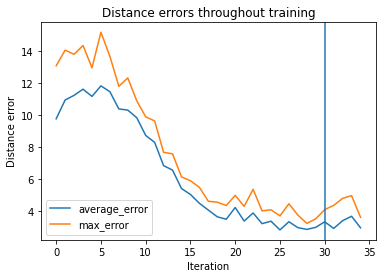

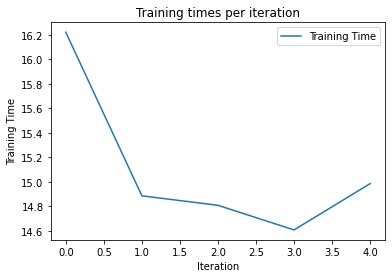

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:126: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


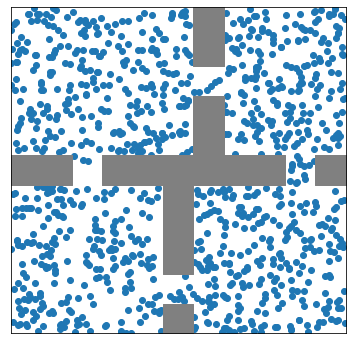

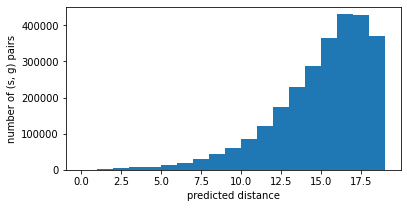

Searching with max steps of  7
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


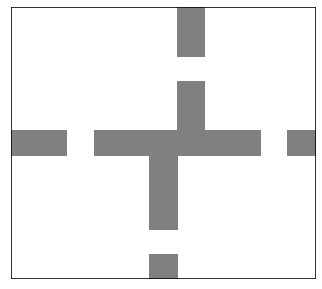

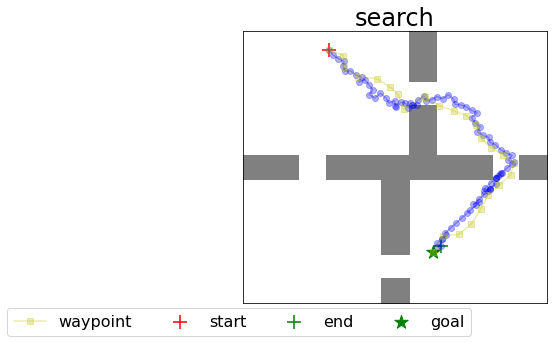

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


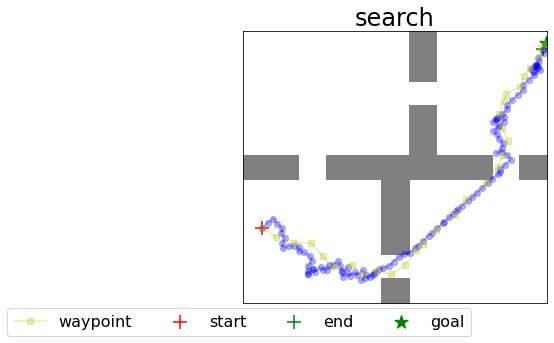

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


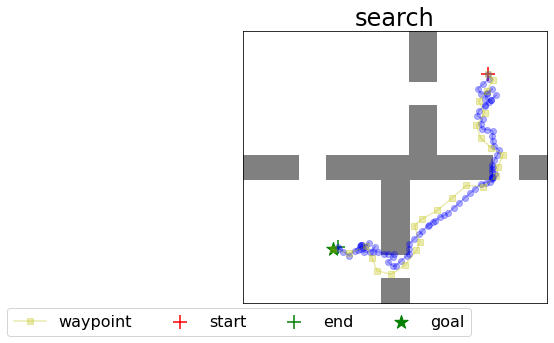

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


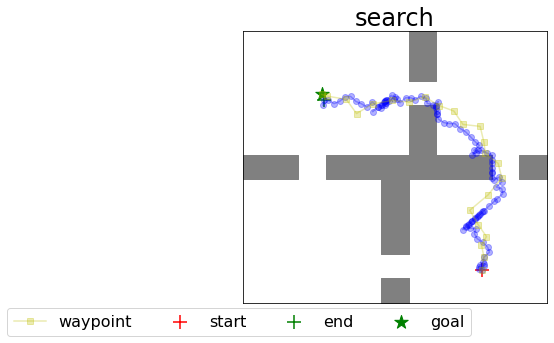

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


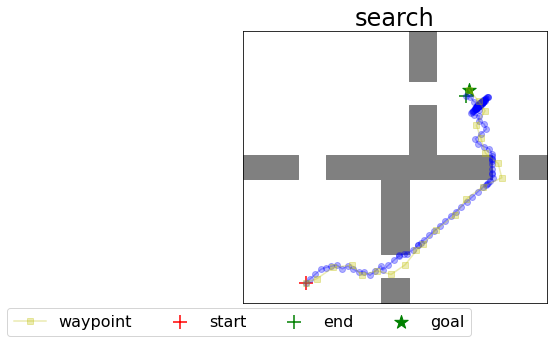

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


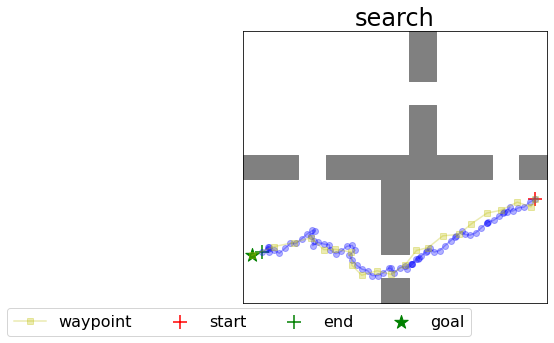

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


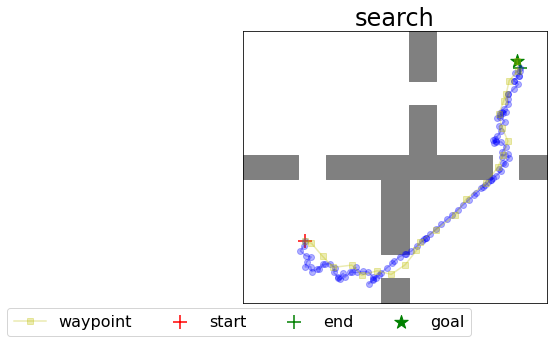

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


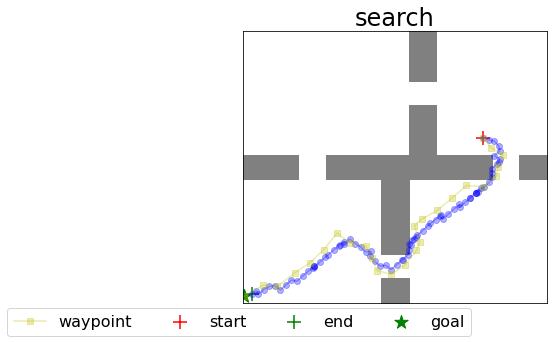

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


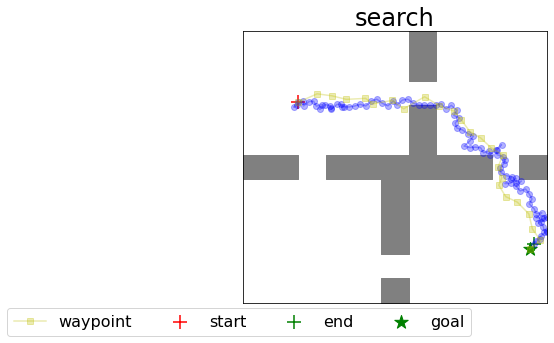

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


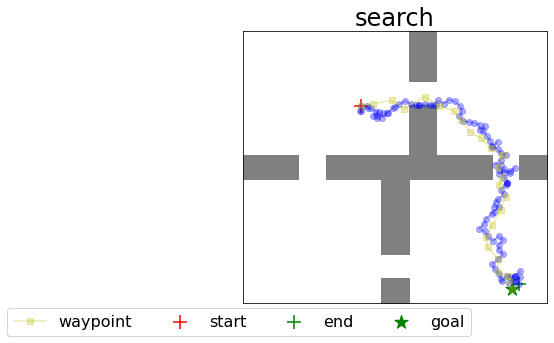

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


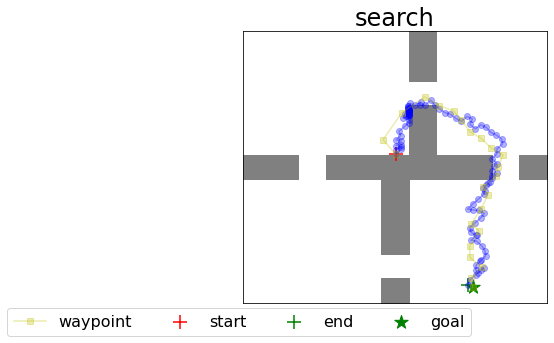

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


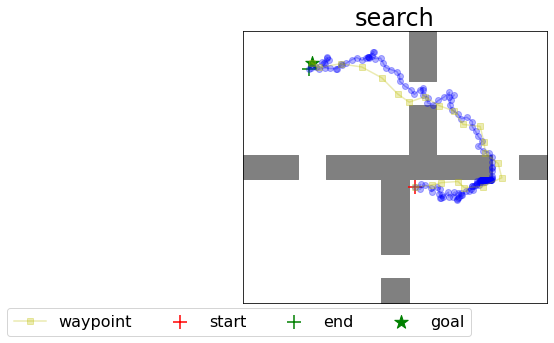

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


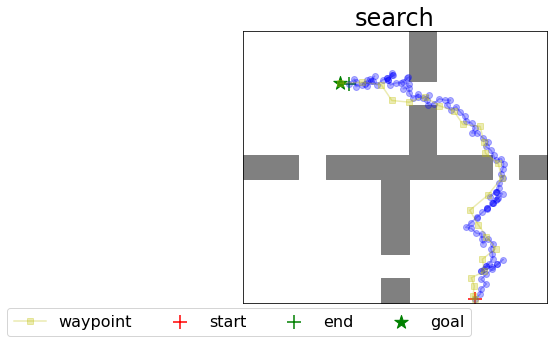

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


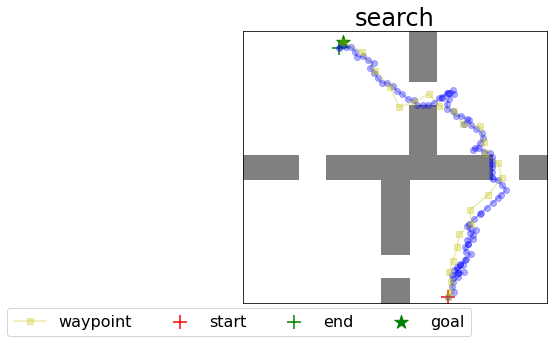

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


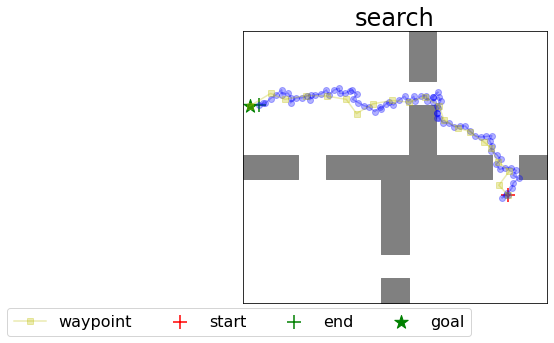

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


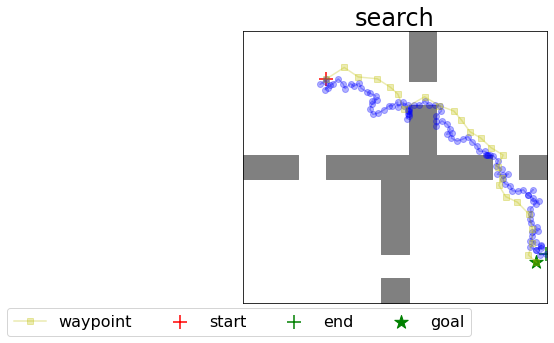

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


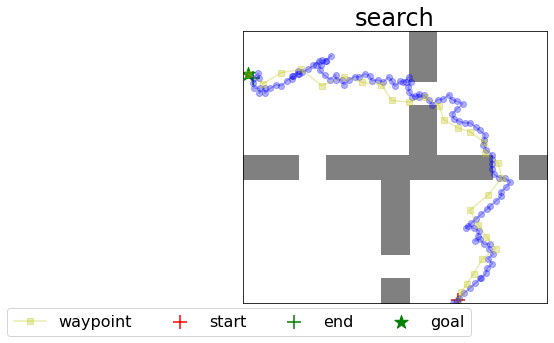

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


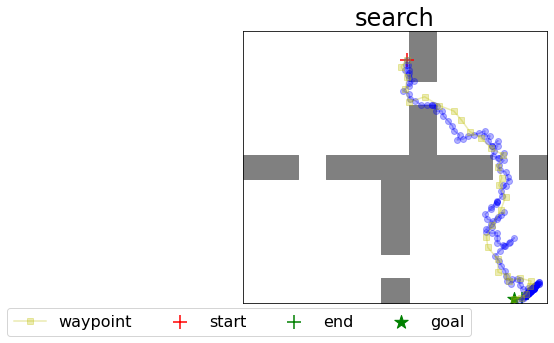

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


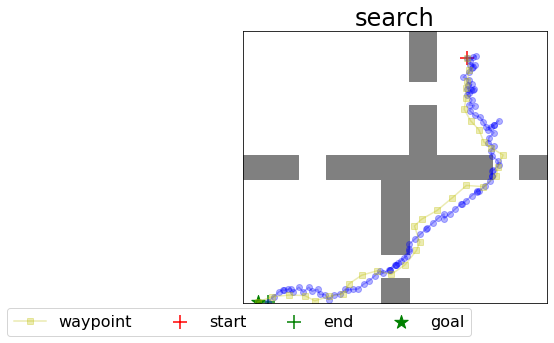

Path success rate is  0.95
Rollout success rate (given path) is  1.0
Average search time (for success) is  14.468943809208117
Search iterations is  111.89473684210526
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


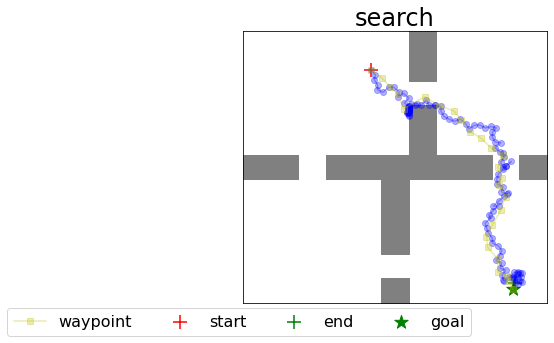

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


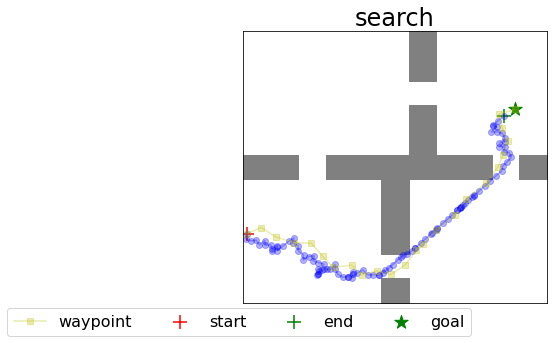

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


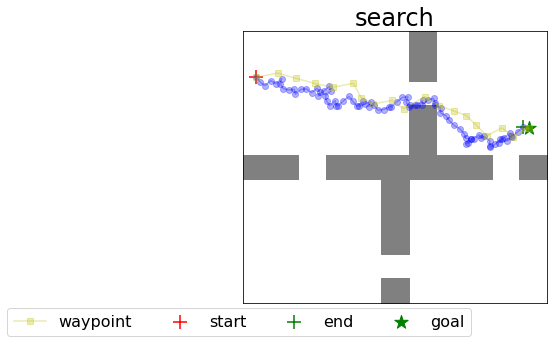

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


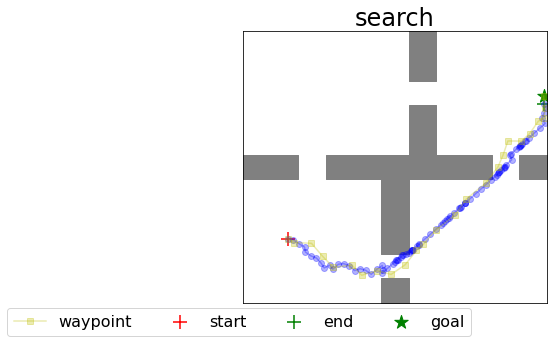

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


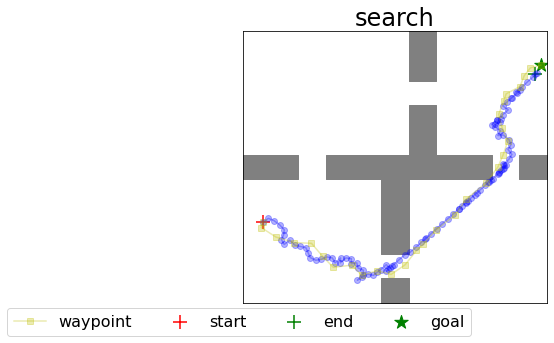

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


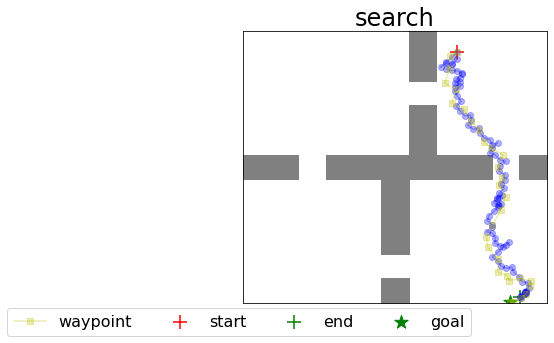

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


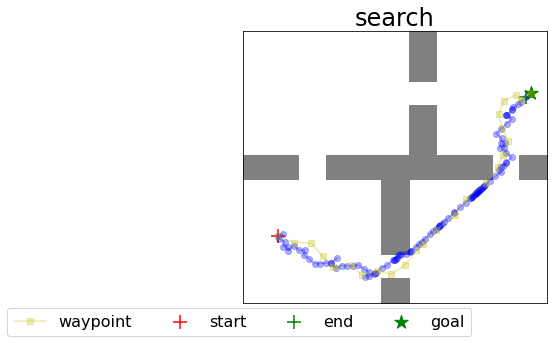

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


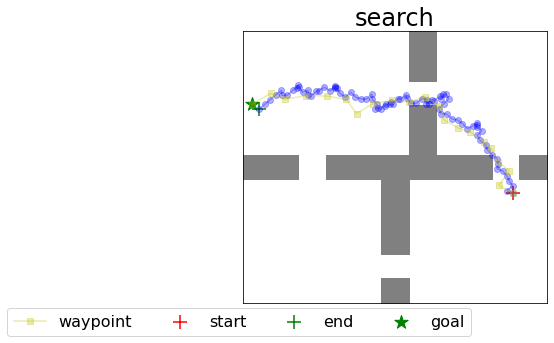

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


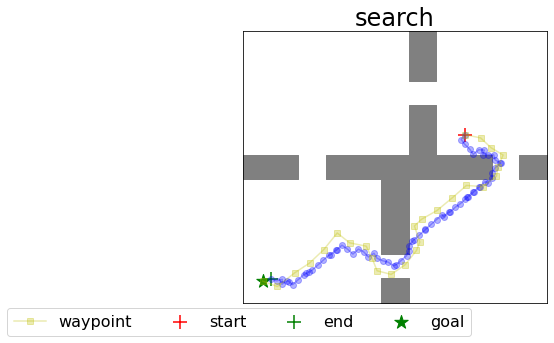

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


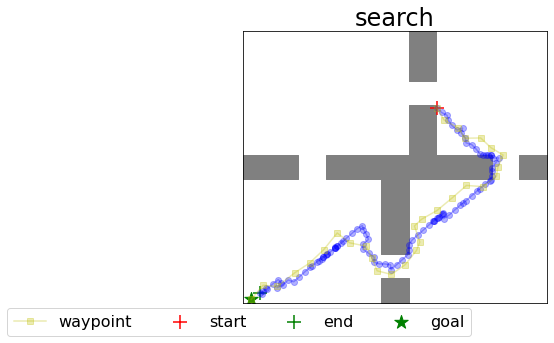

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


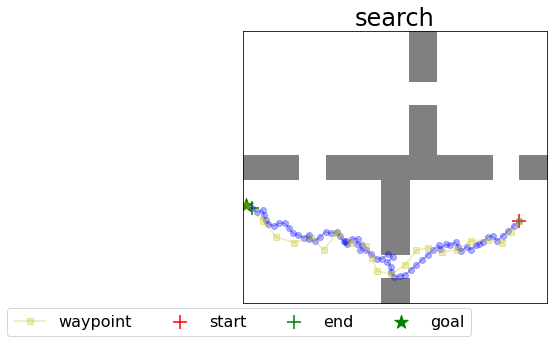

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


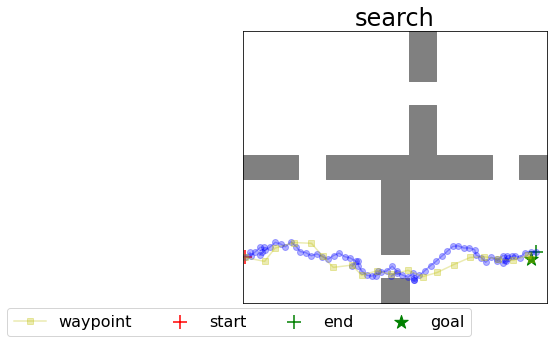

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


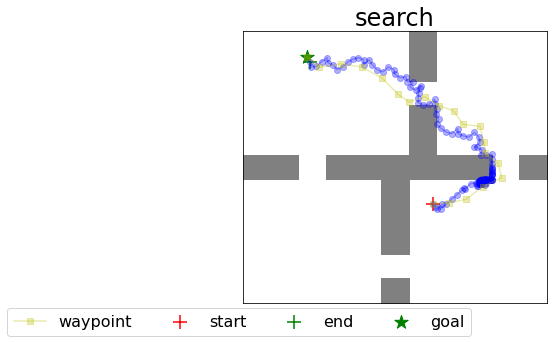

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


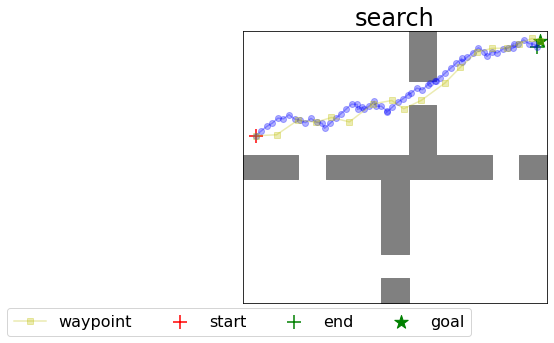

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


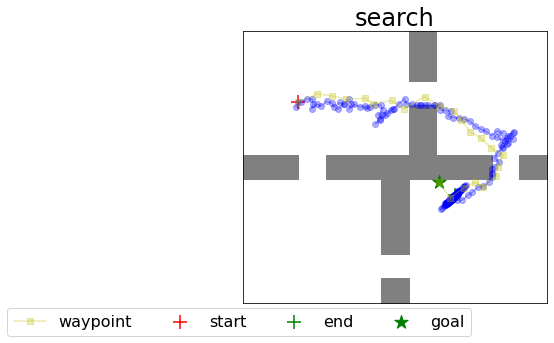

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


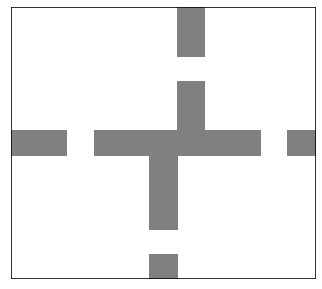

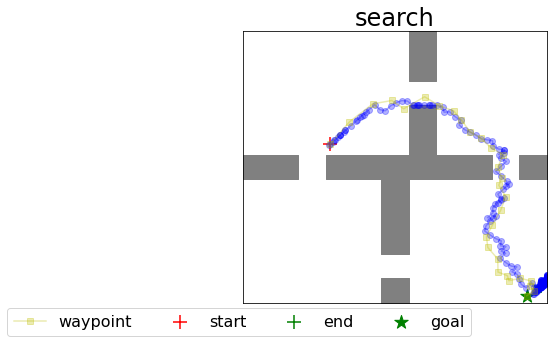

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


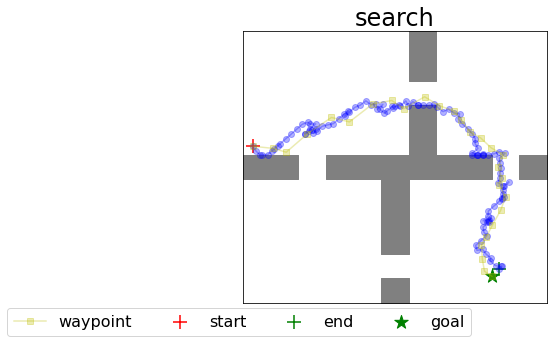

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


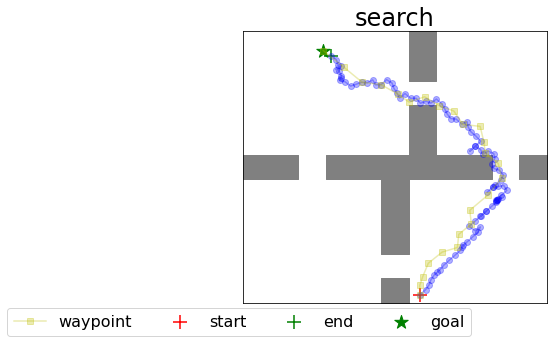

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


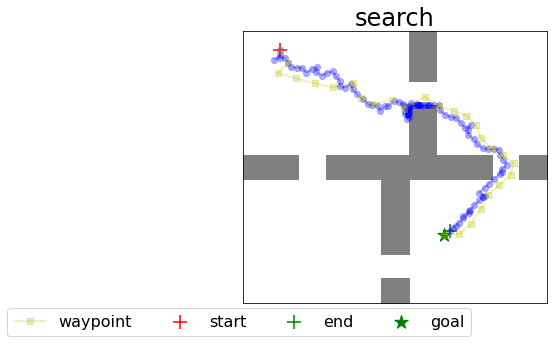

Path success rate is  0.95
Rollout success rate (given path) is  0.8947368421052632
Average search time (for success) is  14.90472334309628
Search iterations is  120.78947368421052
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


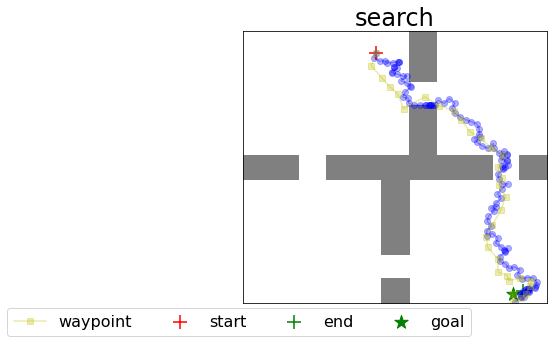

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


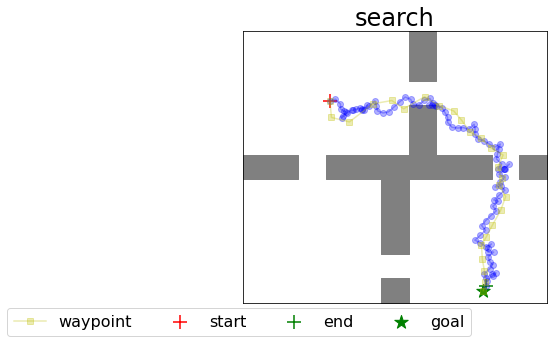

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


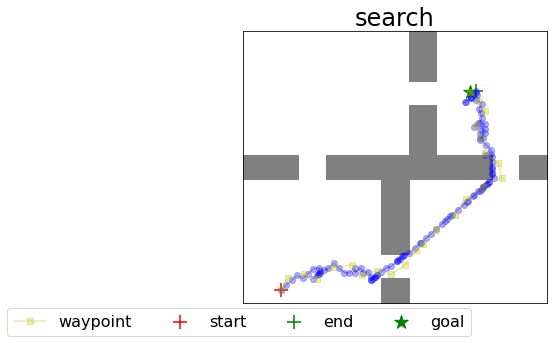

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


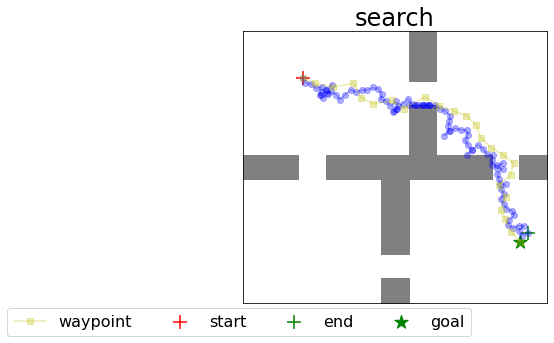

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


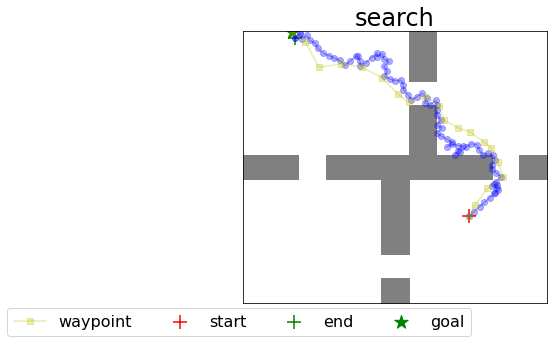

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


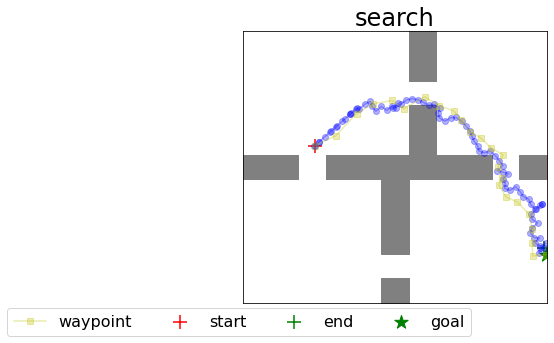

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


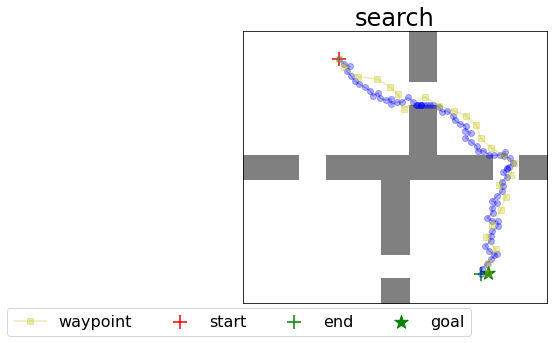

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


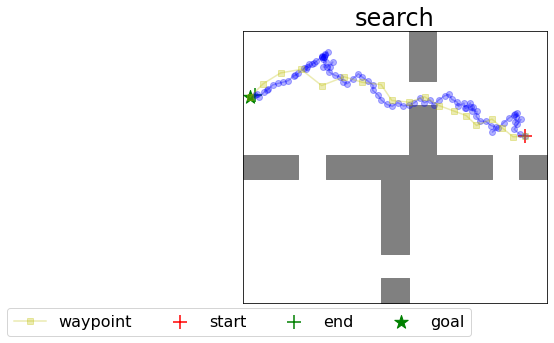

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


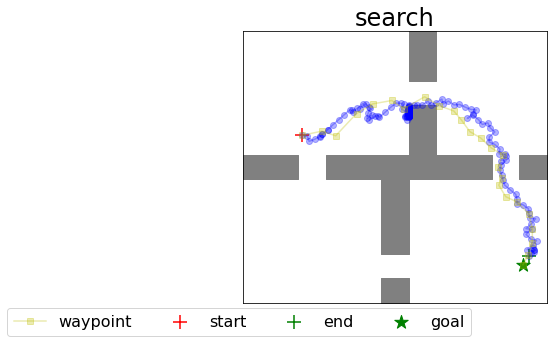

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


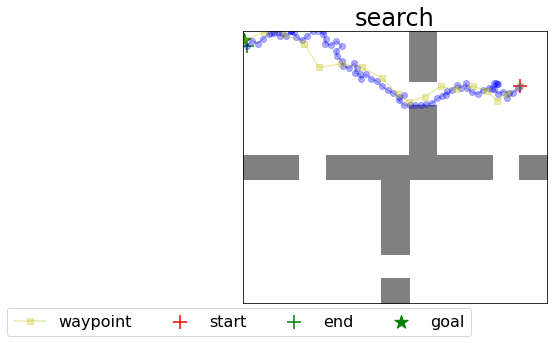

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


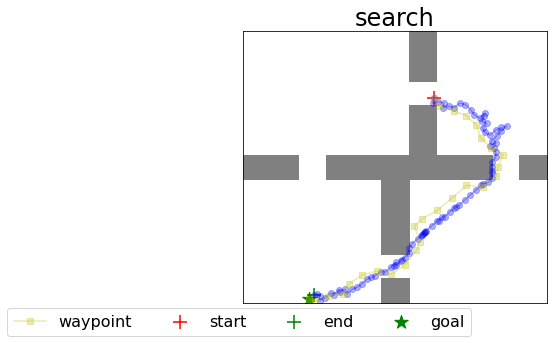

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


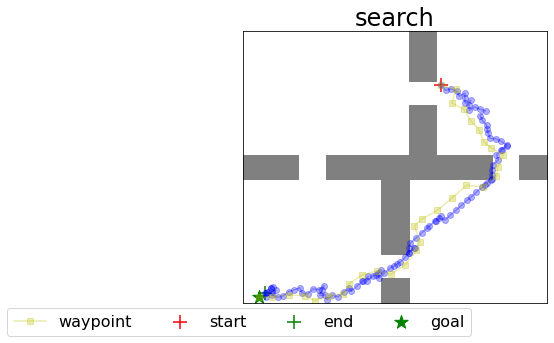

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


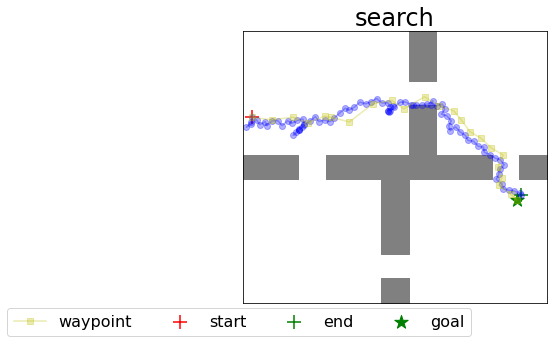

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


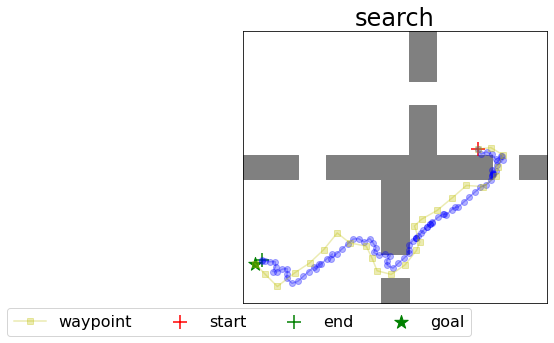

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


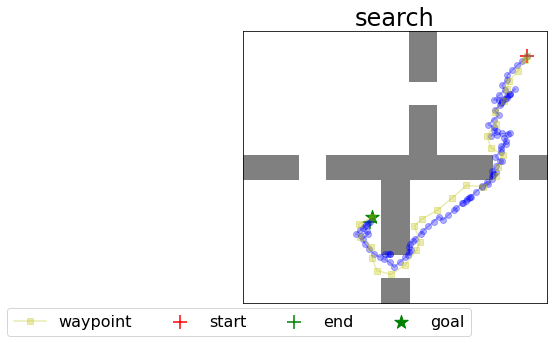

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


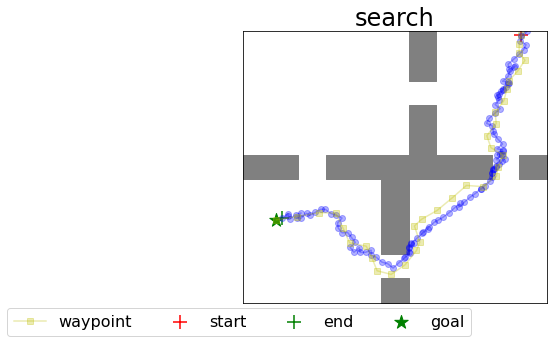

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


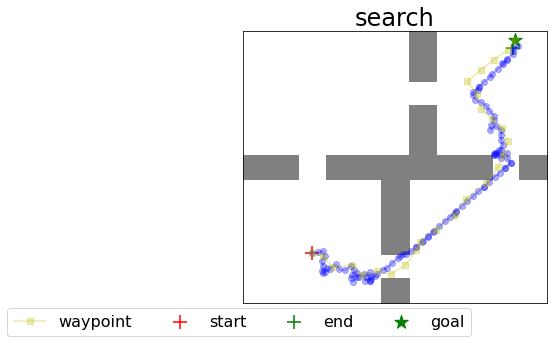

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


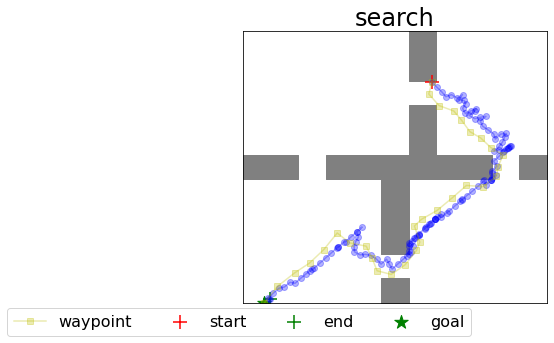

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


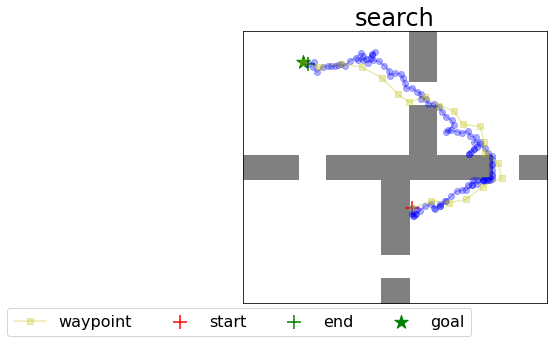

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


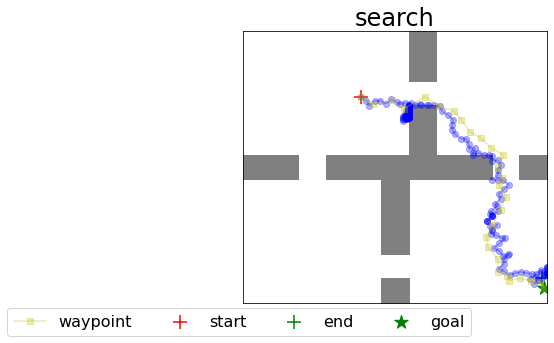

Path success rate is  1.0
Rollout success rate (given path) is  1.0
Average search time (for success) is  14.391874527931213
Search iterations is  111.95
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


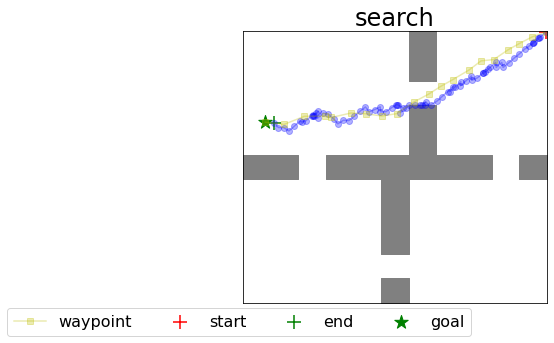

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


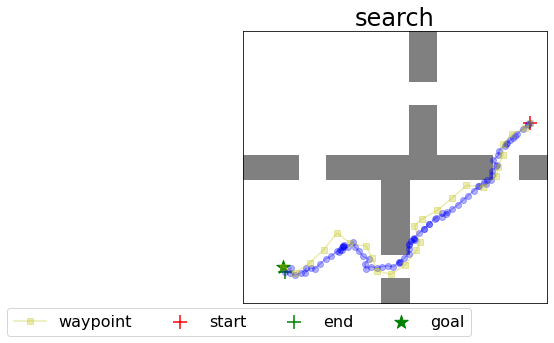

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


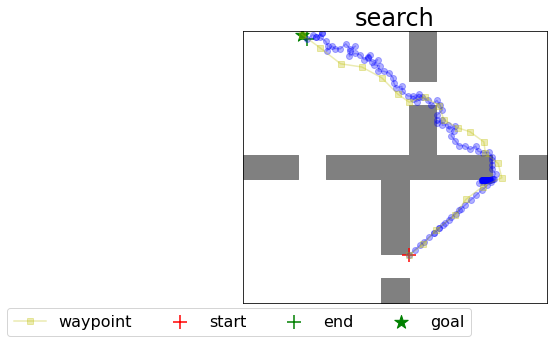

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


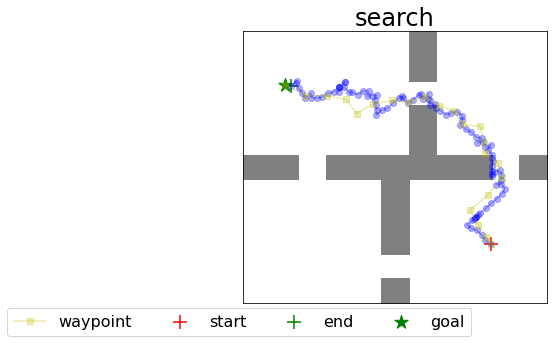

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


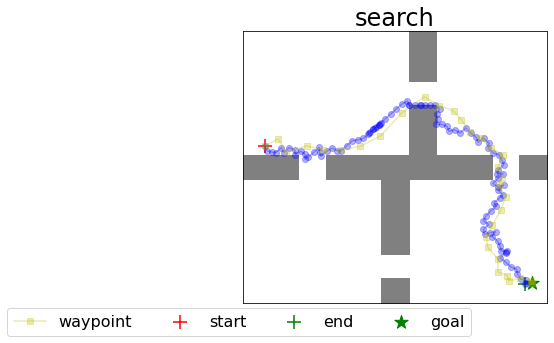

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


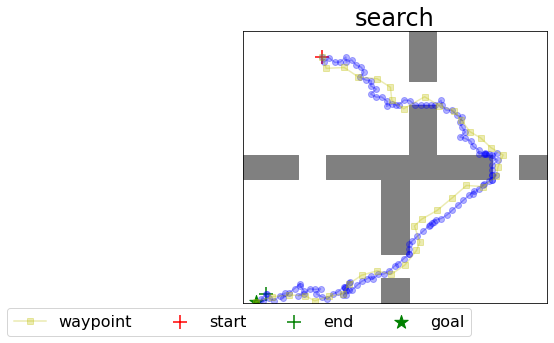

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


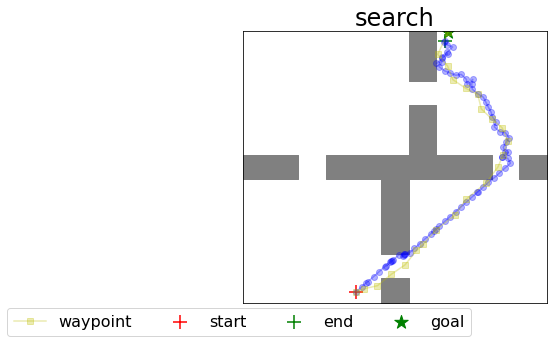

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


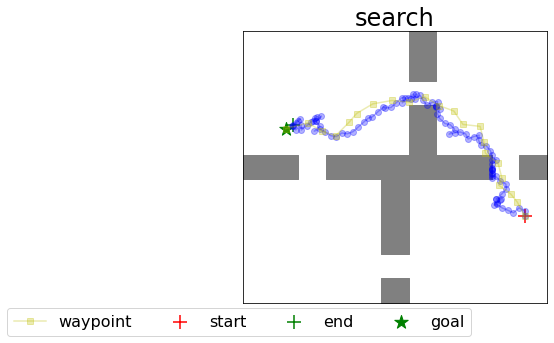

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


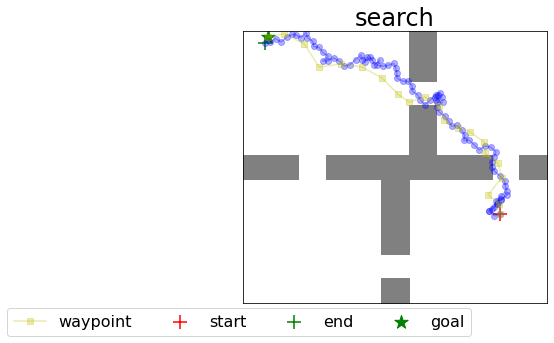

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


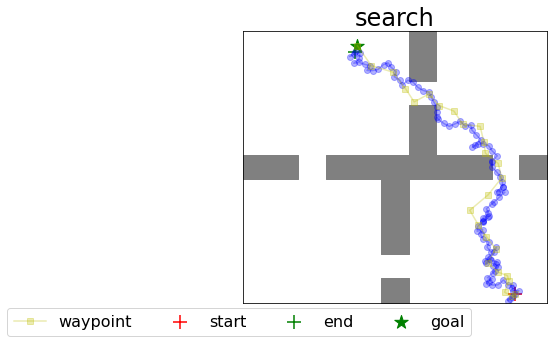

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


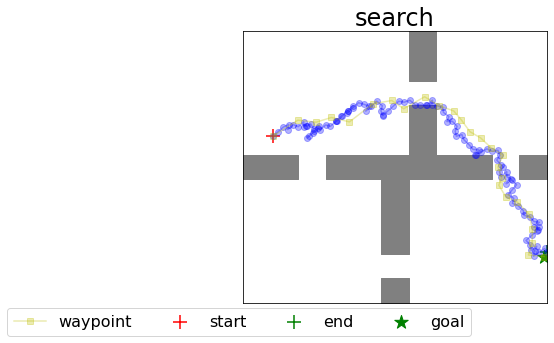

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


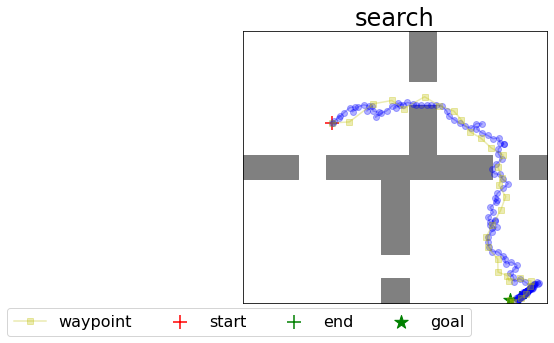

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


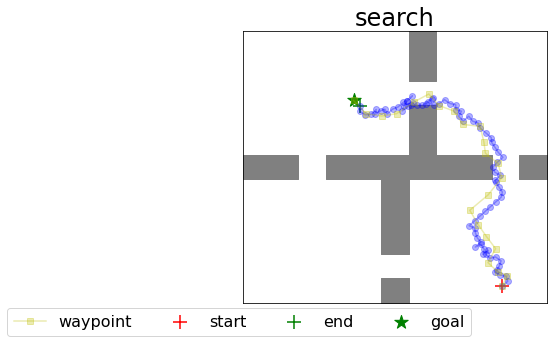

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


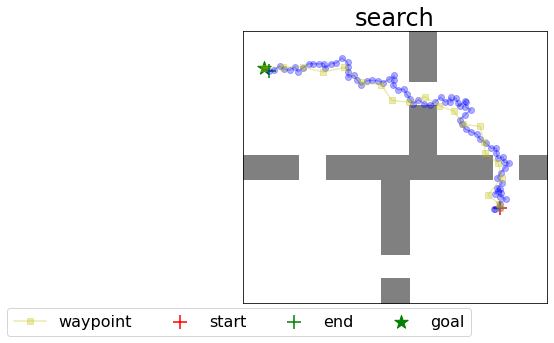

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


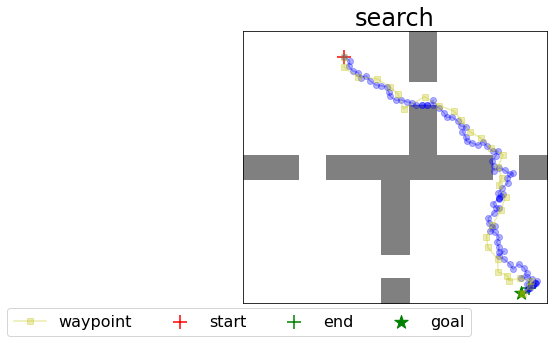

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


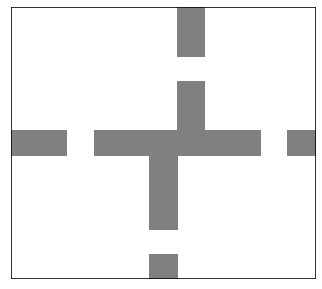

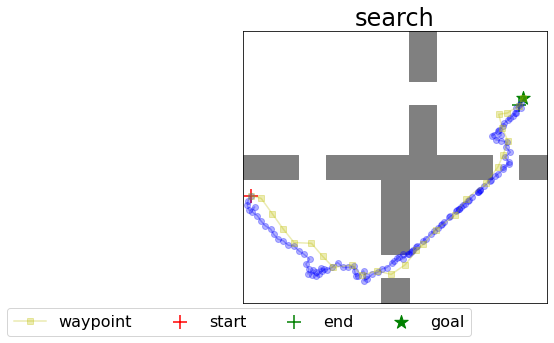

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


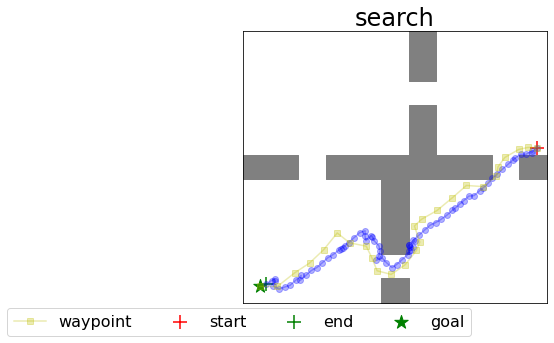

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


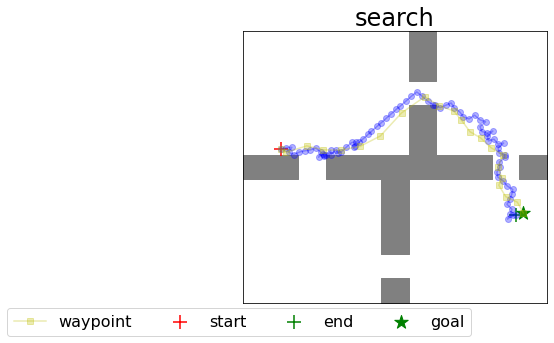

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


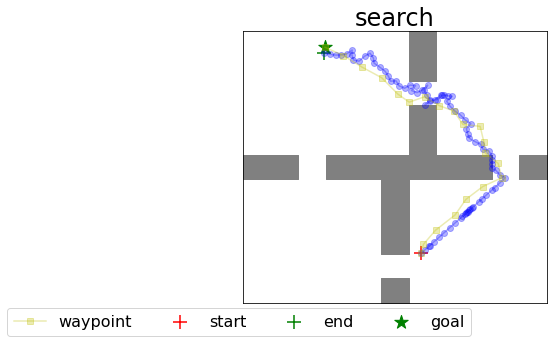

Path success rate is  0.95
Rollout success rate (given path) is  1.0
Average search time (for success) is  14.091938094088906
Search iterations is  101.21052631578948
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


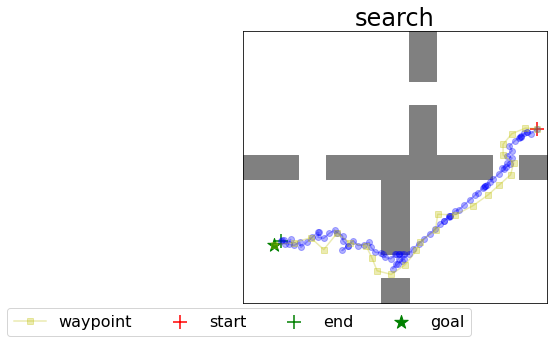

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


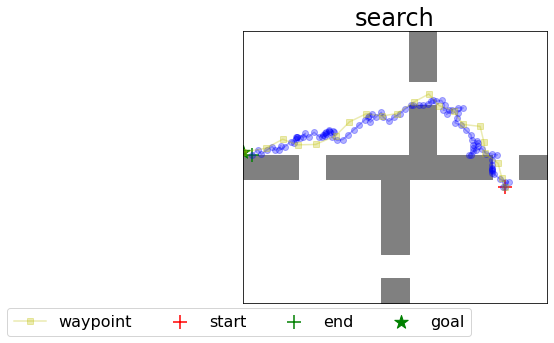

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


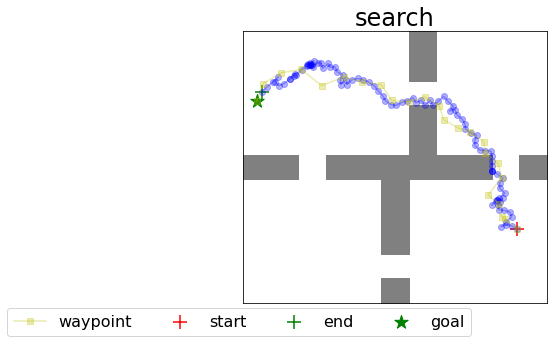

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


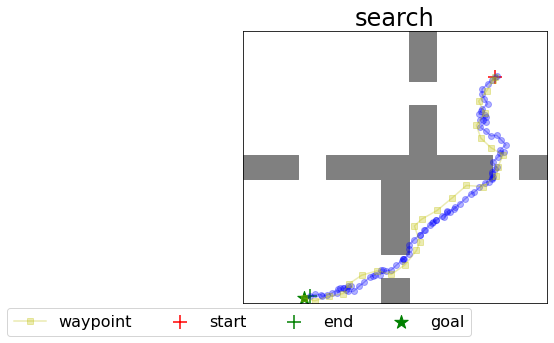

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


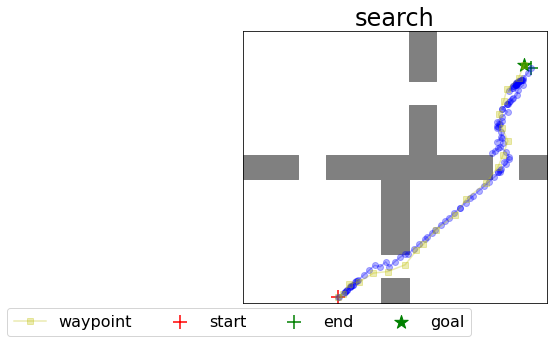

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


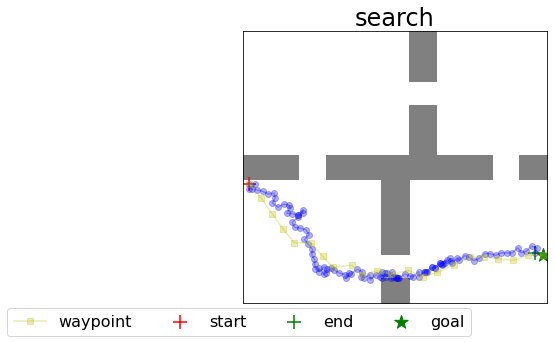

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


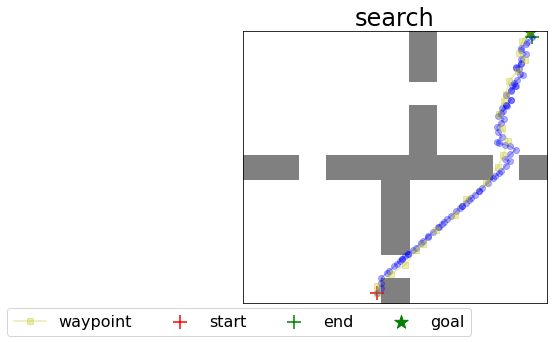

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


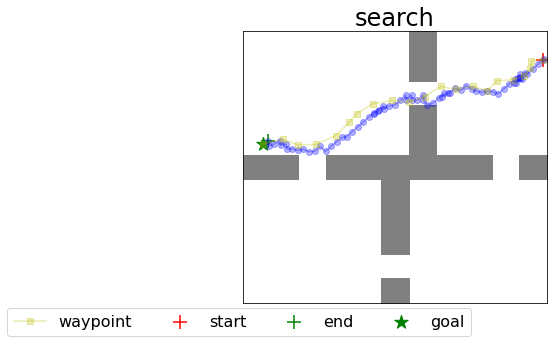

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


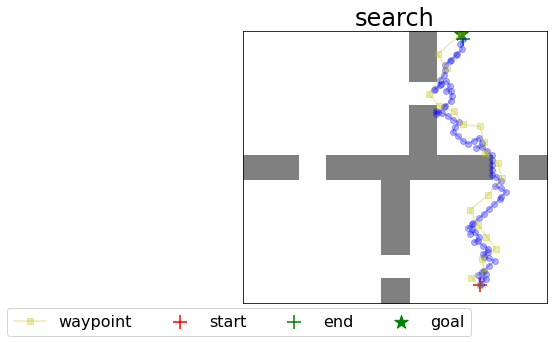

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


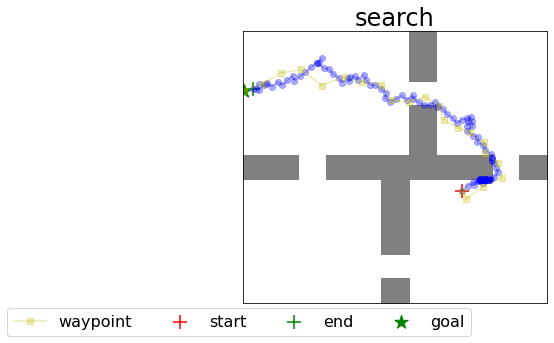

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


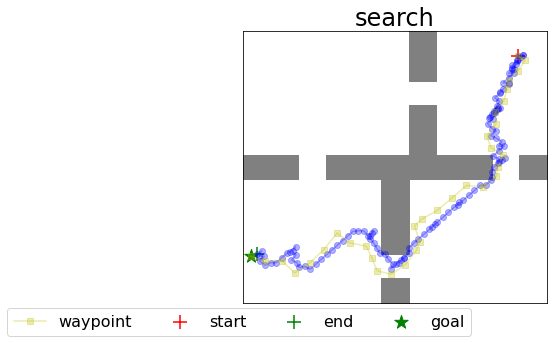

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


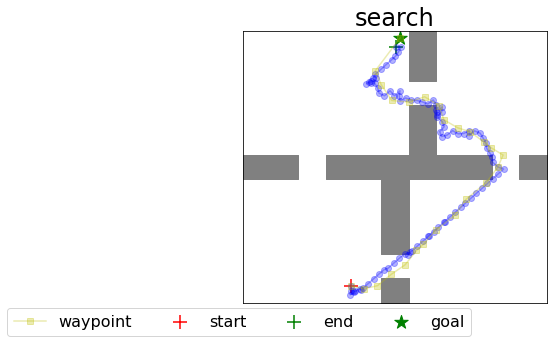

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


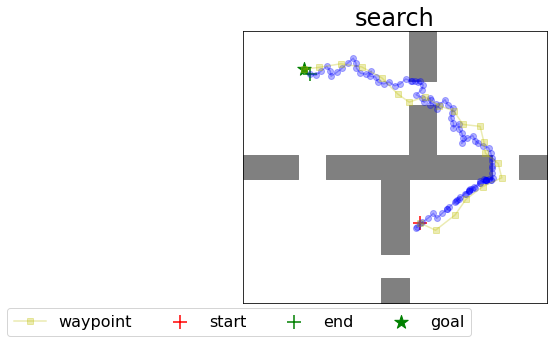

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


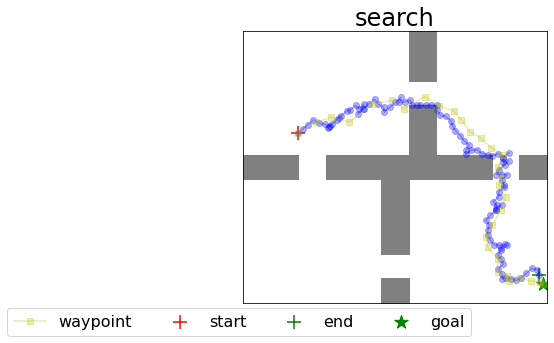

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


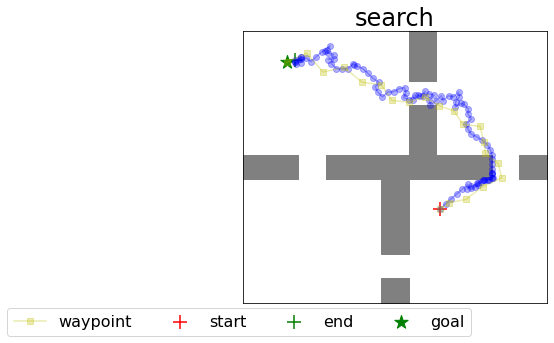

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


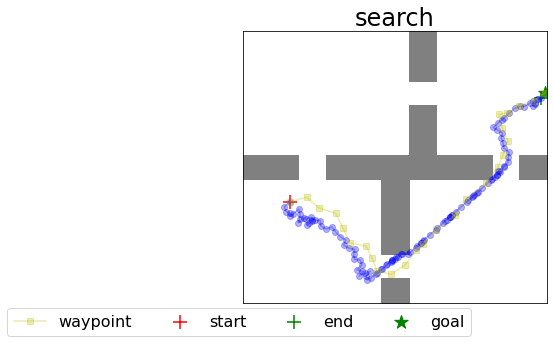

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


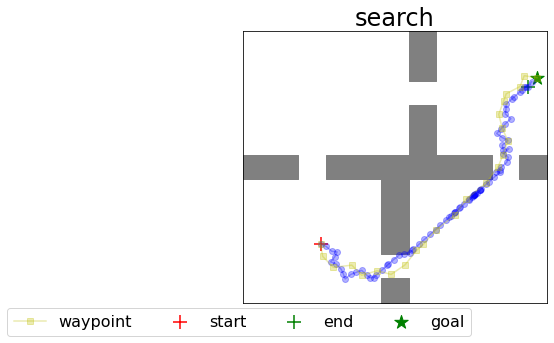

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


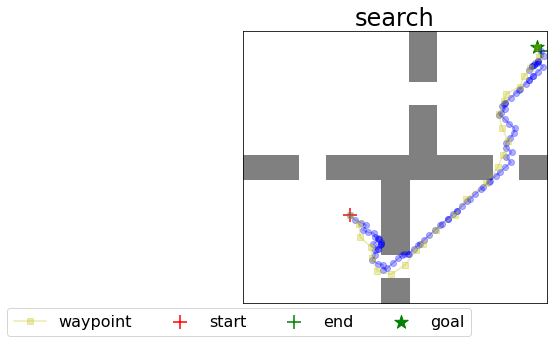

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


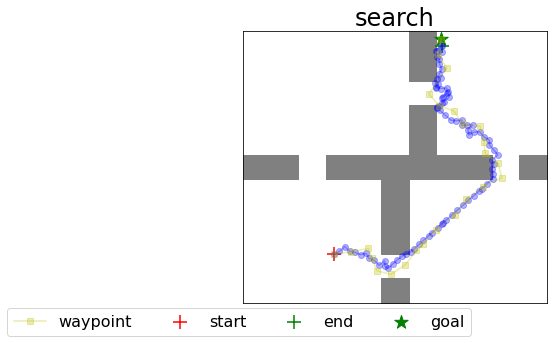

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


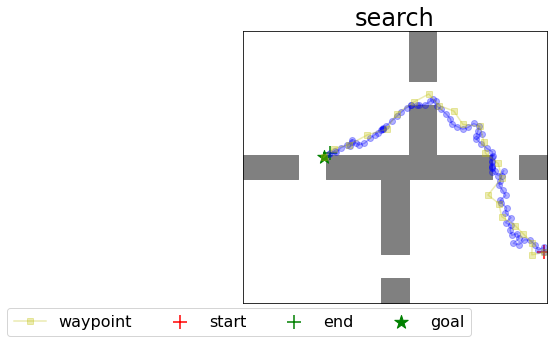

Path success rate is  1.0
Rollout success rate (given path) is  1.0
Average search time (for success) is  14.08872184753418
Search iterations is  98.1
Spiral11x11
Maze11x11


/usr/local/lib/python3.6/dist-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


random_seed = 0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:67: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


INFO:tensorflow:step = 1000, loss = 2.209862
INFO:tensorflow:58.633 steps/sec
INFO:tensorflow:step = 1000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.20
INFO:tensorflow:		 predicted_dist = 15.1 (0.9)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -15.30
INFO:tensorflow:		 predicted_dist = 15.1 (0.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -20.00
INFO:tensorflow:		 predicted_dist = 16.1 (0.8)
INFO:tensorflow:	 eval_time = 1.75
INFO:tensorflow:step = 2000, loss = 1.428992
INFO:tensorflow:69.917 steps/sec
INFO:tensorflow:step = 2000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -18.20
INFO:tensorflow:		 predicted_dist = 16.0 (0.6)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -18.70
INFO:tensorflow:		 predicted_dist = 16.3 (0.7)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -19.50
INFO:tensorflow:		 predicted_dist = 17.4 (0.4)
INFO:tensorflow:	 eval_time = 1.70
INFO:tensorflow:step

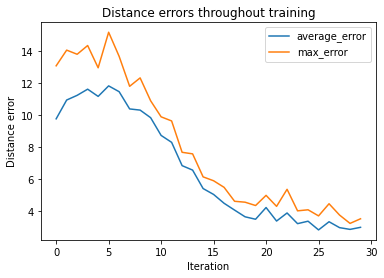

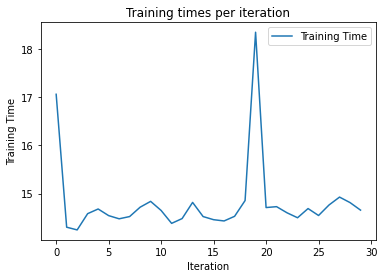

random_seed = 0


INFO:tensorflow:step = 31000, loss = 3.301113
INFO:tensorflow:60.809 steps/sec
INFO:tensorflow:step = 31000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -3.60
INFO:tensorflow:		 predicted_dist = 5.8 (1.6)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -6.90
INFO:tensorflow:		 predicted_dist = 8.8 (1.5)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -16.50
INFO:tensorflow:		 predicted_dist = 11.9 (1.4)
INFO:tensorflow:	 eval_time = 1.44
INFO:tensorflow:step = 32000, loss = 3.135413
INFO:tensorflow:68.217 steps/sec
INFO:tensorflow:step = 32000
INFO:tensorflow:	 dist = 2
INFO:tensorflow:		 AverageReturn = -3.00
INFO:tensorflow:		 predicted_dist = 4.8 (1.7)
INFO:tensorflow:	 dist = 5
INFO:tensorflow:		 AverageReturn = -7.40
INFO:tensorflow:		 predicted_dist = 8.2 (0.9)
INFO:tensorflow:	 dist = 10
INFO:tensorflow:		 AverageReturn = -15.90
INFO:tensorflow:		 predicted_dist = 10.3 (0.8)
INFO:tensorflow:	 eval_time = 1.31
INFO:tensorflow:step = 3

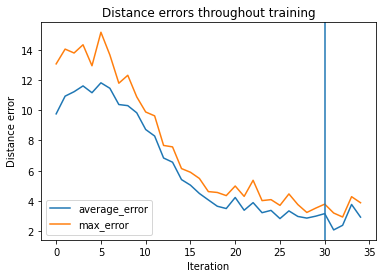

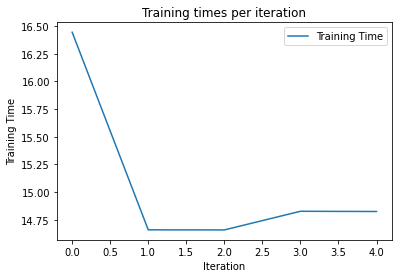

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:126: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


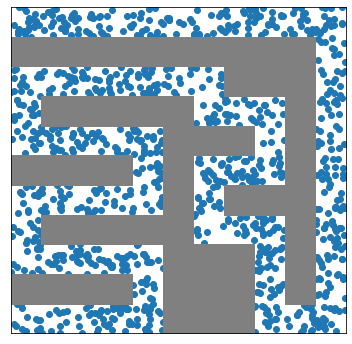

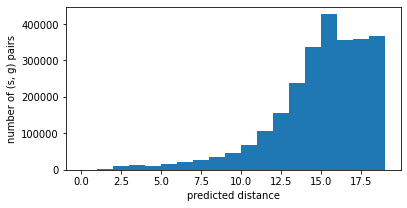

Searching with max steps of  7
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


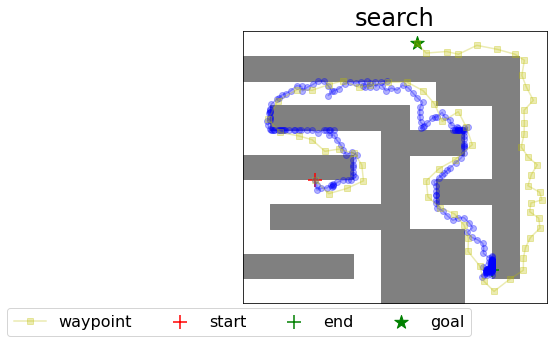

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


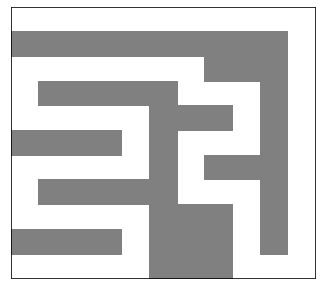

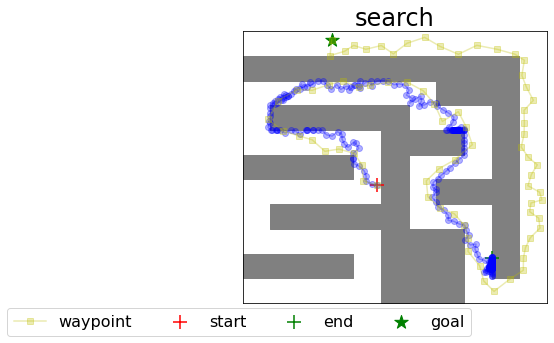

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


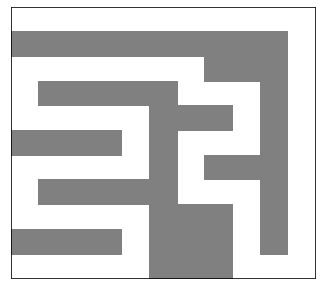

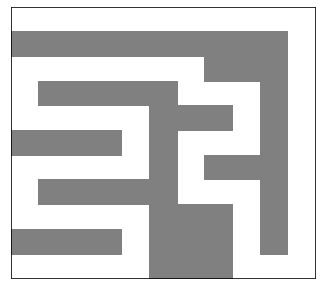

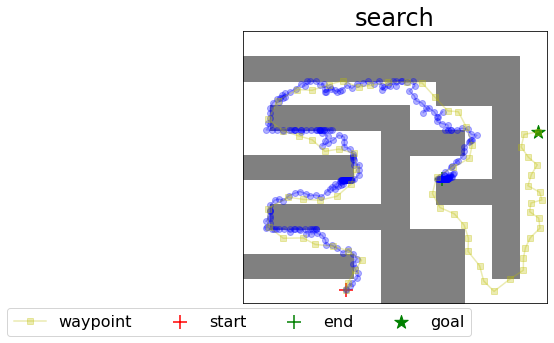

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


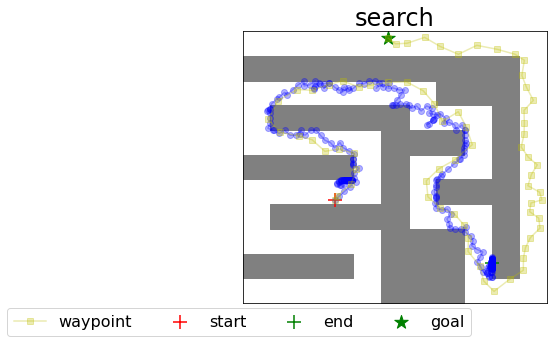

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


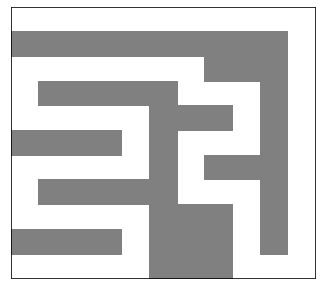

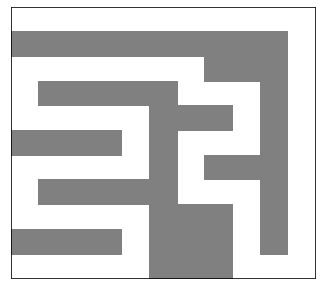

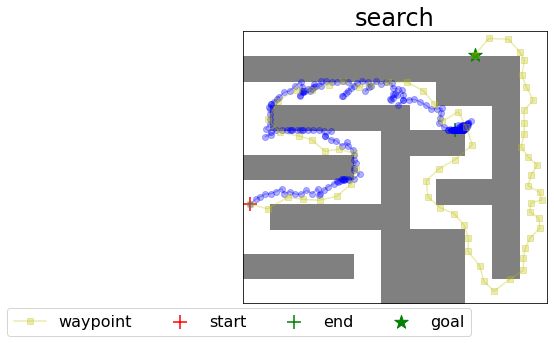

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


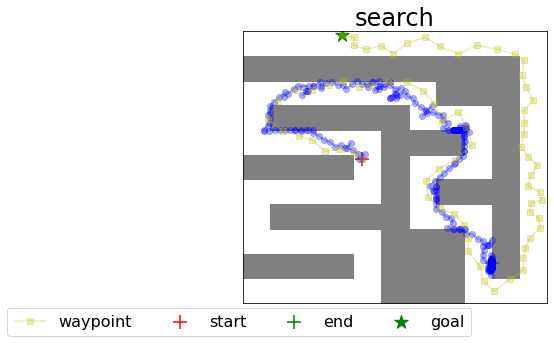

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


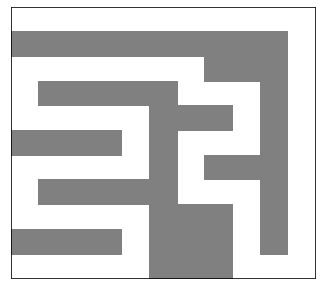

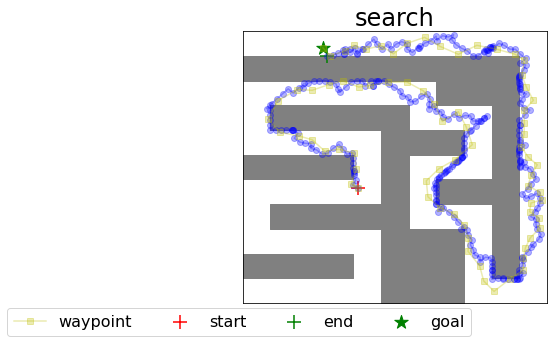

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


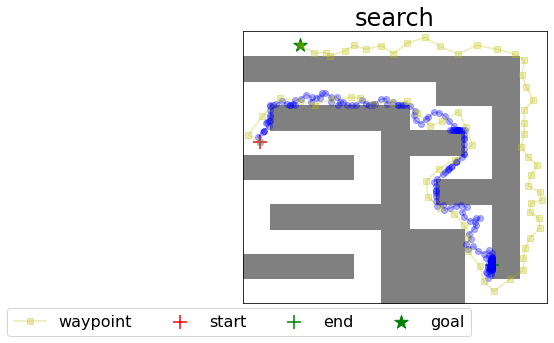

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


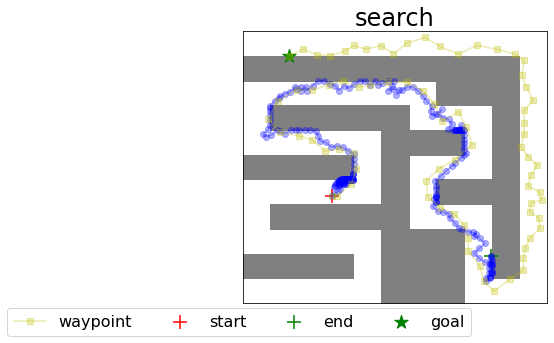

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


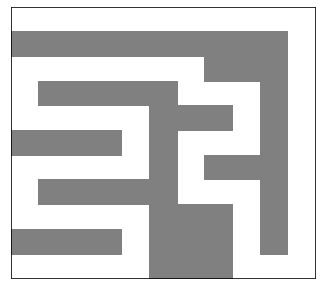

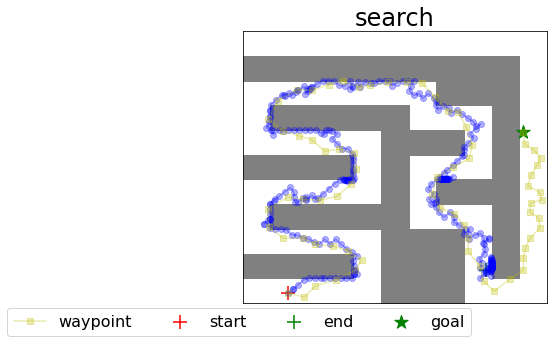

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


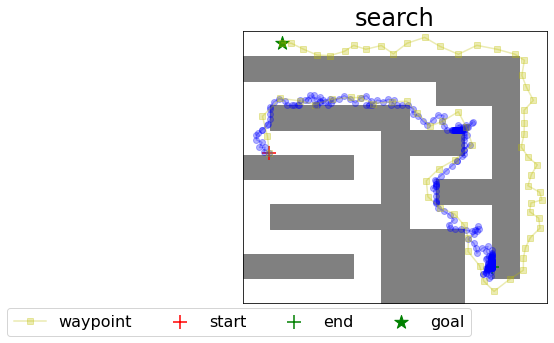

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


Path success rate is  0.55
Rollout success rate (given path) is  0.09090909090909091
Average search time (for success) is  22.07988645813682
Search iterations is  299.45454545454544
Difficulty =  0.7


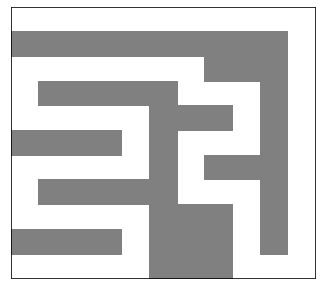

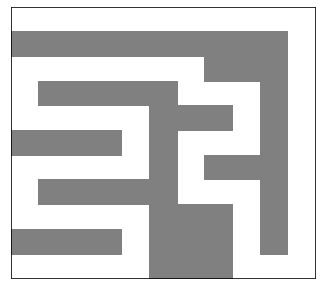

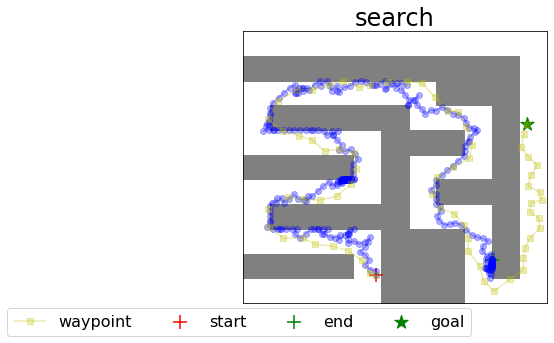

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


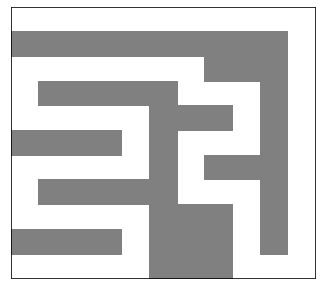

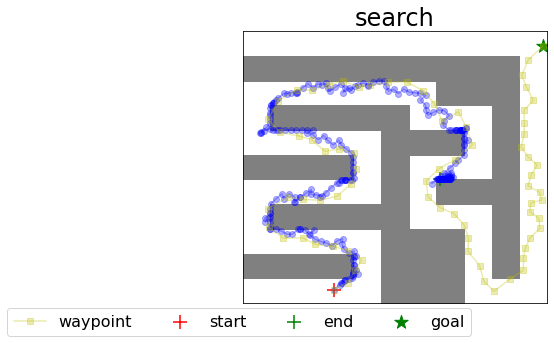

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


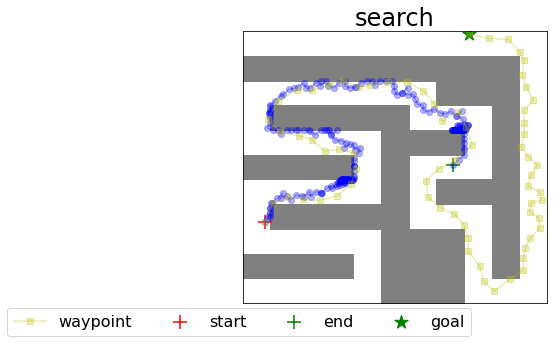

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


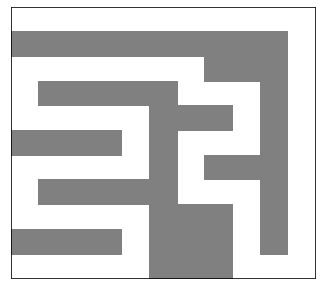

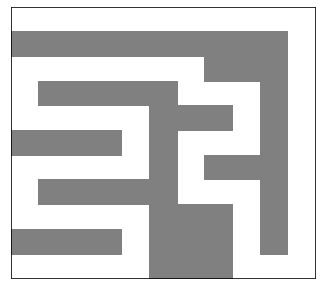

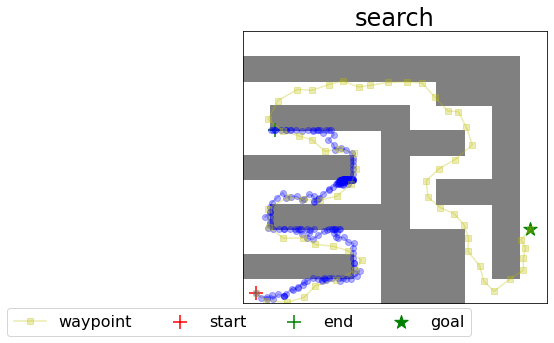

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


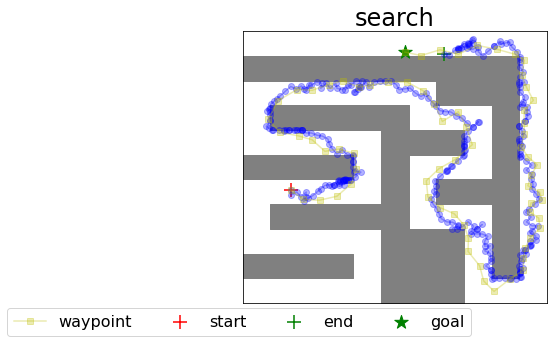

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


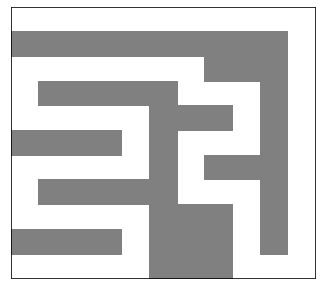

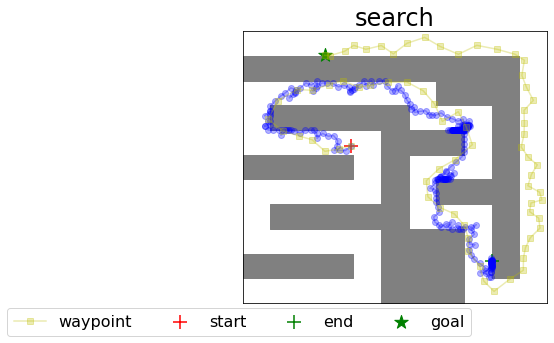

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


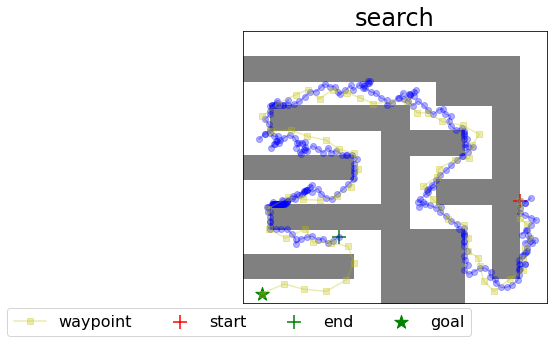

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


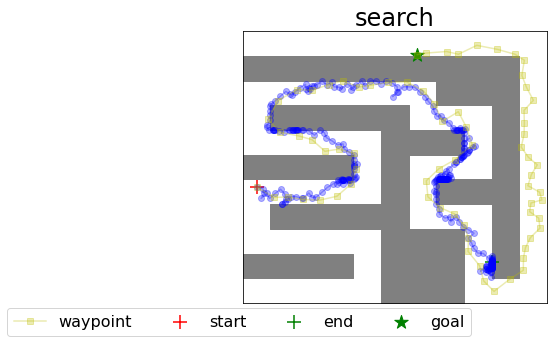

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


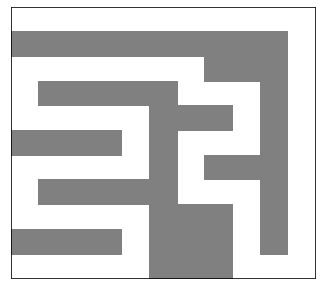

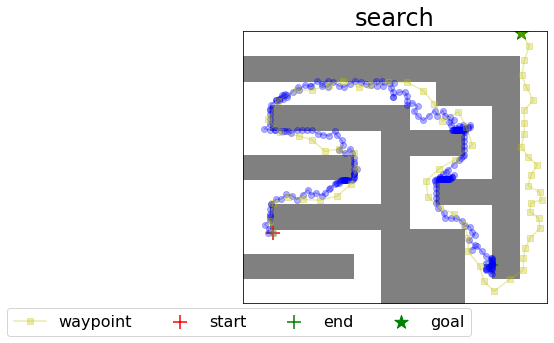

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


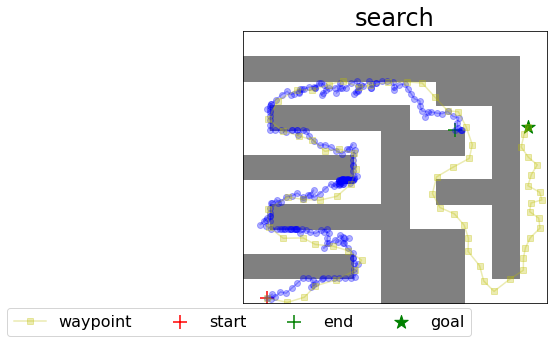

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


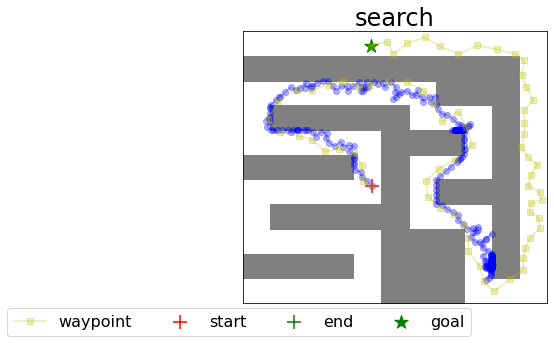

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


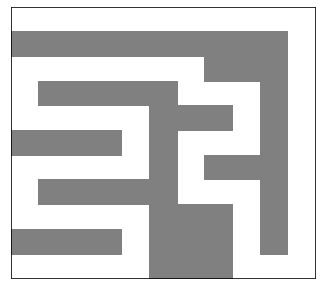

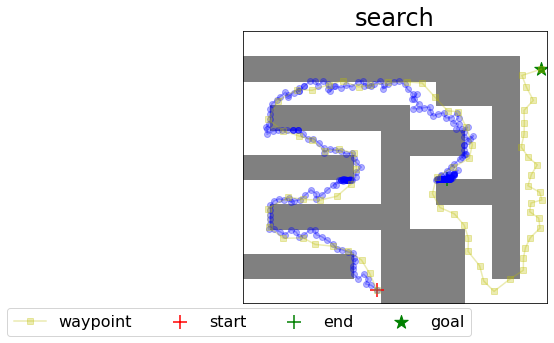

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


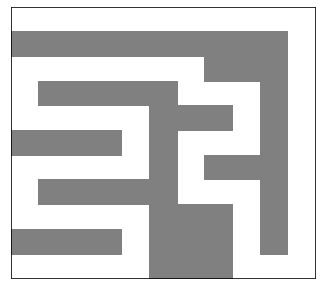

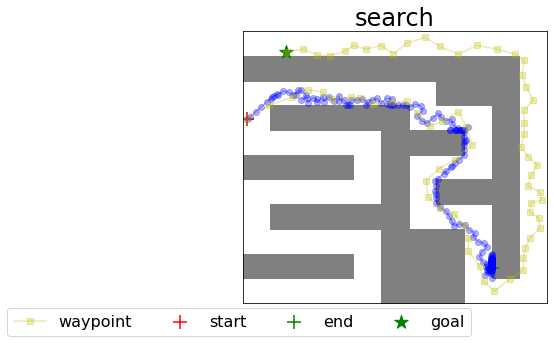

Path success rate is  0.65
Rollout success rate (given path) is  0.0
Average search time (for success) is  21.857944396825935
Search iterations is  300.0
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


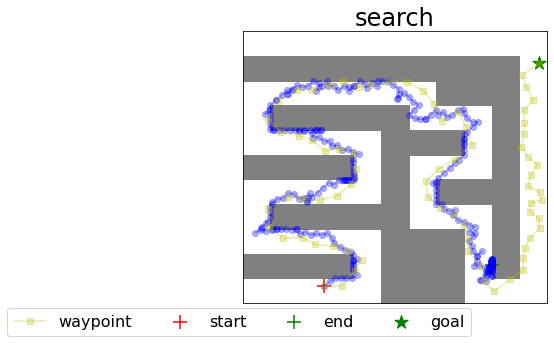

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


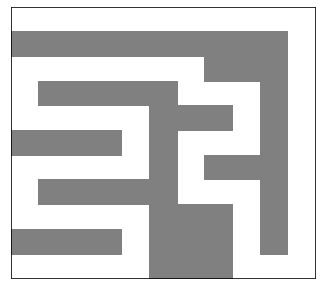

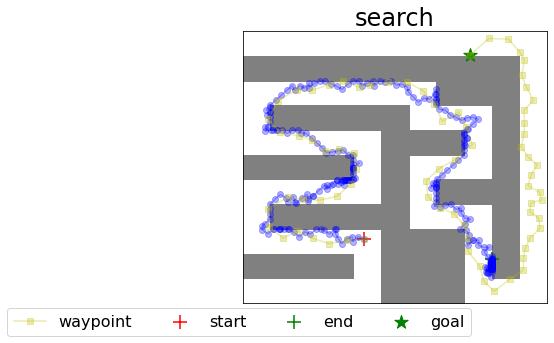

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


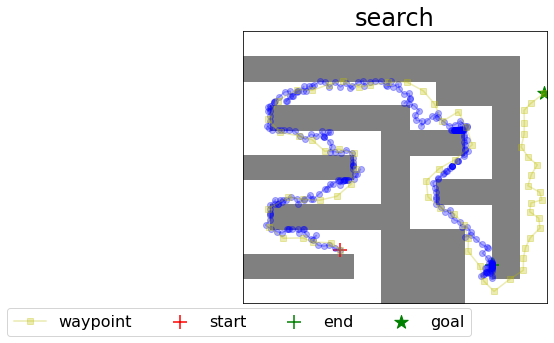

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


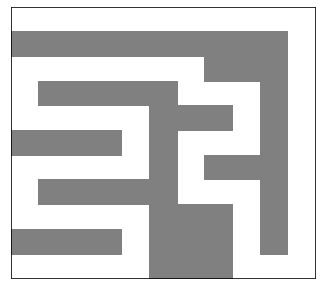

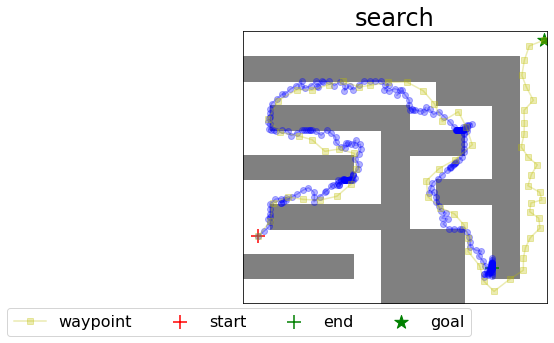

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


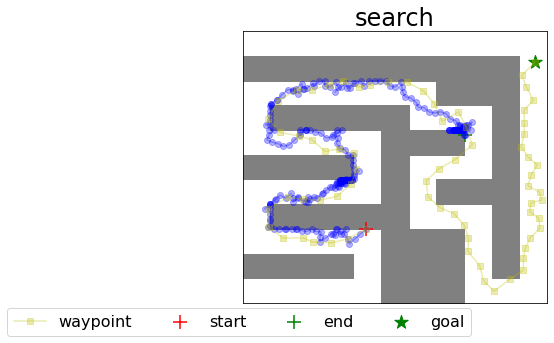

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


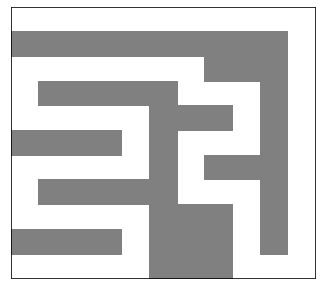

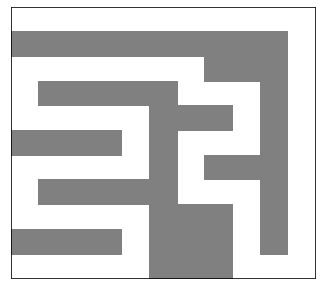

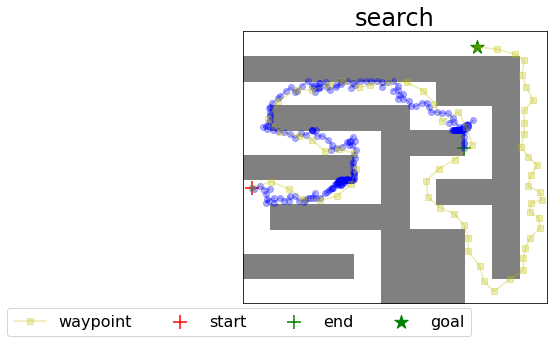

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


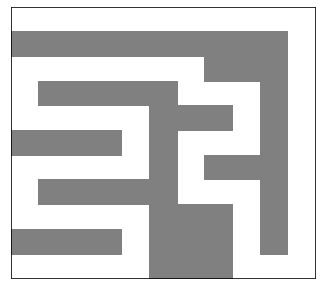

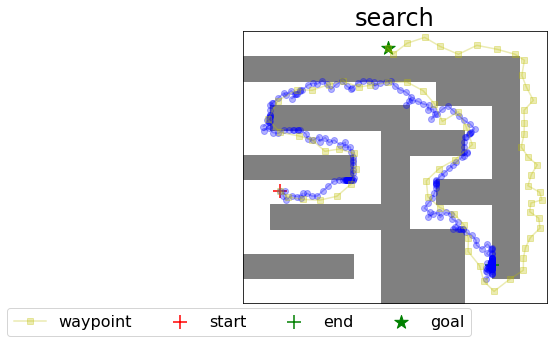

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


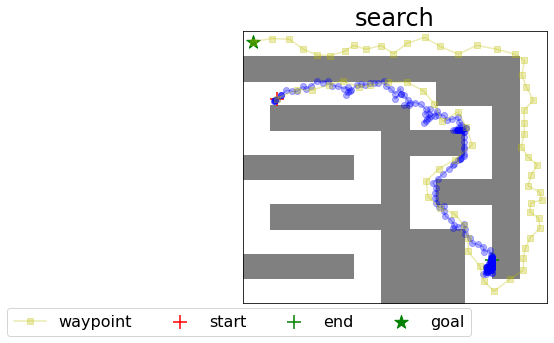

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


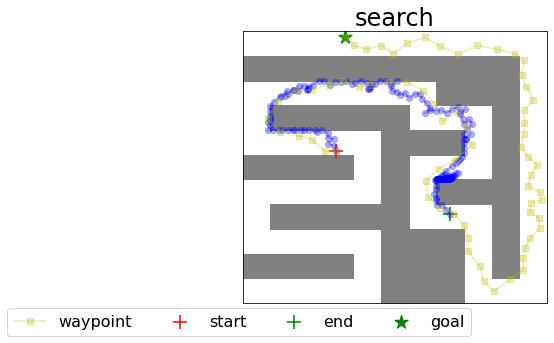

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


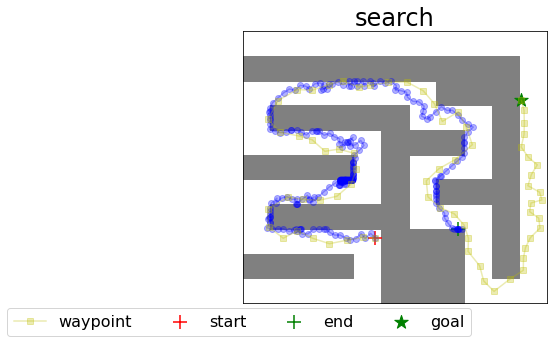

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


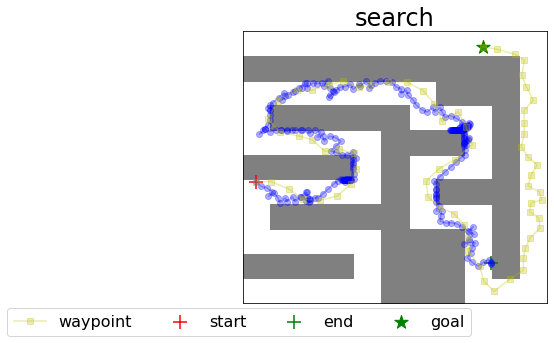

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


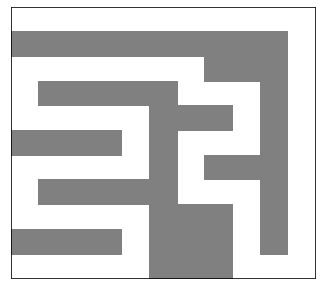

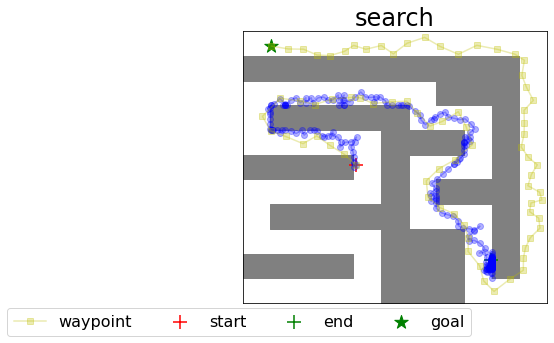

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


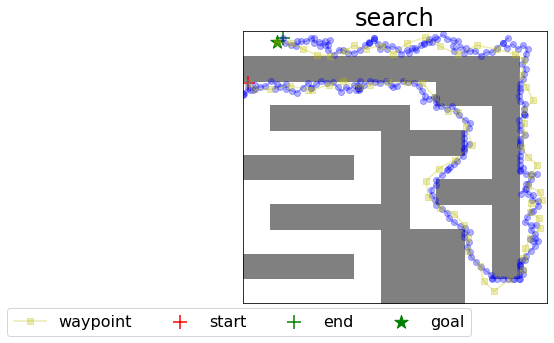

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


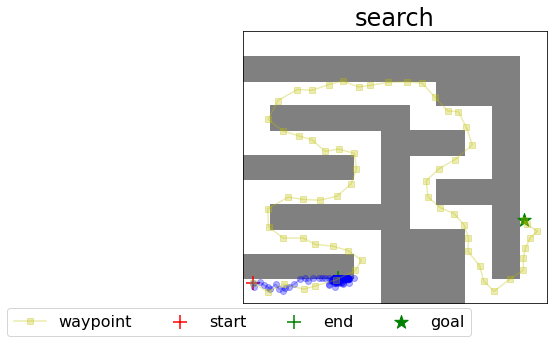

Path success rate is  0.7
Rollout success rate (given path) is  0.07142857142857142
Average search time (for success) is  21.639589190483093
Search iterations is  297.0
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


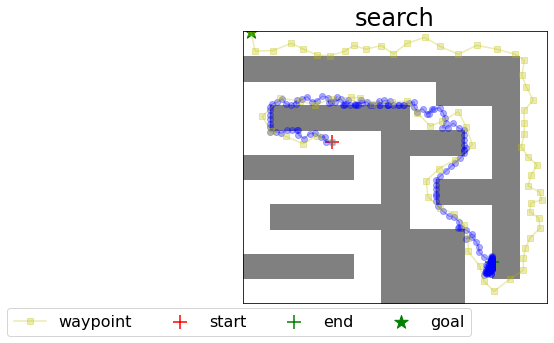

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


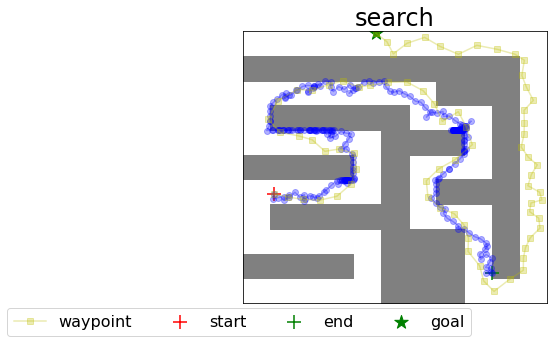

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


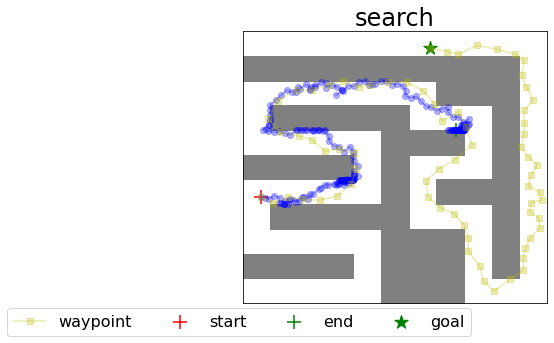

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


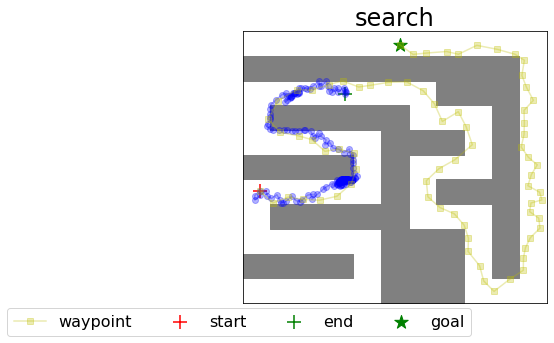

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


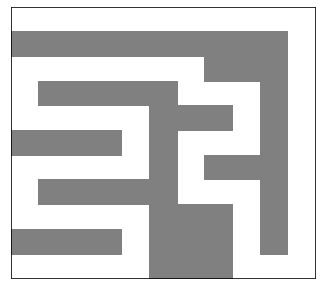

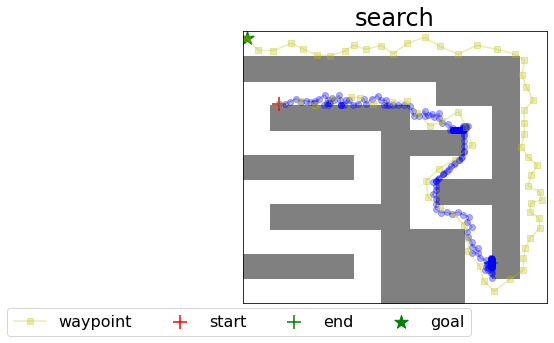

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


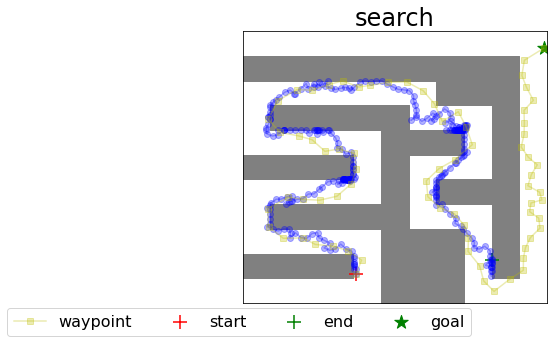

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


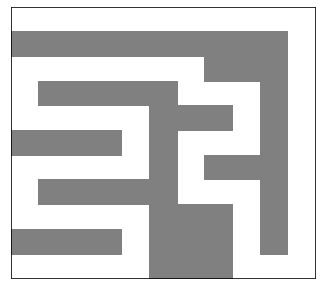

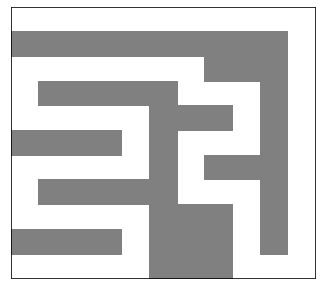

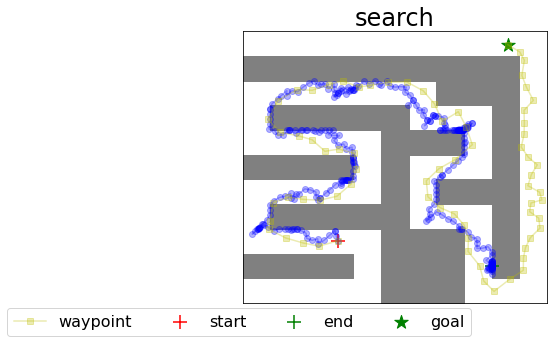

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


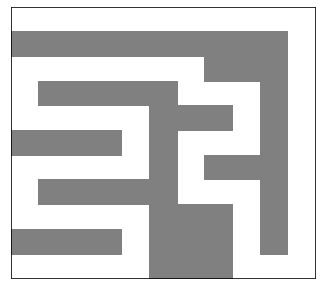

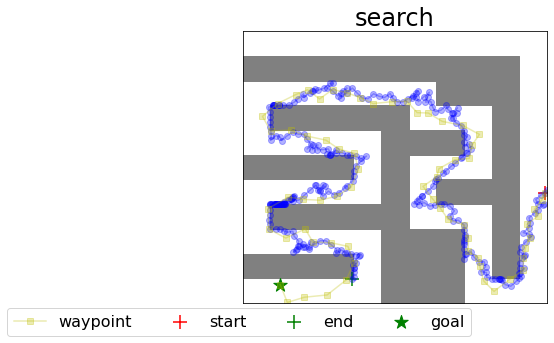

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


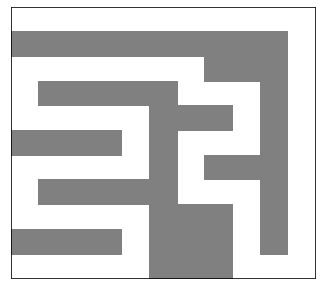

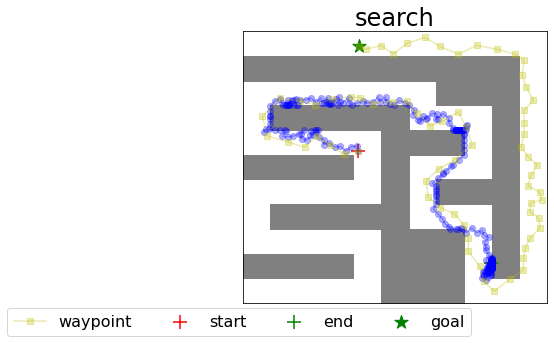

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


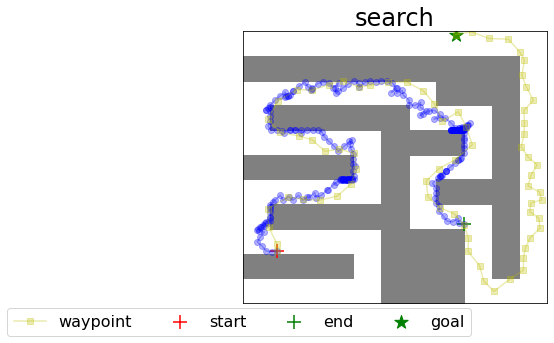

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


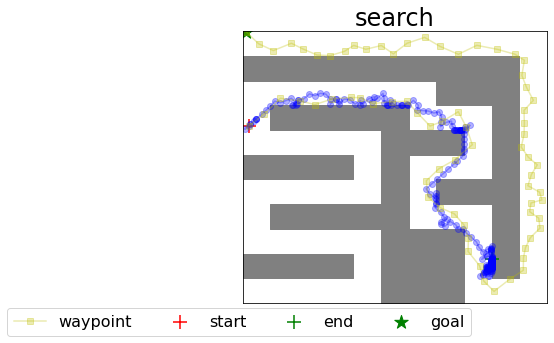

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


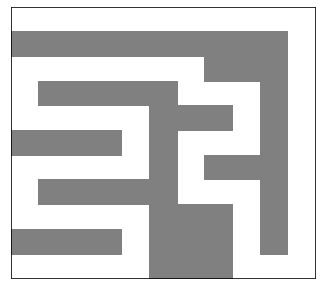

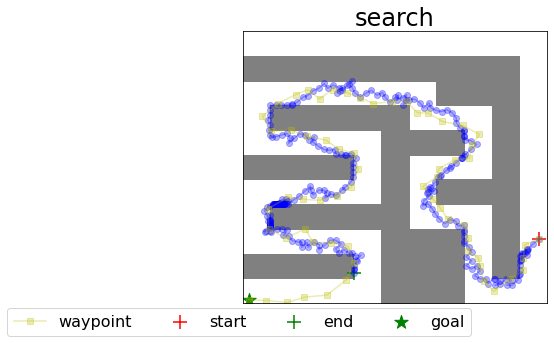

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


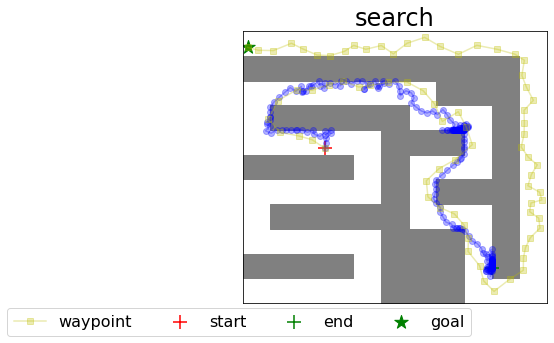

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


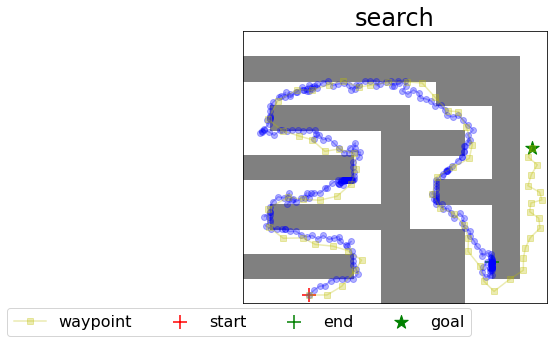

Path success rate is  0.7
Rollout success rate (given path) is  0.0
Average search time (for success) is  21.446712408746993
Search iterations is  300.0
Difficulty =  0.7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


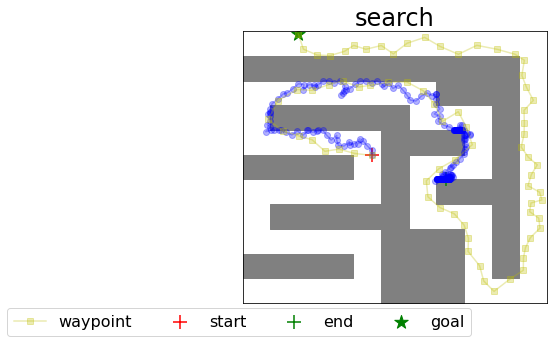

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


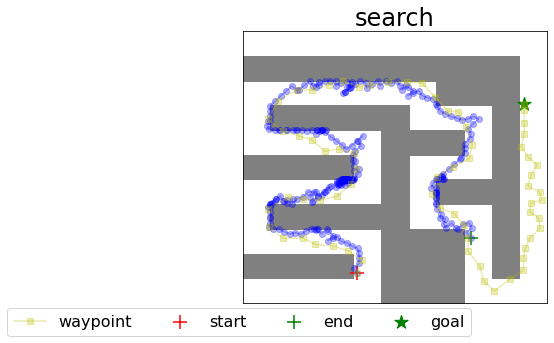

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


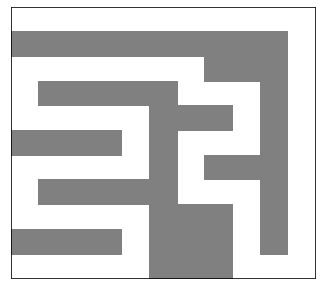

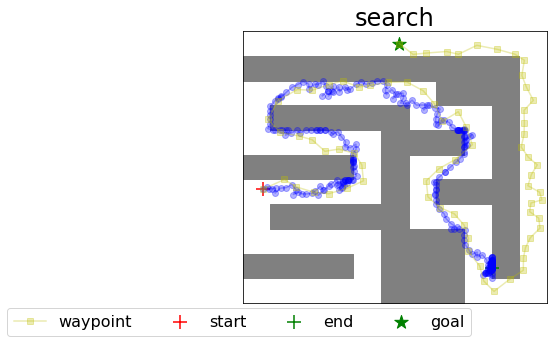

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


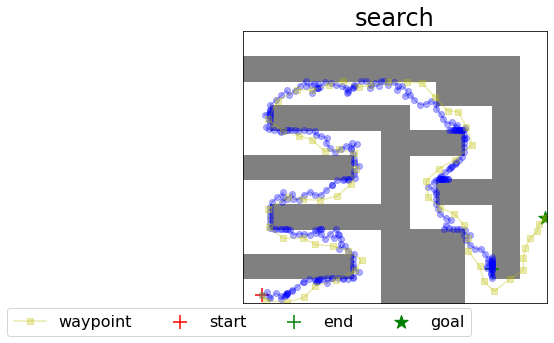

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


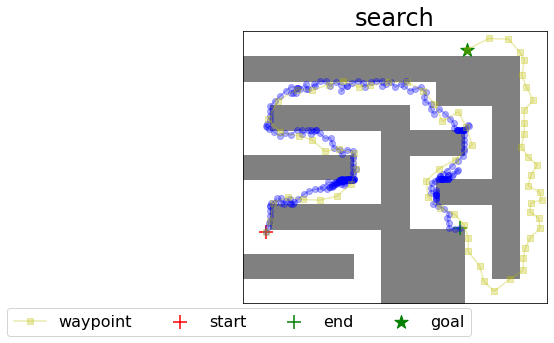

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


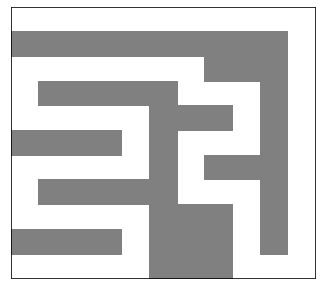

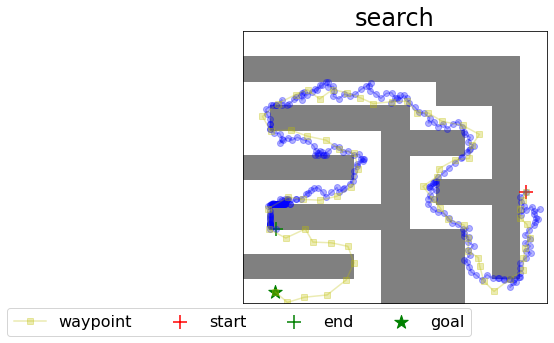

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


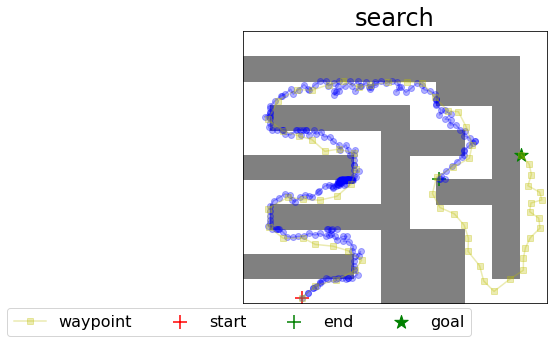

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


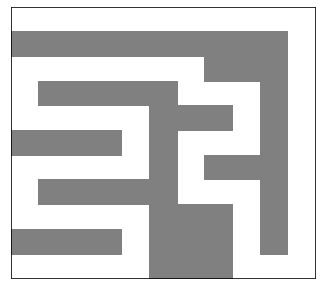

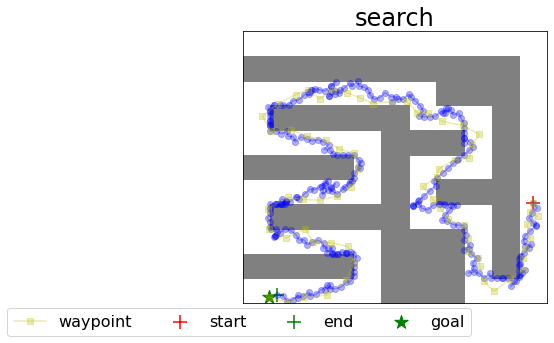

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


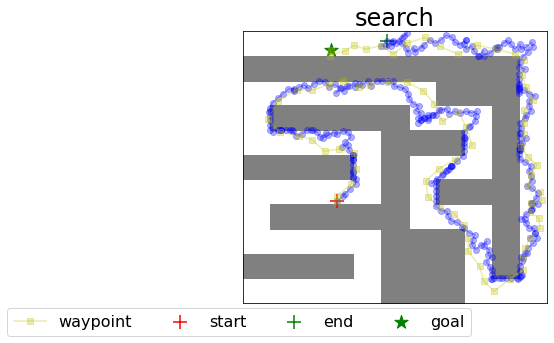

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


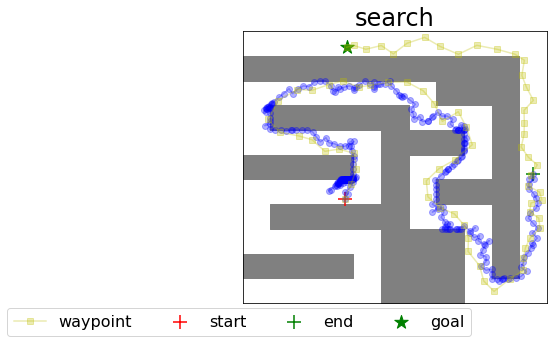

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


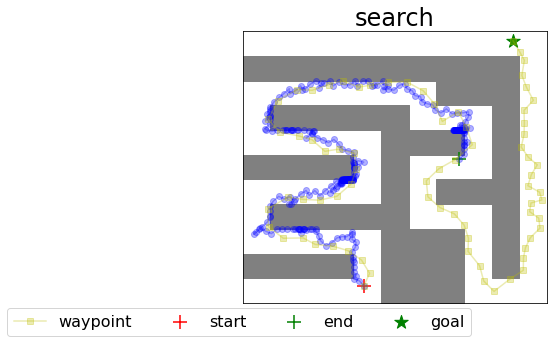

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


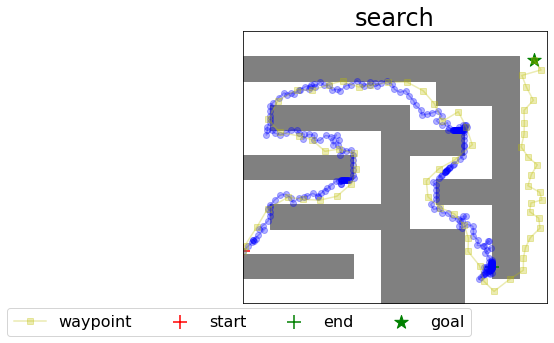

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


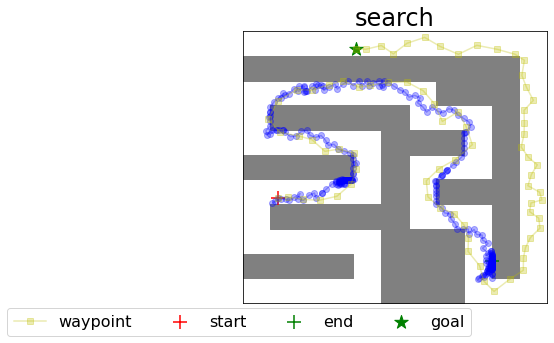

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


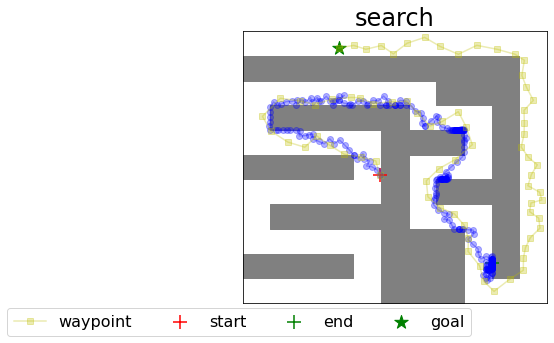

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


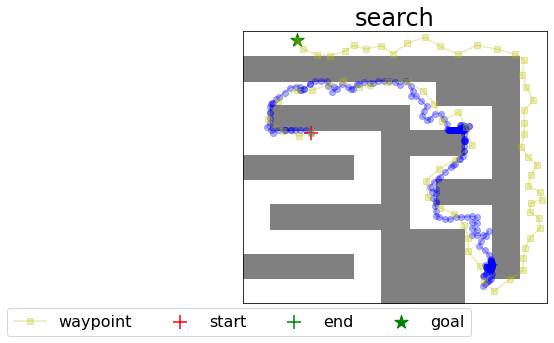

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:190: TqdmDeprecationWarning: Please use `tqdm.notebook.trange` instead of `tqdm.tnrange`


Path success rate is  0.75
Rollout success rate (given path) is  0.06666666666666667
Average search time (for success) is  21.51503087679545
Search iterations is  299.26666666666665


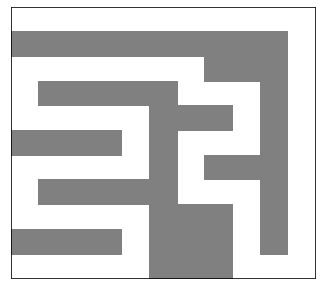

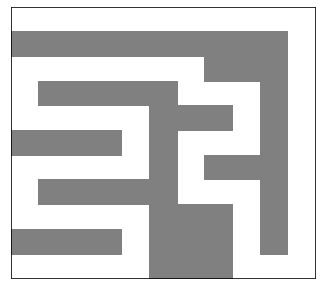

In [0]:
#@title Transfer Learning Basics
import time
from tensorflow.python.framework import ops
ops.reset_default_graph()

env_names = ['Small', 'Tunnel', 'Tree']

for env_name in env_names:
    for env_name2 in env_names:
        if (env_name == env_name2):
            continue
        ops.reset_default_graph()
        print(env_name)
        print(env_name2)

        max_episode_steps = 20
        resize_factor = 5
        tf_env = env_load_fn(env_name, max_episode_steps, 
                              resize_factor=resize_factor,
                              terminate_on_timeout=False)
        eval_tf_env = env_load_fn(env_name, max_episode_steps,
                                  resize_factor=resize_factor,
                                  terminate_on_timeout=True)
        agent = UvfAgent(
            tf_env.time_step_spec(),
            tf_env.action_spec(),
            max_episode_steps=max_episode_steps,
            use_distributional_rl=True,
            ensemble_size=3)

        _, distances, times = train_eval(
            agent,
            tf_env,
            eval_tf_env,
            initial_collect_steps=1000,
            eval_interval=1000,
            num_eval_episodes=10,
            num_iterations=30000,
          )

        print("Complete")

        average_error = []
        max_error = []
        for errors in distances:
          average_error.append(np.mean(errors))
          max_error.append(np.max(errors))

        plt.figure(160)
        plt.plot(average_error, label='average_error')
        plt.plot(max_error, label='max_error')
        plt.xlabel("Iteration")
        plt.ylabel("Distance error")
        plt.title("Distance errors throughout training")
        plt.legend()
        plt.show()

        plt.figure(1601)
        plt.plot(times, label='Training Time')
        plt.xlabel("Iteration")
        plt.ylabel("Training Time")
        plt.title("Training times per iteration")
        plt.legend()
        plt.show()

        previous_distances = distances

        # env_name2 = 'Maze11x11'  # Choose one of the environments shown above. Different from first one
        resize_factor2 = 5 # may need to change resize factor if first env too diff in size

        tf_env = env_load_fn(env_name2, max_episode_steps,
                            resize_factor=resize_factor2,
                            terminate_on_timeout=False)
        eval_tf_env = env_load_fn(env_name2, max_episode_steps,
                                  resize_factor=resize_factor2,
                                  terminate_on_timeout=True)
        agent.set_trainable_layers(1) 
        # limit trainable layers from above cell, train again.
        _, distances, times = train_eval(
            agent,
            tf_env,
            eval_tf_env,
            initial_collect_steps=1000,
            eval_interval=1000,
            num_eval_episodes=10,
            num_iterations=5000,
        )

        print("Complete")

        average_error = []
        max_error = []
        for errors in previous_distances:
          average_error.append(np.mean(errors))
          max_error.append(np.max(errors))

        for errors in distances:
          average_error.append(np.mean(errors))
          max_error.append(np.max(errors))

        plt.figure(161)
        plt.plot(average_error, label='average_error')
        plt.plot(max_error, label='max_error')
        plt.axvline(x=30)
        plt.xlabel("Iteration")
        plt.ylabel("Distance error")
        plt.title("Distance errors throughout training")
        plt.legend()
        plt.show()

        plt.figure(1611)
        plt.plot(times, label='Training Time')
        plt.xlabel("Iteration")
        plt.ylabel("Training Time")
        plt.title("Training times per iteration")
        plt.legend()
        plt.show()

        replay_buffer_size = 1000

        eval_tf_env.pyenv.envs[0].gym.set_sample_goal_args(
            prob_constraint=0.0,
            min_dist=0,
            max_dist=np.inf)
        rb_vec = []
        for _ in tqdm.tnrange(replay_buffer_size):
          ts = eval_tf_env.reset()
          rb_vec.append(ts.observation['observation'].numpy()[0])
        rb_vec = np.array(rb_vec)

        plt.figure(figsize=(6, 6))
        plt.scatter(*rb_vec.T)
        plot_walls(eval_tf_env.pyenv.envs[0].env.walls)
        plt.show()

        pdist = agent._get_pairwise_dist(rb_vec, aggregate=None).numpy()
        plt.figure(figsize=(6, 3))
        plt.hist(pdist.flatten(), bins=range(20))
        plt.xlabel('predicted distance')
        plt.ylabel('number of (s, g) pairs')
        plt.show()

        max_steps = 7

        agent.initialize_search(rb_vec, max_search_steps=max_steps)
        search_policy = SearchPolicy(agent, open_loop=True)

        print("Searching with max steps of ", max_steps)
        print("==================================")
        difficulties = [0.7]
        number_of_test = 5

        for difficulty in difficulties:
          print("Difficulty = ", difficulty)
          N = 20
          success = 0
          rollout_succ = 0
          search_time_success = []
          search_iterations = []

          for i in range(N):
            start_time = time.time()
            try:
              dura = 300
              eval_tf_env.pyenv.envs[0]._duration = dura
              seed = np.random.randint(0, 1000000)

              max_goal_dist = eval_tf_env.pyenv.envs[0].gym.max_goal_dist
              eval_tf_env.pyenv.envs[0].gym.set_sample_goal_args(
                prob_constraint=1.0,
                min_dist=max(0, max_goal_dist * (difficulty - 0.05)),
                max_dist=max_goal_dist * (difficulty + 0.05))


              plt.figure(figsize=(12, 5))
              for col_index in range(2):
                if col_index == 0:
                  continue
                title = 'no search' if col_index == 0 else 'search'
                plt.subplot(1, 2, col_index + 1)
                plot_walls(eval_tf_env.pyenv.envs[0].env.walls)
                use_search = (col_index == 1)
                np.random.seed(seed)
                ts = eval_tf_env.reset()
                goal = ts.observation['goal'].numpy()[0]
                start = ts.observation['observation'].numpy()[0]
                obs_vec = []
                for _ in tqdm.tnrange(eval_tf_env.pyenv.envs[0]._duration,
                                      desc='rollout %d / 2' % (col_index + 1)):
                  if ts.is_last():
                    break
                  obs_vec.append(ts.observation['observation'].numpy()[0])
                  if use_search:
                    action = search_policy.action(ts)
                  else:
                    action = agent.policy.action(ts)

                  ts = eval_tf_env.step(action)

                obs_vec = np.array(obs_vec)

                plt.plot(obs_vec[:, 0], obs_vec[:, 1], 'b-o', alpha=0.3)
                plt.scatter([obs_vec[0, 0]], [obs_vec[0, 1]], marker='+',
                            color='red', s=200, label='start')
                plt.scatter([obs_vec[-1, 0]], [obs_vec[-1, 1]], marker='+',
                            color='green', s=200, label='end')
                plt.scatter([goal[0]], [goal[1]], marker='*',
                            color='green', s=200, label='goal')

                plt.title(title, fontsize=24)
                if use_search:
                  waypoint_vec = [start]
                  for waypoint_index in search_policy._waypoint_vec:
                    waypoint_vec.append(rb_vec[waypoint_index])
                  waypoint_vec.append(goal)
                  waypoint_vec = np.array(waypoint_vec)

                  plt.plot(waypoint_vec[:, 0], waypoint_vec[:, 1], 'y-s', alpha=0.3, label='waypoint')
                  plt.legend(loc='lower left', bbox_to_anchor=(-0.8, -0.15), ncol=4, fontsize=16)
              plt.show()

              
              # search_policy.action(ts)
              roll_len = len(obs_vec)
              search_iterations.append(roll_len)
              search_time_success.append(time.time() - start_time)

              success += 1
              if roll_len < dura:
                rollout_succ += 1
            except:
              continue

          print("Path success rate is ", success / N)
          print("Rollout success rate (given path) is ", rollout_succ / success)
          print("Average search time (for success) is ", np.mean(search_time_success))
          print("Search iterations is ", np.mean(search_iterations))
          print("==================================")